In [1]:
import os
import json
import glob
import lzma
import numpy as np
import pandas as pd
import datetime

import matplotlib.pyplot as plt
from matplotlib import colors
from mpl_toolkits.axes_grid1 import make_axes_locatable
from matplotlib import gridspec

import operator
from functools import reduce
from itertools import product
from scipy.ndimage import measurements

import tensorflow as tf

SEED = 420

LOG_DIR = os.path.join('../models', 'train_log')
DATA_DIR = '../data'
TRAIN_DIR = os.path.join(DATA_DIR, 'training')
EVAL_DIR = os.path.join(DATA_DIR, 'evaluation')
TEST_DIR = os.path.join(DATA_DIR, 'test')

df_sub = pd.read_csv(os.path.join(DATA_DIR, 'sample_submission.csv'))

train_ids = [fn.split('.json')[0] for fn in os.listdir(TRAIN_DIR)]
eval_ids = [fn.split('.json')[0] for fn in os.listdir(EVAL_DIR)]
test_ids = [fn.split('.json')[0] for fn in os.listdir(TEST_DIR)]
eval_ids = list(set(eval_ids).difference(test_ids))

train_filepaths = glob.glob(TRAIN_DIR + '/*')
eval_filepaths = [os.path.join(EVAL_DIR, f'{t}.json') for t in eval_ids]
test_filepaths = glob.glob(TEST_DIR + '/*')

id_to_filepath = {}

for task_id in train_ids:
    id_to_filepath[task_id] = os.path.join(TRAIN_DIR, f'{task_id}.json')
for task_id in eval_ids:
    id_to_filepath[task_id] = os.path.join(EVAL_DIR, f'{task_id}.json')

In [5]:
def load_task(filepath, verbose=0):
    if verbose:
        task_id = filepath.split('/')[-1].split('.json')[0]
        group = filepath.split('/' + task_id)[0].split('/')[-1]
        print(f"Loading {group} task {task_id}")
    with open(filepath, 'r') as f:
        task = json.load(f)
    return task

def load_task_from_id(task_id):
    task_filename = f'{task_id}.json'
    task_filepath = None
    for root in [TRAIN_DIR, EVAL_DIR, TEST_DIR]:
        if task_filename in os.listdir(root):
            task_filepath = os.path.join(root, task_filename)
    if task_filepath is None:
        raise ValueError(f'`task_id` {task_id} not found.')
    return load_task(task_filepath)

def strip_task(filepath):
    return filepath.split('/')[-1].split('.json')[0]
        

def flattener(pred):
    str_pred = str([row for row in pred])
    str_pred = str_pred.replace(', ', '')
    str_pred = str_pred.replace('[[', '|')
    str_pred = str_pred.replace('][', '|')
    str_pred = str_pred.replace(']]', '|')
    return str_pred

def unflattener(str_pred):
    pred = []
    for row in str_pred.strip('|').split('|'):
        pred.append([int(row[i]) for i in range(len(row))])
    return np.array(pred, dtype=np.uint8)

# https://github.com/fchollet/ARC/blob/master/apps/css/common.css
COLORS = [
    '#000000',
    '#0074D9',
    '#FF4136',
    '#2ECC40',
    '#FFDC00',
    '#AAAAAA',
    '#F012BE',
    '#FF851B',
    '#7FDBFF',
    '#870C25',
]

idx_to_color = {
    0: 'black',
    1: 'blue',
    2: 'red',
    3: 'green',
    4: 'yellow',
    5: 'grey',
    6: 'pink',
    7: 'orange',
    8: 'light blue',
    9: 'brown',
}

color_to_idx = {v: k for k, v in idx_to_color.items()}

idx_to_hex = {
    0: '#000000',
    1: '#0074D9',
    2: '#FF4136',
    3: '#2ECC40',
    4: '#FFDC00',
    5: '#AAAAAA',
    6: '#F012BE',
    7: '#FF851B',
    8: '#7FDBFF',
    9: '#870C25',
}

cmap = colors.ListedColormap(COLORS)
norm = colors.Normalize(vmin=0, vmax=9)
grid_params = {
    'cmap': cmap,
    'norm': norm
}

def generate_idx_to_rgb(hex_list):
    idx_to_rgb = {}
    for i, color in enumerate(hex_list):
        h = color.strip('#')
        rgb = tuple(int(h[i:i+2], 16) for i in (0, 2, 4))
        idx_to_rgb[i] = rgb
    return idx_to_rgb

idx_to_rgb = generate_idx_to_rgb(COLORS)

In [143]:
################################################################################
# plot functions
################################################################################

def plot_grid(x, 
              output_shape=None,
              ax=None,
              title=None,
              **kwargs):
    kwargs = dict(grid_params, **kwargs)
    x = np.asarray(x)
    
    if output_shape is not None:
        x = unpad(x, output_shape)
        
    ax = ax or plt.axes()
    p = ax.imshow(x, **kwargs)
    
    ax.set_title(title, size=12)
    ax.set_xticks(list(range(x.shape[1])))
    ax.set_yticks(list(range(x.shape[0])))
    [ax.axvline(i+0.5, c='#555', lw=.75) for i in range(x.shape[1])]
    [ax.axhline(i+0.5, c='#555', lw=.75) for i in range(x.shape[0])]
    
    return p
    
    
def plot_grids(x, cmaps=None, mask_th=0, num_grids=8):
    num_samples = len(x)
    if num_grids < num_samples:
        indices = np.random.choice(range(num_samples), 
                                   num_grids,
                                   replace=False)
    else:
        indices = range(num_samples)
        num_grids = num_samples
    
    fig, ax = plt.subplots(1, 
                           num_grids, 
                           figsize=(num_grids * 5, num_grids * 4))
    plt.subplots_adjust(wspace=0.3, hspace=0.3)
    ax = ax if isinstance(ax, np.ndarray) else [ax]
    
    for i, idx in enumerate(indices):
        x_grid = x[idx]
        if cmaps is not None:
            x_grid = channel_to_grid(x_grid, cmaps[idx], mask_th)
        plot_grid(x_grid, ax=ax[i])
    
    plt.show();
    
    
def plot_gradient(x, ax=None, show_color_bar=True):
    ax = ax or plt.axes()
    p = ax.imshow(x)
    
    if show_color_bar:
        fig = ax.get_figure()
        divider = make_axes_locatable(ax)
        cax = divider.append_axes("right", size="5%", pad=0.1)
        fig.colorbar(p, cax=cax)
    
    ax.set_xticks(list(range(x.shape[1])))
    ax.set_yticks(list(range(x.shape[0])))
    [ax.axvline(i+0.5, c='#555', lw=.5) for i in range(x.shape[1])]
    [ax.axhline(i+0.5, c='#555', lw=.5) for i in range(x.shape[0])];
    
    return ax

    
def plot_task(task, pred_fn=None, task_id=None, **kwargs):
    """Plots the train and test input & outputs for a `task`."""
    num_train = len(task['train'])
    num_test = len(task['test'])
    num_rows = 3 if pred_fn else 2
    num_samples = num_train + num_test
    
    x_grids = [np.array(task['train'][i]['input']) for i in range(num_train)]
    x_grids.extend([np.array(task['test'][i]['input']) for i in range(num_test)])
    y_grids = [np.array(task['train'][i]['output']) for i in range(num_train)]
    y_grids.extend([np.array(task['test'][i]['output']) for i in range(num_test)])
    
    hx, wx = zip(*[x.shape for x in x_grids])
    hy, wy = zip(*[x.shape for x in y_grids])
    hx_max, hy_max, wx_max, wy_max = max(hx), max(hy), max(wx), max(wy)
    h_max = max(*hx, *hy) * num_rows
    w_max = max(*wx, *wy) * num_samples
    fig_ratio = w_max / h_max 
    
    fig, ax = plt.subplots(num_rows, 
                           num_samples, 
                           figsize=(24, 24/fig_ratio),
                           dpi=None)
    plt.subplots_adjust(wspace=0.1, hspace=0.2)
    
    if task_id is not None:
        print(task_id)
    
    for i in range(num_train):
        plot_grid(x_grids[i], ax=ax[0][i], title=f'train_{i} in', **kwargs)
        plot_grid(y_grids[i], ax=ax[1][i], title=f'train_{i} out', **kwargs)
        
        if pred_fn is not None:
            y_pred = pred_fn(x_grids[i])
            plot_grid(y_pred, ax=ax[2][i], title=f'train_{i} pred', **kwargs)
        
    for i in range(num_test):
        plot_grid(x_grids[num_train+i], ax=ax[0][num_train+i], title=f'test_{i} in', **kwargs)
        
        if task['test'][i].get('output'):
            plot_grid(y_grids[num_train+i], ax=ax[1][num_train+i], title=f'test_{i} out', **kwargs)
        
        if pred_fn is not None:
            y_pred = pred_fn(x_grids[num_train+i])
            plot_grid(y_pred, ax=ax[2][num_train+i], title=f'test_{i} pred', **kwargs)
        
    plt.show()
    
def get_input_output(samples):
    x_grids = []
    y_grids = []
    for i in range(len(samples)):
        x_grids.append(np.array(samples[i]['input']))
        if samples[i].get('output'):
            y_grids.append(np.array(samples[i]['output']))
        
    return x_grids, y_grids

def score_task(y_true, y_pred):
    y_true = np.asarray(y_true)
    y_pred = np.asarray(y_pred)
    
#     if y_true.shape != y_pred.shape:
#         raise ValueError("Output and prediction shapes don't match. "
#                         f"Expected {y_true.shape}, got {y_pred.shape}")
    
    score = np.sum(y_true == y_pred) / y_pred.size
    return score


def score_tasks(y_true, y_pred):
    if not isinstance(y_true, list):
        y_true = [y_true]
    if not isinstance(y_pred, list):
        y_pred = [y_pred]
    return np.mean([score_task(y_true[i], y_pred[i]) for i in range(len(y_true))])


def solve_task_symbolic(task, solve_fn, plot_task=True, **kwargs):
    train_samples = task['train']
    test_samples = task['test']

    num_train = len(train_samples)
    num_test = len(test_samples)
    N = num_train + num_test
    
    if plot_task:
        fig, ax = plt.subplots(3, 
                               N, 
                               figsize=(6 * N, 12), 
                               dpi=50)
        plt.subplots_adjust(wspace=0.3, hspace=0.1)

    is_scores = []
    oos_scores = []
    oos_preds = []

    for i in range(num_train):
        x_train = train_samples[i]['input']
        y_train = train_samples[i]['output']
        y_pred = solve_fn(x_train)
        is_scores.append(score_task(y_train, y_pred))
        
        if plot_task:
            plot_grid(x_train, ax[0][i], title=f'train_{i} in', **kwargs)
            plot_grid(y_train, ax[1][i], title=f'train_{i} out', **kwargs)
            plot_grid(y_pred, ax[2][i], title=f'train_{i} pred', **kwargs)
    
    for i in range(num_test):
        x_test = test_samples[i]['input']
        y_pred = solve_fn(x_test)
        
        if plot_task:
            plot_grid(x_test, ax[0][num_train+i], title=f'test_{i} in', **kwargs)
            plot_grid(y_pred, ax[2][num_train+i], title=f'test_{i} pred', **kwargs)

        if test_samples[i].get('output'):
            y_test = test_samples[i]['output']
            oos_scores.append(score_task(y_test, y_pred))
            if plot_task:
                plot_grid(y_test, ax[1][num_train+i], title=f'test_{i} out', **kwargs)

        oos_preds.append(y_pred)
        
    
    print(f'IS acc  : {np.mean(is_scores):.4f}')
    if len(oos_scores) > 0:
        print(f'OOS acc : {np.mean(oos_scores):.4f}')
    
    return np.array(oos_preds)


def plot_numeric(x, bold_th=None, figsize=None):
    h,w = x.shape
    s = 1
    figsize = figsize or (int(w*.8),int(h*.8))
    
    bold_th = bold_th or 0
    
    fig = plt.figure(figsize=figsize)
    ax = fig.gca()
    ax.set_ylim(0, h*s+1)
    ax.set_xlim(0, w*s+1)
    
    for i in range(0, h*s, s):
        for j in range(0, w*s, s):
            v = x[i//s,j//s]
            weight = 'bold' if v > bold_th else None
            ax.text(j+.5, h-i+.5, f' {v:.3f} ', weight=weight)

    ax.set(frame_on=False)
    ax.set_xticks([])
    ax.set_yticks([])
    plt.show()

In [7]:
################################################################################
# dataframe utils
################################################################################
def display_row(s):
    if len(s) == 1 & isinstance(s, pd.DataFrame):
        s = s.iloc[0]
    with pd.option_context('display.max_rows', None, 'display.max_columns', None): 
        print(s)

def loc_all(conditions):
    return reduce(operator.and_, conditions, True)

def loc_any(conditions):
    return reduce(operator.or_, conditions, True)

def subset_df(df, conditions, how='all'):
    if how == 'any':
        return df.loc[loc_any(conditions(df))]
    else:
        return df.loc[loc_all(conditions(df))]

################################################################################
# non essential functions
################################################################################
def compute_objs(x, background_color=None):
    x = np.asarray(x)
    if background_color:
        _x = np.ravel(x[0]).tolist()
        background_color = max(set(_x), key=_x.count)
    else:
        background_color = 0
    return measurements.label(x != background_color)[1]

def frequency(x, value):
    return np.ravel(x).tolist().count(value)

def most_common(x):
    _x = np.ravel(x).tolist()
    return max(set(_x), key=_x.count)
    
def compute_objectness(x):
    x = np.asarray(x)
    bkgr_color = most_common(x)
    num_bkgr_color = frequency(x, bkgr_color)
    num_objs = measurements.label(x != bkgr_color)[1]
    return num_objs, bkgr_color, num_bkgr_color


In [1974]:
################################################################################
# geometric functions (objects)
################################################################################

def get_dims(x):
    """Returns the (b)atch, (h)eight, (w)idth, and (d)epth of an array/tensor."""
    ndim = len(x.shape) # in the case of a tensor
    if ndim == 2:
        return (0, *x.shape, 0)
    elif ndim == 4:
        return x.shape
    else:
        raise ValueError(f"Expected 2 or 4 dims, got {x.ndim}")
        
        
def identity(x):
    return x

def transpose(x):
    b, h, w, d = get_dims(x)
    if b == 0:
        xt = np.zeros((w, h), dtype=np.uint8)

        for i in range(w):
            for j in range(h):
                xt[i][j] = x[j][i]
        return xt
    else:
        xt = np.zeros((b, w, h, d), dtype=np.uint8)
        for i in range(w):
            for j in range(h):
                xt[:,i,j,:] = x[:,j,i,:]
        return xt

def rot90(x):
    b, h, w, d = get_dims(x)
    if b == 0:
        return np.array([[x[h-1-i, j] for i in range(h)] for j in range(w)])
    else:
        return np.moveaxis(
            [[x[:, h-1-i, j, :] for i in range(h)] for j in range(w)], 
            source=2, 
            destination=0
        )

def flip_x(x):
    b, h, w, d = get_dims(x)
    if b == 0:
        return np.array([[x[i,w-1-j] for j in range(w)] for i in range(h)])
    else:
        return np.moveaxis(
            [[x[:,i,w-1-j,:] for j in range(w)] for i in range(h)], 
            source=2, 
            destination=0
        )

def flip_y(x):
    xt = x.T
    b, h, w, d = get_dims(x)
    if b == 0:
        return np.array([[xt[i,w-1-j] for j in range(w)] for i in range(h)]).T
    else:
        return np.moveaxis(
            [[xt[:,i,w-1-j,:] for j in range(w)] for i in range(h)], 
            source=2, 
            destination=0
        ).T

def flip_xy(x):
    return flip_y(flip_x(x))

def shift_obj(x, y=None, max_shift=3, pad_value=0.):
    x_shift = []
    y_shift = []
    max_shift = max(max_shift, 1)
    
    b, h, w, d = get_dims(x)
        
    h_indices = np.arange(h)
    w_indices = np.arange(w)

    shift_w = np.random.choice(range(-max_shift+1, max_shift))
    shift_h = np.random.choice(range(-max_shift+1, max_shift))

    h_idx = h_indices[:shift_h] if shift_h < 0 else h_indices[shift_h:]
    w_idx = w_indices[:shift_w] if shift_w < 0 else w_indices[shift_w:]

    hp = (-shift_h, 0) if shift_h < 0 else (0, shift_h)
    wp = (-shift_w, 0) if shift_w < 0 else (0, shift_w)
    x_shift = pad(x[h_idx,:][:,w_idx], hp, wp, pad_value=pad_value)

    if y is not None:
        y_shift = pad(y[h_idx,:][:,w_idx], hp, wp, pad_value=pad_value)
    
    if y is not None:
        return x_shift, y_shift
    else:
        return x_shift
    
    
def add_mask(x, mask_shape=None, background_color=0, random_state=None):
    random_state = random_state or np.random.RandomState()
    x_mask = np.array(x)
    mask_shape = mask_shape or (3, 3)
    h, w = x.shape
    
    h_i = random_state.choice(range(h-3))
    w_i = random_state.choice(range(w-3))
    slice_idx = (slice(h_i, h_i+mask_shape[0]), slice(w_i, w_i+mask_shape[1]))
    
    x_mask[slice_idx] = background_color
    return x_mask
    


################################################################################
# algorithmic complexity functions
################################################################################

COMPRESSION_METHODS = [
    'lzma',
#     'gzip',
#     'zlib',
#     'bz2'
]

METHOD_TO_BOUND = {
    'lzma': 60,
    'gzip': 21,
    'zlib': 9,
    'bz2': 37
}


def compute_complexity(x, method='lzma'):
    if method not in COMPRESSION_METHODS:
        raise(f'Unrecognized method {method}')
    bound = METHOD_TO_BOUND.get(method, 0)
    
    if isinstance(x, np.ndarray):
        x = x.tolist()
    if isinstance(x, list):
        x = flattener(x)
    
    bytes_in = x.encode('utf-8')
    num_bytes_out = len(eval(method).compress(bytes_in)) - bound
    return num_bytes_out, num_bytes_out / len(bytes_in)


# state functions
from numpy.lib.stride_tricks import as_strided

def tile_array(x, h_factor, w_factor):
    h, w = x.shape
    hs, ws = x.strides
    x_up = as_strided(x, (h, h_factor, w, w_factor), (hs, 0, ws, 0))
    return x_up.reshape(h * h_factor, w * w_factor)


def copy_state(x):
    return x.copy()


################################################################################
# object functions 
################################################################################

def compute_object_matrix(x, background_color=0):
    num_labels = 0
    object_matrix = np.zeros_like(x, dtype=np.uint8)
    values = [v for v in set(np.unique(x)) if v != background_color]
    
    for v in values:
        matrix, n = measurements.label(x == v)
        matrix[matrix != 0] += num_labels
        object_matrix = object_matrix + matrix
        num_labels += n
    
    return object_matrix


def get_objects(x, f=None, background_color=0):
    """Returns a list of object coordinates, colors, and shapes.
    
    Applies a function THEN saves off the indices, meta data, etc
    """
    x = np.asarray(x)
    if f is not None:
        x = f(x)
    x_1d = np.ravel(x).tolist()
    
    obj_matrix = compute_object_matrix(x, background_color)
    labels = np.unique(obj_matrix)[1:]
    
    if len(labels) > 0:
        # construct object with coordinates, colors, and shape (frame)
        objs = []
        for label in labels:
            coords = np.array(list(zip(*np.where(obj_matrix == label))), dtype=np.uint8)
            symbols = x[tuple(zip(*coords))]
            shape = np.ptp(coords, axis=0) + 1
            objs.append(Object(symbols, coords, shape))
    else:
        objs = [identity_object(x)]
        
    for obj in objs:
        if obj.num_holes > 0:
            obj.find_children(objs)
        
    return objs


def identity_object(x):
    x = np.asarray(x)
    n, m = x.shape
    coords = np.array(list(product(range(n), range(m))), dtype=np.uint8)
    symbols = x.ravel()
    shape = np.array([n,m], dtype=np.uint8)
    return Object(symbols, coords, shape)


def plot_object(values, coordinates, shape):
    """Plots an object."""
    xy = coordinates - coordinates.min(axis=0)
    obj = np.zeros(shape, dtype=np.uint8)
    obj[tuple(zip(*xy))] = values
    plot_grid(obj)
    
    
def euclidean_distance(a, b):
    return ((a[0] - b[0])**2 + (a[1] - b[1])**2)**(1/2)

def neighborhood(x, i, j, kernel=None):
    h, w = x.shape
    neighbors = []
    if kernel is None:
        # 0 1 0
        # 1 0 1 
        # 0 1 0
        kernel = np.array([(0, -1), (0, 1), (-1, 0), (1, 0)])
    
    v = x[i, j]
    for ip, jp in kernel:
        if (0 <= i + ip < h) & (0 <= j + jp < w):
            if x[i+ip, j+jp] == v:
                neighbors.append((i+ip,j+jp))
                
    return neighbors

def find_blob(x, start, blob):
    blob.append(start)
    neighbors = neighborhood(x, *start)
    for indice in neighbors:
        if indice not in blob:
            find_blob(x, indice, blob)
    return blob


def find_holes(x, label=1, return_blobs=True):
    holes = []
    points = []
    blobs = []
    
    x = np.asarray(x)
    h, w = x.shape
    indices = zip(*np.where(x != label))
    
    for indice in indices:
        if indice not in points:
            blob = np.array(find_blob(x, indice, []))
            v_edges = intersection(blob[:,0], {0, h-1})
            h_edges = intersection(blob[:,1], {0, w-1})
            
            if len(v_edges) == 0 and len(h_edges) == 0:
                holes.append(np.unique(blob, axis=0))
            points.extend(list(map(tuple, blob)))
            blobs.append(blob)
    
    return holes, blobs


def build_blob(x, indices):
    b, h, w, d = get_dims(x)
    shape = indices.max(0) - indices.min(0) + 1
    h_min, w_min = indices.min(0)
    h_max, w_max = indices.max(0)
    
    padded_h = [
        (np.clip(h_min+i, 0, h), j)
        for i in range(-1, shape[0]+1)
        for j in [max(w_min - 1, 0), min(w_max + 1, w)]
    ]
    padded_w = [
        (i, np.clip(w_min + j, 0, w))
        for j in range(-1, shape[1]+1)
        for i in [max(h_min - 1, 0), min(h_max + 1, h)]
    ]
    padded_indices = np.array(union(indices, padded_h, padded_w))

    padded_shape = padded_indices.max(0) - padded_indices.min(0) + 1
    _xy = padded_indices - padded_indices.min(0)
    blob = np.zeros(padded_shape, np.float32)
    blob[tuple(zip(*_xy))] = x[tuple(zip(*padded_indices))]
    
    return blob
    
    
################################################################################
# state functions
################################################################################

from numpy.lib.stride_tricks import as_strided

def tile_array(x, h_factor, w_factor):
    h, w = x.shape
    hs, ws = x.strides
    x_up = as_strided(x, (h, h_factor, w, w_factor), (hs, 0, ws, 0))
    return x_up.reshape(h * h_factor, w * w_factor)


def project_to_2d(w, indices):
    indices = np.asarray(indices, dtype=int)
    output_x = indices // w
    output_y = indices % w
    return output_x, output_y


def project_to_1d(w, coordinates):
    """Returns indices on a 1D vector that correspond to the 2D `coordinates`."""
    coordinates = np.asarray(coordinates, dtype=np.uint8)
    indices = coordinates[:,1] % w + (coordinates[:,0] * w)
    return indices


def matched_filter(x_input, obj, coordinates, shape):
    """Slides a filter (object) across a state and checks for matches."""
    x_input = np.asarray(x_input)
    x_input_1d = x_input.ravel()

    input_h, input_w = x_input.shape
    strided_h = output_h - shape[0] + 1
    strided_w = output_w - shape[1] + 1

    coordinates_scaled = coordinates - coordinates.min(axis=0)
    indices = project_to_1d(output_w, coordinates_scaled)
    matches = []

    # slide the object across every possible region and check for matches
    for i in range(strided_h):
        for j in range(strided_w):
            strided_indices = indices + j + i * output_w
            if all(x_input_1d[strided_indices] == obj):
                matches.append([tuple(map(tuple, coordinates)), tuple(strided_indices)])
    
    return matches


# def get_background_color(x_grids):
#     x_flat = list(map(np.ravel, x_grids))
#     values_inter = reduce(set.intersection, map(set, x_flat))
#     if len(values_inter) == 0:
#         return 0
#     elif len(values_inter) == 1:
#         return list(values_inter)[0]
#     else:
#         return max(values_inter, key=[v for x in x_flat for v in x].count)
    
def get_background_color(x, y):
    if 0 in x or 0 in y:
        return 0
    # compute ratio of color to number of objects with color
    xy = np.concatenate((np.ravel(x), np.ravel(y))).tolist()
    return max(xy, key=xy.count)


################################################################################
# core utils 
################################################################################

def get_seq_elements(iterables):
    seq = []
    elements = []
    
    for iterable in iterables:
        if isinstance(iterable, np.ndarray):
            if iterable.ndim > 1:
                seq.append({tuple(row) for row in iterable})
                elements.extend(list(map(tuple, iterable)))
            else:
                seq.append(set(iterable.tolist()))
                seq.append(iterable.tolist())
        else:
            if not isinstance(iterable, set):
                seq.append(next(map(set, [iterable])))
            else:
                seq.append(iterable)
            elements.extend(list(iterable))
    
    return seq, elements

def intersection(*args):
    """Returns a list of intersected values from a group of iterables
    sorted by the first appearance of an element."""
    seq, elements = get_seq_elements(args)
    return sorted(reduce(set.intersection, seq), key=elements.index)

def union(*args):
    seq, elements = get_seq_elements(args)
    return sorted(reduce(set.union, seq), key=elements.index)

def diff(*args):
    seq, elements = get_seq_elements(args)      
    return sorted(reduce(set.difference, seq), key=elements.index)


def sample_coordinate(n, m, random_state=None):
    if random_state:
        return (random_state.choice(range(n)), random_state.choice(range(m)))
    else:
        return (np.random.choice(range(n)), np.random.choice(range(m)))

################################################################################
# model utils
################################################################################

from tensorflow_core.python.framework.convert_to_constants import convert_variables_to_constants_v2
from google.protobuf.json_format import MessageToDict

def save_model(model, filename, sched=None, **params):
    """Saves model weights and configurations to disk.
    
    Parameters
    ----------
    model : tf.keras.Model
        Model.
    filename : str
        Output path to save model configurations.
    """
    model.save_weights(filename)
    
    if len(params) > 0:
        tensor_params = {k: tf.constant(v.value) for k, v in params.items()}
    else:
        tensor_params = {}

    concrete_fn = model.call.get_concrete_function(
        x=tf.TensorSpec([None, None, None, model.num_channels]), 
        **tensor_params)
    concrete_fn = convert_variables_to_constants_v2(concrete_fn)
    graph_def = concrete_fn.graph.as_graph_def()
    graph_json = MessageToDict(graph_def)
    model_json = {
      'format': 'graph-model',
      'modelTopology': graph_json,
      'weightsManifest': [],
    }
    
    with open(f'{filename}.json', 'w') as f:
        json.dump(model_json, f)
        
        
def load_model(ckpt_dir, 
               step,
               num_channels,
               object_filters=None,
               **params):
    model_filepath = glob.glob(os.path.join(ckpt_dir, f'{step:04d}*.json'))
    weights_filepath = model_filepath[0].split('.json')[0]
    model = CAModel(num_channels, object_filters, **params)
    model.load_weights(weights_filepath)
    return model
        
        
def cleanup(min_files=1):
    ckpt_dirs = os.listdir(LOG_DIR)
    for filename in ckpt_dirs:
        filepath = os.path.join(LOG_DIR, filename)
        if len(os.listdir(filepath)) < min_files:
            os.rmdir(filepath)
            
            
            
################################################################################
# loss functions
################################################################################

def mean_squared_error(y_true, y_pred, axis=None):
    if axis is None:
        axis = [-3, -2, -1]
    return tf.reduce_mean(tf.square(y_true-y_pred), axis=axis)

def bernoulli_loss(y_true, y_pred, from_logits=True):
    """Computes the bernoulli loss (log loss) between the targets (input)
    and predictions (reconstruction).
    """
    if from_logits:
        loss = tf.reduce_sum(
            tf.nn.sigmoid_cross_entropy_with_logits(
                labels=y_true, logits=y_pred
            ),
            axis=1,
        )
    else:
        loss = - tf.reduce_sum(
            y_true * tf.math.log(y_pred) + (1 - y_true) * tf.math.log(1 - y_pred),
            axis=1
        )
    return tf.reduce_mean(loss)

In [2360]:
################################################################################
# grid utility functions
################################################################################

NUM_CHANNELS = len(COLORS)

def grid_to_rgb(x):
    """Returns a 3D array of RGB values of an ARC grid."""
    x_rgb = np.asarray(x)
    if x_rgb.ndim == 2:
        x_rgb = x_rgb[None, ...]
    if x_rgb.ndim == 3:
        x_rgb = x_rgb[..., None]
    
    x_rgb = np.repeat(x_rgb, 3, axis=-1)
    values = np.unique(x_rgb)
    for v in values:
        x_rgb[x_rgb[:,:,:,0] == v] = idx_to_rgb[v]
    return x_rgb[0] if x_rgb.shape[0] == 1 else x_rgb


def grid_to_rgba(x):
    """Returns a 3D array of RGB values of an ARC grid."""
    x = np.asarray(x)
    a = arc_conv2d((x != background_color).astype(np.float32), 
                   kernel=np.ones((3, 3), dtype=np.float32) / 9.,
                   padding='same')
    x_rgb = grid_to_rgb(x)
    x_rgba = np.concatenate([x_rgb, np.expand_dims(a, axis=-1)], axis=-1)
    return x_rgba.astype(np.float32)


def get_alpha(x, kernel=None, background_color=0):
    """Returns a 3D array of RGB values of an ARC grid."""
    x = np.asarray(x, dtype=np.float32)
    ndim = x.ndim
    if ndim == 2:
        x = x[None, ..., None]
    if ndim == 3:
        raise ValueError(f"Expected 2 or 4 dims. Got {ndim}")
        
    if kernel is None:
        kernel = np.ones((3, 3, 1, 1)) / 9.
    else:
        kdim = kernel.ndim
        if kdim == 2:
            kernel = kernel[..., None]
        if kdim == 3:
            kernel = kernel[..., None]
    
    kernel = kernel.astype(np.float32)       
    a = tf.nn.depthwise_conv2d(x, kernel, [1,1,1,1], 'SAME').numpy()
    if ndim == 2:
        return np.clip(a[0,...,0].astype(np.float32), -1, 1.)
    else:
        return np.clip(a.astype(np.float32), -1, 1.)

def grid_to_channel(x, cmap=None, background_color=0):
    """Transforms a 2D grid of color indices to a 3D tensor where each channel
    corresponds to a color.
    """
    x = np.asarray(x)
    if cmap is None:
        cmap = {i: i for i in range(NUM_CHANNELS)}
    
    x_channels = []
    for ch, v in cmap.items():
        if v == background_color:
            x_channels.append(np.zeros_like(x, dtype=np.float32))
        else:
            x_channels.append((x == v).astype(np.float32))
    return np.stack(x_channels, axis=2)     

def channel_to_grid(x, 
                    cmap=None,
                    mask_th=0,
                    num_channels=None,
                    background_color=0):
    """Transforms a binarized 3D matrix to a 2D grid of color indices."""
    x = np.array(x)
    if cmap is None:
        cmap = {i: i for i in range(NUM_CHANNELS)}
    num_channels = len(cmap)
    
    if x.shape[-1] < num_channels + 1:
        x = np.concatenate((x, x.sum(axis=-1)[...,None]), -1)
        
    mask = x[...,-1] > mask_th

    x_grid = np.argmax(x[..., :num_channels], axis=-1)
    x_grid = np.vectorize(cmap.__getitem__)(x_grid)
    x_grid[np.where(mask == 0)] = background_color
    
    return x_grid


def unpad(x, output_shape):
    ndim = len(x.shape)
    if ndim == 2:
        h, w = x.shape
    elif ndim == 4:
        h, w = x.shape[1:3]
    else:
        raise ValueError(f"Expected 2 or 4 dims, got {x.ndim}")
    
    hp = h - output_shape[0]
    wp = w - output_shape[1]
    if hp > 0:
        hp = (hp//2, h-hp//2) if hp % 2 == 0 else (hp//2+1, h-hp//2)
    else:
        hp = (0, h)
    if wp > 0:
        wp = (wp//2, w-wp//2) if wp % 2 == 0 else (wp//2+1, w-wp//2)
    else:
        wp = (0, w)
    
    if ndim == 2:
        if isinstance(x, np.ndarray):
            return x[hp[0]:hp[1], wp[0]:wp[1]]
        elif isinstance(x, tf.Tensor):
            return tf.slice(x, [hp[0], wp[0]], [hp[1]-hp[0], wp[1]-wp[0]])
        else:
            raise ValueError(f'Unrecognized data type {type(x)}')
    else:
        if isinstance(x, np.ndarray):
            return x[:,hp[0]:hp[1], wp[0]:wp[1],:]
        elif isinstance(x, tf.Tensor):
            return tf.slice(x, 
                            begin=[0, hp[0], wp[0], 0], 
                            size=[-1, hp[1]-hp[0], wp[1]-wp[0], -1])
        else:
            raise ValueError(f'Unrecognized data type {type(x)}')

def pad(x, hp=0, wp=0, dp=0, pad_value=0):
    ndim = len(x.shape)
    if not isinstance(hp, (list, tuple)):
        hp = (hp, hp)
    if not isinstance(wp, (list, tuple)):
        wp = (wp, wp)
    if not isinstance(dp, (list, tuple)):
        dp = (dp, dp)

    if ndim == 2:
        pad_width = [hp, wp]
    elif ndim == 4:
        pad_width = [(0,0), hp, wp, dp]
    else:
        pad_width = [hp, wp, dp]
    
    if isinstance(x, np.ndarray):
        return np.pad(x, pad_width, constant_values=pad_value)
    elif isinstance(x, tf.Tensor):
        return tf.pad(x, pad_width, constant_values=pad_value)
    else:
        raise ValueError(f'Unrecognized data type {type(x)}')
        
    
def pad_grid(x, output_shape, pad_value=0.):
    h, w = x.shape[:2]
    hp = (output_shape[0] - h)
    wp = (output_shape[1] - w)

    hp = (hp//2,)*2 if hp % 2 == 0 else (hp//2+1, hp//2)
    wp = (wp//2,)*2 if wp % 2 == 0 else (wp//2+1, wp//2)

    return pad(x, hp, wp, pad_value=pad_value)


def arc_conv2d(x_input, kernel, padding='same', strides=1):
    """Slides a filter (object) across a state and checks for matches."""
    x_input = np.asarray(x_input)
    kernel_h, kernel_w = kernel.shape
    
    if padding == 'same':
        hp = kernel_h // 2
        wp = kernel_w // 2
        x_input = np.pad(x_input, [(hp, wp), (hp, wp)])
    
    x_input_1d = x_input.ravel()
    kernel_1d = np.ravel(kernel)
    
    input_h, input_w = x_input.shape
    strided_h = (input_h - kernel_h + 1) // strides
    strided_w = (input_w - kernel_w + 1) // strides
    y_output = np.zeros((strided_h, strided_w), np.float32)

    indices = project_to_1d(input_w, list(product(range(kernel_h), range(kernel_w))))

    # slide the object across every possible region and check for matches
    for i in range(strided_h):
        for j in range(strided_w):
            strided_indices = indices + j + i * input_w
            dot = np.dot(x_input_1d[strided_indices], kernel_1d)
            y_output[i, j] = np.dot(x_input_1d[strided_indices], kernel_1d)
    
    return y_output


################################################################################
# palette functions
################################################################################

def get_palette(x, order='C'):
    x = np.asarray(x).ravel(order).tolist()
    return sorted(set(x), key=x.index)

def pal_per_example(examples, order='C'):
    if examples is None:
        return [{}]
    palettes = []
    for x in examples:
        palettes.append(get_palette(x, order))
    return palettes


def check_is_ordered(input_palettes,
                     output_palettes, 
                     background_colors,
                     continuity_symbols=None):
    continuity_symbols = continuity_symbols or {}
    for i in range(len(input_palettes)):
        input_palette = diff(input_palettes[i], 
                             {background_colors[i]},
                             continuity_symbols)
        output_palette = diff(output_palettes[i], 
                              {background_colors[i]},
                              continuity_symbols)
        # note: come back to this (the lengths don't always need to be the same?)
        if len(input_palette) != len(output_palette):
            return False
        elif not all(np.equal(input_palette, output_palette)):
            False
    return True

def get_cmap(palette, 
             size=None,
             continuity_symbols=None,
             spatial_symbols=None,
             background_color=0):
    if not isinstance(palette, list):
        palette = list(palette)
    cmap = {}
    ordered_palette = []
    palette = diff(palette, {background_color})
    size = len(palette) if size is None else size
    
    if continuity_symbols is not None:
        for symbol in continuity_symbols:
            if symbol not in ordered_palette:
                ordered_palette.append(symbol)
    
    if spatial_symbols is not None:
        for symbol in spatial_symbols:
            if symbol not in ordered_palette:
                ordered_palette.append(symbol)
    
    # preserves order
    ordered_palette = union(ordered_palette, palette)
    pal_size = len(ordered_palette)
    
    for i in range(size):
        if i < pal_size:
            cmap[i] = ordered_palette[i]
        else:
            cmap[i] = background_color
    
    return cmap

################################################################################
# tuning/scheduler utils
################################################################################

def log_scale(x, factor, step=None):
    return x**factor

def duration_fn(x, factor):
    return int(x**factor)

def decay_lr(lr, factor, optim, min_lr=0):
    new_lr = lr * factor
    if new_lr > min_lr:
        optim.lr.assign(new_lr)
    return new_lr


################################################################################
# evaluation functions
################################################################################

def get_pred(x, ch):
    return tf.concat([x[...,:ch], x[...,-1:]], axis=-1)


def generate_predictions(model, 
                         x,
                         cmap, 
                         target=None,
                         mask_th=.1,
                         steps=100,
                         verbose=0,
                         output_shape=None,
                         return_best=False,
                         **kwargs):
    y_preds = []
    losses, accs = [], []
    
    mask_th_t = tf.constant(mask_th)

    for step in tf.range(tf.constant(steps)):
        x = model(x, mask_th=mask_th_t, **kwargs)
        if target is not None:
            losses.append(tf.reduce_mean(
                mean_squared_error(target, get_pred(x, len(cmap)))
            ).numpy())
            accs.append(score_ca(target, x, cmap, mask_th, output_shape))
        if verbose:
            print(f'step {step} - loss : {losses[step]:.4f} - acc : {accs[step]:.4f}')
        y_preds.append(x)
    
    if target is not None:
        best_idx = np.argmax(accs)
        if verbose:
            print(f'\nbest step - {best_idx} - acc : {accs[best_idx]:.4f} - '
                  f'loss : {losses[best_idx]:.4f}')
        if return_best:
            return y_preds[best_idx]
    
    return y_preds

In [26]:
import gzip
import lzma
import zlib
import bz2


def generate_df_meta(task_filepaths):
    """Generates a dataframe of algorithmic complexity scores for each task."""
    df_meta = pd.DataFrame()

    for i, filepath in enumerate(task_filepaths):
        task_id = strip_task(filepath)
        task = load_task(filepath)
        x_train, y_train = get_input_output(task['train'])
        x_test, y_test = get_input_output(task['test'])

        data = {
            'task_id': [task_id],
            'filepath': [filepath],
            'num_train_samples': len(x_train),
            'num_test_samples': len(x_test)
        }
        
        # shape
        train_inp_shape = np.array([x.shape for x in x_train])
        train_out_shape = np.array([x.shape for x in y_train])
        test_inp_shape = np.array([x.shape for x in x_test])
        
        data['train_input_shape_w_uq'] = len(np.unique(train_inp_shape[:,0]))
        data['train_input_shape_w_mode'] = most_common(train_inp_shape[:,0])
        data['train_input_shape_h_uq'] = len(np.unique(train_inp_shape[:,1]))
        data['train_input_shape_h_mode'] = most_common(train_inp_shape[:,1])
        data['train_output_shape_w_uq'] = len(np.unique(train_out_shape[:,0]))
        data['train_output_shape_w_mode'] = most_common(train_out_shape[:,0])
        data['train_output_shape_h_uq'] = len(np.unique(train_out_shape[:,1]))
        data['train_output_shape_h_mode'] = most_common(train_out_shape[:,1])
        
        train_shape_delta = train_inp_shape - train_out_shape
        data['train_shape_delta_w_mean'] = train_shape_delta[:,0].mean()
        data['train_shape_delta_h_mean'] = train_shape_delta[:,1].mean()
        
        data['test_input_shape_w_uq'] = len(np.unique(test_inp_shape[:,0]))
        data['test_input_shape_w_mode'] = most_common(test_inp_shape[:,0])
        data['test_input_shape_h_uq'] = len(np.unique(test_inp_shape[:,1]))
        data['test_input_shape_h_mode'] = most_common(test_inp_shape[:,1])
        
        # objectness
        train_inp_objs = np.array([compute_objectness(x) for x in x_train])
        train_out_objs = np.array([compute_objectness(x) for x in y_train])
        test_inp_objs = np.array([compute_objectness(x) for x in x_test])
        
        data['train_input_bkgr_color_mode'] = np.argmax(np.bincount(train_inp_objs[:,1]))
        data['train_input_bkgr_color_uq'] = len(np.unique(train_inp_objs[:,1]))
        data['train_input_bkgr_color_count_mean'] = np.mean(train_inp_objs[:,2])
        data['train_input_num_objects_mean'] = np.mean(train_inp_objs[:,0])
        data['train_input_num_objects_std'] = np.std(train_inp_objs[:,0])
        
        data['train_output_bkgr_color_mode'] = np.argmax(np.bincount(train_out_objs[:,1]))
        data['train_output_bkgr_color_uq'] = len(np.unique(train_out_objs[:,1]))
        data['train_input_bkgr_color_count_mean'] = np.mean(train_out_objs[:,2])
        data['train_output_num_objects_mean'] = np.mean(train_out_objs[:,0])
        data['train_output_num_objects_std'] = np.std(train_out_objs[:,0])
        
        data['test_input_bkgr_color_mode'] = np.argmax(np.bincount(test_inp_objs[:,1]))
        data['test_input_bkgr_color_uq'] = len(np.unique(train_out_objs[:,1]))
        data['train_input_bkgr_color_count_mean'] = np.mean(test_inp_objs[:,2])
        data['test_input_num_objects_mean'] = np.mean(test_inp_objs[:,0])
        data['test_input_num_objects_std'] = np.std(test_inp_objs[:,0])
        
        # algorithmic complexity
        if len(y_test) > 0:
            test_out_objs = np.array([compute_objectness(x) for x in y_test])
            data['test_output_bkgr_color_mode'] = np.argmax(np.bincount(test_out_objs[:,1]))
            data['test_output_bkgr_color_uq'] = len(np.unique(test_out_objs[:,2]))
            data['test_output_bkgr_color_count_mean'] = np.mean(test_out_objs[:,2])
            data['test_output_num_objects_mean'] = np.mean(test_out_objs[:,0])
            data['test_output_num_objects_std'] = np.std(test_out_objs[:,0])       
        
        for method in COMPRESSION_METHODS:
            
            train_inp_comp = [compute_complexity(x, method) for x in x_train]
            train_out_comp = [compute_complexity(x, method) for x in y_train]
            test_inp_comp = [compute_complexity(x, method) for x in x_test]

            data[f'train_input_bytes_mean_{method}'] = [np.mean(train_inp_comp, 0)[0]]
            data[f'train_input_ratio_mean_{method}'] = [np.mean(train_inp_comp, 0)[1]]
            data[f'train_input_ratio_std_{method}'] = [np.std(train_inp_comp, 0)[1]]
            data[f'train_output_bytes_mean_{method}'] = [np.mean(train_out_comp, 0)[0]]
            data[f'train_output_ratio_mean_{method}'] = [np.mean(train_out_comp, 0)[1]]
            data[f'train_output_ratio_std_{method}'] = [np.std(train_out_comp, 0)[1]]
            data[f'test_input_bytes_mean_{method}'] = [np.mean(test_inp_comp, 0)[0]]
            data[f'test_input_ratio_mean_{method}'] = [np.mean(test_inp_comp, 0)[1]]
            data[f'test_input_ratio_std_{method}'] = [np.std(test_inp_comp, 0)[1]]
            
            
            if len(y_test) > 0:
                test_out_comp = [compute_complexity(y, method) for y in y_test]

                data[f'test_output_bytes_mean_{method}'] = [np.mean(test_out_comp, 0)[0]]
                data[f'test_output_ratio_mean_{method}'] = [np.mean(test_out_comp, 0)[1]]
                data[f'test_output_ratio_std_{method}'] = [np.std(test_out_comp, 0)[1]]
        
        df_meta = pd.concat((df_meta, pd.DataFrame(data)), ignore_index=True)
    
    return df_meta

In [11]:
functions = [identity, rot90, transpose, flip_x, flip_y, flip_xy]

def solver(task, functions):

    x_train, y_train = get_input_output(task['train'])
    x_test, y_test = get_input_output(task['test'])
    
    in_shapes_train = np.array([x.shape for x in x_train], np.uint8)
    out_shapes_train = np.array([x.shape for x in y_test] ,np.uint8)
    inp_shapes_test = np.array([x.shape for x in x_test], np.uint8)
    
    slv = ShapeSolver().fit(in_shapes_train, out_shapes_train)
    pred_shapes_train = slv.predict(in_shapes_train)
    if not np.all(in_shapes_train == pred_shapes_train):
        return [], []
        

    num_train = len(x_train)
    num_test = len(x_test)

    h_in, w_in = x_train[0].shape
    h_out, w_out = y_train[0].shape

    programs = []

    # apply to symmetric, non-invariant tasks
    for f in functions:
        in_objs_train = [get_objects(x, f) for x in x_train]
        num_in_objs_train = list(map(len, in_objs_train))
        num_objs_x0 = num_in_objs_train[0]

        if all([num_objs_x0 == n for n in num_in_objs_train]):
            for i in range(num_objs_x0):
                # find any matching input coordinates and where they map to
                matches = [conv(y_train[j], *in_objs_train[j][i]) for j in range(num_train)]
                candidates = intersection(matches)
                # NEED to handle when there are 2 or more candidates
                if len(candidates) > 0:
                    programs.extend([(f, *candidates[i]) for i in range(len(candidates))])

    is_preds = []
    oos_preds = []

    if len(programs) > 0:
        for i in range(len(x_train)):
            x = x_train[i]
            y_pred = np.zeros((h_out, w_out), dtype=np.uint8)
            for j in range(len(programs)):
                f, x_coord, y_idx = programs[j]
                y_pred[project_to_2d(w_out, y_idx)] = f(x)[tuple(zip(*x_coord))]
            is_preds.append(y_pred)

        for i in range(len(x_test)):
            x = x_test[i]
            y_pred = np.zeros((h_out, w_out), dtype=np.uint8)

            for j in range(len(programs)):
                f, x_coord, y_idx = programs[j]
                y_pred[project_to_2d(w_out, y_idx)] = f(x)[tuple(zip(*x_coord))]
            oos_preds.append(y_pred)

    return is_preds, oos_preds

In [12]:
df_train = generate_df_meta(train_filepaths)
df_eval = generate_df_meta(eval_filepaths)
df_test = generate_df_meta(test_filepaths)

conditions = lambda df: [
    df['train_input_shape_w_uq'] == 1,
    df['train_input_shape_h_uq'] == 1,
    
    df['train_output_shape_w_uq'] == 1,
    df['train_output_shape_h_uq'] == 1,
    df['train_shape_delta_w_mean'] == 0,
    df['train_shape_delta_h_mean'] == 0
#     df['train_input_shape_w_mode'] == df['train_input_shape_h_mode'],
    
#     df['train_input_bkgr_color_uq'] == 1,
#     df['train_output_bkgr_color_uq'] == 1,
    
#     df['train_input_bkgr_color_mode'] == 0,
#     df['train_output_bkgr_color_mode'] == 0,
]    

df_cond_train = subset_df(df_train, conditions)
df_cond_eval = subset_df(df_eval, conditions)
df_cond_test = subset_df(df_test, conditions)

In [13]:
def old_pred_func(filepaths, solver, functions, df_pred=None, show=False):
    if df_pred is not None:
        df_pred = df_pred.copy()
        df_pred['IS_acc'] = 0
    else:
        df_pred = pd.DataFrame(columns=['output_id', 'output', 'IS_score', 'OOS_score'])
    
    for filepath in filepaths:
        task_id = strip_task(filepath)
        task = load_task(filepath)
        y_pred_train, y_pred_test = solver(task, functions)
        
        data = {
            'output_id': task_id,
            'output': '',
            'IS_score': 0,
            'OOS_score': None
        }
        
        if len(y_pred_train) > 0:
            x_train, y_train = get_input_output(task['train'])
            x_test, y_test = get_input_output(task['test'])
            print(task_id)
            train_acc = score_tasks(y_train, y_pred_train)
            data['IS_acc'] = train_acc
            
            print(task_id)
            print('-'*12)
            print(f'IS  : {train_acc:.4f}')
            if len(y_test) > 0:
                test_acc = score_tasks(y_test, y_pred_test)
                print(f'OOS : {test_acc:.4f}')
                data['OOS_score'] = test_acc
            print()
            
            if show:
                plot_task(task)
                for i in range(len(y_train)):
                    plot_grid(y_pred_train[i])
                    plt.show()
            for i in range(len(y_pred_test)):
                if show:
                    plot_grid(y_pred_test[i])
                    plt.show()
                output_id = f'{task_id}_{i}'
                y_pred_str = flattener(y_pred_test[i].tolist())
                data['output'] = y_pred_str
        
        df_pred = df_pred.append(data, ignore_index=True)
        
    
    print(f"IS score  : {(df_pred['IS_score'] == 1).sum()} / {len(df_pred)}")
    print(f"OOS score : {(df_pred['OOS_score'] == 1).sum()} / {len(df_pred)}")
    return df_pred

In [14]:
def channel_to_grid(x, 
                    cmap=None,
                    mask_th=0,
                    num_channels=None,
                    background_color=0):
    """Transforms a binarized 3D matrix to a 2D grid of color indices."""
    x = np.array(x)
    if cmap is None:
        cmap = {i: i for i in range(NUM_CHANNELS)}
    num_channels = len(cmap)
    
    if x.shape[-1] < num_channels + 1:
        x = np.concatenate((x, x.sum(axis=-1)[...,None]), -1)
        
    mask = x[...,-1] > mask_th

    x_grid = np.argmax(x[..., :num_channels], axis=-1)
    x_grid = np.vectorize(cmap.__getitem__)(x_grid)
    x_grid[np.where(mask == 0)] = background_color
    
    return x_grid

In [15]:
# input_train_shapes = task.input_shapes[:task.num_train]
# output_train_shapes = task.input_shapes[:task.num_train]
# slv = ShapeSolver().fit(input_train_shapes,output_train_shapes)

In [16]:
class ShapeSolver(object):
    """Linear shape solver."""
    def __init__(self):
        self.coef_ = None
        self.w_coef_ = None
        self.h_coef_ = None
        self.n_coef = None
        
    def fit(self, input_shapes, output_shapes):
        input_shapes = np.asarray(input_shapes, dtype=np.uint8)
        output_shapes = np.asarray(output_shapes, dtype=np.uint8)
        n = len(input_shapes)
        
        h_input = np.hstack((np.expand_dims(input_shapes[:,0], axis=1), 
                             np.ones((n, n-1))))
        h_output = output_shapes[:,0]
        
        w_input = np.hstack((np.expand_dims(input_shapes[:,1], axis=1), 
                             np.ones((n, n-1))))
        w_output = output_shapes[:,1]
        
        if np.linalg.det(h_input) == 0:
            self.h_coef_ = np.concatenate(([1], np.zeros(n-1)))
        else:
            self.h_coef_ = np.linalg.solve(h_input, h_output)
        
        if np.linalg.det(w_input) == 0:
            self.w_coef_ = np.concatenate(([1], np.zeros(n-1)))
        else:
            self.w_coef_ = np.linalg.solve(w_input, w_output)
        
        self.coef_ = np.vstack((self.h_coef_, self.w_coef_))
        self.n_coef = self.coef_.shape[1]
        return self
    
    def predict(self, input_shapes):
        input_shapes = np.array(input_shapes, dtype=np.uint8)
        if input_shapes.ndim == 1:
            input_shapes = np.expand_dims(input_shapes, axis=0)
        n = len(input_shapes)
        
        h_input = np.hstack((np.expand_dims(input_shapes[:,0], axis=1), 
                             np.ones((n, self.n_coef-1))))
        w_input = np.hstack((np.expand_dims(input_shapes[:,1], axis=1), 
                             np.ones((n, self.n_coef-1))))
        
        h_output = np.dot(h_input, self.h_coef_)
        w_output = np.dot(w_input, self.w_coef_)
        
        return np.stack((h_output, w_output), axis=1)

In [18]:
# input_train_shapes = task.input_shapes[:task.num_train]
# output_train_shapes = task.input_shapes[:task.num_train]
# slv = ShapeSolver().fit(input_train_shapes,output_train_shapes)

In [19]:
correct = []
for i,fp in enumerate(eval_filepaths):
    task = load_task(fp)
    x0, y0 = get_input_output(task['train'])
    x1, y1 = get_input_output(task['test'])
    
    x0_input_shapes = np.array([x.shape for x in x0], np.uint8)
    x0_output_shapes = np.array([x.shape for x in y0] ,np.uint8)
    x1_input_shapes = np.array([x.shape for x in x1], np.uint8)
    x1_output_shapes = np.array([x.shape for x in y1] ,np.uint8)
    
    slv = ShapeSolver().fit(x0_input_shapes, x0_output_shapes)
    if np.alltrue(x0_output_shapes == slv.predict(x0_input_shapes)):
        if np.alltrue(x1_output_shapes == slv.predict(x1_input_shapes)):
            correct.append(fp)
#         print(i, 'train')
#         break
#     if not np.alltrue(x1_output_shapes == slv.predict(x1_input_shapes)):
#         print(i, 'test')
#         break

In [13]:
# for fp in df_eval.loc[df_eval['filepath'].isin(correct)].sort_values('train_input_bytes_mean_lzma')['filepath']:
#     task = load_task(fp,1)
#     plot_task(task)

In [14]:
# def shift_obj(state, obj, state_f=None, steps=None):
#     if state_f is not None:
#         state = state_f(state)
#     pass

In [15]:
# # apply to symmetric, non-invariant tasks
# for f in functions:
#     objs = [get_objects(x, f) for x in x_train]
#     num_obs_per_sample = list(map(len, objs))
#     num_objs_x0 = num_obs_per_sample[0]

#     if all([num_objs_x0 == n for n in num_obs_per_sample]):
#         for i in range(num_objs_x0):
#             # find any matching input coordinates and where they map to
#             matches = [conv(y_train[j], *objs[j][i]) for j in range(num_train)]
#             candidates = intersection(matches)
#             # NEED to handle when there are 2 or more candidates
#             if len(candidates) > 0:
#                 programs.extend([(f, *candidates[i]) for i in range(len(candidates))])

In [20]:
def pattern_sweep(task, random_state=None):
    x_train, y_train = get_input_output(task['train'])
    x_test, y_test = get_input_output(task['test'])
    
    n_in, m_in = x_train[0].shape
    n_out, m_out = y_train[0].shape
    
    input_objs_train = [get_objects(x) for x in x_train]
    output_objs_train = [get_objects(y) for y in y_train]
    input_objs_test = [get_objects(x) for x in x_test]
    
    input_ij_to_color = {}
    output_ij_to_input_ij = {}
    
    # map each output coordinate to the input coordinate with the matched color 
    for i in range(n_out):
        for j in range(m_out):
            seq = [y[i][j] for y in y_train]
            matches = [k for k, v in input_ij_to_color.items() if v == seq]
            if len(matches) > 0:
                # need to handle when there are multiple matches
                output_ij_to_input_ij[(i,j)] = matches[0]
                if len(matches) > 1:
                    print(i, j, matches)
            else:
                output_ij_to_input_ij[(i,j)] = None # sample_coordinate(n_in, m_in, random_state)
    
    is_preds = []
    oos_preds = []
    
    for idx in range(len(x_train)):
        x_train_idx = x_train[idx]
        y_pred = np.zeros((n_out, m_out), dtype=int)
        for i in range(n_out):
            for j in range(m_out):
                coord = output_ij_to_input_ij[(i,j)]
                print(coord)
                y_pred[i,j] = x_train_idx[coord] if coord else 10
        is_preds.append(y_pred)
        
    print('\n\n\n')
    for idx in range(len(x_test)):
        x_test_idx = x_test[idx]
        y_pred = np.zeros((n_out, m_out), dtype=int)
        
        for i in range(n_out):
            for j in range(m_out):
                coord = output_ij_to_input_ij[(i,j)]
                print(coord)
                y_pred[i,j] = x_test_idx[coord] if coord else 10
#                 y_pred[i,j] = x_test_idx[output_ij_to_input_ij[(i,j)]]
        oos_preds.append(y_pred)
 
    return is_preds, oos_preds

In [940]:
IDENTITY = np.outer([0,1,0], [0,1,0]).astype(np.float32)
SOBEL_X = np.outer([1, 2, 1], [-1, 0, 1]).astype(np.float32)
SOBEL_Y = SOBEL_X.T

In [27]:
class Type(object):
    """DSL data type base class."""
    def __init__(self, name):
        self.name = name
        self._hash = hash(self.name)

    def __hash__(self):
        return self._hash

    def __eq__(self, other):
        return hash(self) == hash(other)

    def __str__(self):
        return self.name

    def __repr__(self):
        return self.name
    

class FunctionType(Type):
    
    def __init__(self, input_type, output_type):
        super(FunctionType, self).__init__(
            f'F({str(input_type)}, {str(output_type)})'
        )
        self.input_type = input_type if isinstance(input_type, tuple) else (input_type,)
        self.output_type = output_type
        

INT = Type('INT')
STR = Type('STR')
BOOL = Type('BOOL')
LIST = Type('LIST')
ARRAY = Type('ARRAY')
NULL = Type('NULL')


class Variable(object):
    """DSL base variable class."""
    
    def __init__(self, data_source, dtype):
        self.data_source = data_source
        self._dtype = dtype
        self._name = str(data_source)
        if dtype in (LIST, ARRAY):
            self._hash = hash(tuple(np.ravel(data_source)))
        else:
            self._hash = hash(data_source)
            
    @property
    def dtype(self):
        return self._dtype

    @property
    def value(self):
        return self._data

    def __hash__(self):
        return self._hash

    def __eq__(self, other):
        if not isinstance(other, Variable):
            return False
        return self._data == other._data and self._dtype == other._dtype

    def __str__(self):
        return self._name

    def __repr__(self):
        return self._name

    def __call__(self, value):
        if value is None:
            return NULL
        elif isinstance(value, (int, INT)):
            return Int(value)
        elif isinstance(value, (list, LIST)):
            return List(value)
        elif isinstance(value, (np.ndarray, ARRAY)):
            return Array(value)
        else:
            raise ValueError(f'Unrecognized type {type(value)}')
    
#     @classmethod
#     def construct(self, value, value_type=None):
#         if value is None:
#             return null_

#         if value_type is None:
#             raw_type = type(value)
#             if raw_type == int:
#                 value_type = int_
#             elif raw_type == list:
#                 value_type = list_

#         if value_type == int_:
#             return Int(value)
#         elif value_type == list_:
#             return List(value)
#         else:
#             raise ValueError(f'Unrecognized type {value_type}')


class Int(Variable):
    """DSL int data type."""
    def __init__(self, data):
        super(Int, self).__init__(data, INT)

class Str(Variable):
    def __init__(self, data):
        super(Str, self).__init__(data, STR)
        
class List(Variable):
    """DSL list data type."""
    def __init__(self, data):
        super(List, self).__init__(data, LIST)
        
class Array(Variable):
    """DSL array data type."""
    def __init__(self, data):
        super(Array, self).__init__(data, ARRAY)

Null = Variable(None, NULL)


class Function(Variable):
    """DSL function base class."""
    def __init__(self, name, f, input_type, output_type):
        super(Function, self).__init__(f, FunctionType(input_type, output_type))
        self.name = name

    def __call__(self, *args):
        for arg in args:
            if arg is NULL:
                raise NullInputError(f'{self.name}({args})')
        raw_args = [x.value for x in args]
        output_raw = self._data(*raw_args)
        output_value = Variable(output_raw, self.output_type)
        return output_value

    @property
    def input_type(self):
        return self.dtype.input_type

    @property
    def output_type(self):
        return self.dtype.output_type

    def __eq__(self, other):
        if not isinstance(other, Function):
            return False
        return self.name == other.name

    def __hash__(self):
        return hash(self.name)

    def __repr__(self):
        return str(self)

    def __str__(self):
        return self.name #+ '(' + str(self.input_type) + ',' + str(self.output_type + ')'
    
    
class Program(object):
    """
    Attributes:
        input_types (tuple): tuple of Type (INT,LIST) representing inputs
        stmts (tuple): tuple of statements. each statement is pair of function, tuple of mixed type representing arguments
        types (tuple): tuple of Type for all variables
        prefix (str): prefix string that completely describes program
    """
    def __init__(self, input_types, statements):
        self.input_types = input_types if isinstance(input_types, tuple) else (input_types,)
        self.statements = tuple(statements)
        self._functions = [stmt[0] for stmt in self.statements]
        self.output_types = [f.dtype.output_type for f in self._functions]
        self.dtypes = (*self.input_types, *self.output_types)
        self._prefix = self._set_prefix()
        self._hash = hash(self.prefix)

    def functions(self):
        for fn, args in self.statements:
            yield fm
            for arg in args:
                if isinstance(arg, Function):
                    yield arg
    @property
    def prefix(self):
        self._prefix
        
    def _set_prefix(self):
        expressions = [x.name for x in self.input_types]
        for f, inputs in self.statements:
            expressions.append(','.join(map(str, [f] + list(inputs))))

        return '|'.join(expressions)

    def __str__(self):
        return self.prefix

    def __repr__(self):
        return str(self)

    def __hash__(self):
        return self._hash

    def __eq__(self, other):
        return hash(self) == hash(other)

    def __lt__(self, other):
        return self.prefix < other.prefix

    @classmethod
    def parse(cls, prefix):
        input_types = []
        stmts = []

        def get_stmt(term):
            stmt = []
            for inner in term.split(','):
                if inner.isdigit():
                    stmt.append(int(inner))
                else:
                    stmt.append(NAME2FUNC[inner])
            return stmt[0], tuple(stmt[1:])

        for tok in prefix.split('|'):
            if ',' in tok:
                stmts.append(get_stmt(tok))
            else:
                if tok == INT.name:
                    typ = INT
                elif tok == LIST.name:
                    typ = LIST
                else:
                    raise ValueError('invalid input type {}'.format(tok))
                input_types.append(typ)

        return Program(input_types, tuple(stmts))

    def __call__(self, *inputs):
        if not self.statements:
            return NULL
        values = list(inputs)
        for f, inputs in self.statements:
            args = []
            for x in inputs:
                if isinstance(x, int):
                    args.append(values[x])
                else:
                    args.append(x)
            value = f(*args)
            values.append(value)
        return values[-1]

In [28]:
class AdapativeParam(object):
    
    def __init__(self, 
                 start_value,
                 factor=.9, 
                 update_f=None,
                 patience=5,
                 mode='min',
                 min_delta=0,
                 cooldown=0,
                 lower_bound=0,
                 upper_bound=np.inf,
                 reset=False,
                 update_params=None,
                 name=None):
        self.start_value = start_value
        self.factor = factor
        self.patience = patience
        if update_f is not None:
            self.update_f = update_f
        else:
            self.update_f = lambda v, factor: v * factor
        self.mode = mode
        self.min_delta = min_delta
        self.cooldown = cooldown
        self.lower_bound = lower_bound
        self.upper_bound = upper_bound
        self.reset = reset
        self.name = name
        self.update_params = update_params or {}
        
        self.value = self.start_value
        self.best = None
        self.monitor_op = None
        self.current_step = 0
        self.wait = 0
        self.cooldown_counter = 0
        self.best_step = 0
        self.history = {}
        
        self._reset()
    
    def __repr__(self):
        return f'<{self.__class__.__name__} ({self.name}): {self.value}>'
    
    def __add__(self, other):
        return self.value + other
    
    def __radd__(self, other):
        return self.value + other
    
    def __mul__(self, other):
        return self.value * other
    
    def __rmul__(self, other):
        return self.value * other
    
    def __truediv__(self, other):
        return self.value / float(other)
    
    def __rtruediv__(self, other):
        return float(other) / self.value
    
    def __sub__(self, other):
        return self.value - other
    
    def __rsub__(self, other):
        return other - self.value
    
    def __pow__(self, other):
        return self.value ** other
    
    def __rpow__(self, other):
        return other ** self.value
    
    def __le__(self, other):
        return self.value <= other
    
    def __lt__(self, other):
        return self.value < other
    
    def __ge__(self, other):
        return self.value >= other
    
    def __gt__(self, other):
        return self.value > other
    
    def __eq__(self, other):
        return self.value == other
    
    def __neq__(self, other):
        return self.value != other
    
    def __hash__(self):
        return hash(self.value)
    
    def __array__(self):
        return np.array(self.value)
    
    def _reset(self):
        if self.mode not in ['min', 'max', 'auto']:
            raise ValueError( 'Expected `mode` in (min, max, auto).' 
                             f'got {self.mode}')

        if self.mode == 'max':
            self.monitor_op = lambda a, b: np.greater(a, b + self.min_delta)
            self.best = -np.Inf
        else:
            self.monitor_op = lambda a, b: np.less(a, b - self.min_delta)
            self.best = np.Inf
        
        self.history['best'] = [self.best]
        self.history['best_step'] = [self.best_step]
        self.history['value'] = [self.value]
    
    def step(self, current, step=None, **kwargs):
        if step is None:
            self.current_step += 1
        
        if self.monitor_op(current, self.best):
            self.best = current
            self.best_step = self.current_step
            self.history['best'].append(self.best)
            self.history['best_step'].append(self.best_step)
            self.history['value'].append(self.value)
            
            self.wait = 0
            self.cooldown_counter = 0
        else:
            self.cooldown_counter += 1
            if self.cooldown_counter > self.cooldown:
                self.wait += 1
                if self.wait > self.patience:
                    new_value = self.update_f(self.value, 
                                              self.factor,
                                              **self.update_params,
                                              **kwargs)
                    if new_value > self.lower_bound and new_value < self.upper_bound:
                        print(f'Updating {self.name} from {self.value} to {new_value} '
                              f'at step {self.current_step}')
                        self.value = new_value
                    elif self.reset:
                        print(f'Resetting {self.name} from {self.value} to '
                              f'{self.start_value} at step {self.current_step}.')
                        self.value = self.start_value
                        
                    self.wait = 0
                    self.cooldown_counter = 0
                    

class Scheduler(object):
    
    def __init__(self, params):
        self.params = params
        self.hist = {}
        
    def get_history(self):
        return self.hist
    
    def get_best(self):
        best_step = np.argmax([v['loss'] for v in self.hist.values()])
        return self.hist[best_step]['params']
        
    def __call__(self, current, step=None, **kwargs):
        self.hist[step] = {'loss': current, 'params': {}}
        for key, param in self.params.items():
            param.step(current, step, **kwargs)
            self.hist[step]['params'][key] = param.value
            
    def __repr__(self):
        _params_str = '\n\t'.join([p.__repr__() for p in self.params.values()])
        return f"<{self.__class__.__name__}: \n\t{_params_str}>"
    
    
    def __getitem__(self, key):
        return tf.constant(self.params[key].value)

In [2375]:
from collections import defaultdict


class Topology(object):
    
    def __init__(self):
        self.symbols = None
        self.coordinates = None
        self._shape = None
        self.cmap = None
        self.holes = None
        self.blobs = None
        self.h_, self.w_ = None, None
        
        self._dtype = None
        
    
    @property
    def shape(self):
        return tuple(self._shape)
    
    @property
    def size(self):
        return len(self.symbols)
    
    @property
    def area(self):
        return np.prod(self.shape)
    
    @property
    def num_holes(self):
        return len(self.holes)
    
    @property
    def num_blobs(self):
        return len(self.blobs)
    
    @property
    def start_position(self):
        return self.coordinates.min(axis=0)
    
    @property
    def end_position(self):
        return self.coordinates.max(axis=0)
    
    @property
    def palette(self):
        """Unordered symbols."""
        return list(np.unique(self.symbols))
    
    @property
    def symbol(self):
        return '|'.join([str(x) for x in self.palette])
    
    @property
    def params(self):
        return {
            'symbols': self.symbols,
            'coordinates': self.coordinates,
            'shape': self._shape
        }
    
    def __len__(self):
        return self.shape[0]
    
    def _set_holes(self):
        self.holes, self.blobs = find_holes(self)
        self.holes = [h + self.start_position for h in self.holes]
    
    def plot(self):
        plot_object(self.symbols, self.coordinates, self.shape)
        

class Object(Topology):
    
    def __init__(self, symbols, coordinates, shape):
        self.symbols = np.array(symbols, np.uint8)
        self.coordinates = coordinates
        self._shape = shape
        self.cmap = get_cmap(self.symbols)
        self.children = []
        self.parent = None

        self._xy = self.coordinates - self.coordinates.min(axis=0)
        self._obj = np.zeros(self.shape, dtype=np.uint8)
        self._obj[tuple(zip(*self._xy))] = self.symbols
        self._dtype = self._obj.dtype
        
        self._set_holes()
        
    @property
    def num_children(self):
        return len(self.children)
    
    @property
    def data(self):
        return self._obj.astype(np.float32)
    
    def __repr__(self):
        return (f'<Object: shape={tuple(self.shape)}, dtype={self._dtype}, '
                f'numpy=\n{self._obj.__repr__()}>')
    
    def __eq__(self, other):
        if isinstance(other, Object):
            return hash(self) == hash(other)
        else:
            return False
    
    def __neq__(self, other):
        if isinstance(other, Object):
            return hash(self) != hash(other)
        else:
            return True
    
    def __hash__(self):
        return hash(self._obj.data.tobytes())
    
    def __getitem__(self, i):
        return self._obj[i]
    
    def __array__(self, **kwargs):
        return np.array(self._obj, **kwargs)
    
    def find_children(self, objs):
        for obj in objs:
            if obj != self:
                for hole in self.holes:
                    if len(intersection(obj.coordinates, hole)) == len(obj):
                        if obj not in self.children:
                            self.children.append(obj)
                            obj.set_parent(self)
    
    def set_parent(self, obj):
        if self.parent is None:
            self.parent = obj
        else:
            if obj.size < self.parent.size:
                self.parent = obj
    
    def numpy(self):
        return self._obj
    

class BaseTask(object):
    
    def __init__(self):
        self.data_source = None
        self.inputs = None
        self.outputs = None
        self.examples = None
        
        self._objects = None
        self.input_objects = None
        self.output_objects = None
        self.example_objects = None
    
        
class Palette(BaseTask):
    """Symbols (colors)."""
    
    def __init__(self):
        self.input_palettes = None
        self.output_palettes = None
        self.example_palettes = None
        self.input_palette = None
        self.output_palette = None
        self._palette = None
        self.shared_input_palette = None
        self.shared_output_palette = None
        self.input_palette_sizes = None
        self.output_palette_sizes = None
        self.is_ordered = False
        self._distribution = None
        
        self.cmaps = None
    
    @property
    def palette(self):
        return self._palette
    
    @property
    def palette_size(self):
        return len(self._palette)
    
    @property
    def palette_sizes(self):
        return self.example_palette_sizes
    
    @property
    def new_symbols(self):
        """New colors in the output not found in the input."""
        return diff(self.output_palette, self.input_palette, self.background_colors)
    
    @property
    def missing_symbols(self):
        """Missing colors from the input not found in the output."""
        return diff(self.input_palette, self.output_palette, self.background_colors)
    
    @property
    def max_input_palette(self):
        return max(self.input_palette_sizes)
    
    @property
    def max_output_pallete(self):
        return max(self.output_palette_sizes)
    
    @property
    def max_palette_size(self):
        return max(self.palette_sizes)
    
    @property
    def shared_palette(self):
        return intersection(self.shared_input_palette, self.shared_output_palette)
    
    def _get_background_colors(self):
        """come back to this tan, need to figure out how to handle when there 
        is a non-black background color
        """
#         return [get_background_color(x, y) for x, y in self.examples]
        return [0] * self.num_samples

    def _get_palettes(self):
        # need to add logic to determine whether to use C or F palette ordering 
        input_palettes = pal_per_example(self.inputs, 'F')
        output_palettes = pal_per_example(self.outputs, 'F')
        example_palettes = [union(input_palettes[i], output_palettes[i])
                            for i 
                            in range(len(input_palettes))]
        return input_palettes, output_palettes, example_palettes
    
    def _set_palette(self):
        self.background_colors = self._get_background_colors()
        
        self.input_palettes, self.output_palettes, self.example_palettes = self._get_palettes()

        self.input_palette = union(*self.input_palettes)
        self.output_palette = union(*self.output_palettes)
        self._palette = union(self.input_palette, self.output_palette)
        
        self.shared_input_palette = intersection(*self.input_palettes)
        self.shared_output_palette = intersection(*self.output_palettes)
        self.shared_example_palettes = [
            intersection(*p) for p in zip(self.input_palettes, self.output_palettes)
        ]
        
        self.input_palette_sizes = list(map(len, self.input_palettes))
        self.output_palette_sizes = list(map(len, self.output_palettes))
        self.example_palette_sizes = list(map(len, self.example_palettes))
        
        self.input_markers = intersection(self.shared_input_palette, self.missing_symbols)
        self.output_markers = intersection(self.shared_output_palette, self.new_symbols)
        self._set_symbol_distributions()
        
        # color dependent symbols
        self.continuity_symbols = union(self.input_markers, 
                                        self.output_markers,
                                        self.new_symbols, 
                                        self.missing_symbols)
        # spatial dependent symbols
        self.spatial_symbols = []
        
        self.is_ordered = check_is_ordered(self.input_palettes, 
                                           self.output_palettes, 
                                           self.background_colors,
                                           self.continuity_symbols)
        
    def _set_ordered_palettes(self):
        self.ordered_palettes = []
        # color dependent symbols
        continuity_symbols = union(self.input_markers, 
                                   self.output_markers,
                                   self.new_symbols, 
                                   self.missing_symbols)
        # spatial dependent symbols
#         contiguity_symbols = 
        
        for symbol in continuity_symbols:
            self.ordered_palette.append(symbol)
        
        for symbol in self.output_markers:
            if symbol not in self.ordered_palette:
                self.ordered_palette.append(symbol)
        
    def _set_symbol_distributions(self):
        self.input_symbol_distributions = {}
        self.output_symbol_distributions = {}
        self.input_symbol_distribution = {}
        self.output_symbol_distribution = {}
        self.example_symbol_distribution = {}
        
        for symbol in self.palette:
            input_counts = [frequency(x, symbol) for x in self.inputs]
            output_counts = [frequency(x, symbol) for x in self.outputs]
            
            self.input_symbol_distributions[symbol] = input_counts
            self.output_symbol_distributions[symbol] = output_counts
            self.input_symbol_distribution[symbol] = sum(input_counts)
            self.output_symbol_distribution[symbol] = sum(output_counts)
            
        for i, (x,y) in enumerate(self.examples):
            if y is not None:
                input_dist = [frequency(x, s) for s in self.input_palettes[i]]
                output_dist = [frequency(x, s) for s in self.output_palettes[i]]
                
        
        
class Shape(BaseTask):
    
    def __init__(self):
        self.input_shapes = None
        self.output_shapes = None
        self._shapes = None
        
    def _set_shape(self):
        self.input_shapes = np.array([x.shape for x in self.inputs], np.uint8)
        self.output_shapes = np.array([x.shape for x in self.outputs], np.uint8)
                                 
        self._shapes = np.concatenate([self.input_shapes, self.output_shapes], 
                                      axis=0)
        
    @property
    def shapes(self):
        return self._shapes
    
    @property
    def max_shape(self):
        return self.shapes.max(axis=0)
    
    @property
    def min_shape(self):
        return self.shapes.min(axis=0)
    
    @property
    def max_height(self):
        return self.shapes[:,0].max()
        
    @property
    def max_width(self):
        return self.shapes[:,1].max()
    
    @property
    def min_height(self):
        return self.shapes[:,0].min()
        
    @property
    def min_width(self):
        return self.shapes[:,1].min()
    
    
class Task(Shape, Palette):
    
    def __init__(self, filepath):
        self.filepath = filepath
        self.data_source = self._load()
        self._train = self.data_source['train']
        self._test = self.data_source['test']
        
        self.train_input, self.train_output = get_input_output(self._train)
        self.test_input, self.test_output = get_input_output(self._test)
        self.train = list(zip(self.train_input, self.train_output))
        self.test = list(zip(self.test_input, self.test_output))
        self.inputs = self.train_input + self.test_input
        self.outputs = self.train_output + self.test_output
        
        self._id = self.filepath.split('/')[-1].split('.json')[0]
        self.name = self._id
        self.num_samples = len(self.inputs)
        self.num_train = len(self.train)
        self.num_test = len(self.test)
        self.examples = self.train + self.test
        
        self._set_objects()
        self._set_shape()
        self._set_palette()
        self._set_cmaps()
        
    @property
    def num_channels(self):
        return self.max_palette_size - 1
    
    @property
    def objects(self):
        return self._objects
    
    @property
    def input_objects(self):
        return self._input_objects
    
    @property
    def output_objects(self):
        return self._output_objects
    
    @property
    def global_input_objects(self):
        return self._global_input_objects
    
    @property
    def global_output_objects(self):
        return self._global_output_objects
    
    @property
    def input_symbol_to_objects(self):
        return self._input_symbol_to_objects
    
    @property
    def output_symbol_to_objects(self):
        return self._output_symbol_to_objects
    
    @property
    def input_holes(self):
        return [[obj for obj in x if obj.num_holes > 0] for x in self.input_objects]
    
    @property
    def output_holes(self):
        return [[obj for obj in x if obj.num_holes > 0] for x in self.output_objects]
    
    @property
    def input_blobs(self):
        return [[obj for obj in x if obj.num_blobs > 0] for x in self.global_input_objects]
    
    @property
    def output_blobs(self):
        return [[obj for obj in x if obj.num_blobs > 0] for x in self.output_objects]
    
    def __repr__(self):
        return f'<Task: {self._id}>'
    
    def __len__(self):
        return self.num_samples
    
    def _load(self):
        return load_task(self.filepath)
    
    def _set_objects(self):
        self._objects = []
        self._input_objects = []
        self._output_objects = []
        self._global_input_objects = []
        self._global_output_objects = []
        
        self._object_hash = {}
        # only add unique objects to avoid duplicates
        self._input_symbol_to_objects = defaultdict(set)
        self._output_symbol_to_objects = defaultdict(set)
        self.tmp = get_objects(self.examples[0][0].astype(bool))
        for i, example in enumerate(self.examples):
            self._input_objects.append(get_objects(example[0]))
            # need to binarize this based on the background color
            self._global_input_objects.append(get_objects(example[0].astype(bool)))
            for obj in self._input_objects[i]:
                self._input_symbol_to_objects[obj.symbol].add(obj)
            if len(example) == 2:
                self._output_objects.append(get_objects(example[1]))
                self._global_output_objects.append(get_objects(example[1].astype(bool)))
                objects = [self._input_objects[i], self._output_objects[i]]
                for obj in self._output_objects[i]:
                    self._output_symbol_to_objects[obj.symbol].add(obj)
            else:
                objects = [self._input_objects[i]]
                
            self._objects.append(objects)
            self._object_hash.update({hash(obj): obj for ex in objects for obj in ex})
            
        
    def _set_cmaps(self):
        self.cmaps = []
        for i in range(self.num_samples):
            self.cmaps.append(get_cmap(self.example_palettes[i], 
                                       self.num_channels,
                                       continuity_symbols=self.continuity_symbols,
                                       spatial_symbols=self.spatial_symbols,
                                       background_color=self.background_colors[i]))
    
    def plot(self):
        plot_task(self.data_source)
        plt.show()

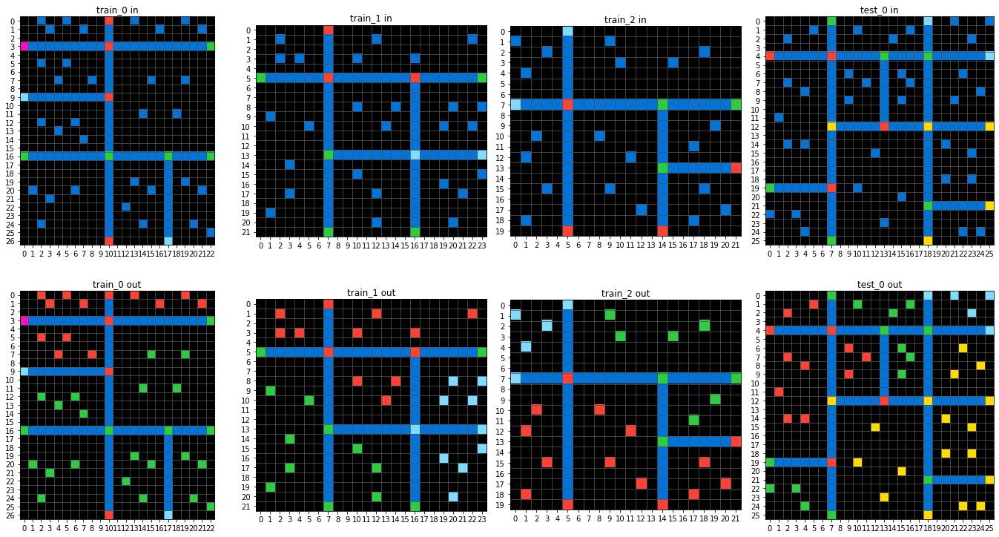

In [2376]:
task = Task(id_to_filepath['e681b708'])
task.plot()

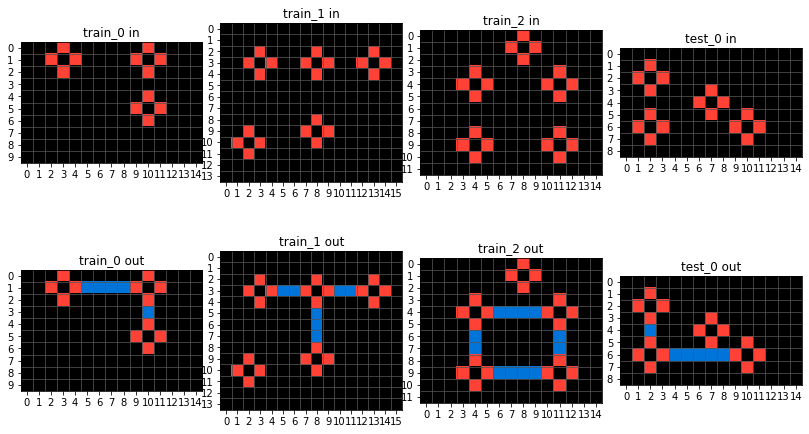

In [1541]:
task = Task(id_to_filepath['60a26a3e'])
task.plot()

In [281]:
for i, (x,y) in enumerate(task.examples):
    if y is not None:
        input_dist = np.bincount(np.ravel(x), minlength=10) / x.size
        output_dist = np.bincount(np.ravel(y), minlength=10) / y.size
#         input_dist = [np.bincount(np.ravel(x)) for s in task.input_palettes[i]]
#         output_dist = [frequency(x, s) for s in task.output_palettes[i]]
    break
    
input_dist = input_dist[1:]
output_dist = output_dist[1:]

In [283]:
input_delta = np.divide(input_dist - output_dist, 
                  input_dist, 
                  out=np.zeros_like(input_dist), 
                  where=(input_dist != 0))
output_delta = np.divide(output_dist - input_dist, 
                         output_dist, 
                         out=np.zeros_like(output_dist), 
                         where=(output_dist != 0))
input_delta, output_delta

(array([ 0.        ,  0.        ,  0.        ,  0.        , -1.23076923,
         0.        ,  0.08333333,  0.16666667,  0.        ]),
 array([ 0.        ,  0.        ,  0.        ,  0.        ,  0.55172414,
         0.        , -0.09090909, -0.2       ,  0.        ]))

In [276]:
{idx_to_color[i]: input_delta[i] for i in range(len(delta))}

{'black': 0.09929078014184407,
 'blue': 0.0,
 'red': 0.0,
 'green': 0.0,
 'yellow': 0.0,
 'grey': -1.2307692307692308,
 'pink': 0.0,
 'orange': 0.08333333333333334,
 'light blue': 0.16666666666666669,
 'brown': 0.0}

* color
    
<!-- a. (recommendation) The color exists in ALL example (input AND output)
        and DOESNT change (or changes very little)
            - SHOULD TAKE THE DISTRIBUTION OF THE COLORS FROM INPUT TO OUTPUT.
                - if the distribution for the color changes then the color is important 
-->
    1. color exists in all inputs, but not output, while all other colors exist
       in in both input and output
    2. Same as 1, but the color exists in all output and not input
    3. IF 1 and 2 do not hold, check if the distribution from input to output changes w.r.t the other colors


## channel orderings

- color
    - 

- spatial
    - each color takes on different objects or maps input to output as a different object

- object

In [90]:
same_shape = []
has_input_markers = {}
has_output_markers = {}
new_symbols = {}
missing_symbols = {}

for task_id in eval_ids:
    task = Task(id_to_filepath[task_id])
    if len(task.input_markers) > 0:
        has_input_markers[task_id] = task.input_markers
    if len(task.output_markers) > 0:
        has_output_markers[task_id] = task.output_markers
        
    if len(task.new_symbols) > 0:
        new_symbols[task_id] = task.new_symbols
    if len(task.missing_symbols) > 0:
        missing_symbols[task_id] = task.missing_symbols
        
    if np.alltrue(task.input_shapes[:task.num_train] == task.output_shapes[:task.num_train]):
        same_shape.append(task_id)

- color
    1a. (recommendation) The color exists in ALL example (input AND output)
    and DOESNT change (or changes very little)
        - SHOULD TAKE THE DISTRIBUTION OF THE COLORS FROM INPUT TO OUTPUT.
            - if the distribution for the color changes then the color is important
    1. color exists in all inputs, but no output<!--, while all other colors exist
       in both input and output -->
        - the objects should be unique
    2. color exists in all output, but no input
        - the objects should be unique
    3. color exists in all examples (input and output), and has a unique object
    4. New colors that don't exist in the input

ef26cbf6
--------
input markers   : ['blue']
missing symbols : ['blue']


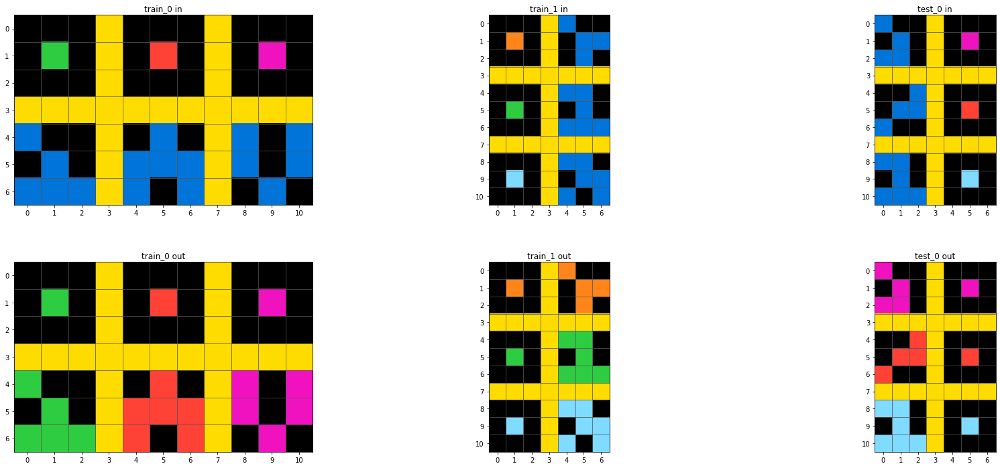

626c0bcc
--------
input markers   : ['light blue']
output markers  : ['blue', 'green', 'yellow', 'red']
new symbols     : ['blue', 'green', 'yellow', 'red']
missing symbols : ['light blue']


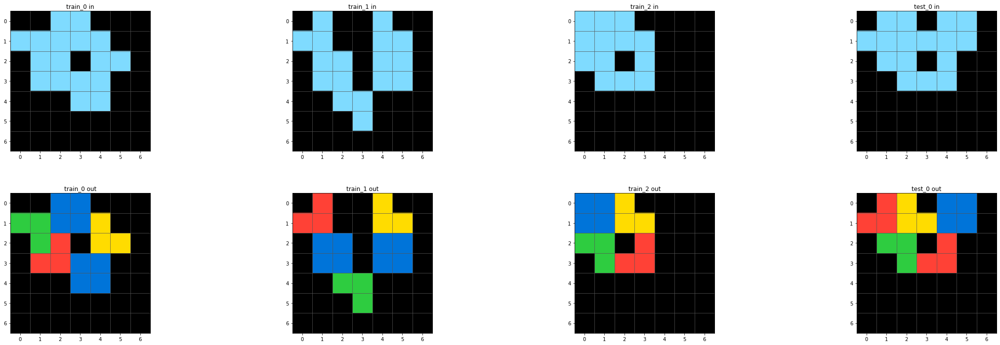

9b365c51
--------
input markers   : ['light blue']
missing symbols : ['light blue']


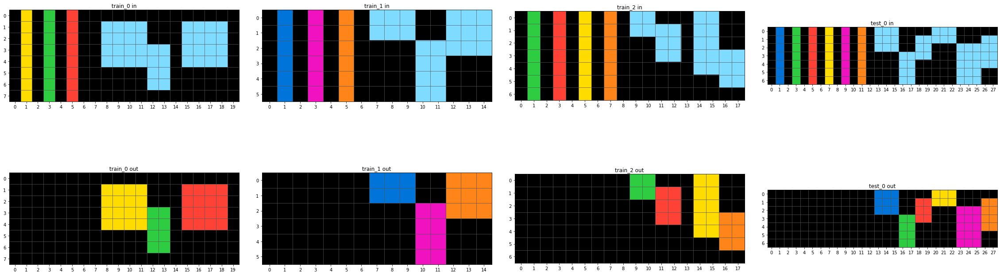

d4c90558
--------
input markers   : ['grey']
missing symbols : ['grey']


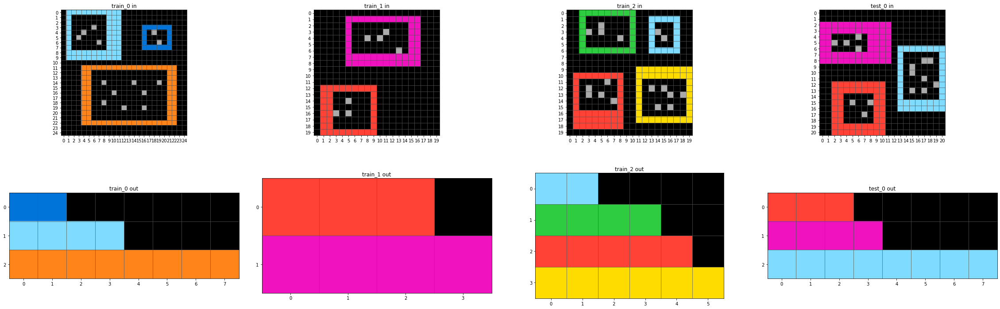

e99362f0
--------
input markers   : ['yellow']
missing symbols : ['yellow']


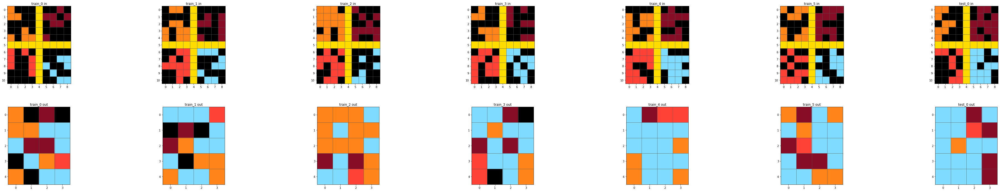

477d2879
--------
input markers   : ['blue']
missing symbols : ['blue']


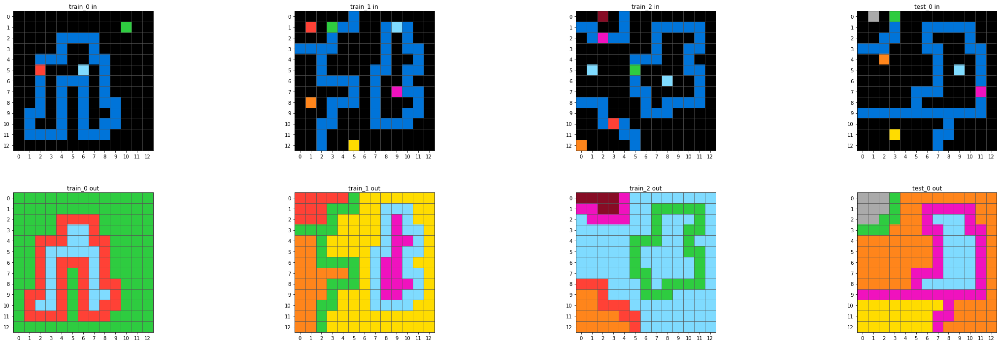

4852f2fa
--------
input markers   : ['yellow']
missing symbols : ['yellow']


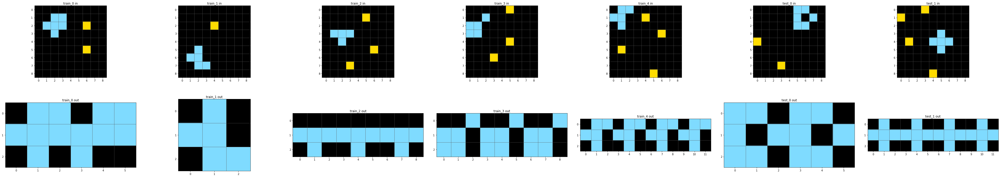

9a4bb226
--------
input markers   : ['orange']
missing symbols : ['orange']


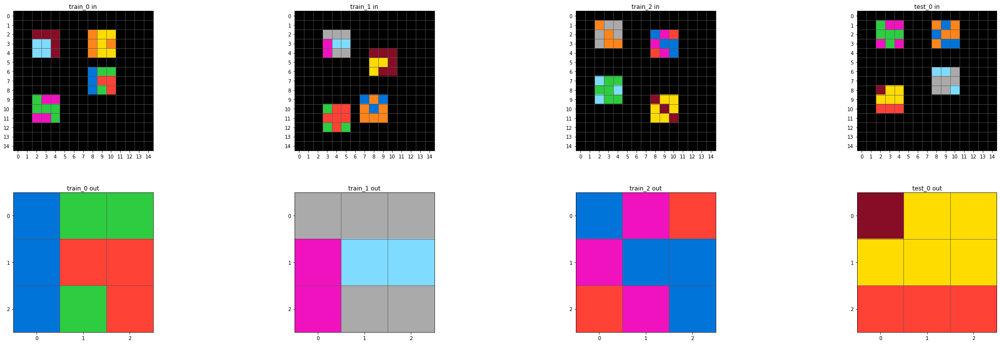

ed74f2f2
--------
input markers   : ['grey']
new symbols     : ['red', 'green', 'blue']
missing symbols : ['grey']


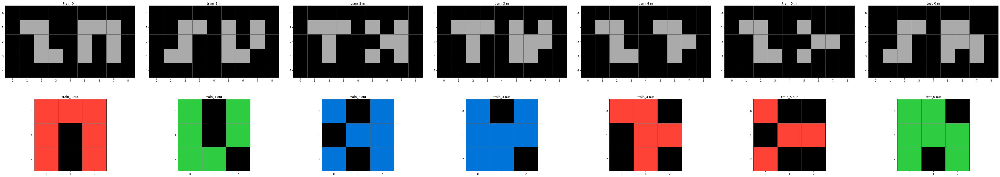

639f5a19
--------
input markers   : ['light blue']
output markers  : ['pink', 'blue', 'yellow', 'red', 'green']
new symbols     : ['pink', 'blue', 'yellow', 'red', 'green']
missing symbols : ['light blue']


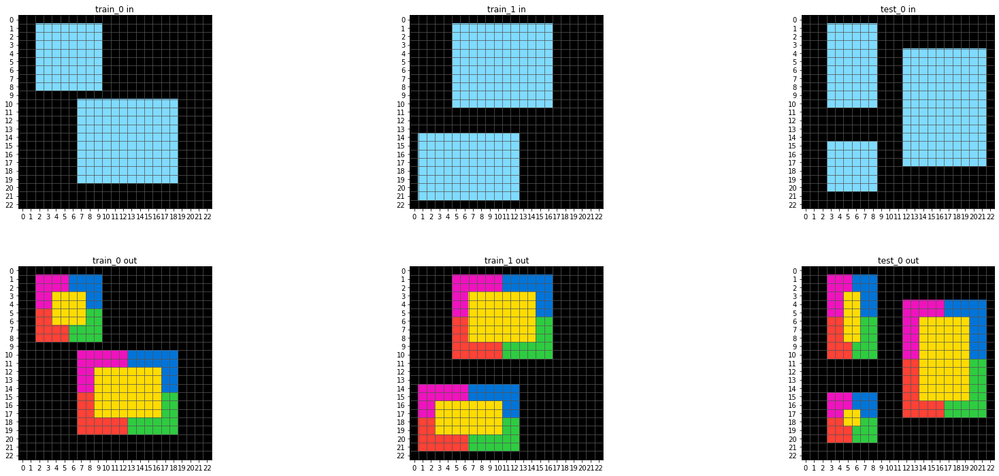

be03b35f
--------
input markers   : ['red']
missing symbols : ['red']


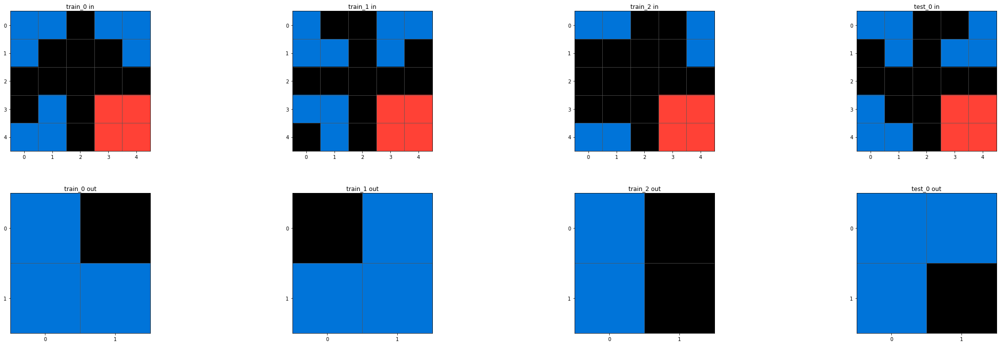

b4a43f3b
--------
input markers   : ['grey']
missing symbols : ['grey']


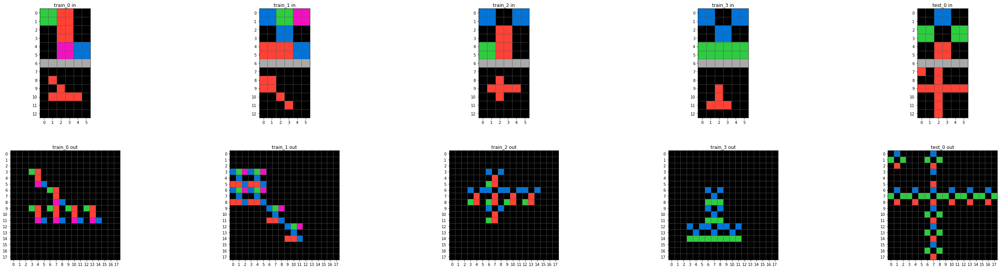

929ab4e9
--------
input markers   : ['red']
missing symbols : ['red']


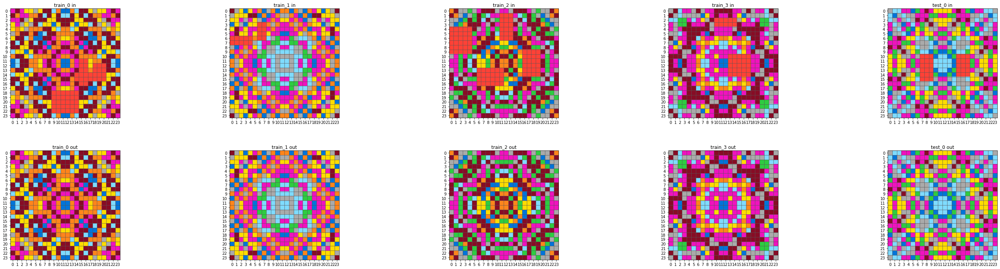

d47aa2ff
--------
input markers   : ['grey']
output markers  : ['red', 'blue']
new symbols     : ['red', 'blue']
missing symbols : ['grey']


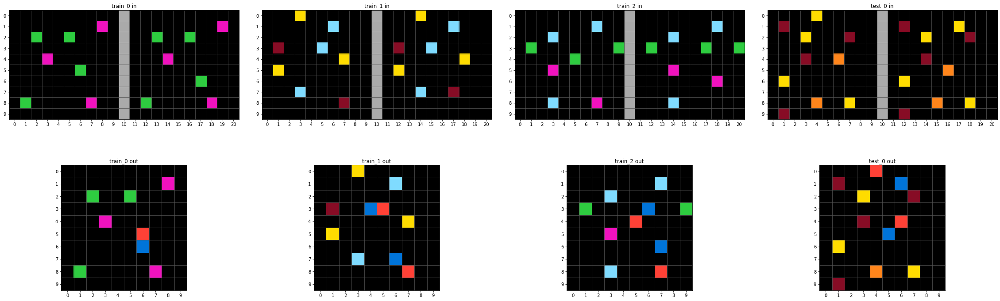

c8b7cc0f
--------
input markers   : ['blue']
missing symbols : ['blue']


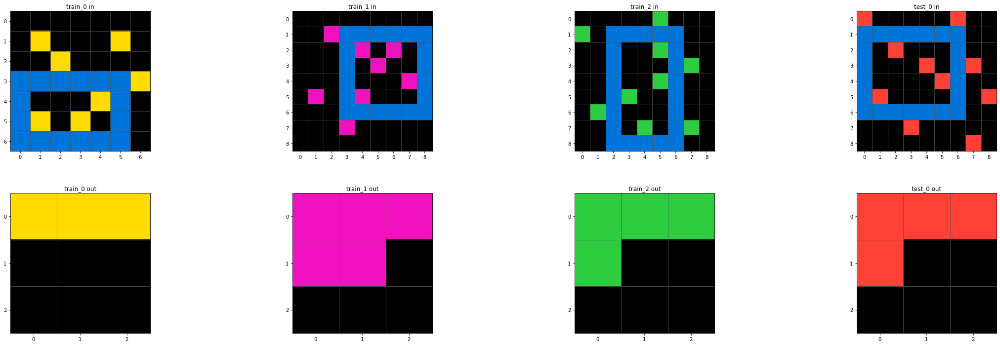

67b4a34d
--------
input markers   : ['green']
missing symbols : ['green']


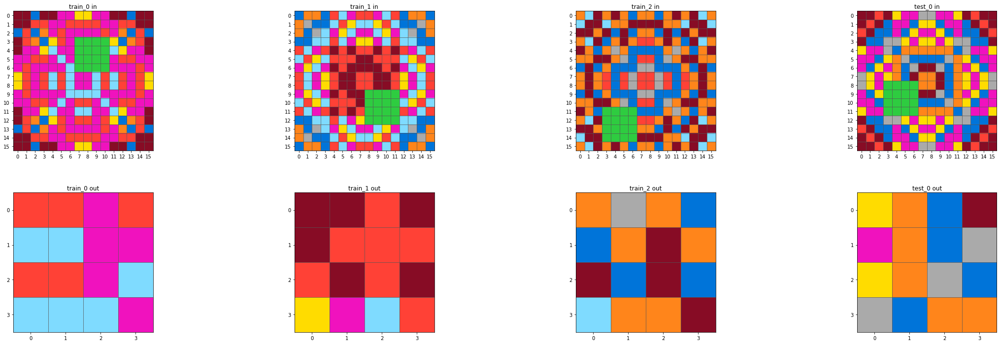

f9d67f8b
--------
input markers   : ['brown']
missing symbols : ['brown']


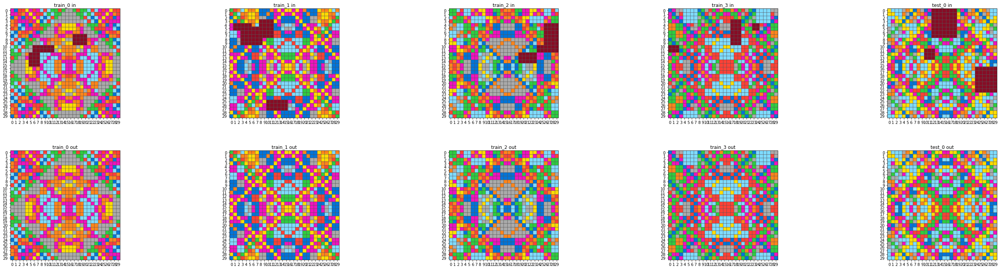

de493100
--------
input markers   : ['orange']
missing symbols : ['orange']


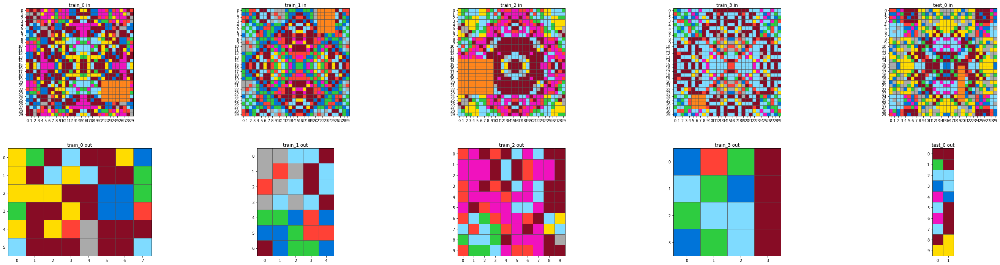

e872b94a
--------
input markers   : ['grey']
missing symbols : ['grey']


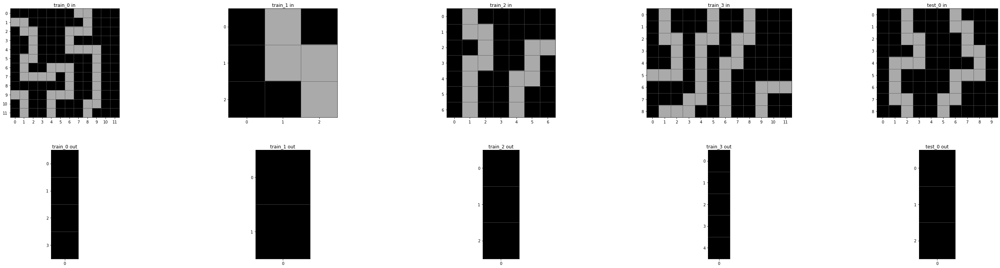

bf699163
--------
input markers   : ['light blue', 'orange']
missing symbols : ['light blue', 'green', 'orange', 'pink']


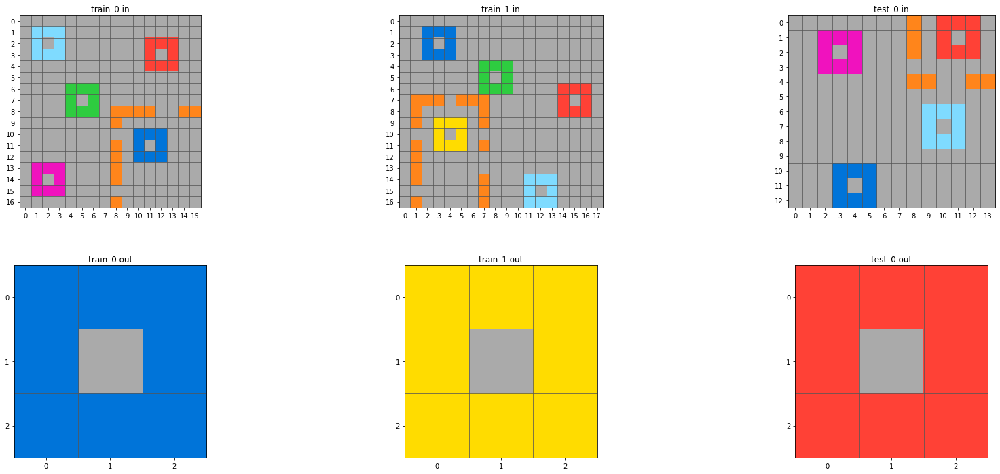

bbb1b8b6
--------
input markers   : ['grey']
missing symbols : ['grey']


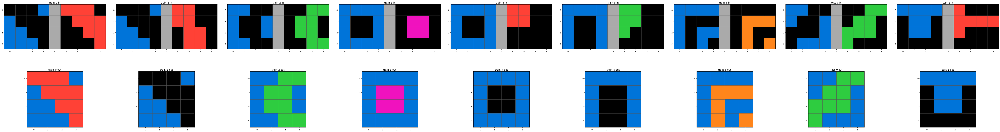

5833af48
--------
input markers   : ['red']
missing symbols : ['red']


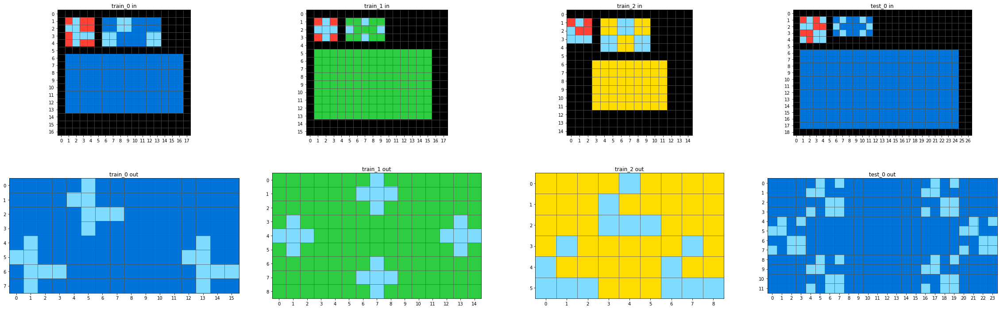

f4081712
--------
input markers   : ['green']
missing symbols : ['green']


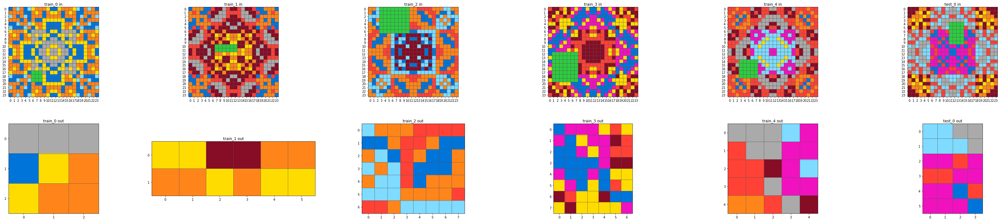

642d658d
--------
input markers   : ['yellow']
missing symbols : ['blue', 'yellow', 'pink', 'orange', 'grey', 'brown']


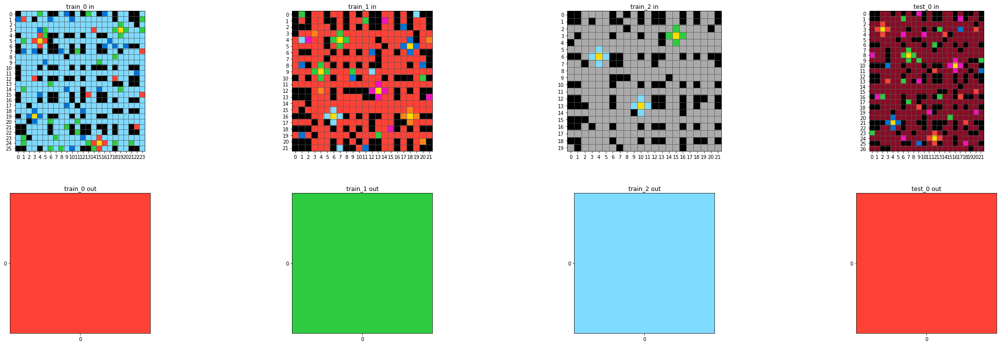

c62e2108
--------
input markers   : ['blue']
missing symbols : ['blue']


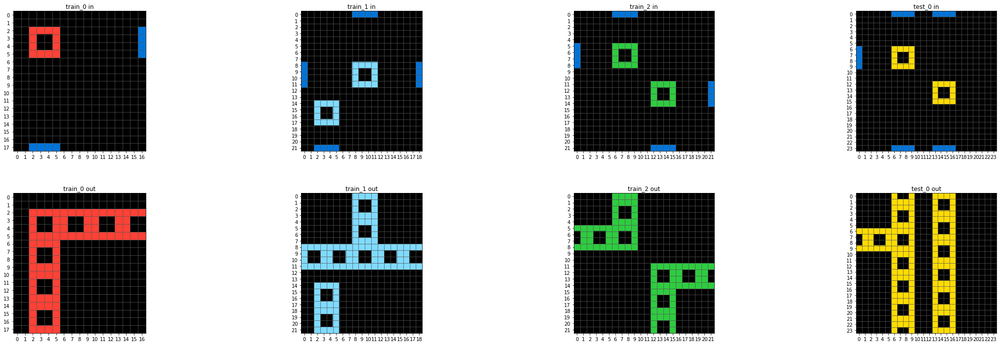

505fff84
--------
input markers   : ['blue', 'light blue']
missing symbols : ['blue', 'light blue']


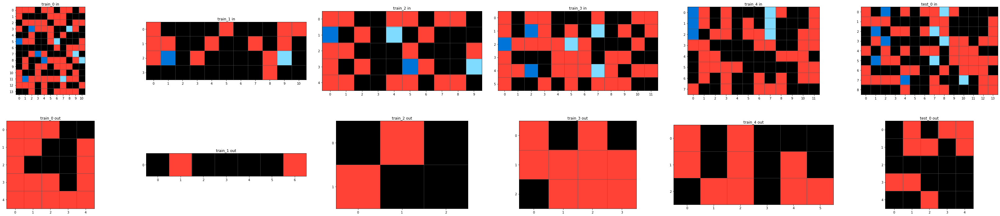

d5c634a2
--------
input markers   : ['red']
output markers  : ['green', 'blue']
new symbols     : ['green', 'blue']
missing symbols : ['red']


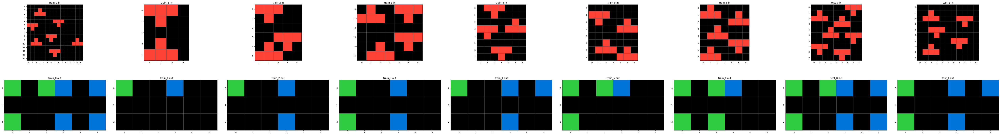

d19f7514
--------
input markers   : ['green', 'grey']
output markers  : ['yellow']
new symbols     : ['yellow']
missing symbols : ['green', 'grey']


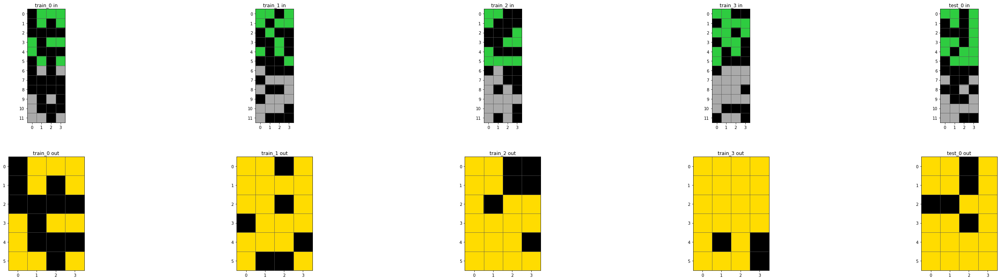

e345f17b
--------
input markers   : ['pink', 'grey']
output markers  : ['yellow']
new symbols     : ['yellow']
missing symbols : ['pink', 'grey']


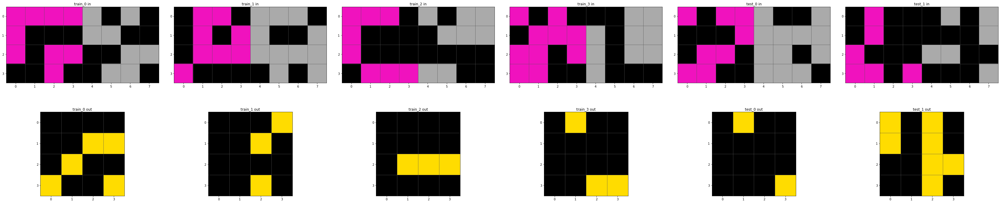

845d6e51
--------
input markers   : ['green']
missing symbols : ['green']


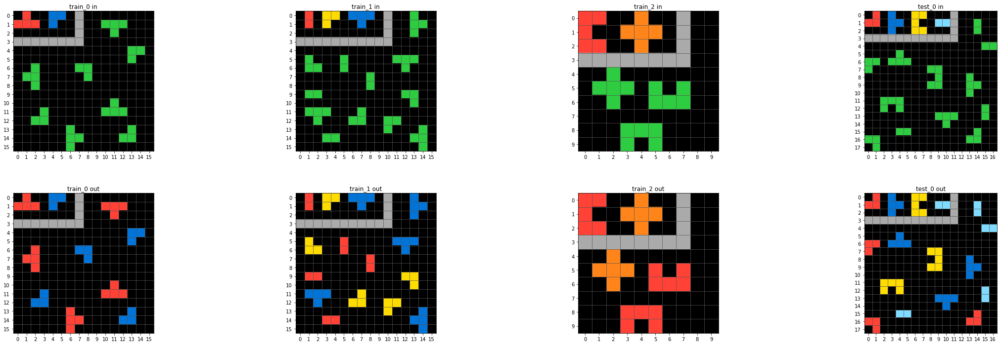

c3202e5a
--------
input markers   : ['green', 'brown', 'pink', 'grey', 'blue']
missing symbols : ['green', 'brown', 'pink', 'grey', 'blue']


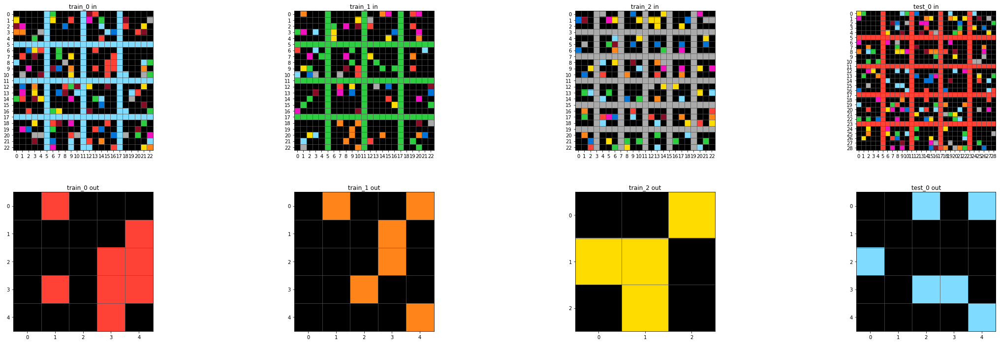

f5c89df1
--------
input markers   : ['red', 'green']
missing symbols : ['red', 'green']


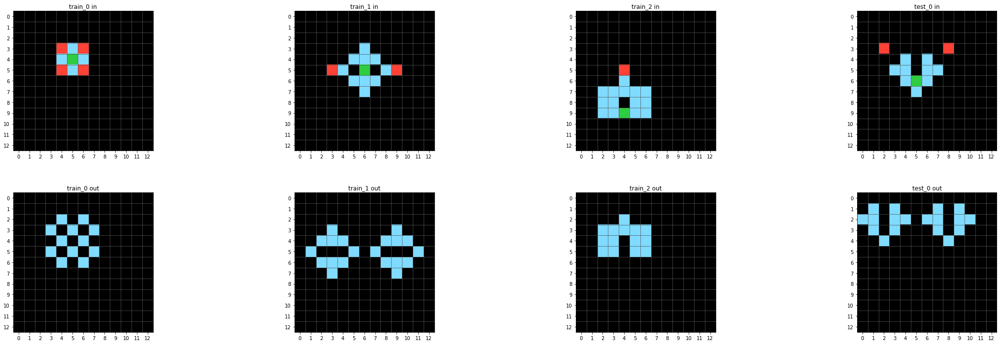

4c177718
--------
input markers   : ['red', 'grey']
missing symbols : ['red', 'grey']


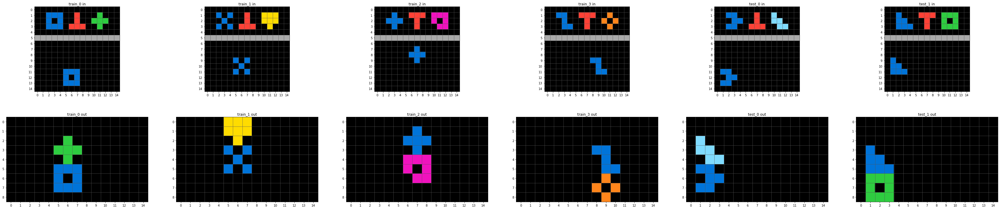

6df30ad6
--------
input markers   : ['grey']
missing symbols : ['orange', 'grey', 'light blue', 'green']


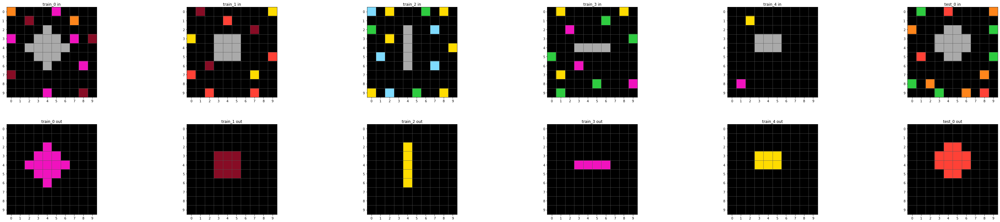

c7d4e6ad
--------
input markers   : ['grey']
missing symbols : ['grey']


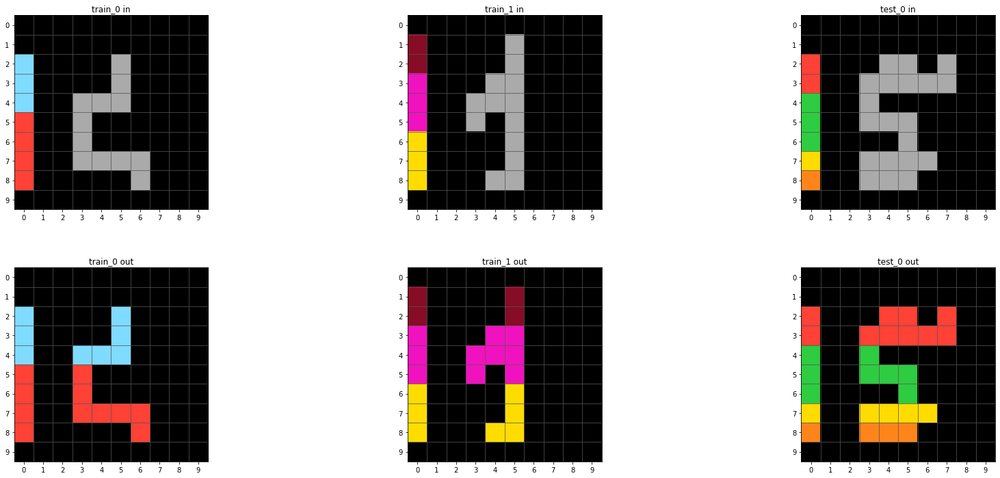

604001fa
--------
input markers   : ['orange', 'blue']
new symbols     : ['green', 'pink', 'yellow', 'light blue']
missing symbols : ['orange', 'blue']


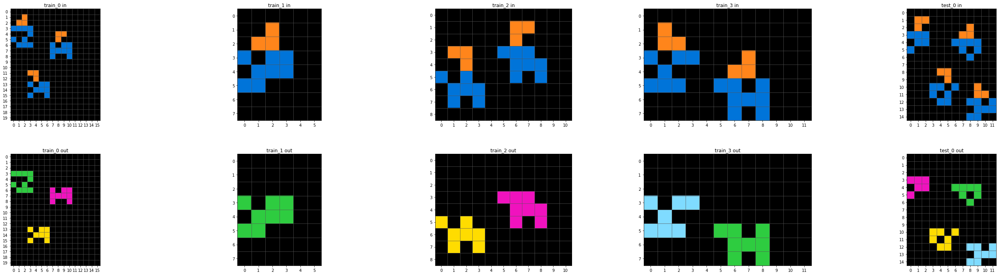

b457fec5
--------
input markers   : ['grey']
missing symbols : ['grey']


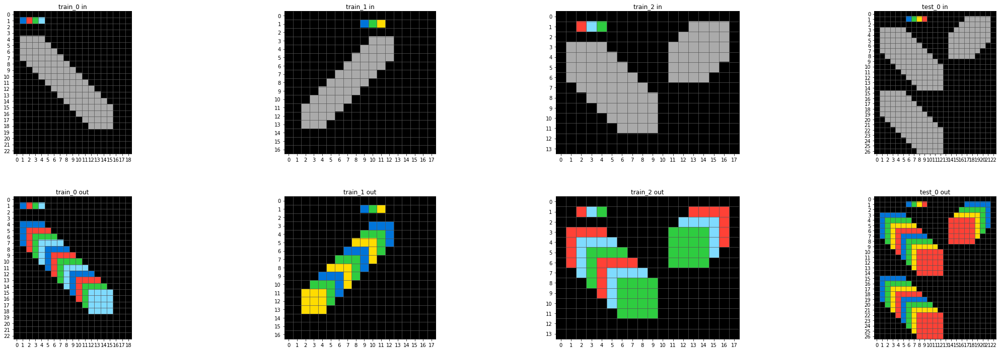

7d18a6fb
--------
input markers   : ['blue']
missing symbols : ['blue']


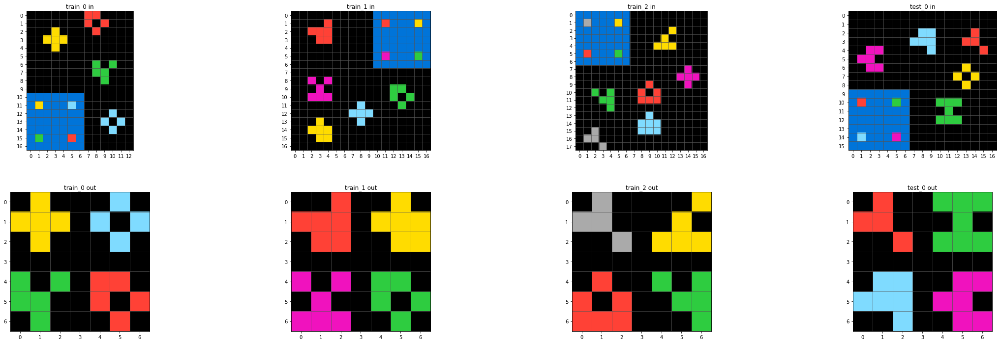

9bebae7a
--------
input markers   : ['pink']
missing symbols : ['pink']


KeyboardInterrupt: 

In [298]:
color_channel_tasks = union(has_input_markers.keys(), 
                            has_output_markers.keys(), 
                            new_symbols.keys(), 
                            missing_symbols.keys())

for task_id in color_channel_tasks:
    task = Task(id_to_filepath[task_id])
    print(f"{task_id}\n{'-'*8}")
    if task_id in has_input_markers.keys():
        print(f'input markers   : {[idx_to_color[c] for c in has_input_markers[task_id]]}')
    if task_id in has_output_markers.keys():
        print(f'output markers  : {[idx_to_color[c] for c in has_output_markers[task_id]]}')
    if task_id in new_symbols.keys():
        print(f'new symbols     : {[idx_to_color[c] for c in new_symbols[task_id]]}')
    if task_id in missing_symbols.keys():
        print(f'missing symbols : {[idx_to_color[c] for c in missing_symbols[task_id]]}')
    task.plot()

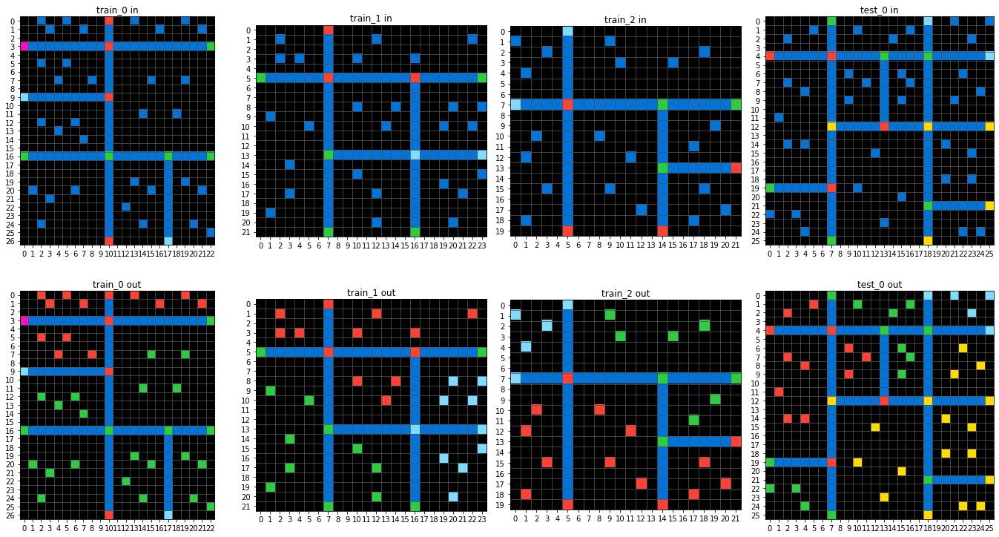

In [2549]:
task.plot()

981571dc
[True, True, True, True, True]


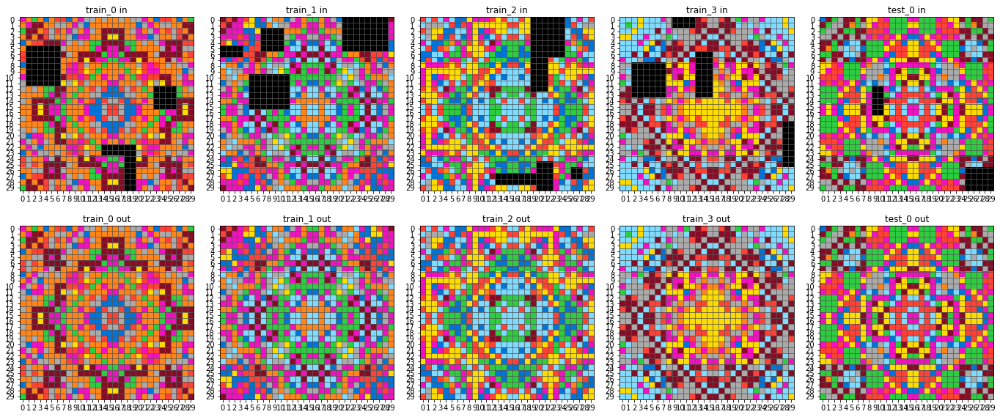

f9d67f8b
[True, True, True, True, True]


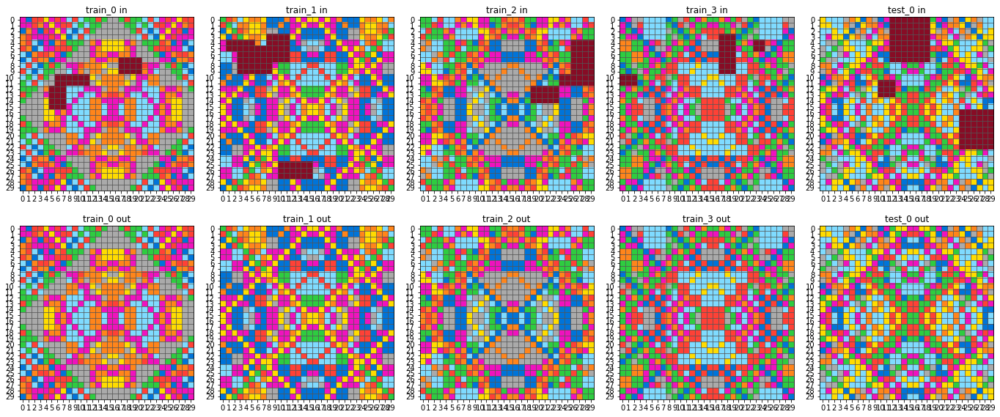

47996f11
[True, True, True, True, True]


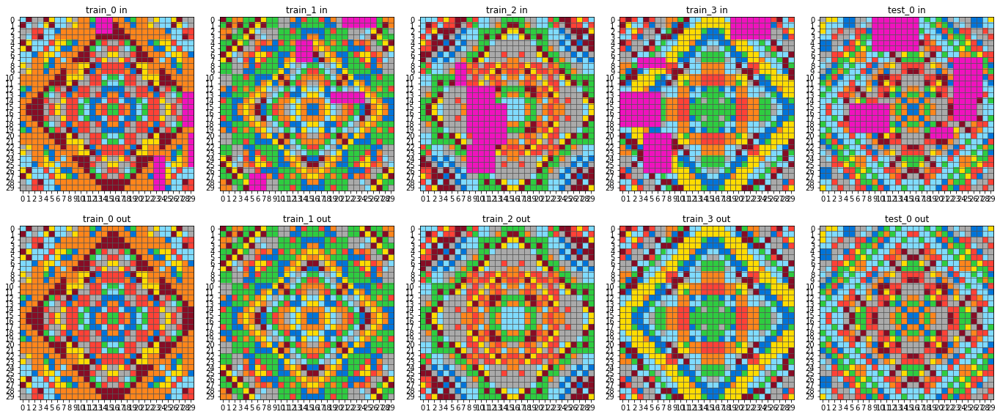

de493100
no


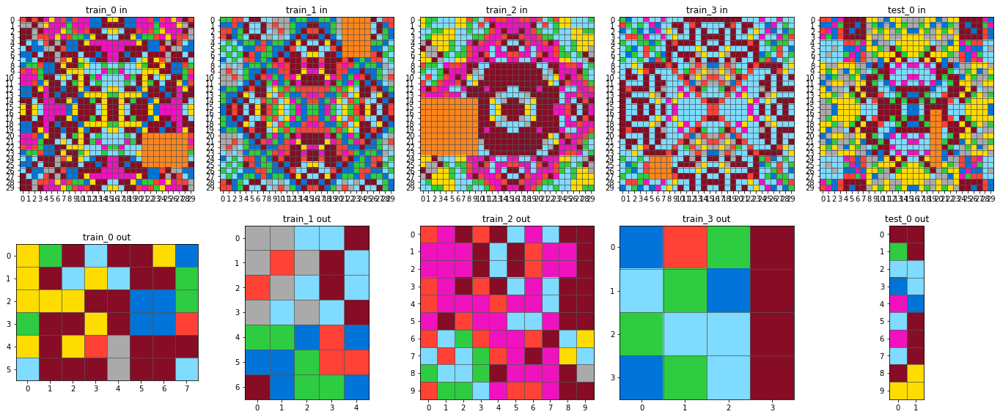

af22c60d
[True, True, True, True, True]


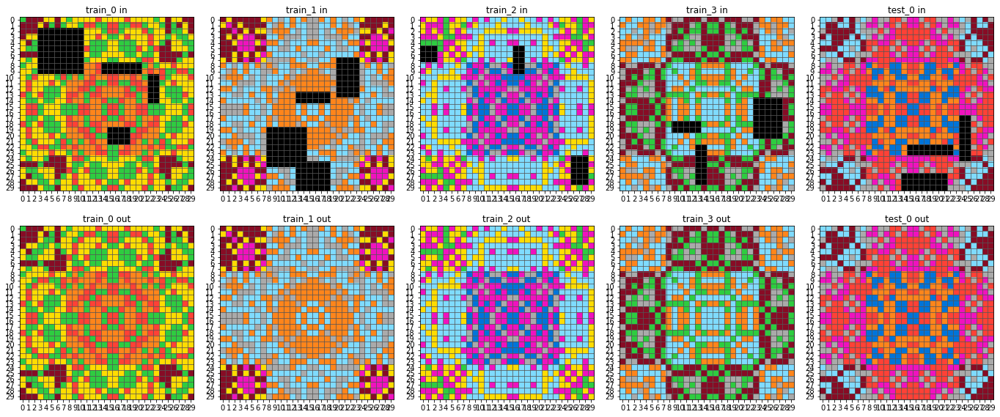

929ab4e9
[True, True, True, True, True]


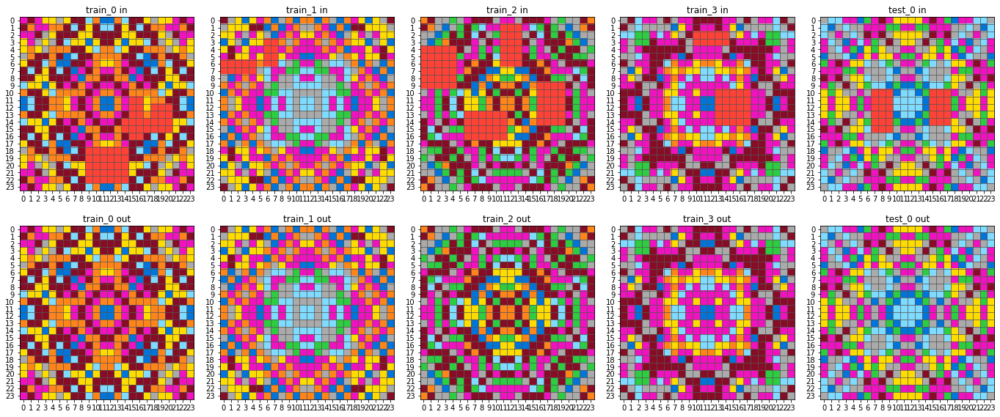

e66aafb8
no


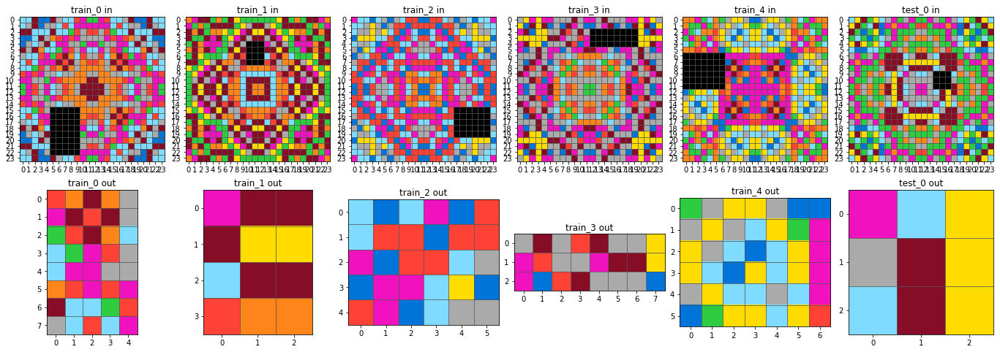

c3202e5a
no


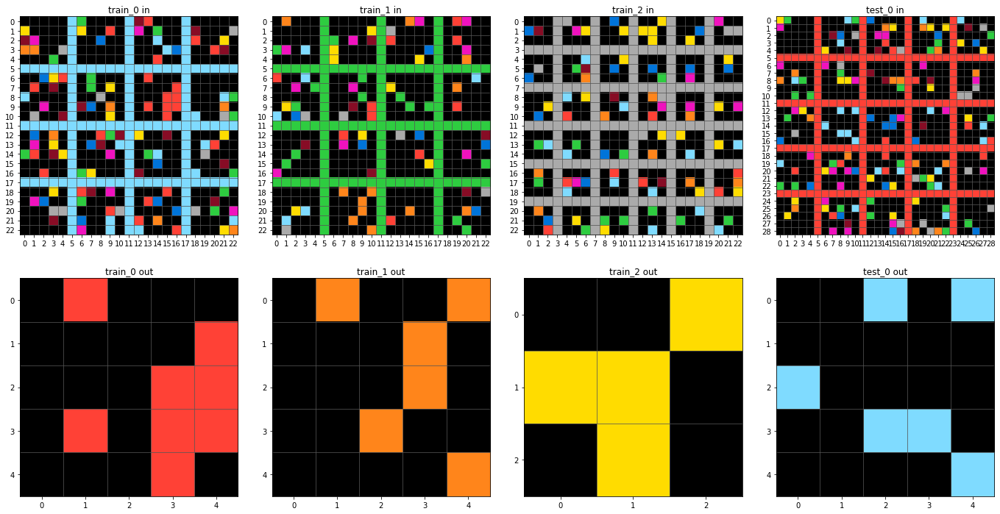

f4081712
no


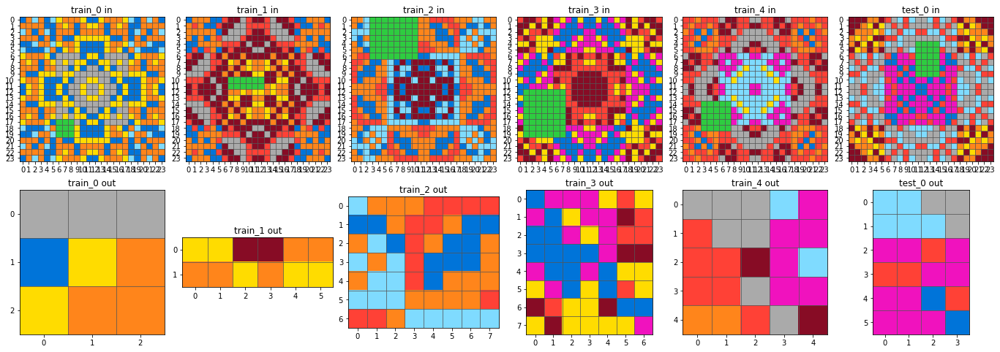

50f325b5
no


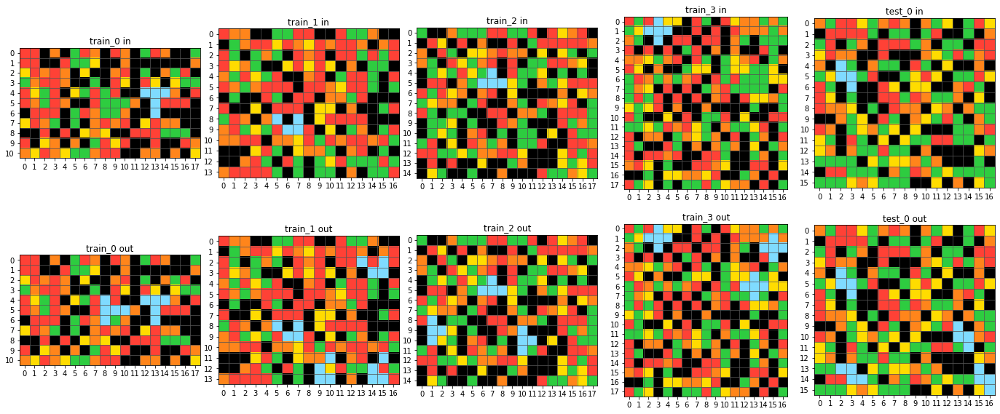

642d658d
no


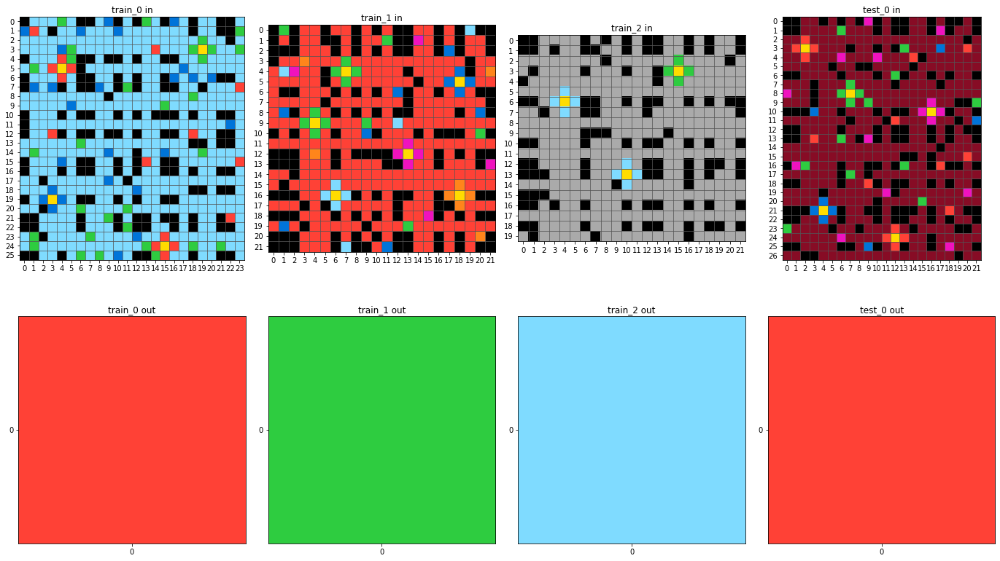

79369cc6
[True, True, True, False]


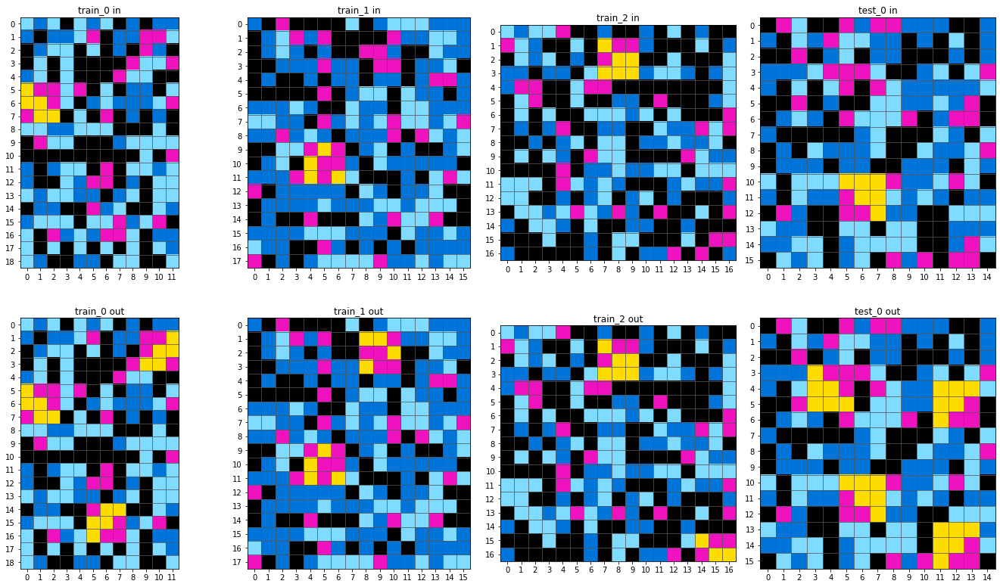

e2092e0c
[True, False, False, True]


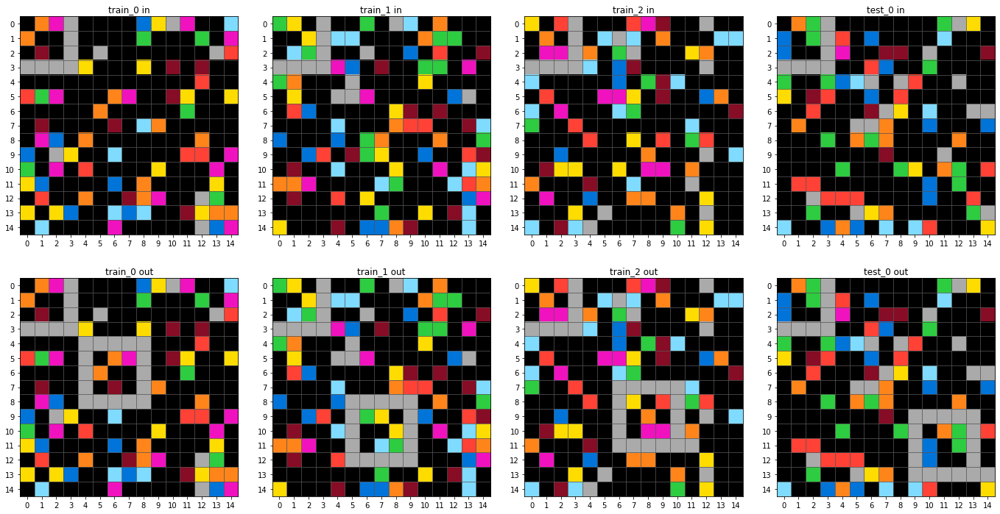

f0df5ff0
[False, False, False, False]


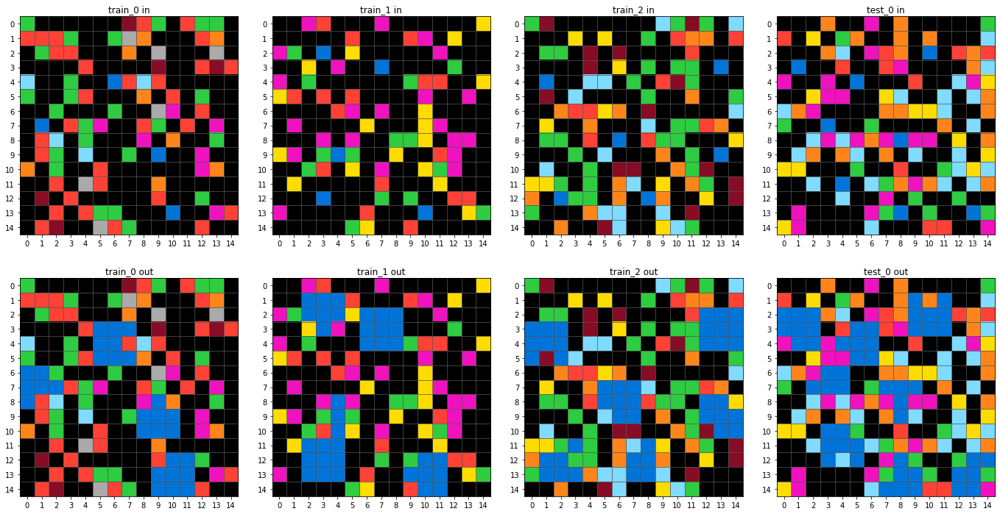

9caba7c3
[False, True, False, False]


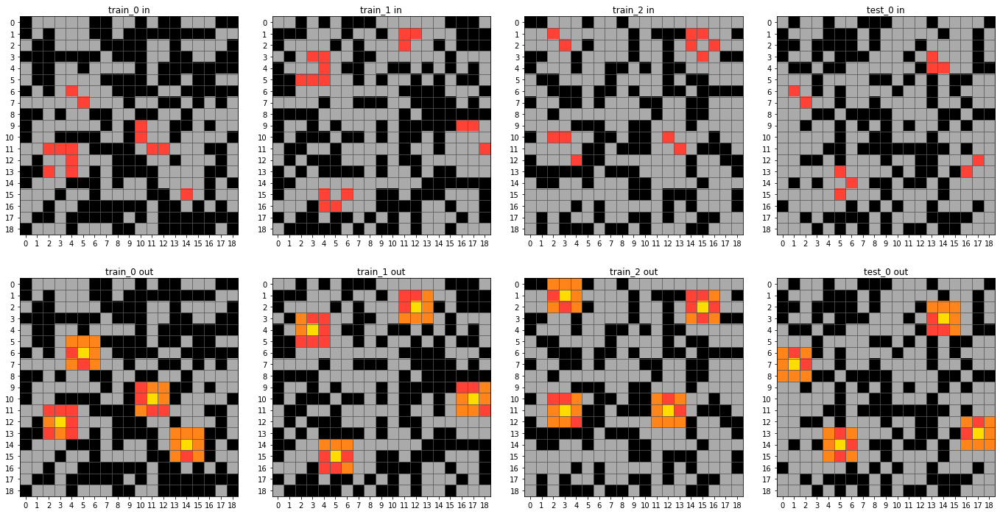

aab50785
no


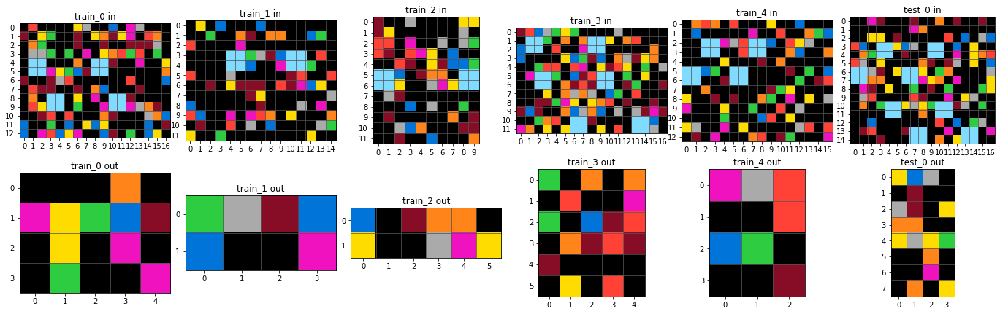

67b4a34d
no


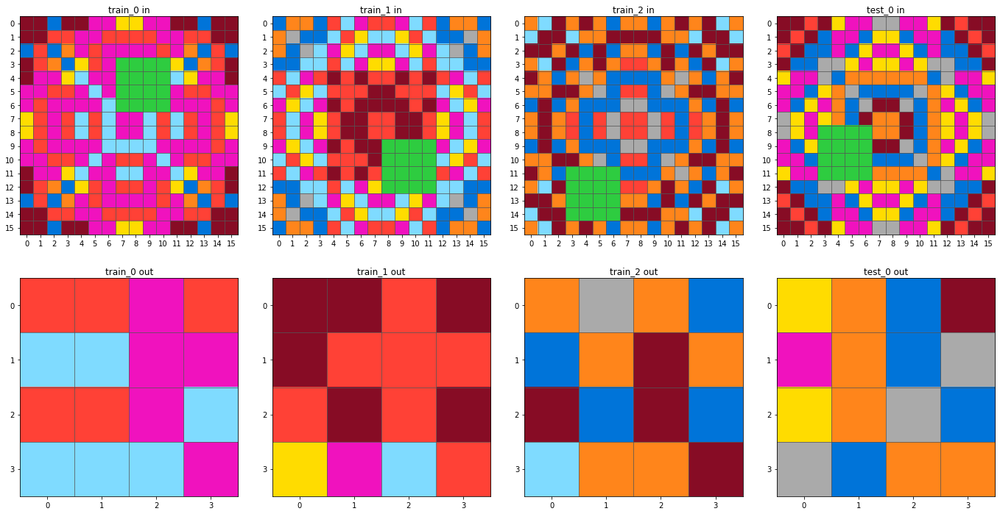

c663677b
[True, True, True, True]


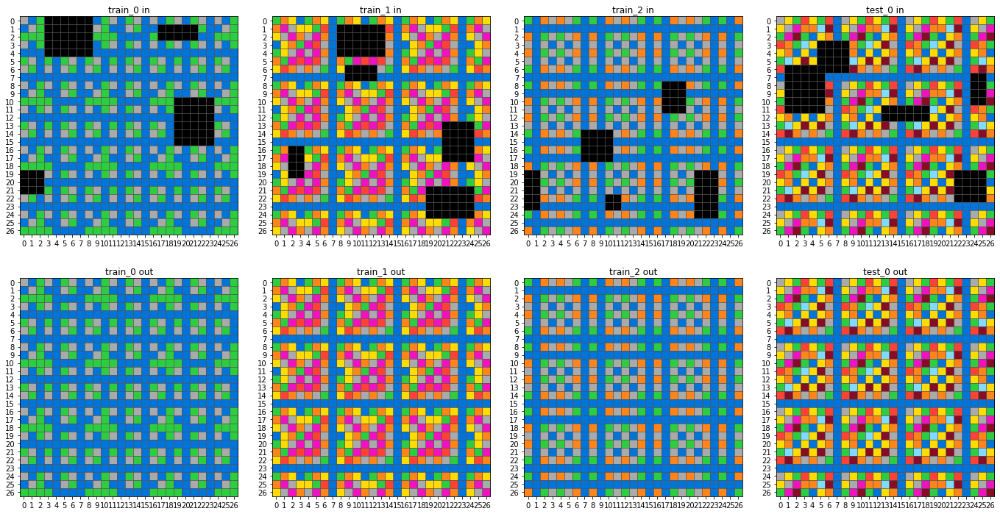

bb52a14b
[True, True, True, True]


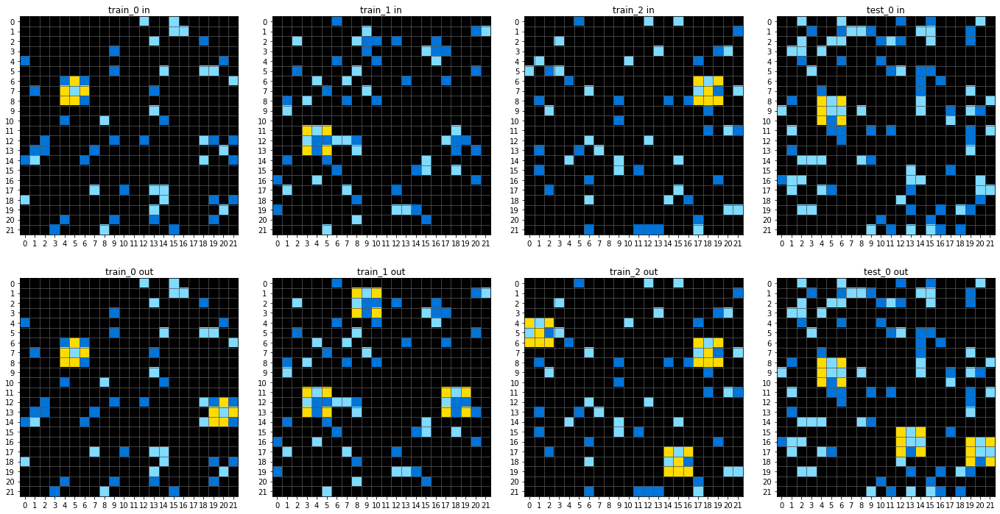

903d1b4a
[True, True, True, True, True]


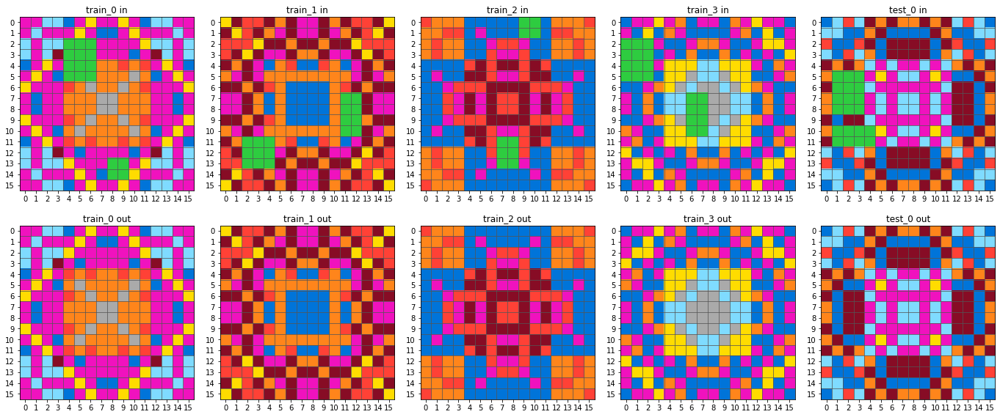

4aab4007
[True, True, True, True]


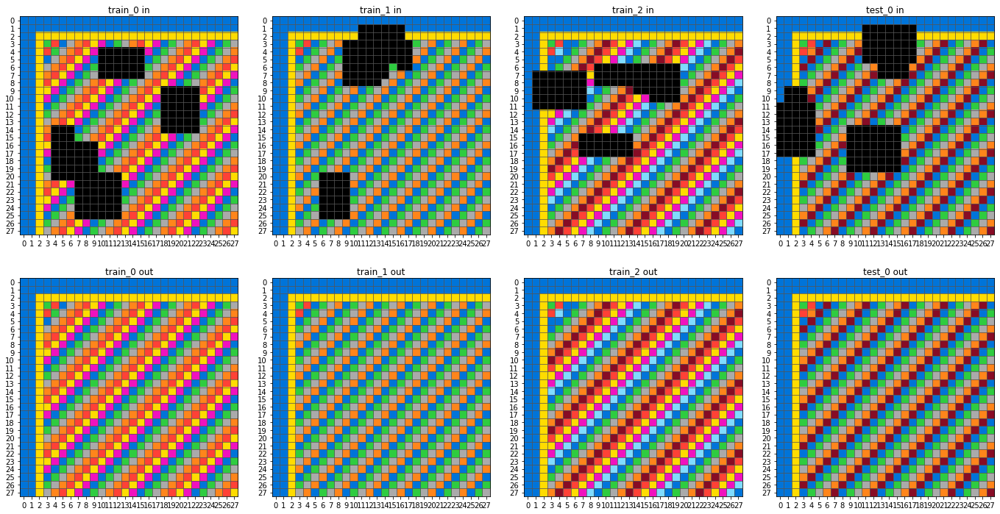

ea959feb
[True, True, False, False]


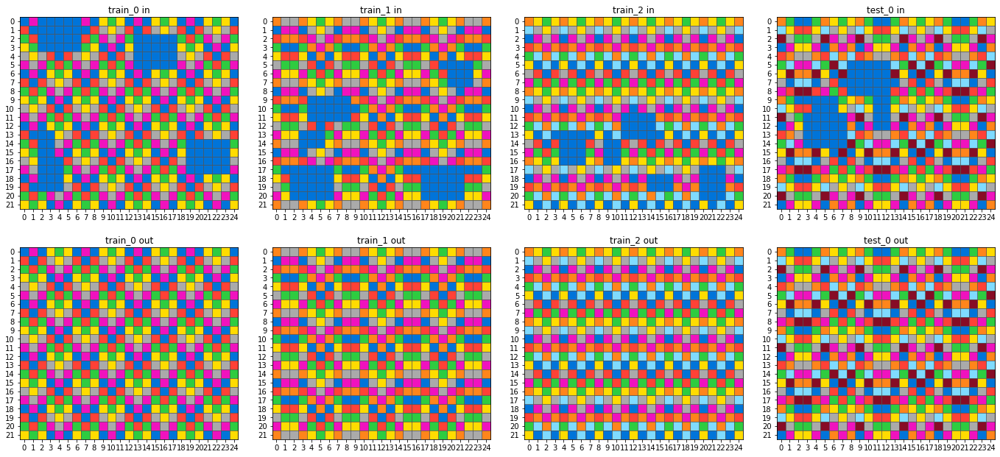

e95e3d8e
[True, True, True, True]


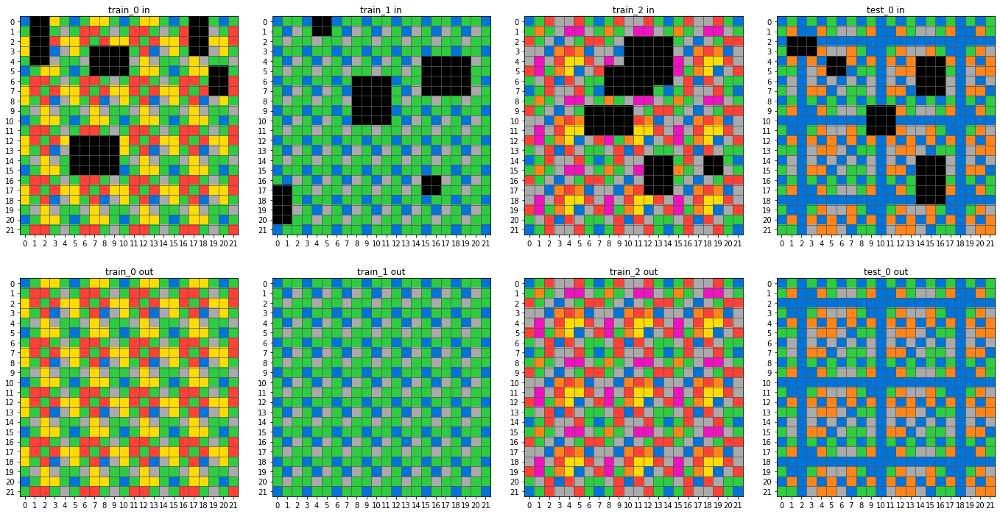

e88171ec
[False, False, False, True]


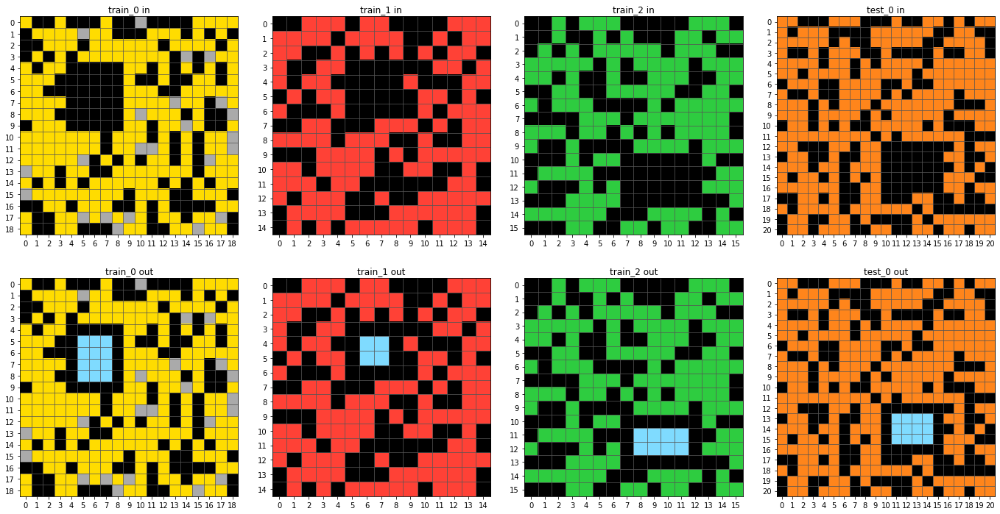

e681b708
[True, False, False, False]


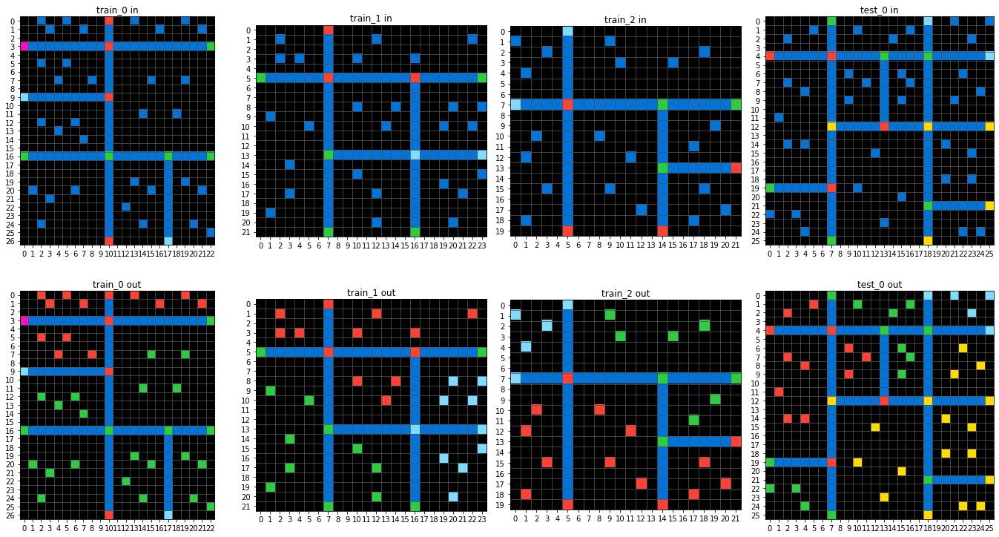

95a58926
[True, True, True, True]


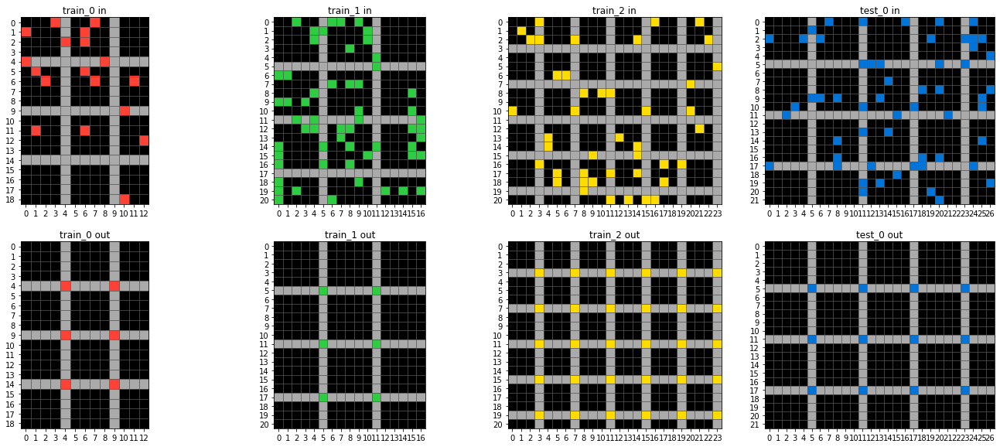

aee291af
no


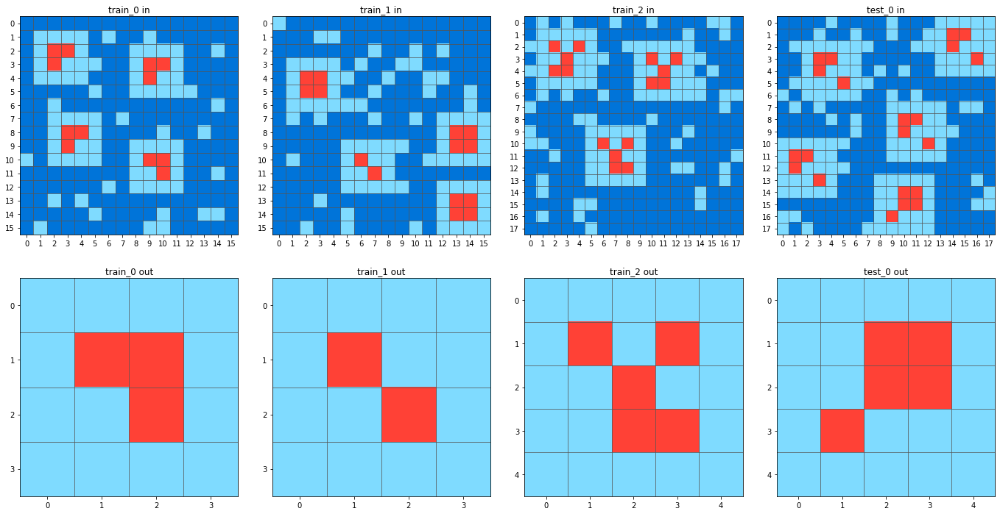

d94c3b52
[False, True, False, False]


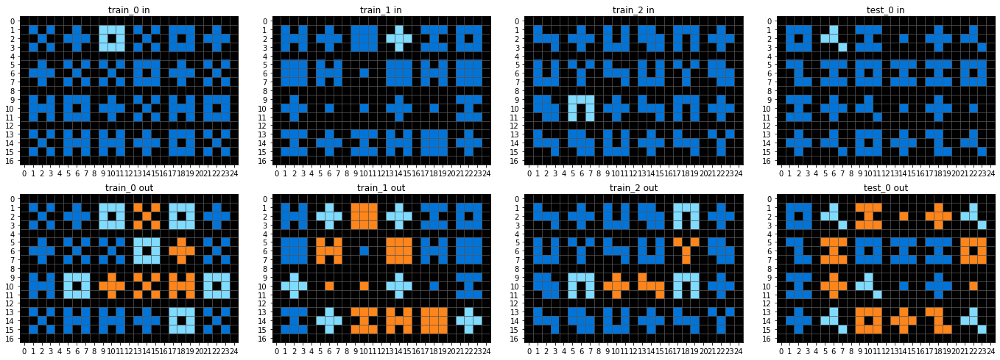

93c31fbe
[True, True, True, True]


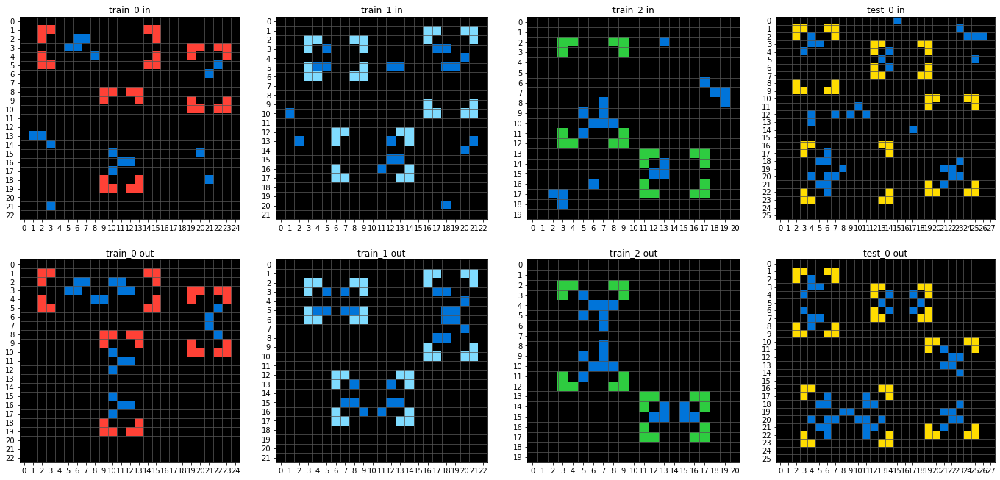

896d5239
[False, False, False, False]


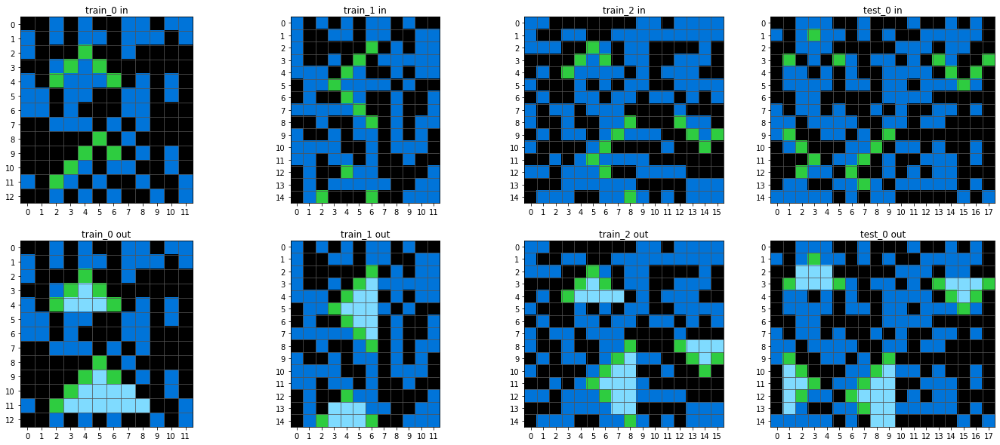

891232d6
no


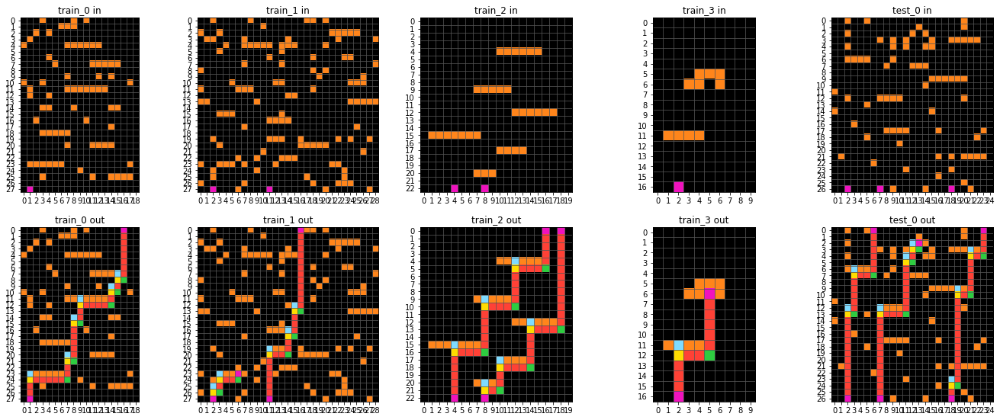

42918530
[True, True, True, True, True]


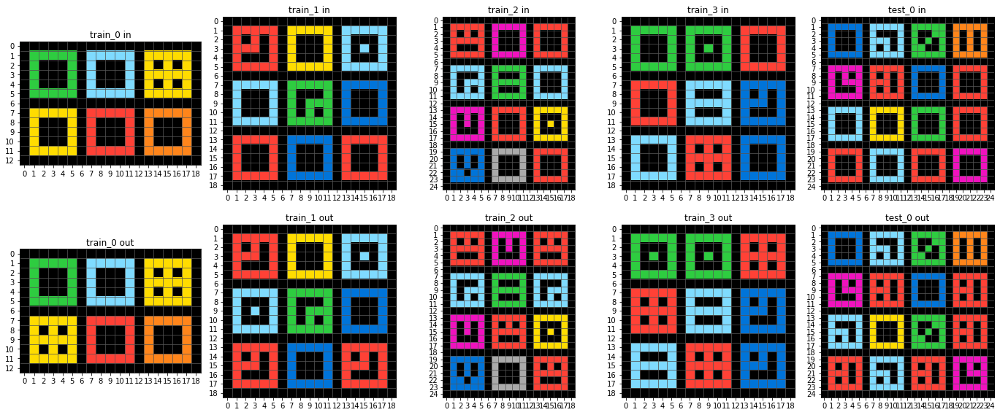

b20f7c8b
[True, True, True, True]


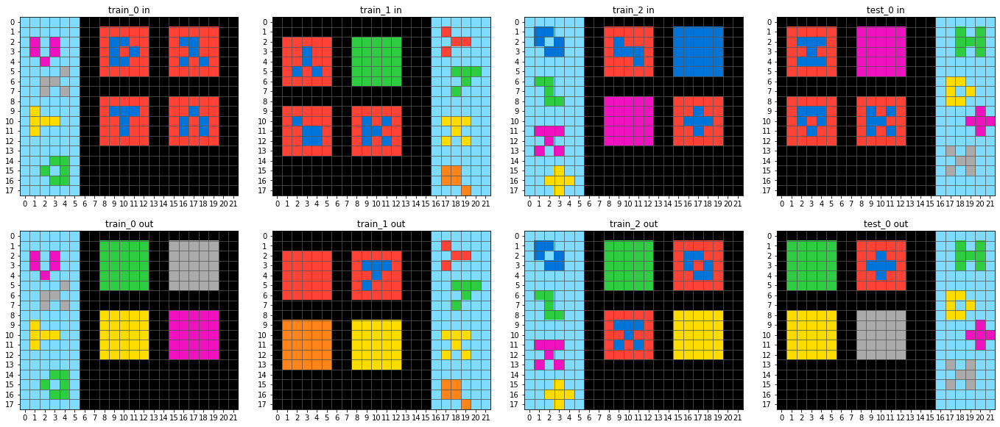

e9bb6954
[True, True, False, True, False]


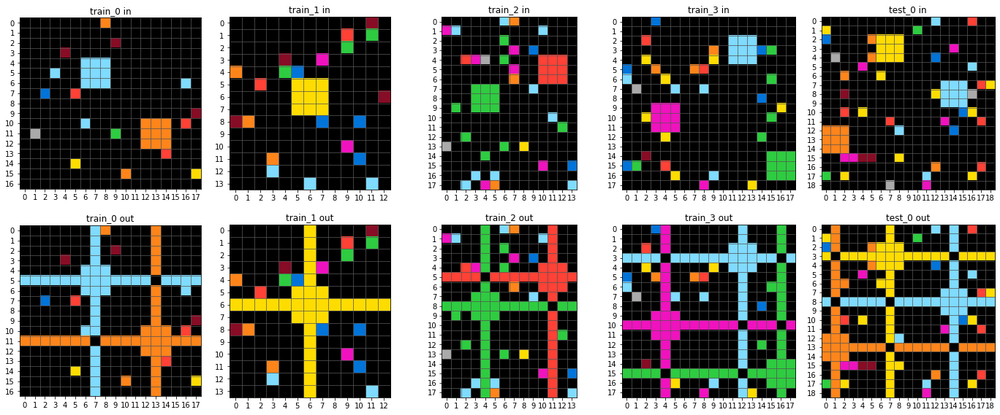

7bb29440
no


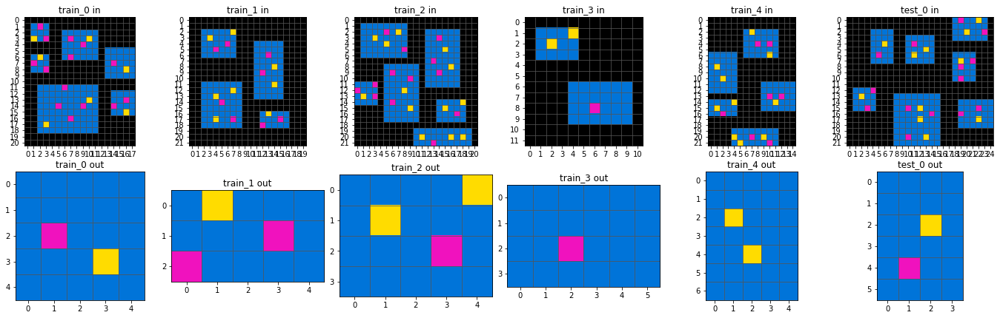

4b6b68e5
[False, False, True, False]


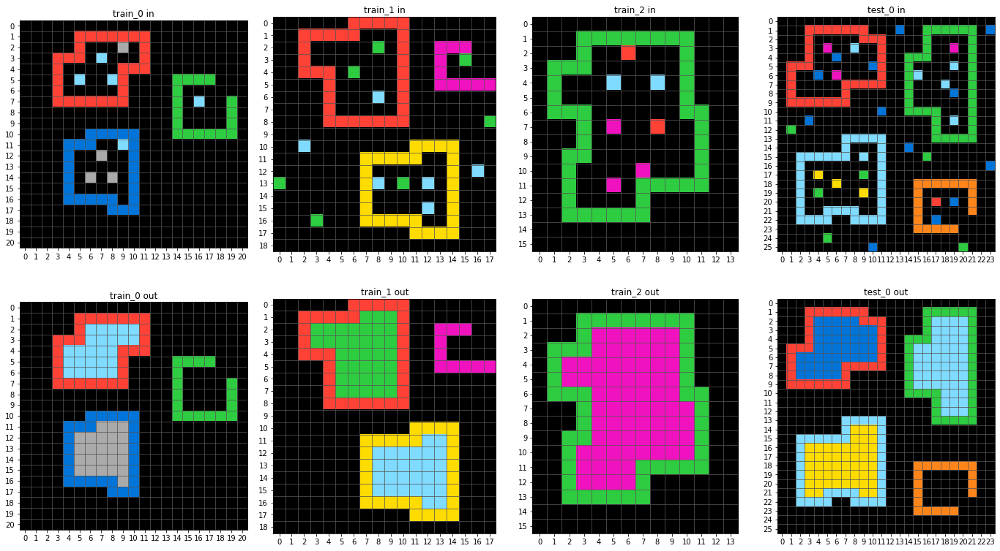

d56f2372
no


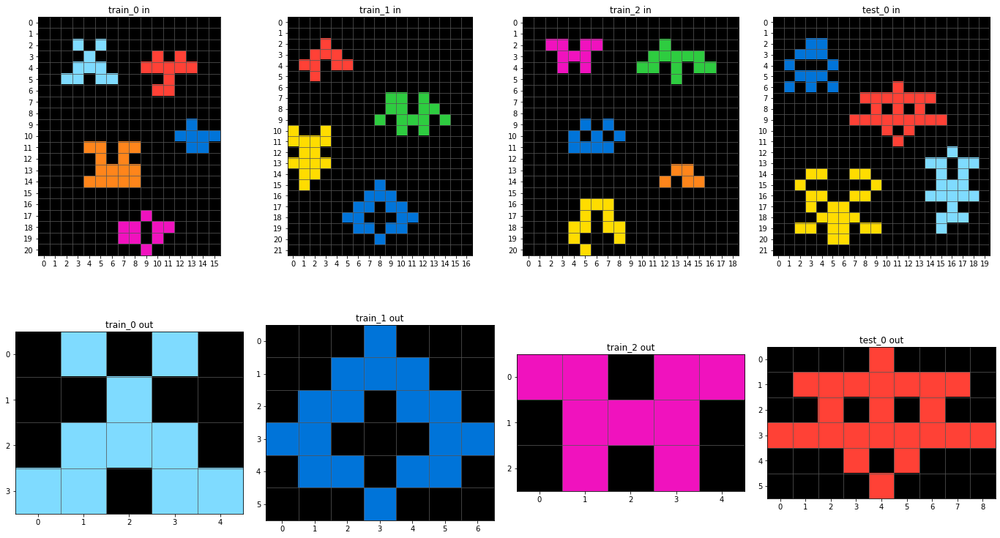

b9630600
[True, False, True, True]


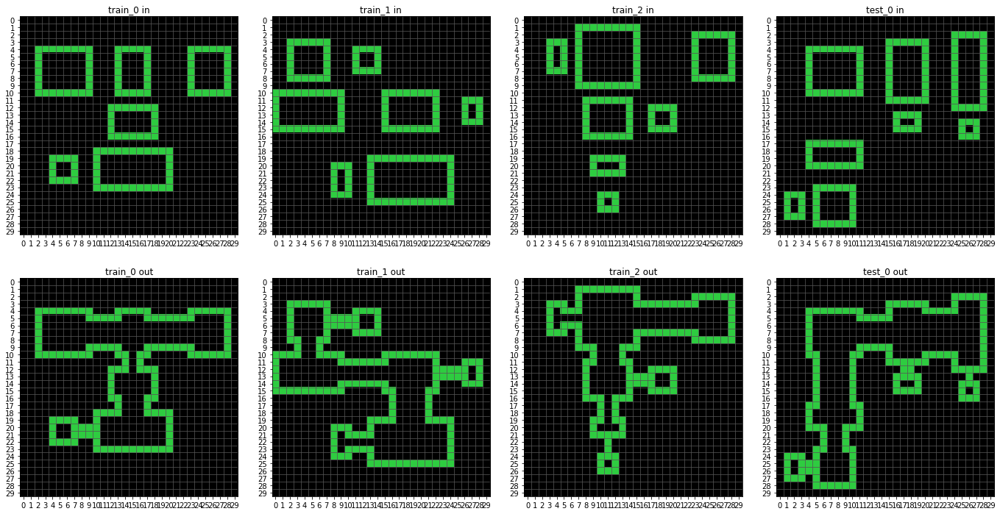

f823c43c
[True, True, True]


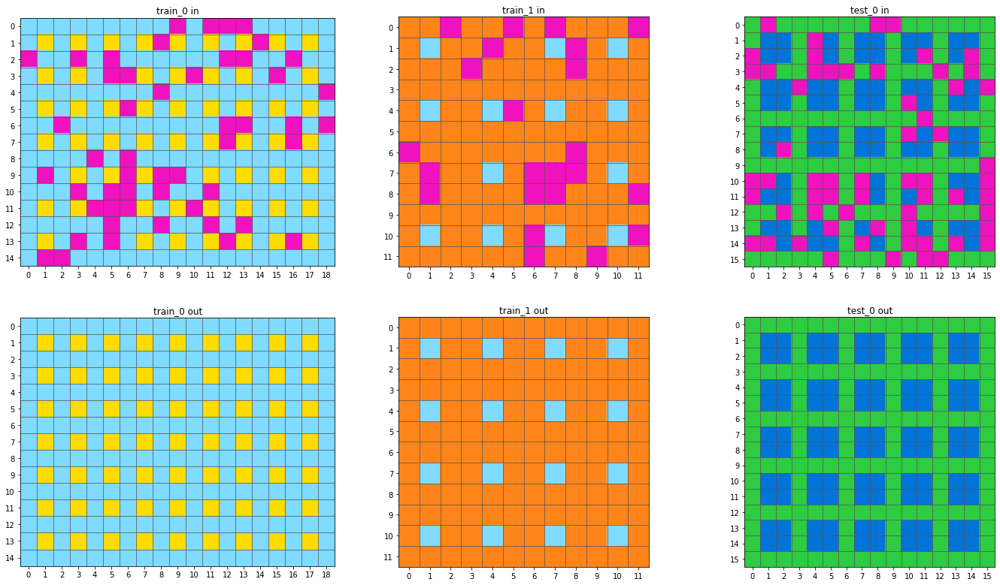

d4c90558
no


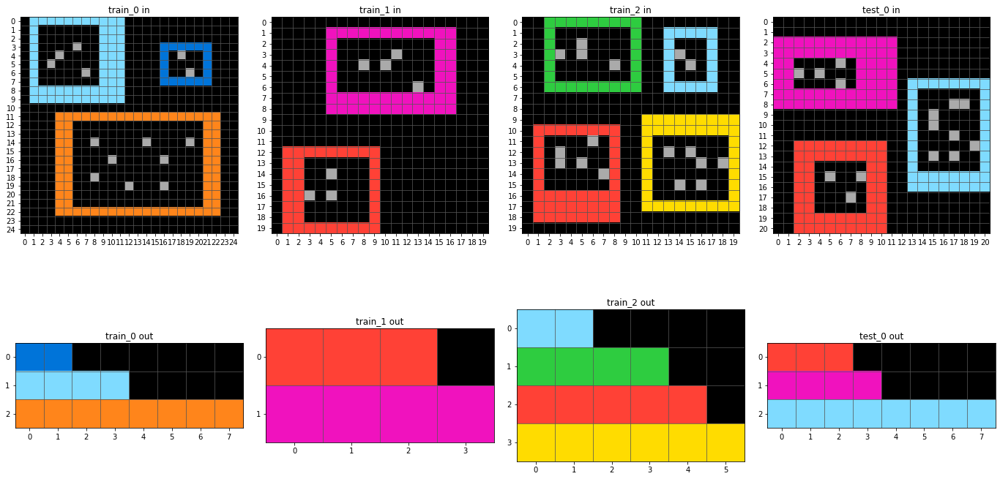

ca8f78db
[False, True, False, False]


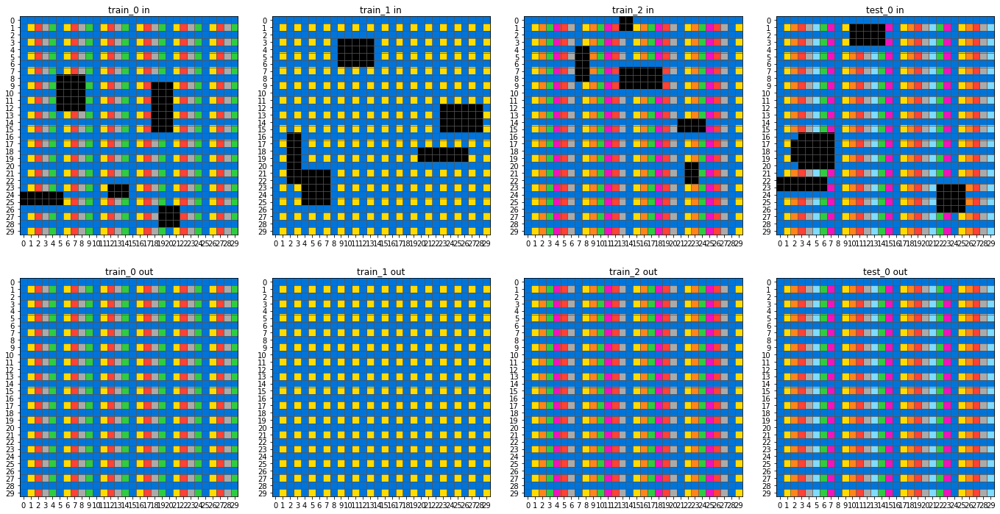

73ccf9c2
no


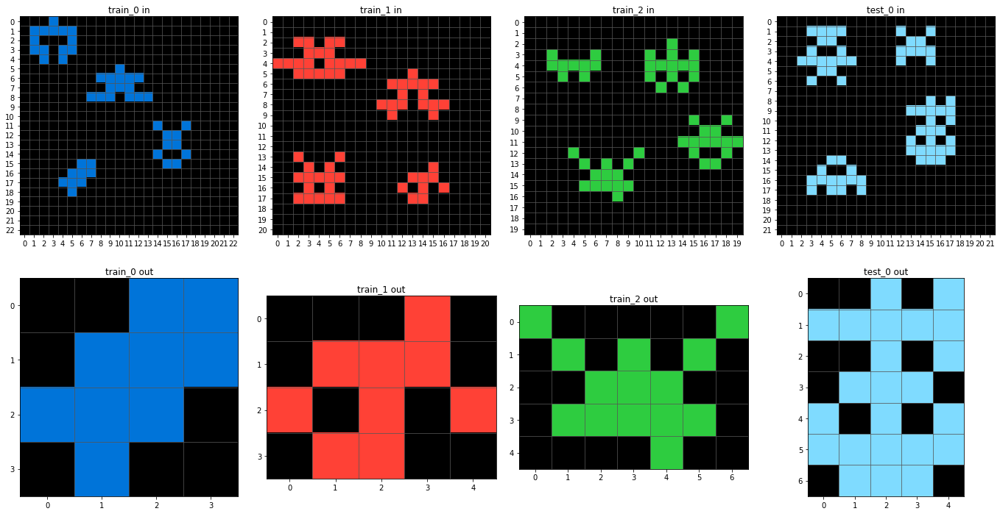

f21745ec
[False, True, True, True]


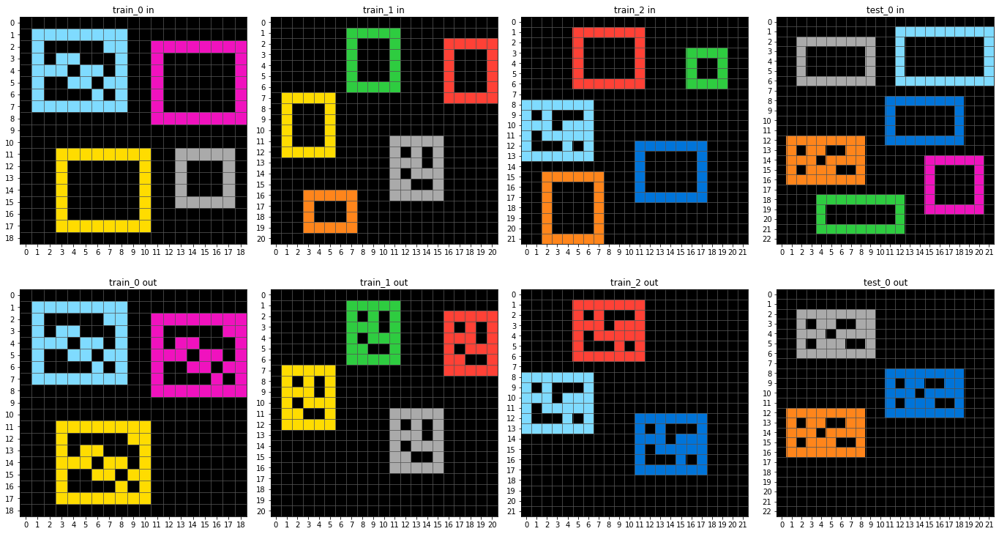

54db823b
[False, True, False, True, False]


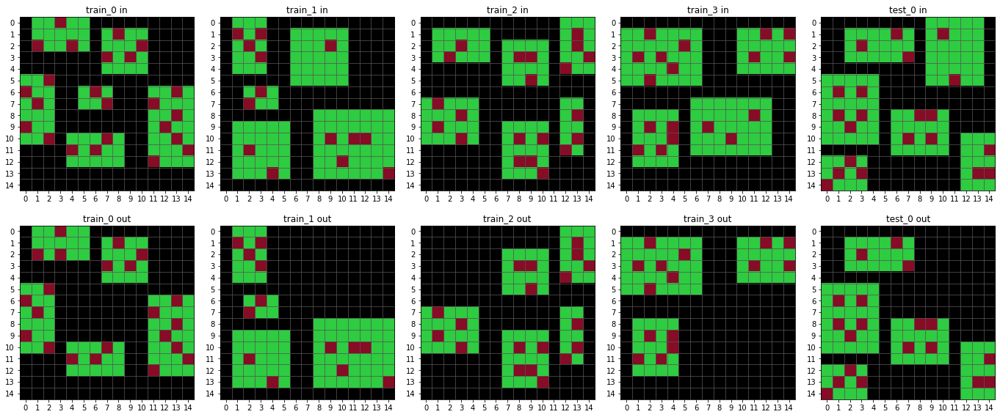

4e45f183
[True, True, True, True]


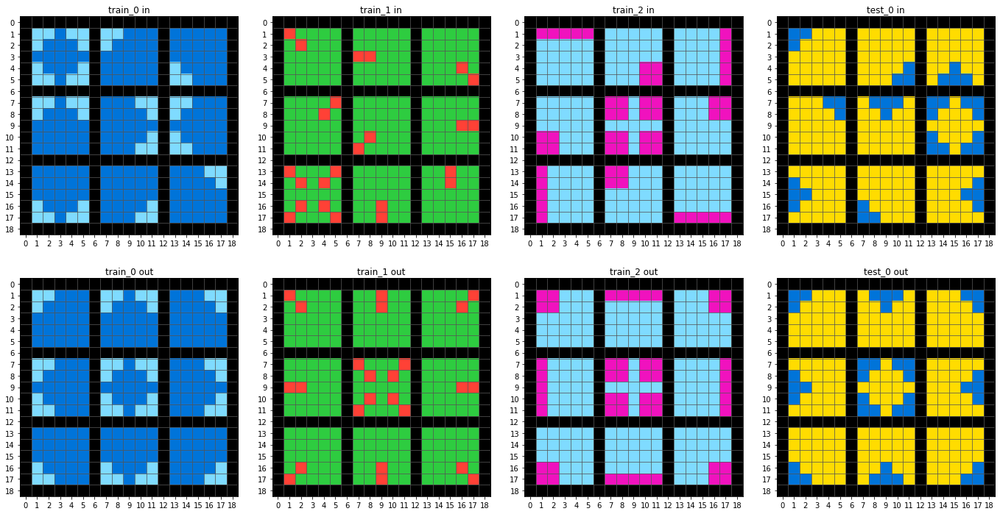

551d5bf1
[True, True, False]


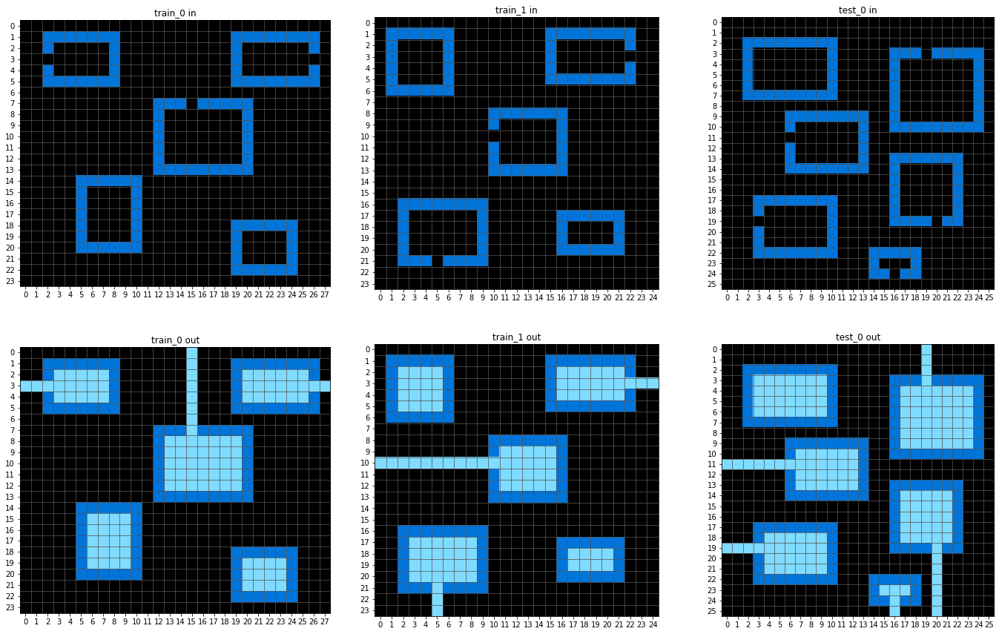

a04b2602
no


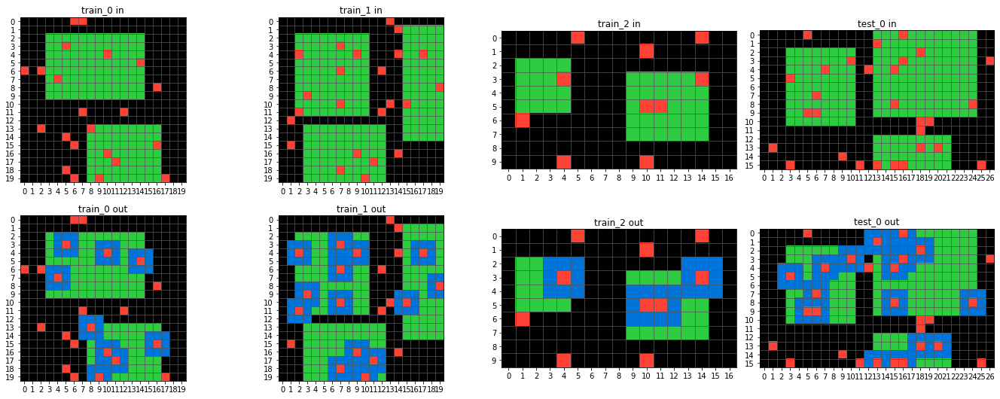

bcb3040b
no


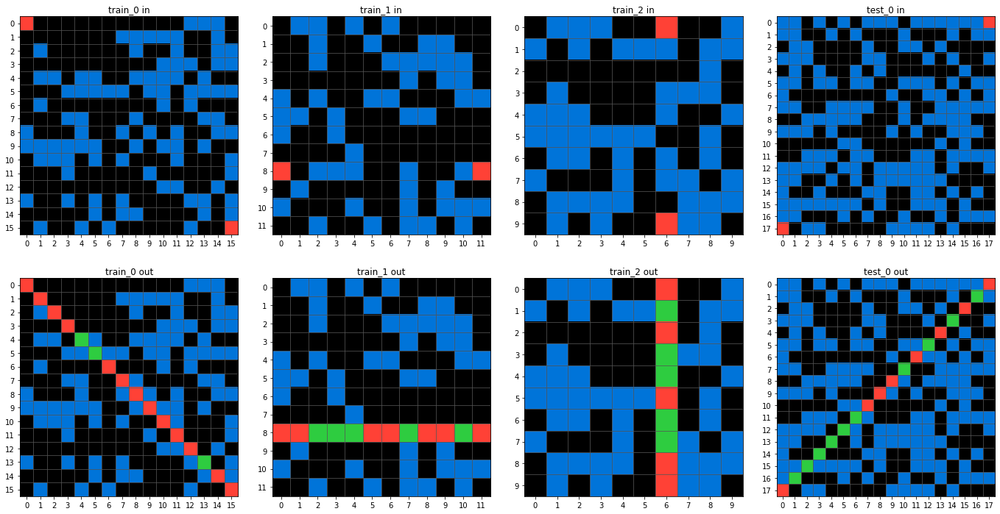

bf699163
no


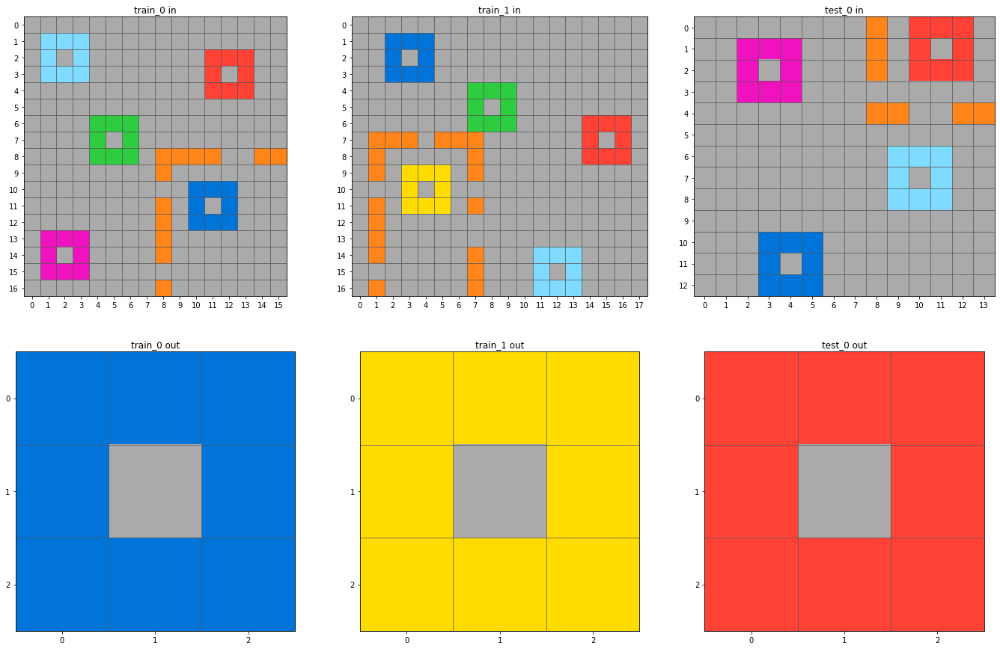

bd14c3bf
[True, False, True, False]


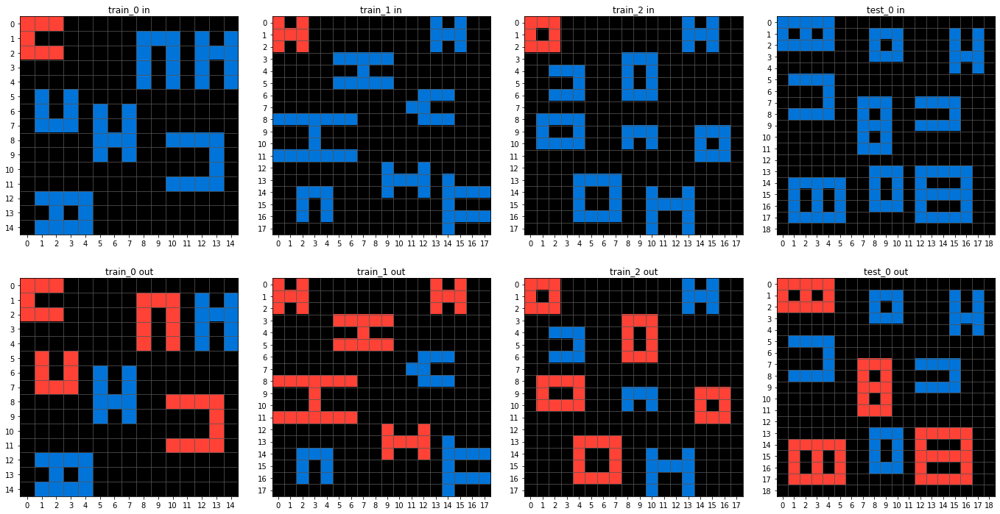

845d6e51
no


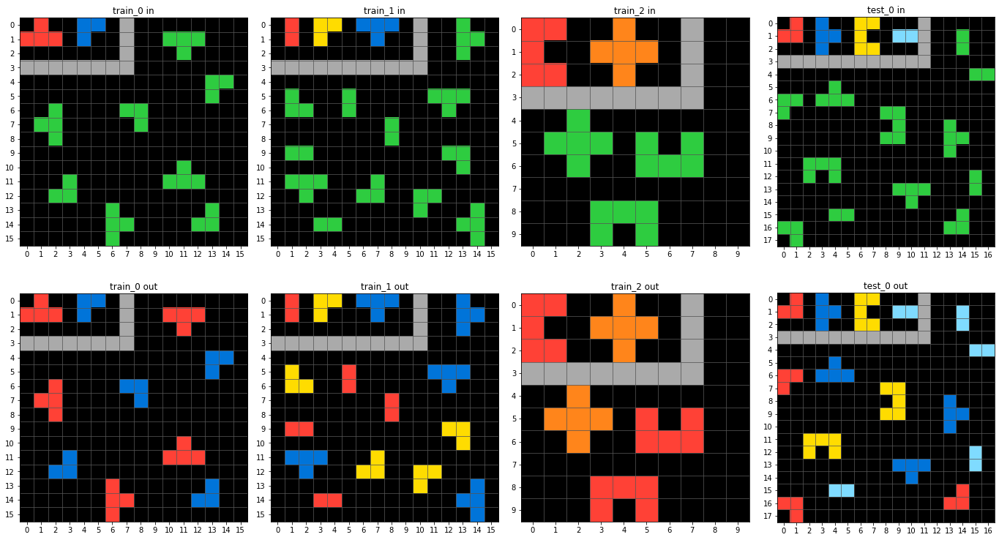

4ff4c9da
[True, True, True, True]


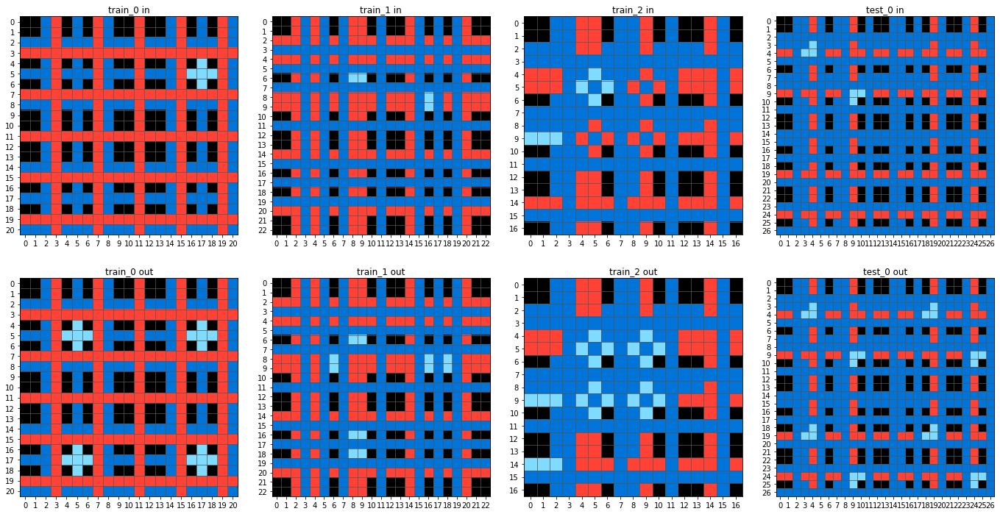

7d18a6fb
no


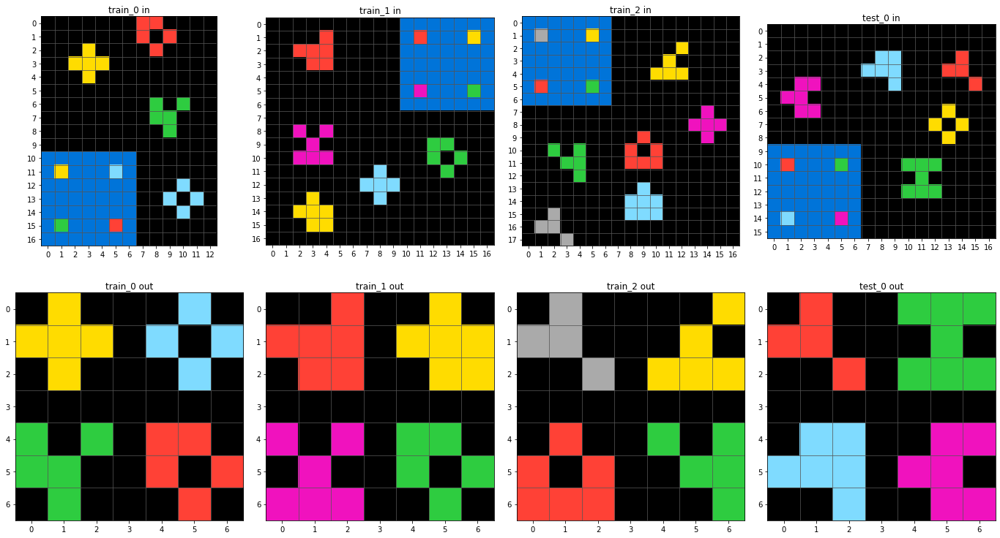

7d1f7ee8
[False, False, False, True]


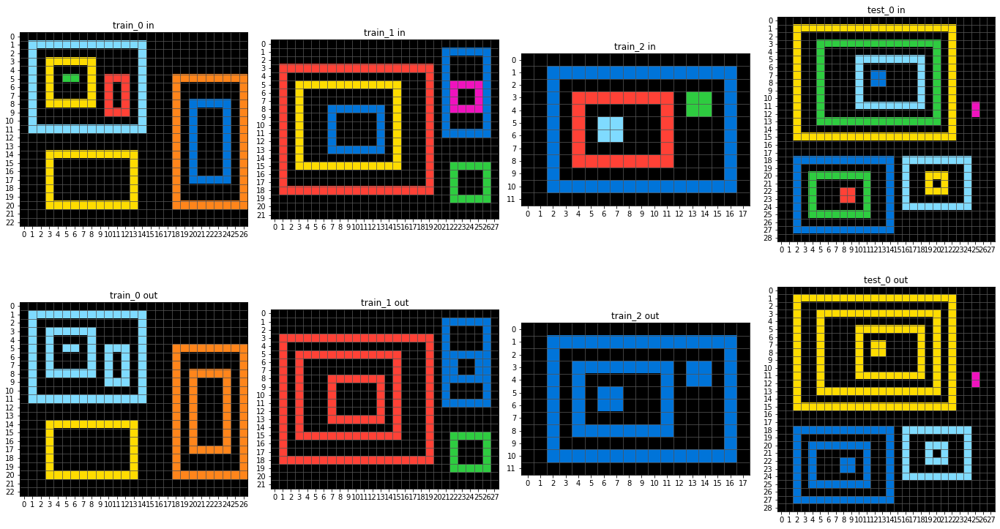

84db8fc4
no


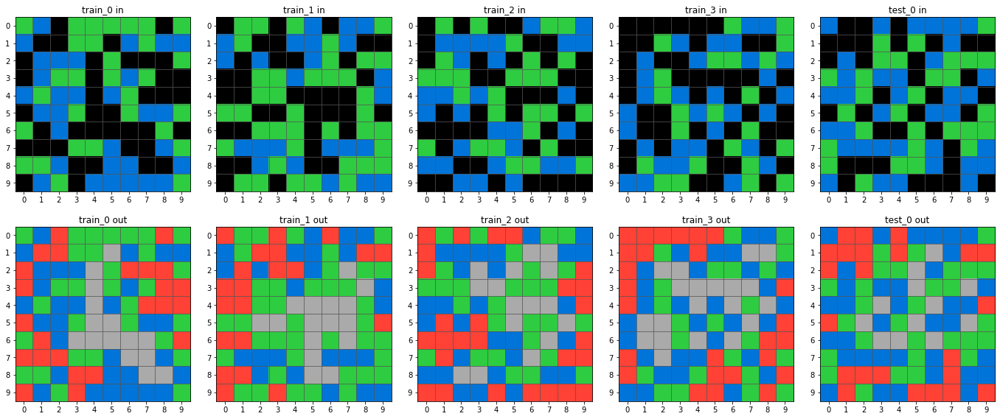

a934301b
[False, True, True, False]


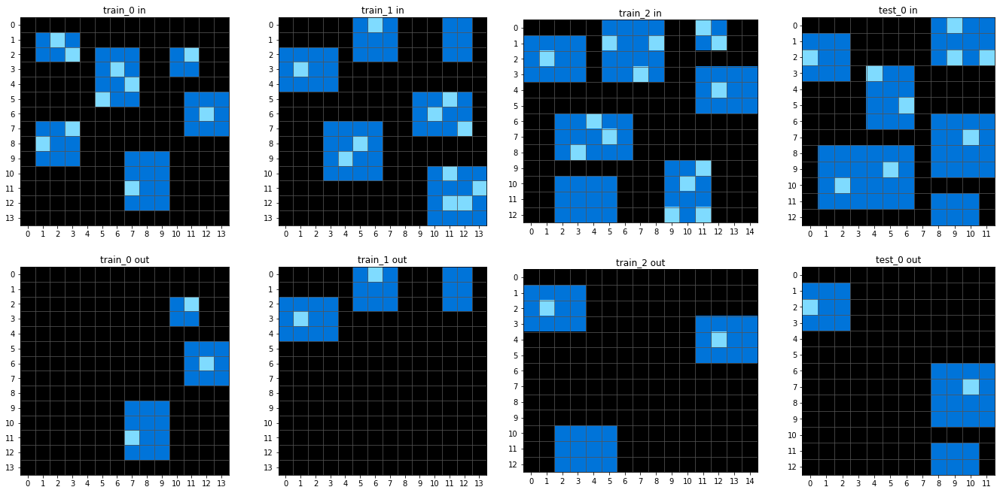

7ee1c6ea
no


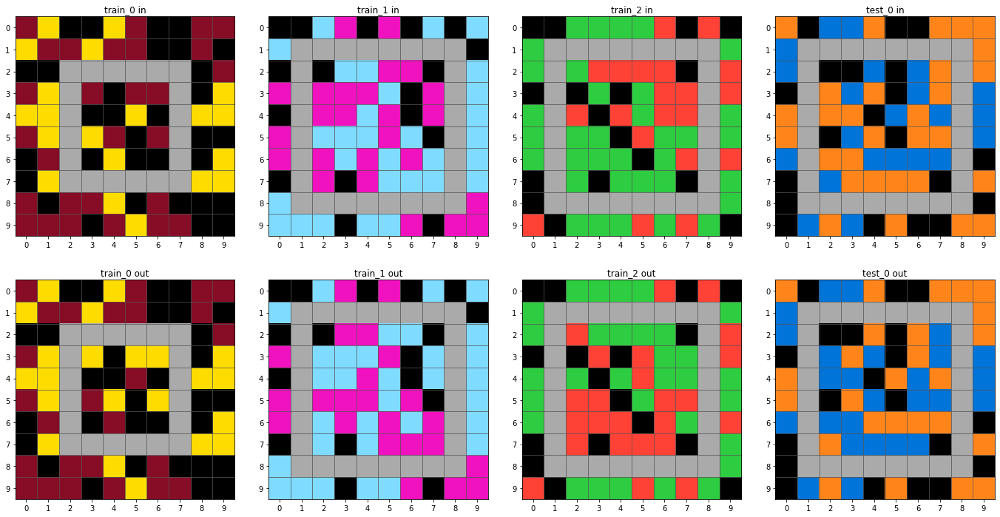

c35c1b4c
no


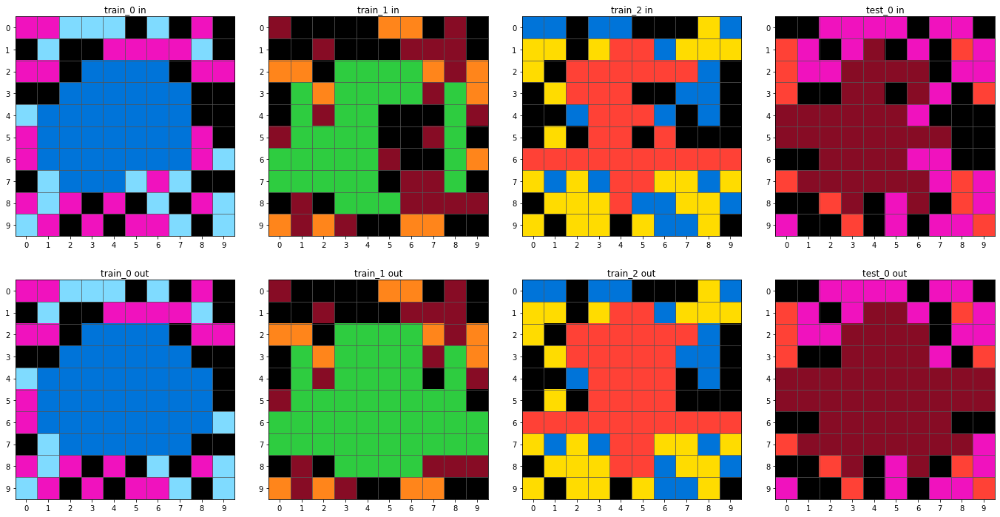

d492a647
[False, False, True]


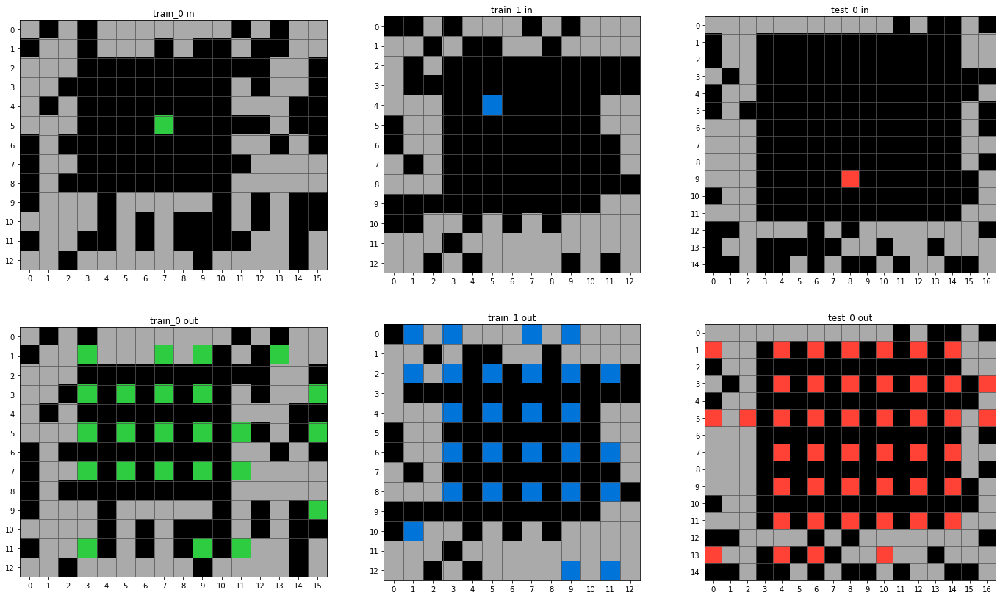

df8cc377
[True, True, True, True]


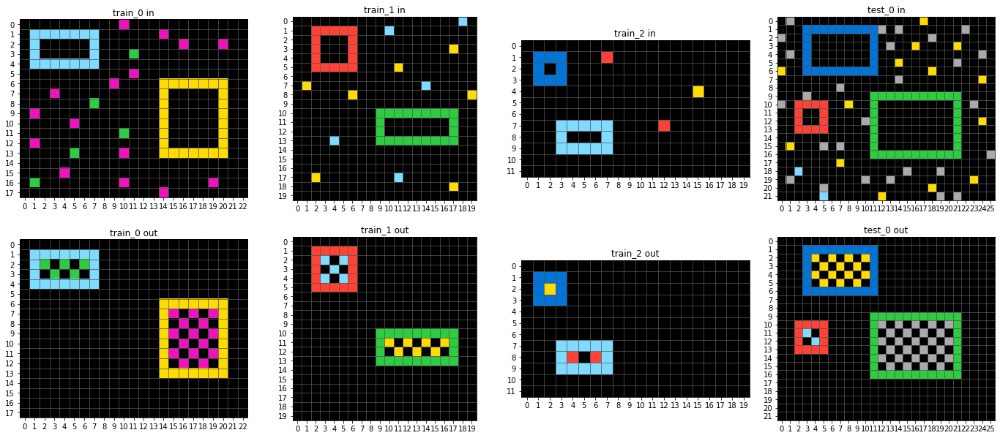

7e02026e
[True, False, False, False]


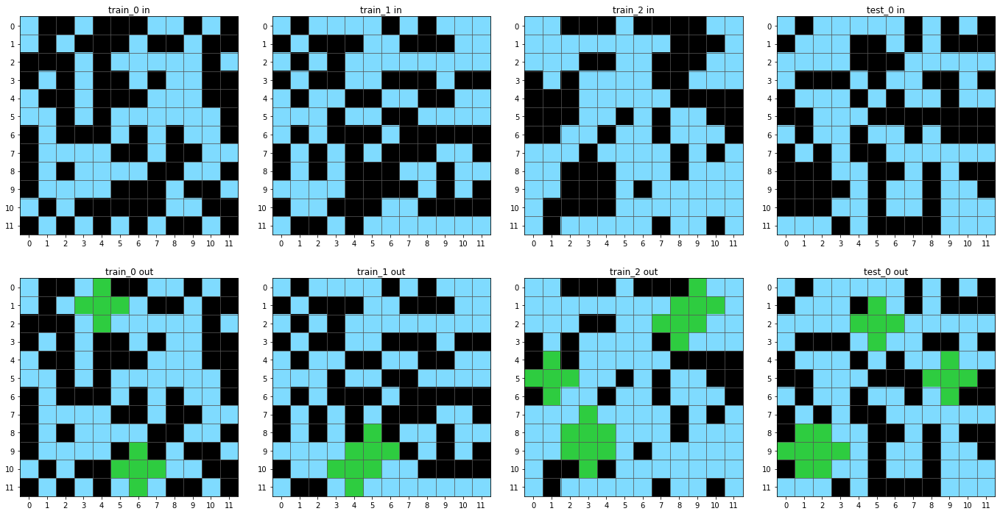

477d2879
[False, False, False, True]


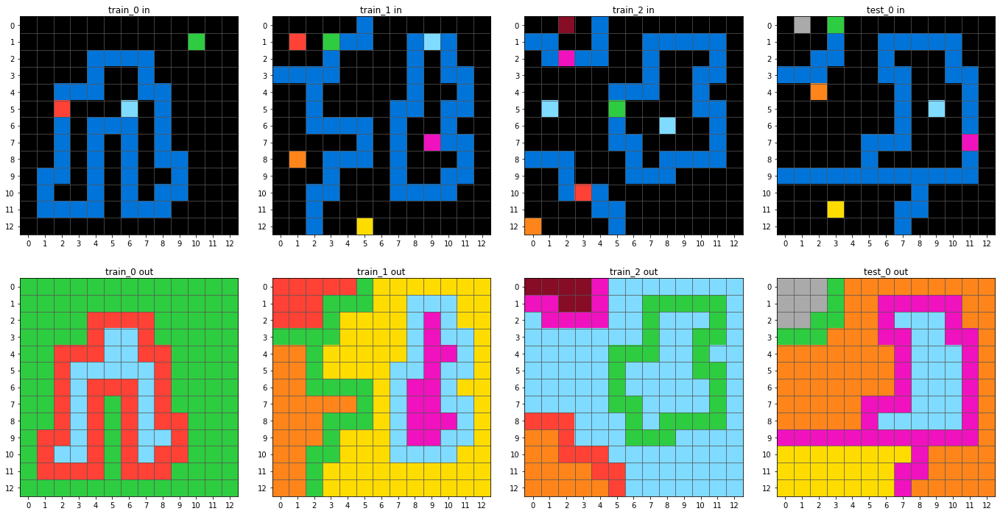

e0fb7511
[False, False, True, True]


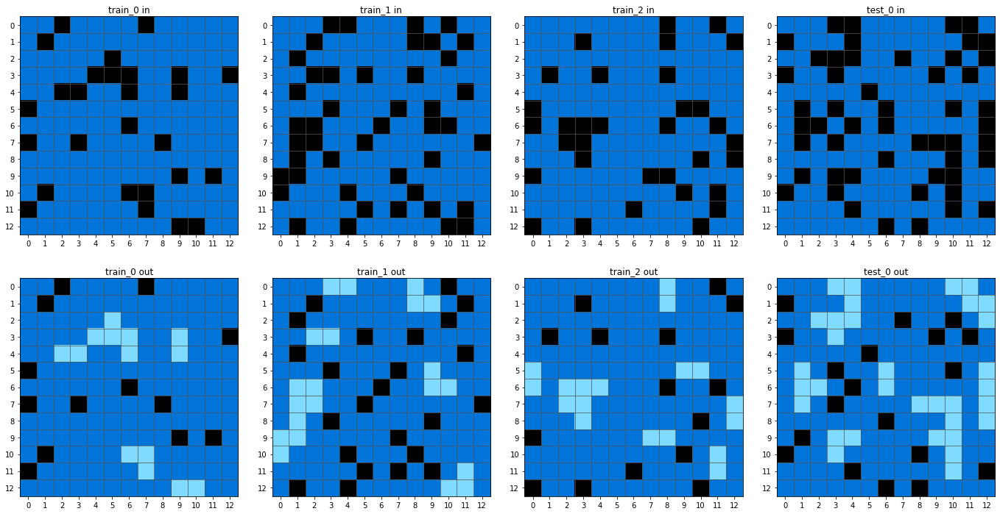

712bf12e
[True, False, True, False]


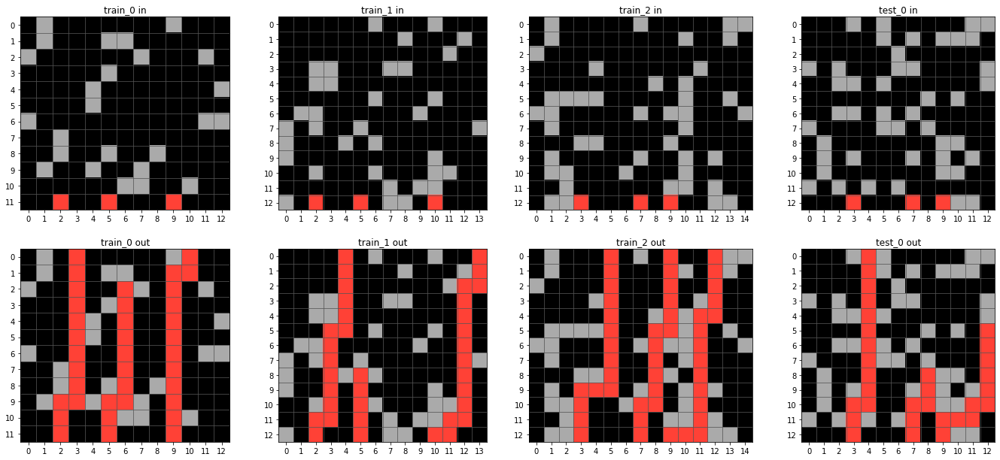

e99362f0
no


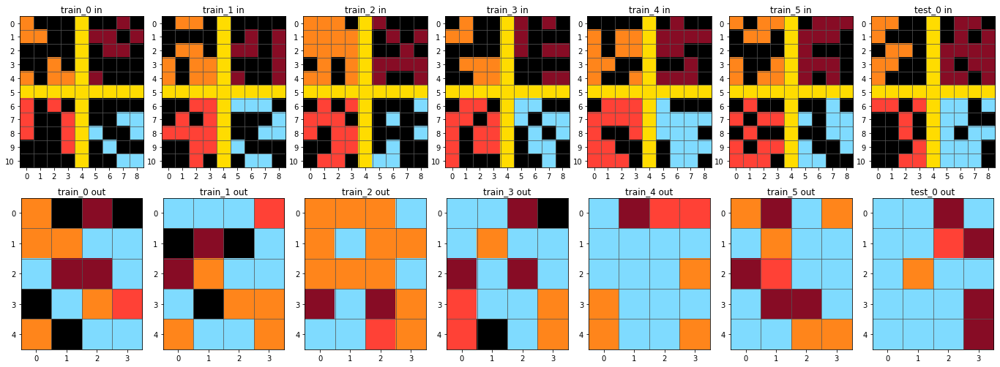

ac0c5833
[True, True, True, True]


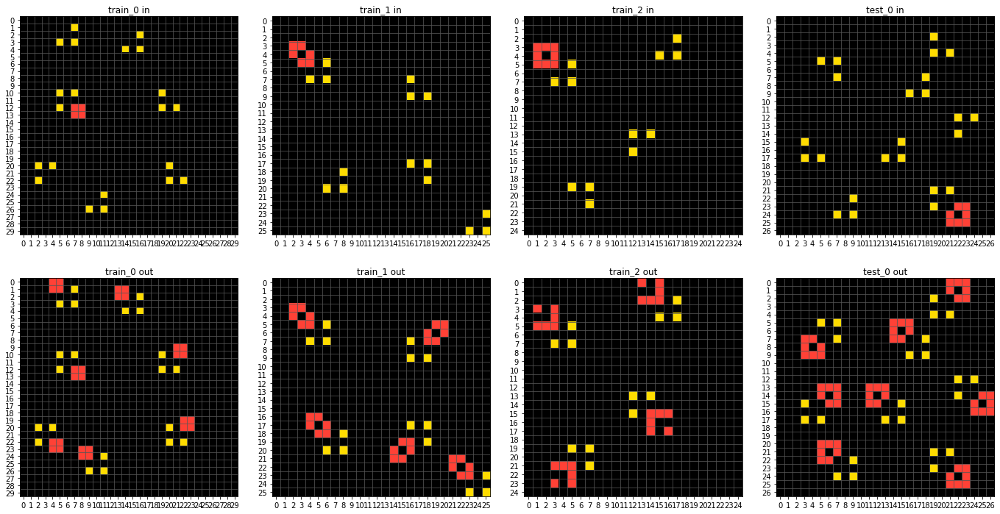

e41c6fd3
[True, True, True, False]


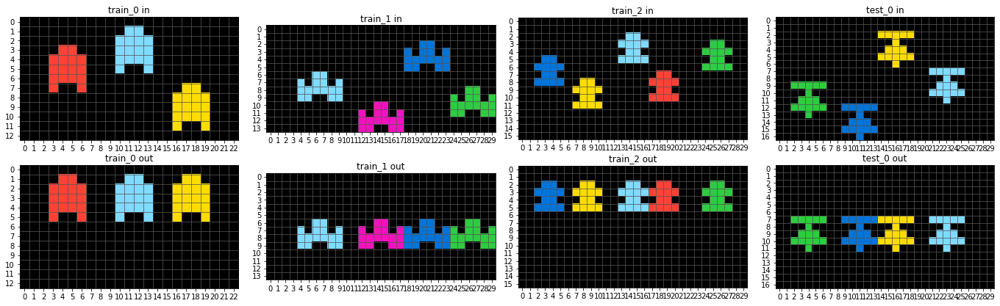

ea9794b1
no


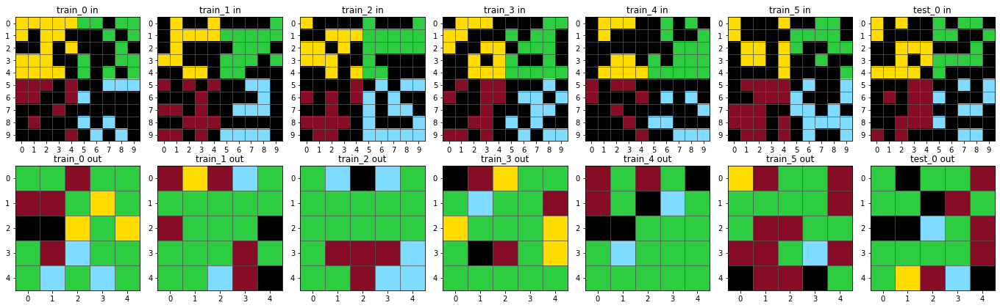

b0722778
no


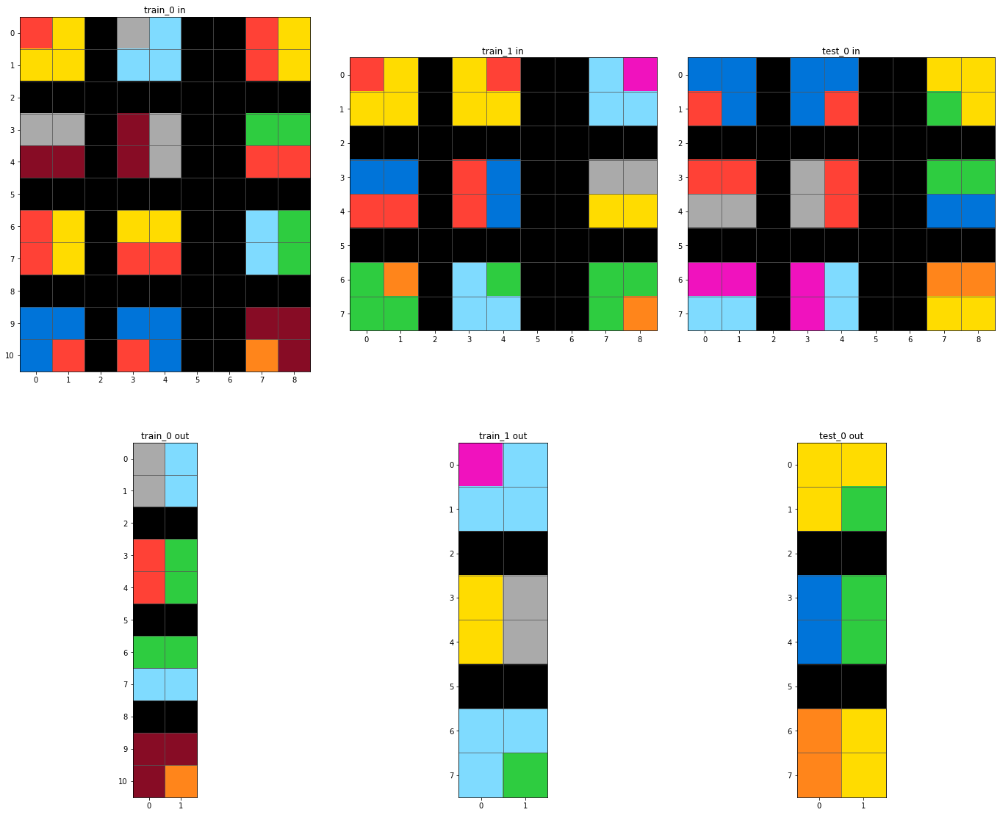

ac2e8ecf
[True, False, True, True]


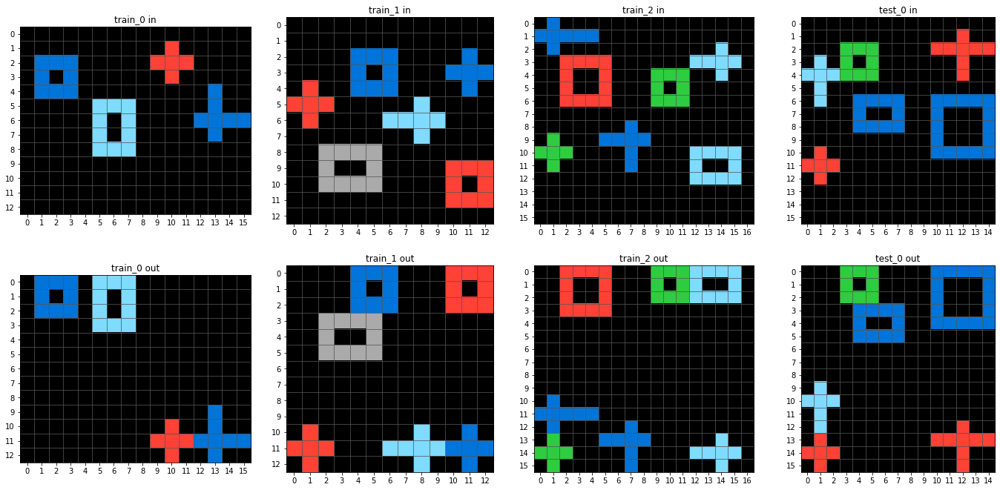

f5aa3634
no


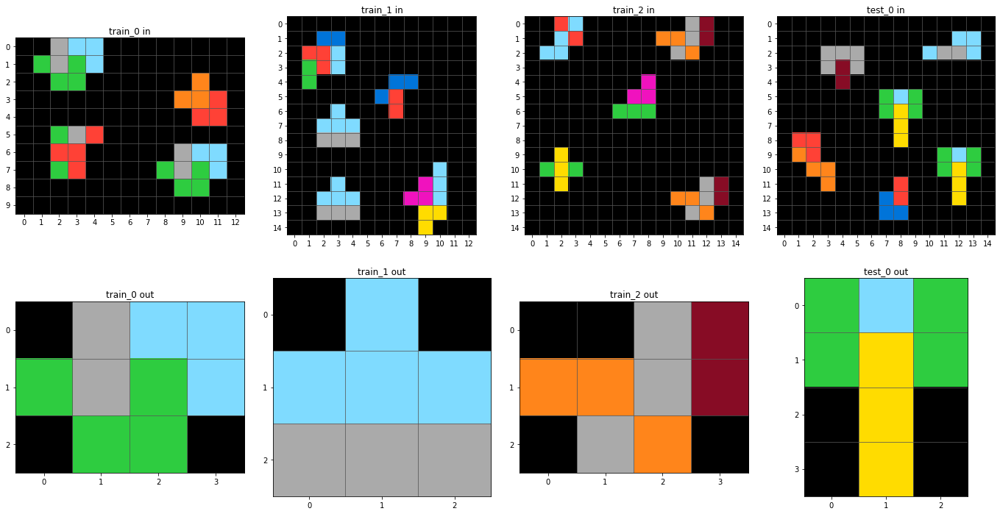

c64f1187
no


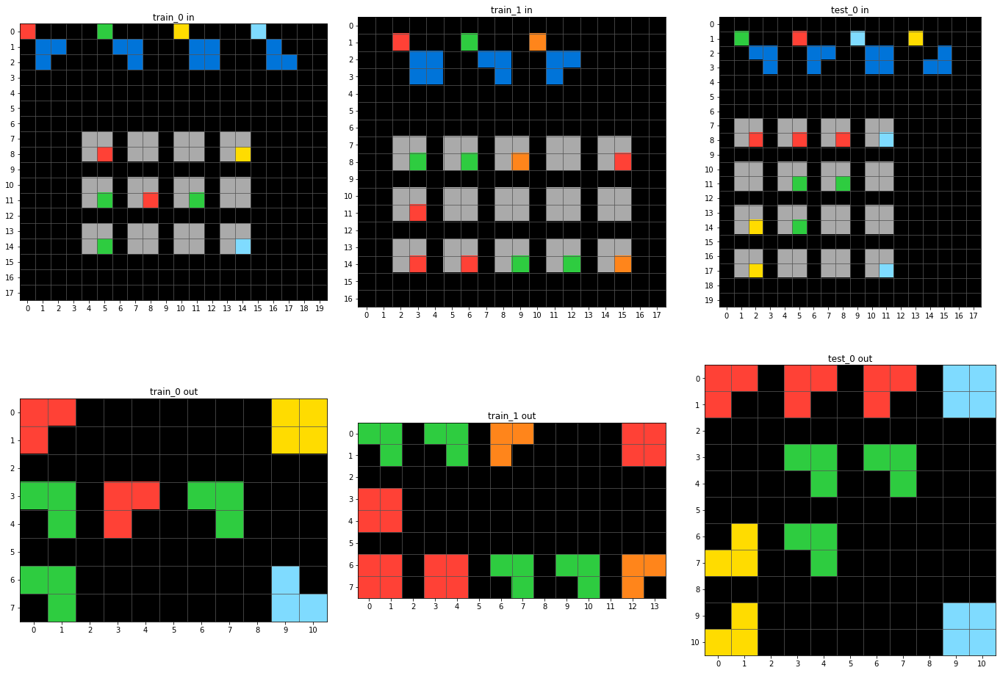

dc2aa30b
no


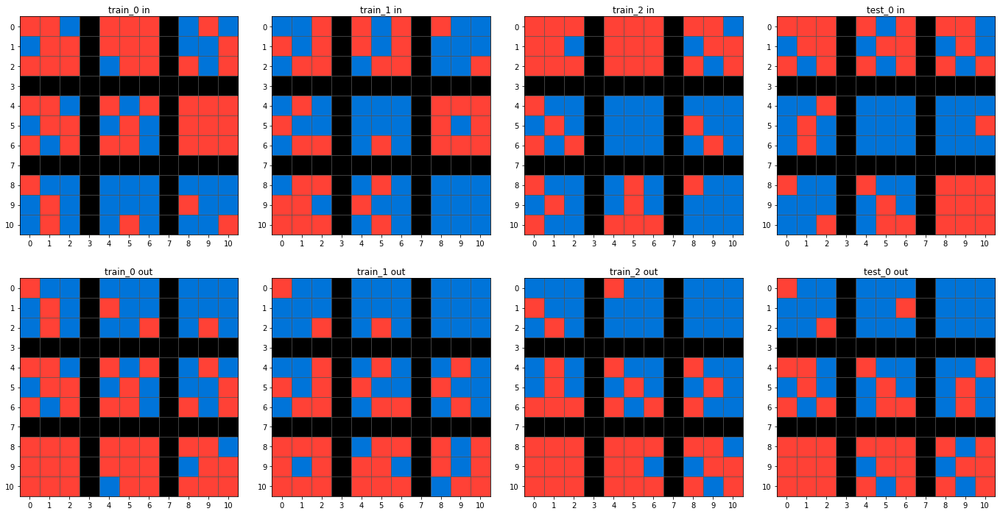

d282b262
[False, True, False, True]


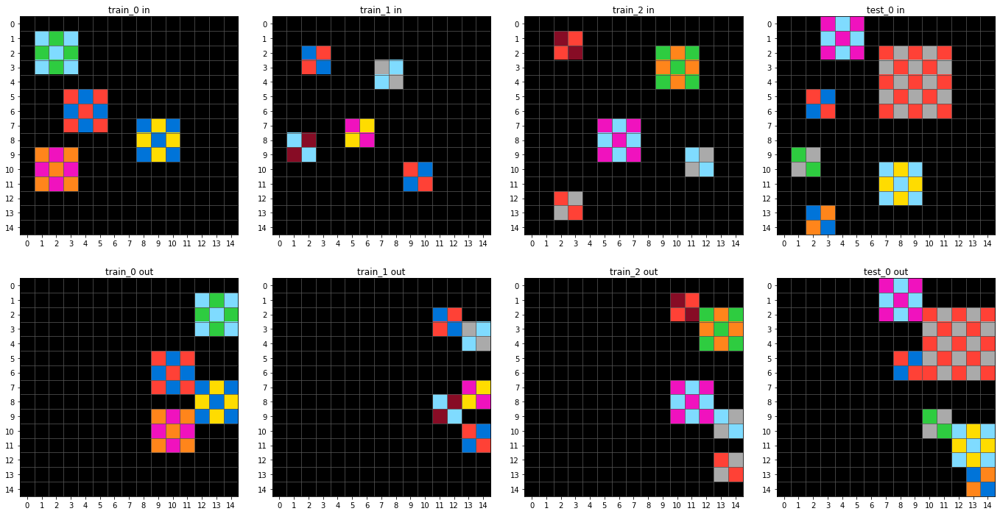

94133066
no


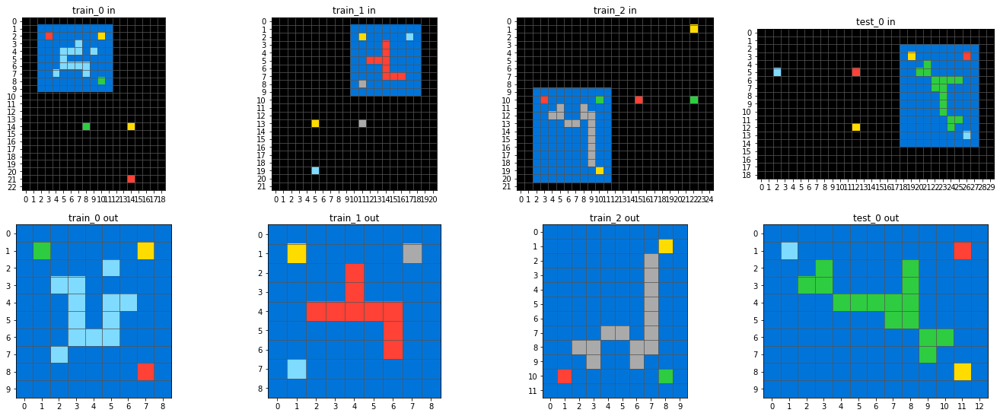

e1d2900e
no


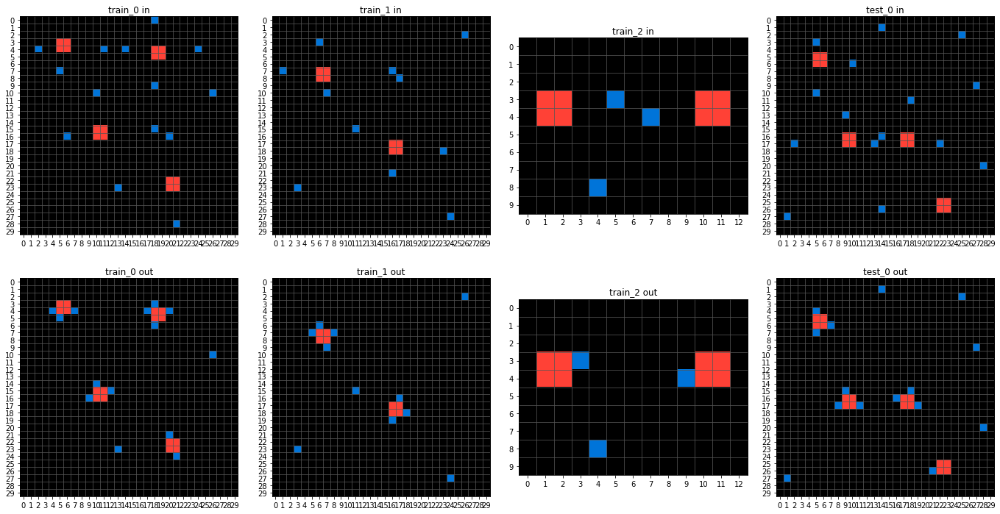

9a4bb226
no


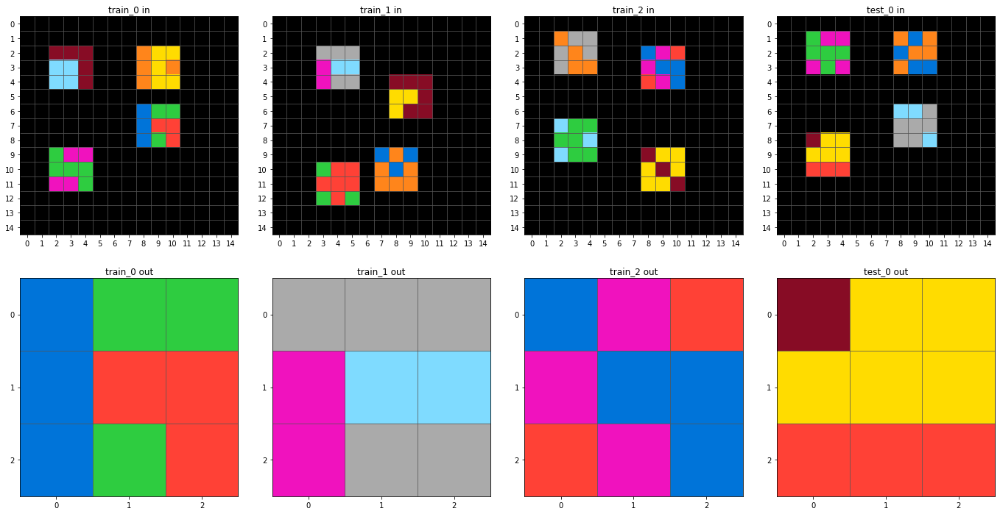

5b692c0f
[False, True, True]


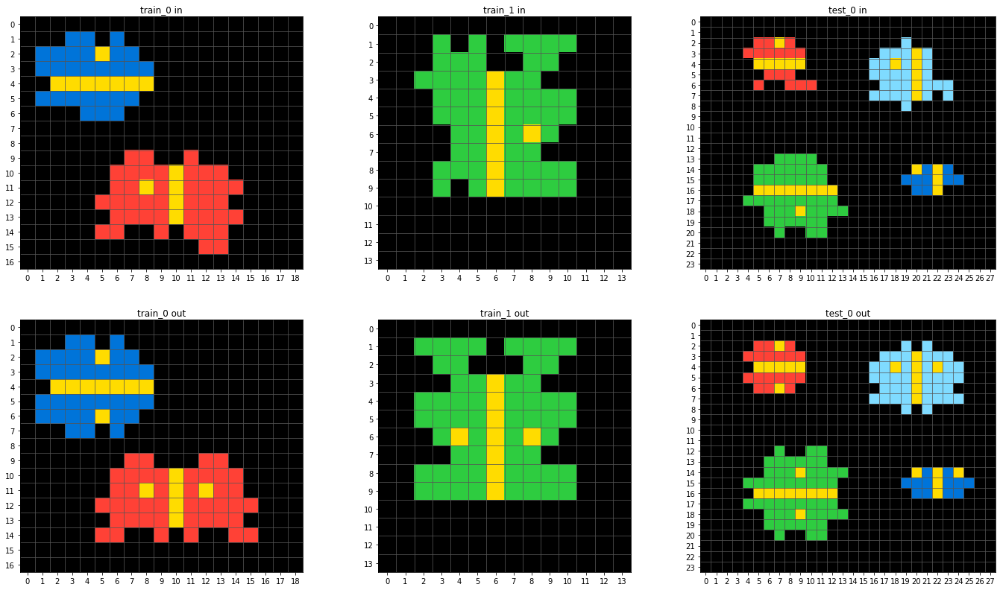

d47aa2ff
no


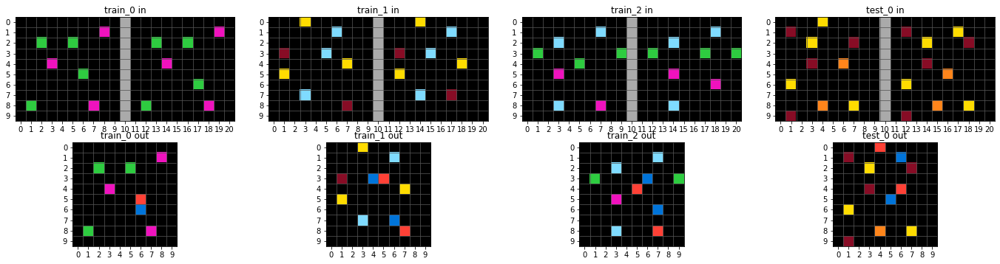

9772c176
[True, True, False]


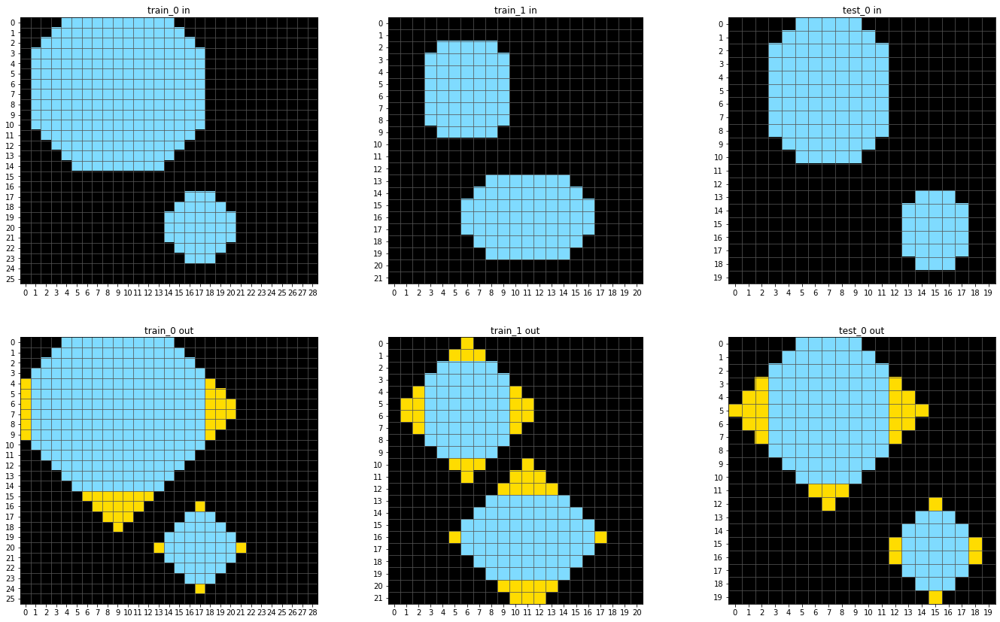

c658a4bd
no


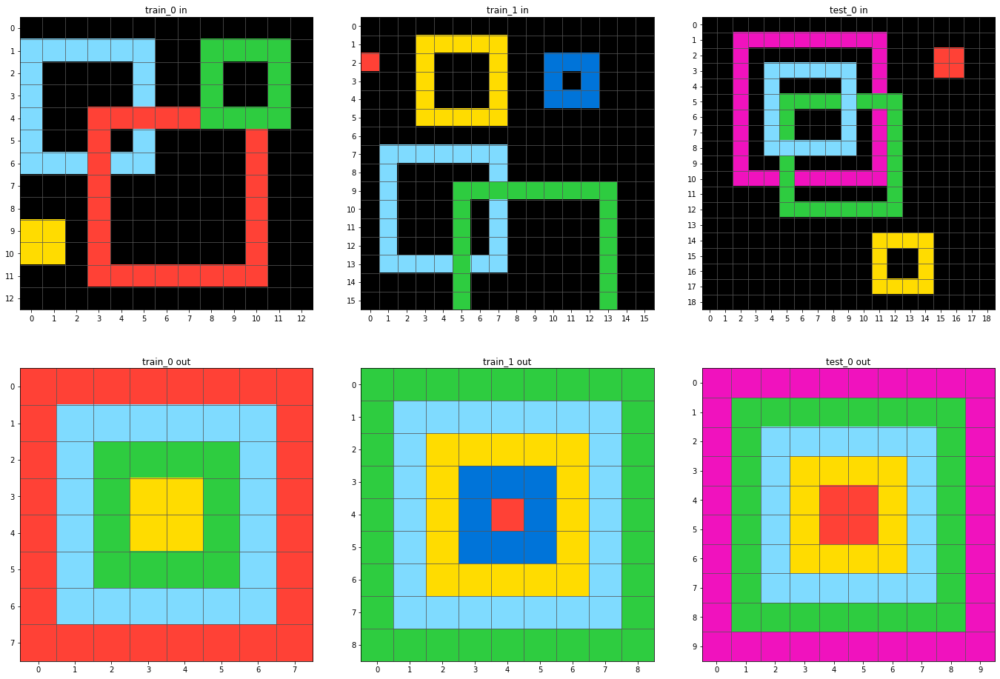

5a5a2103
[False, False, False]


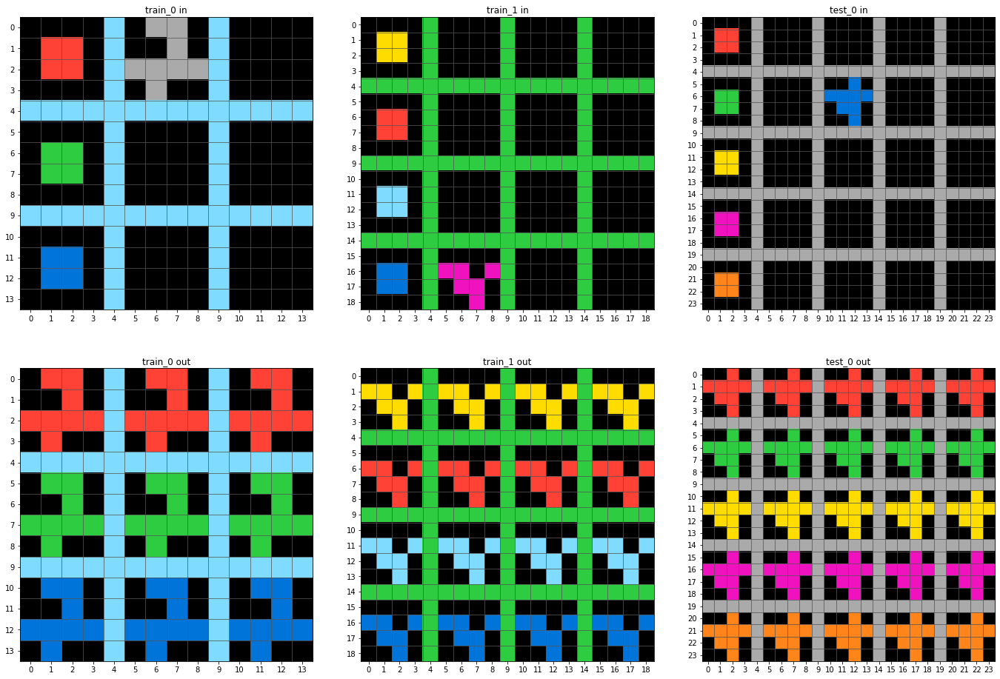

81c0276b
no


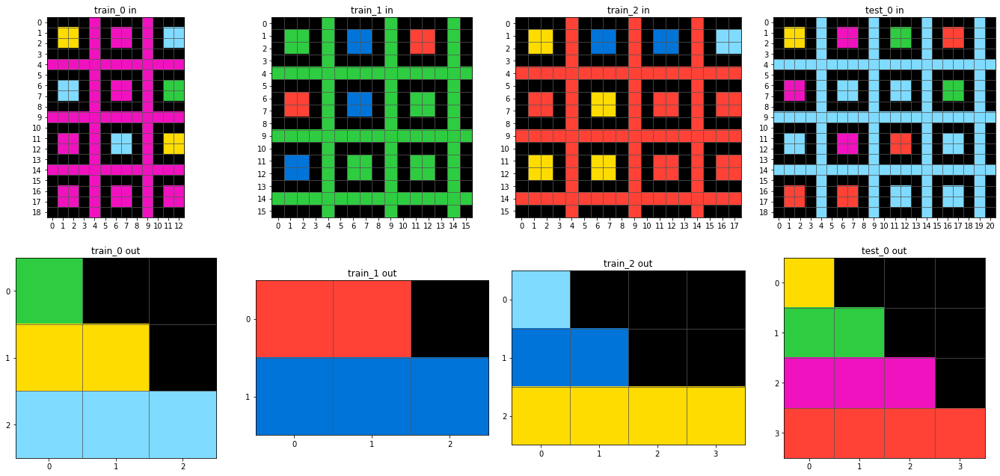

7d419a02
[False, False, False, False]


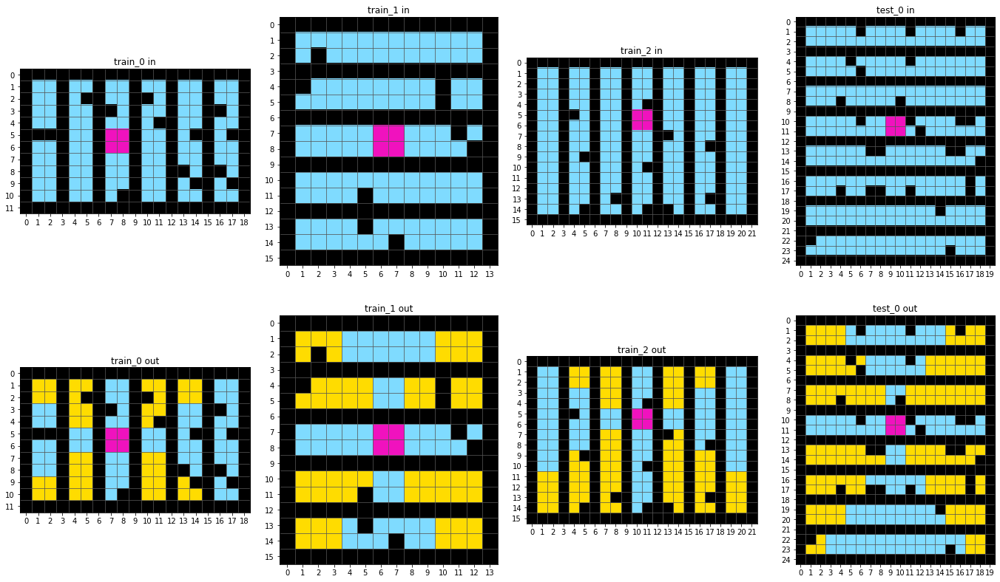

93b4f4b3
no


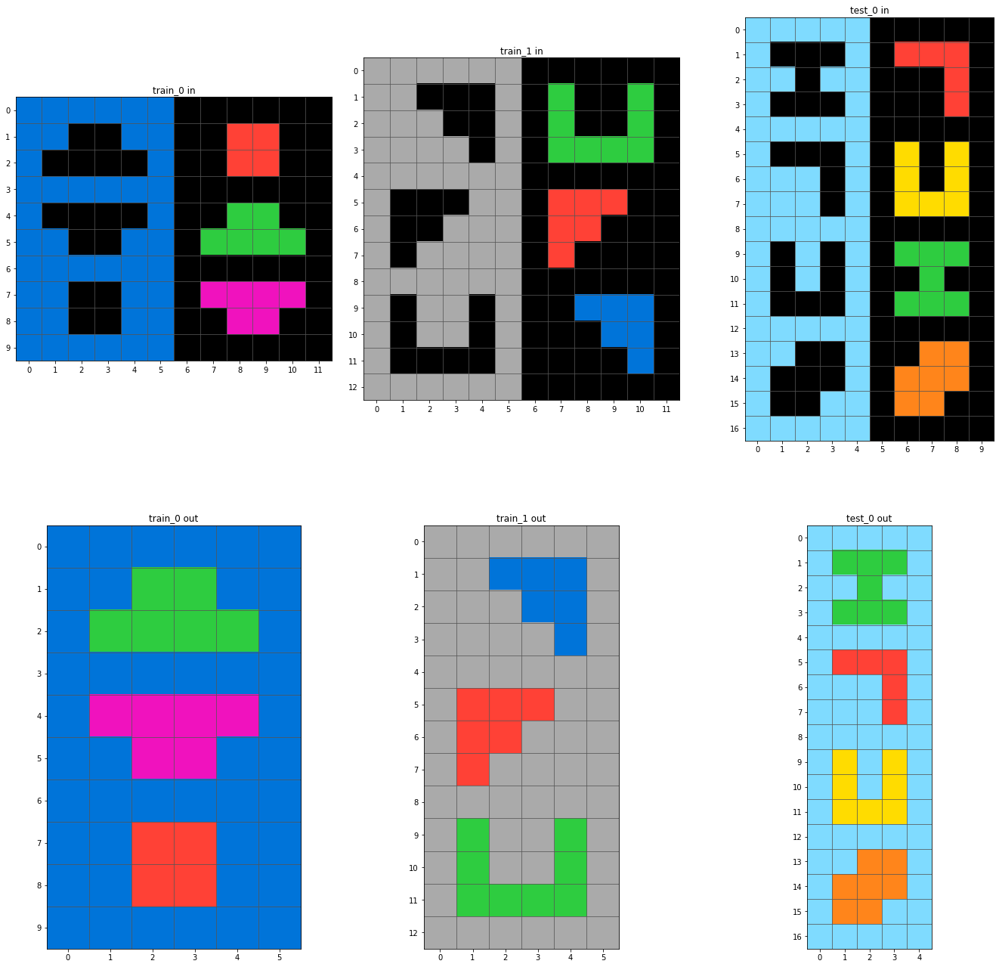

fd096ab6
[True, True, False]


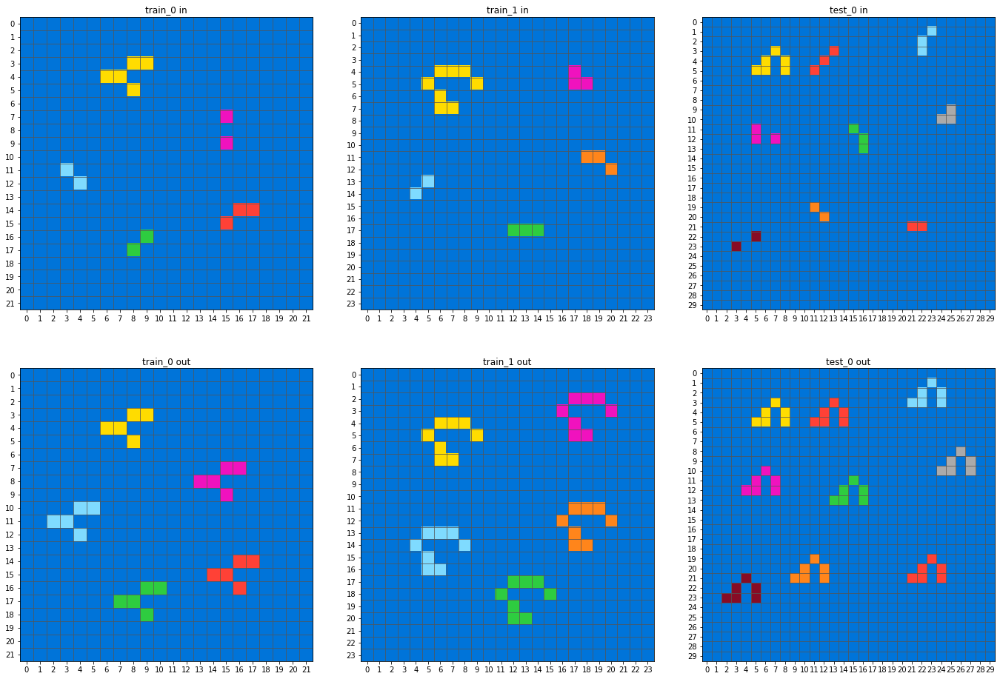

88207623
[False, True, False]


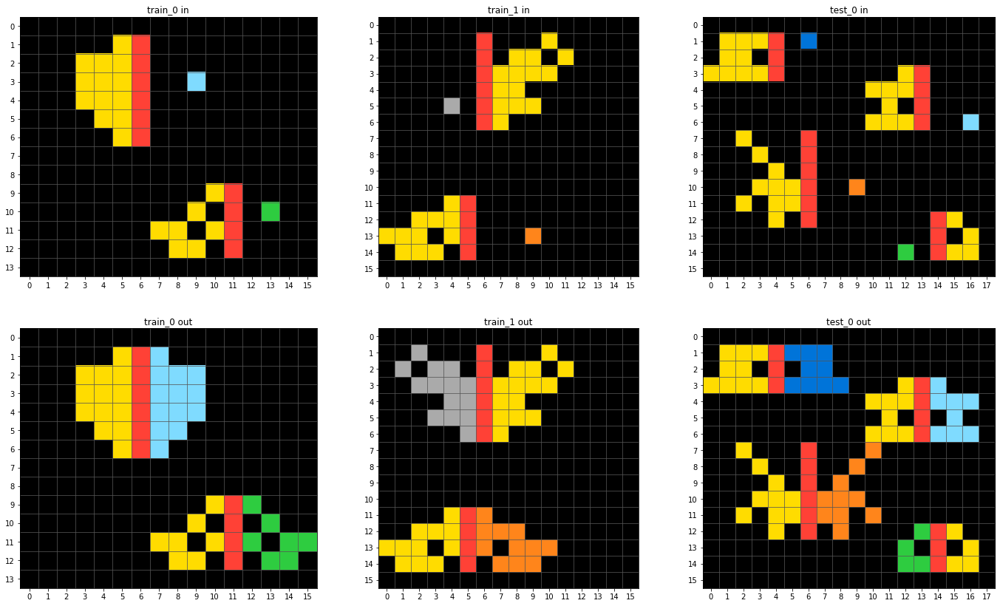

6a11f6da
no


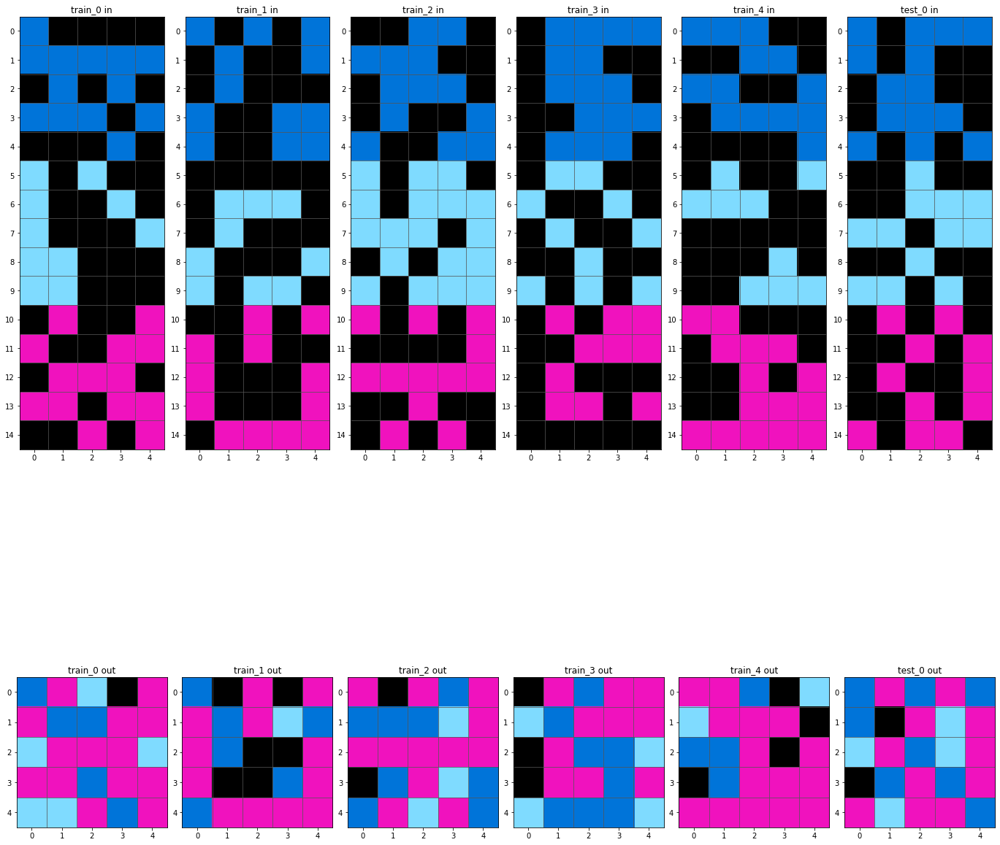

b457fec5
[False, True, False, False]


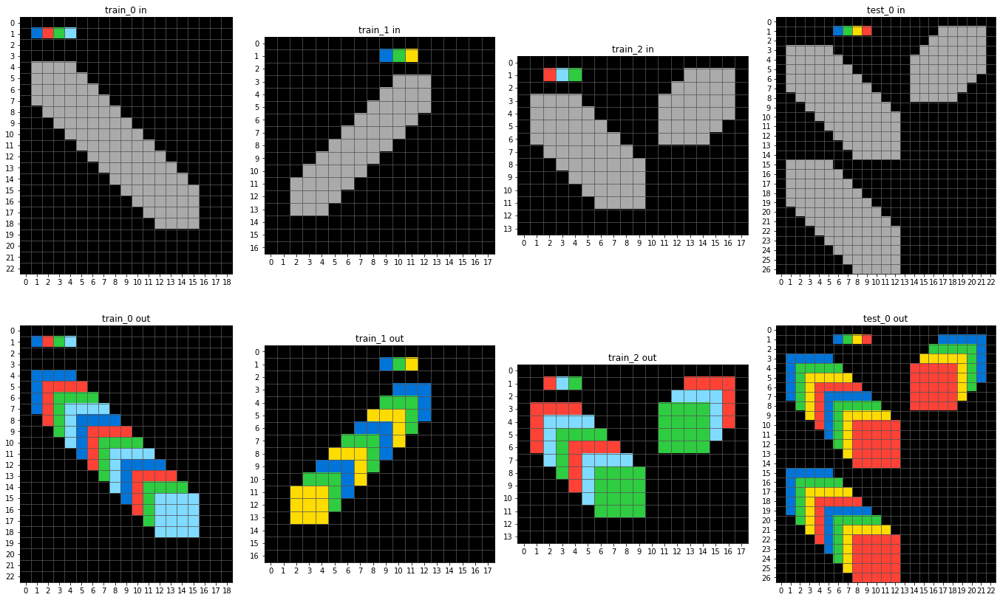

dc2e9a9d
[False, False, True, True]


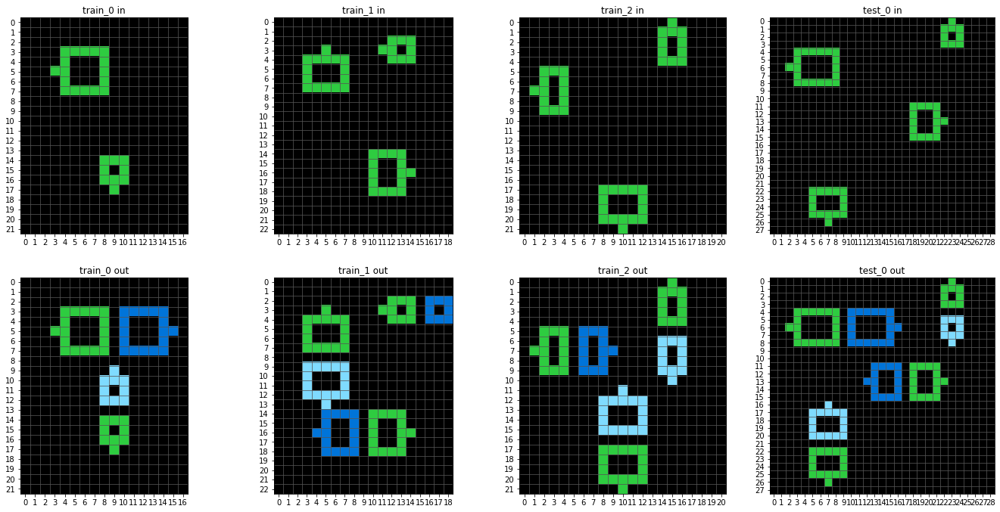

782b5218
no


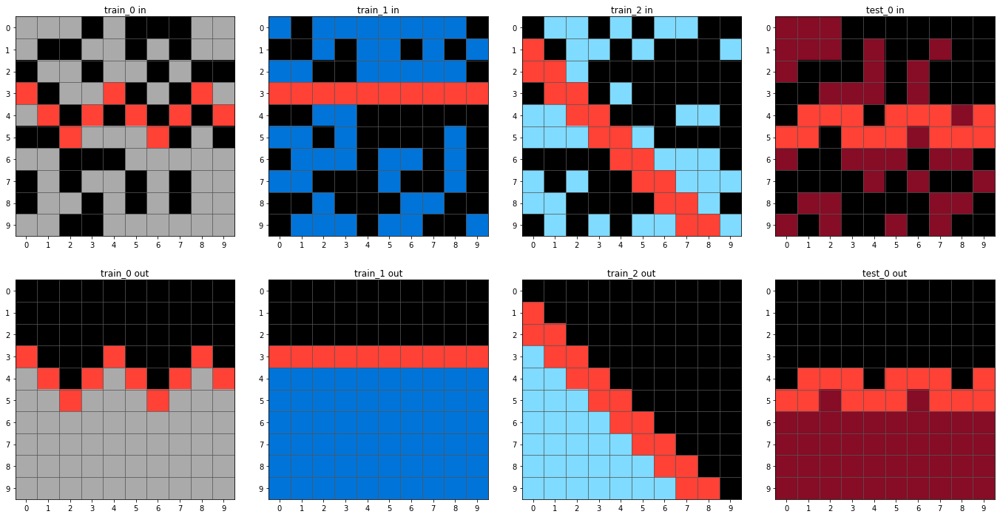

f83cb3f6
no


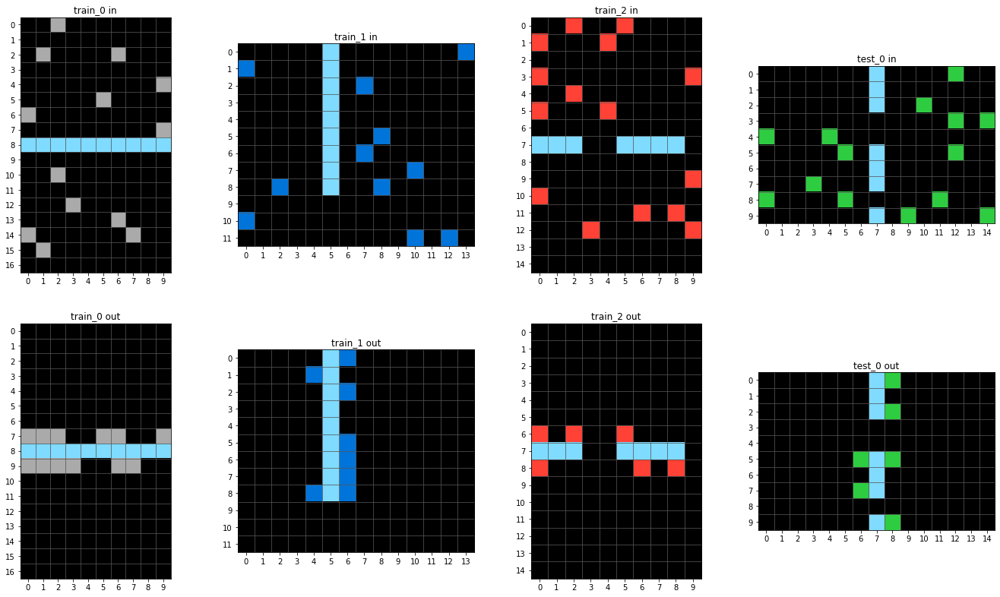

8dae5dfc
[False, True, False, False, False]


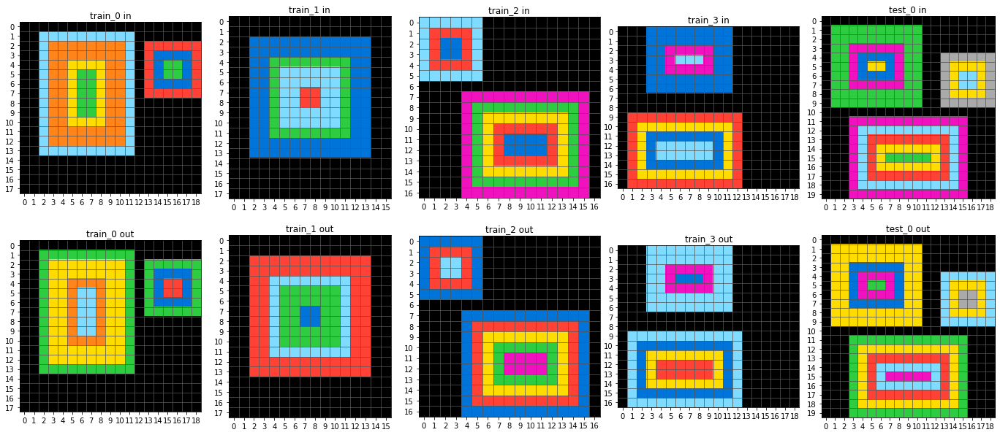

94be5b80
[False, True, False]


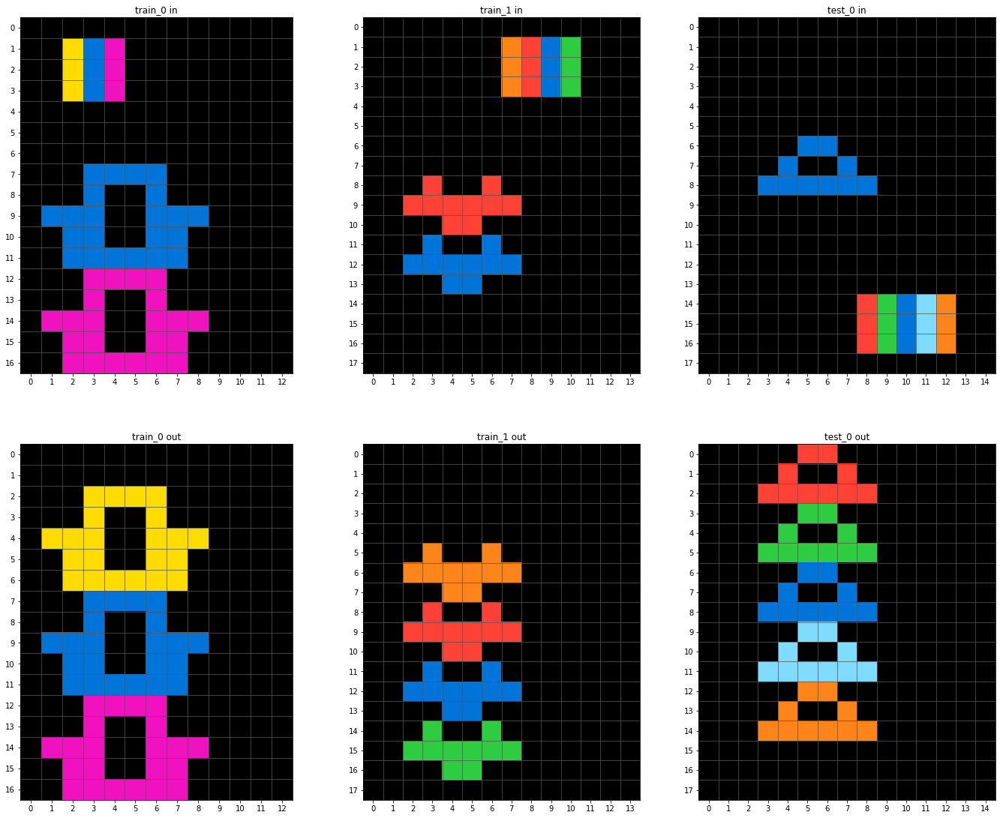

505fff84
no


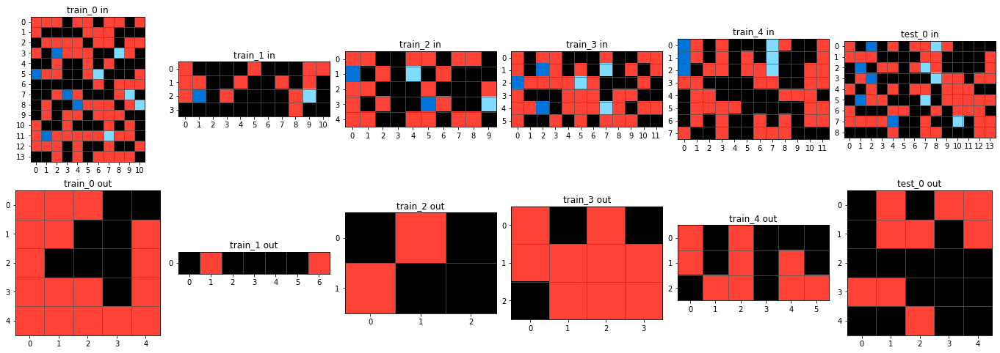

a680ac02
no


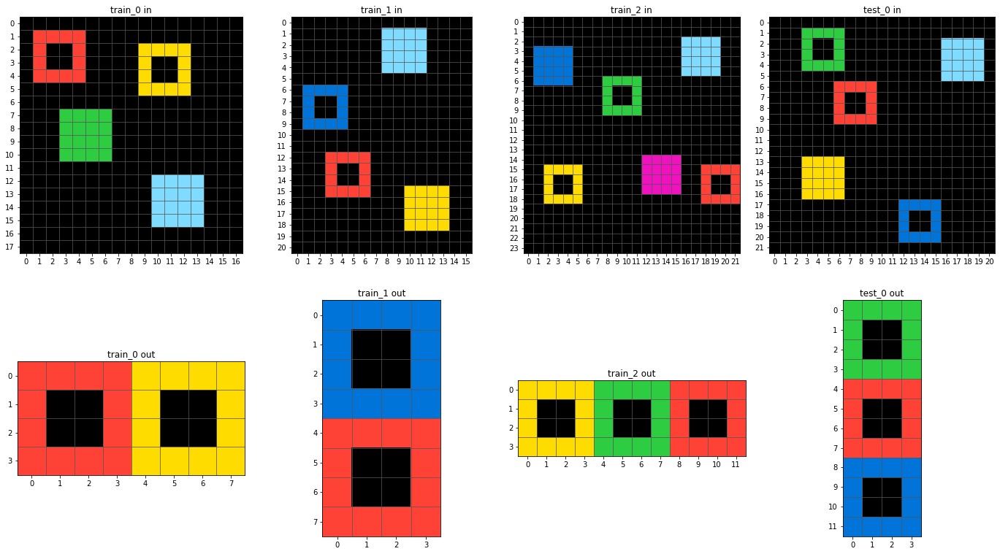

a096bf4d
[True, True, True, True]


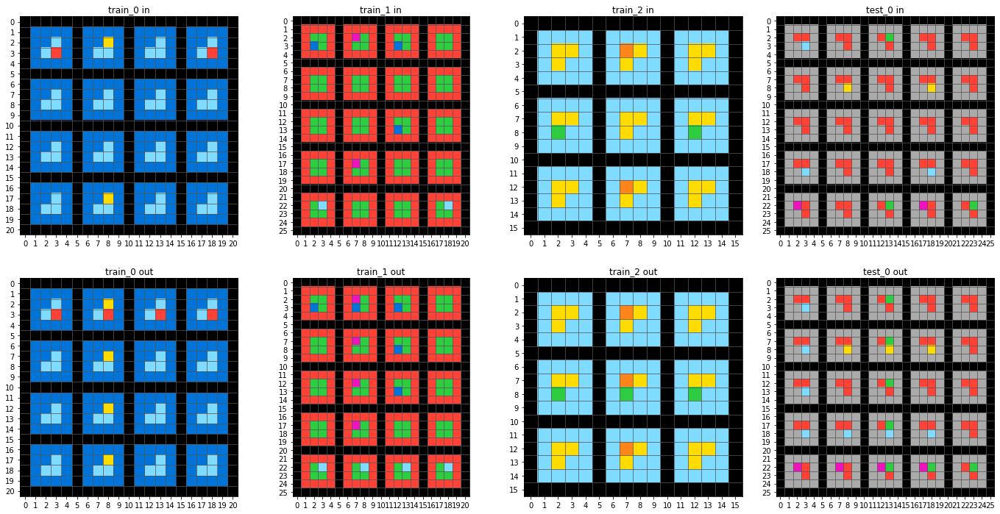

c6e1b8da
[False, False, False, False]


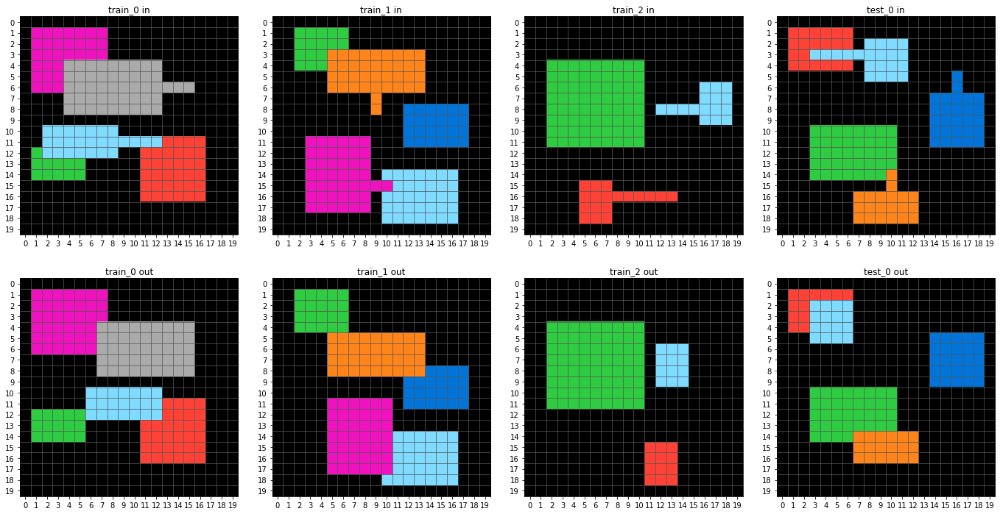

b7f8a4d8
[True, True, True, True]


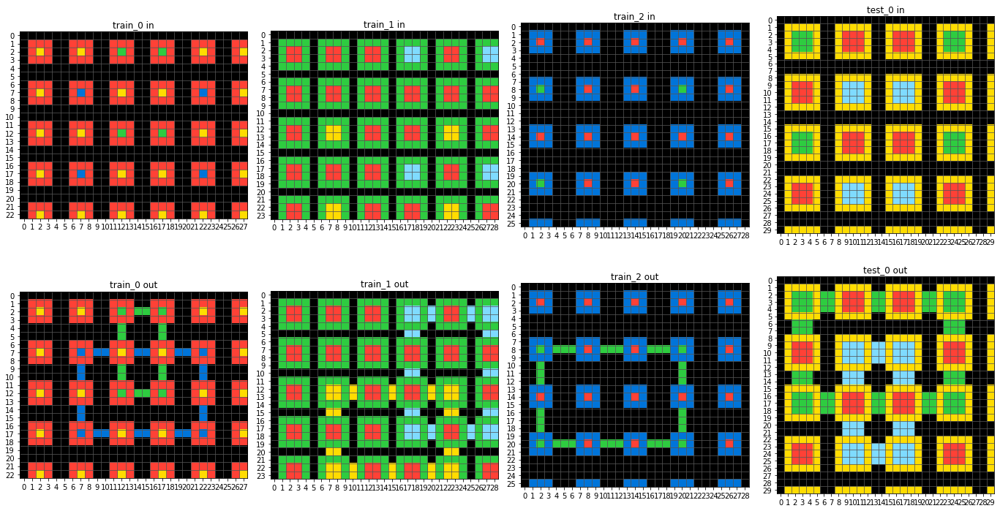

52fd389e
[True, True, False, False]


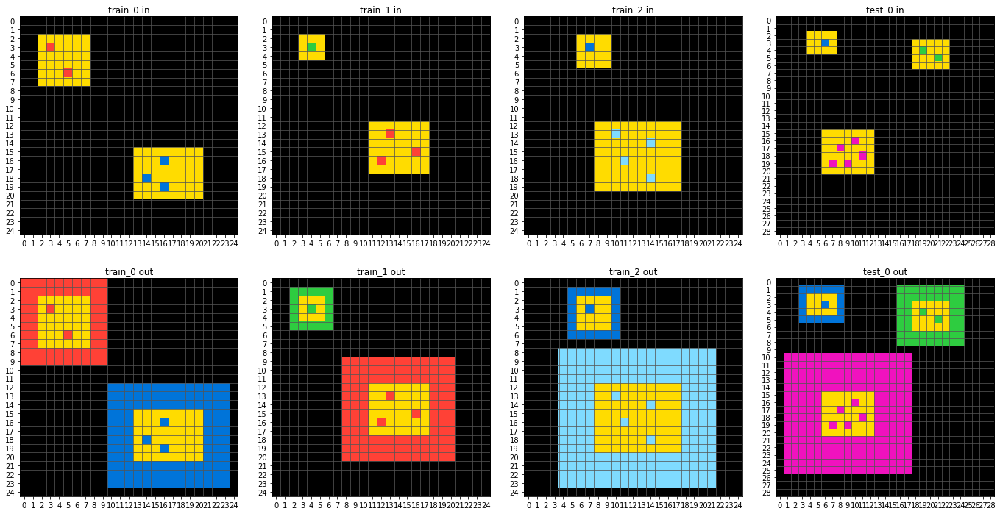

4c177718
no


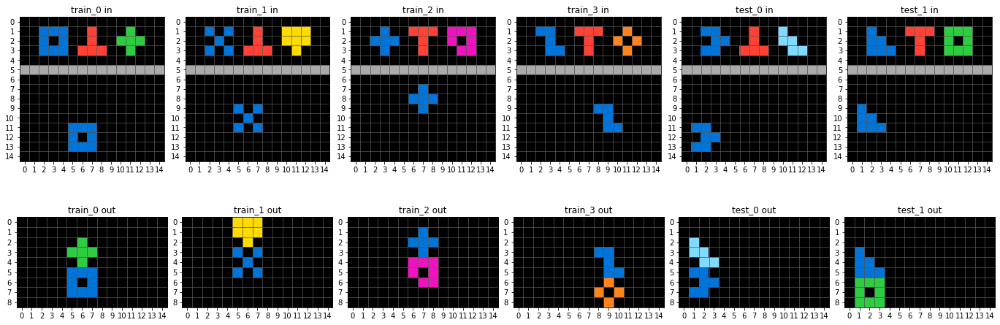

e78887d1
no


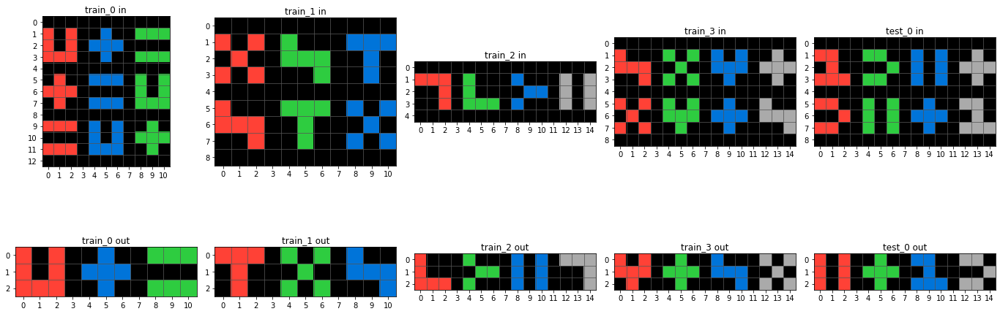

f3b10344
[False, False, False, False]


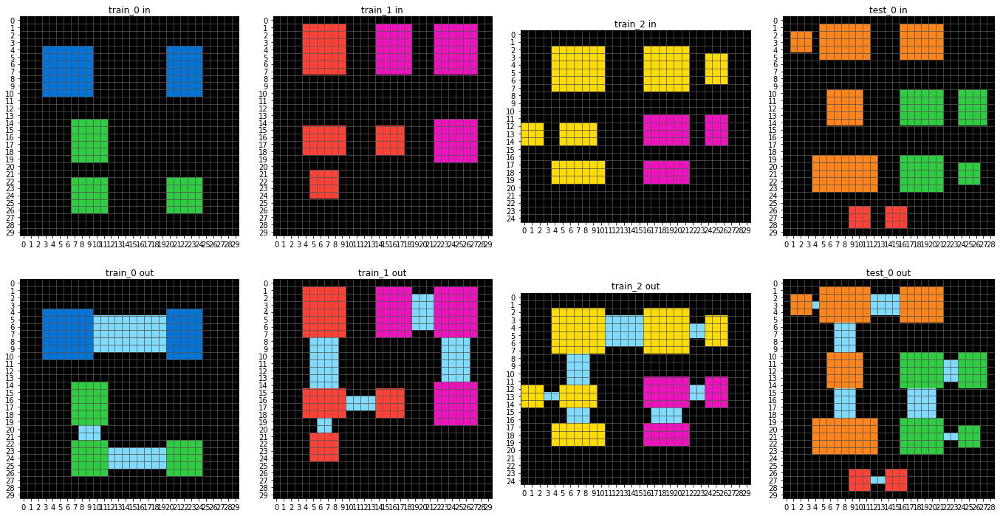

9def23fe
[False, True, True, False]


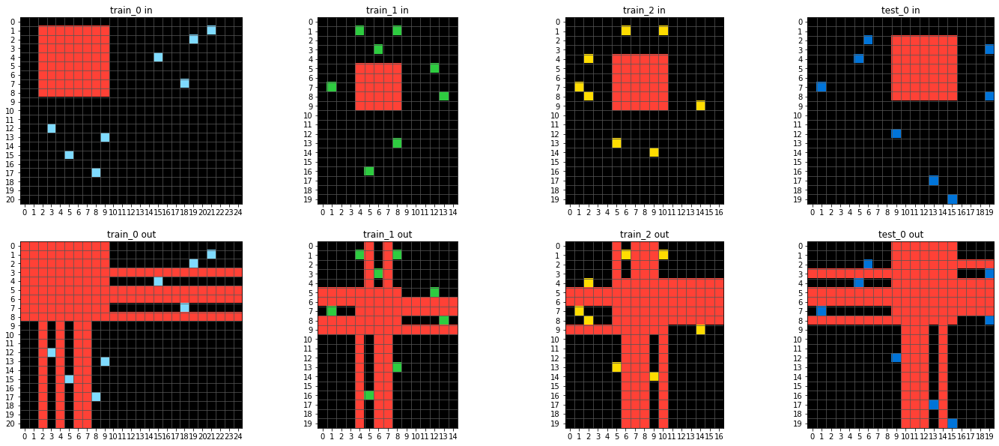

aa4ec2a5
[False, True, True, True]


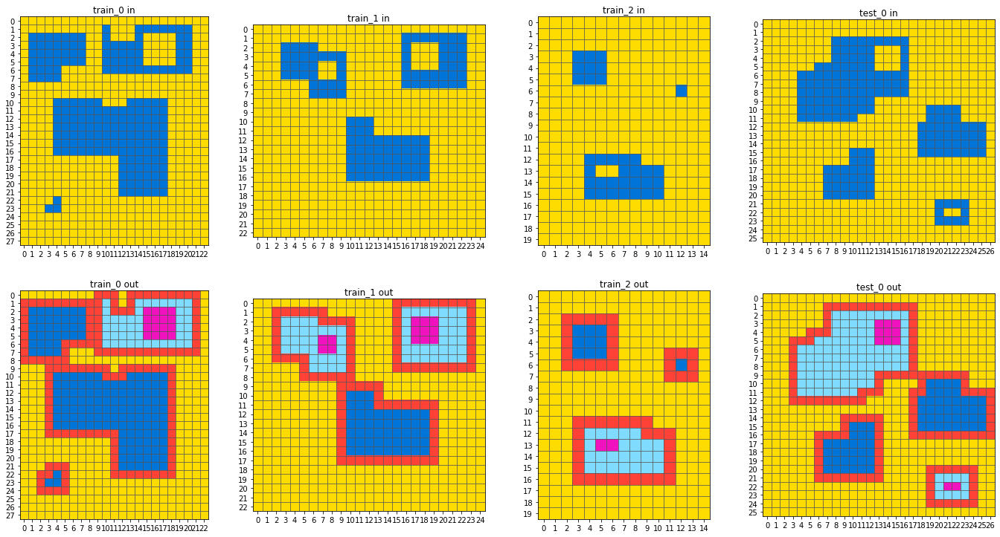

f3cdc58f
no


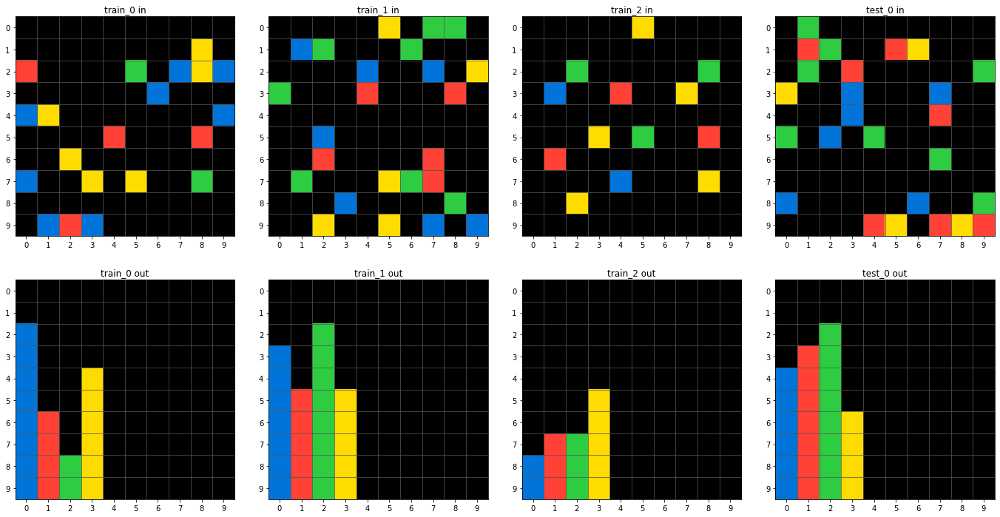

7c9b52a0
no


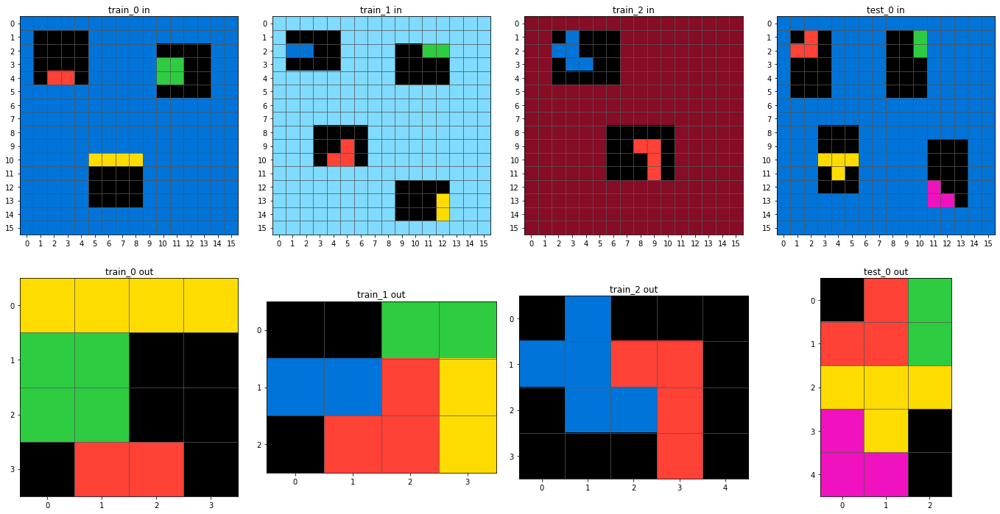

cf133acc
[True, True, False, False]


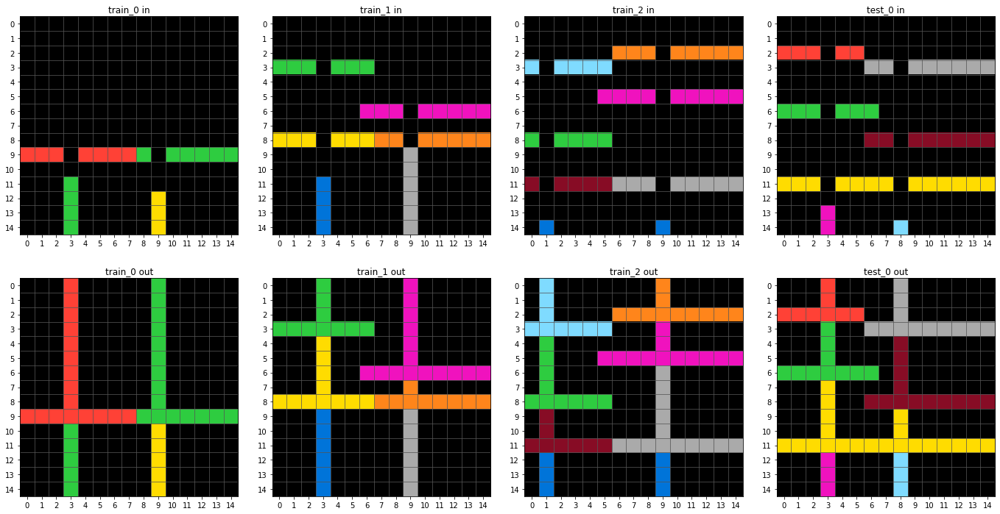

fafd9572
no


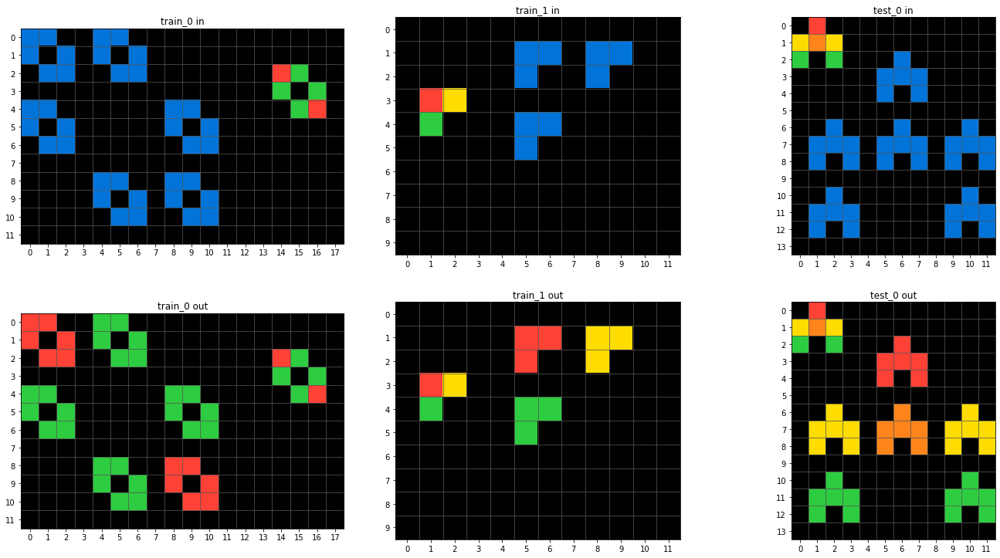

f8be4b64
no


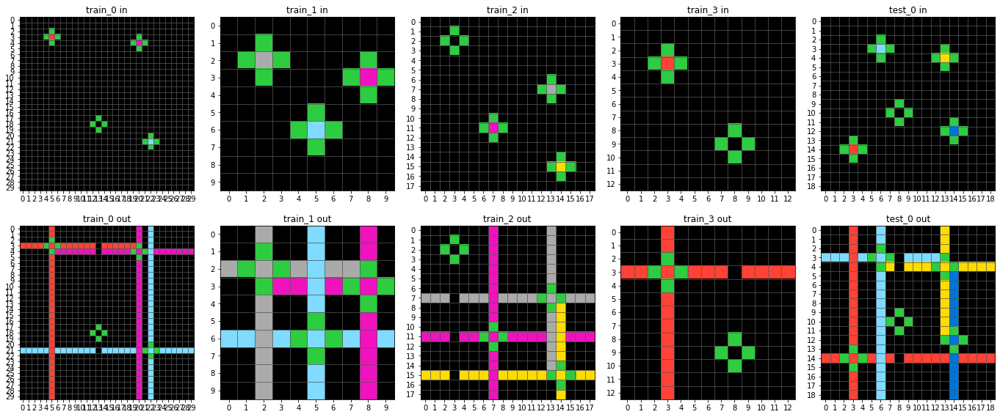

58743b76
no


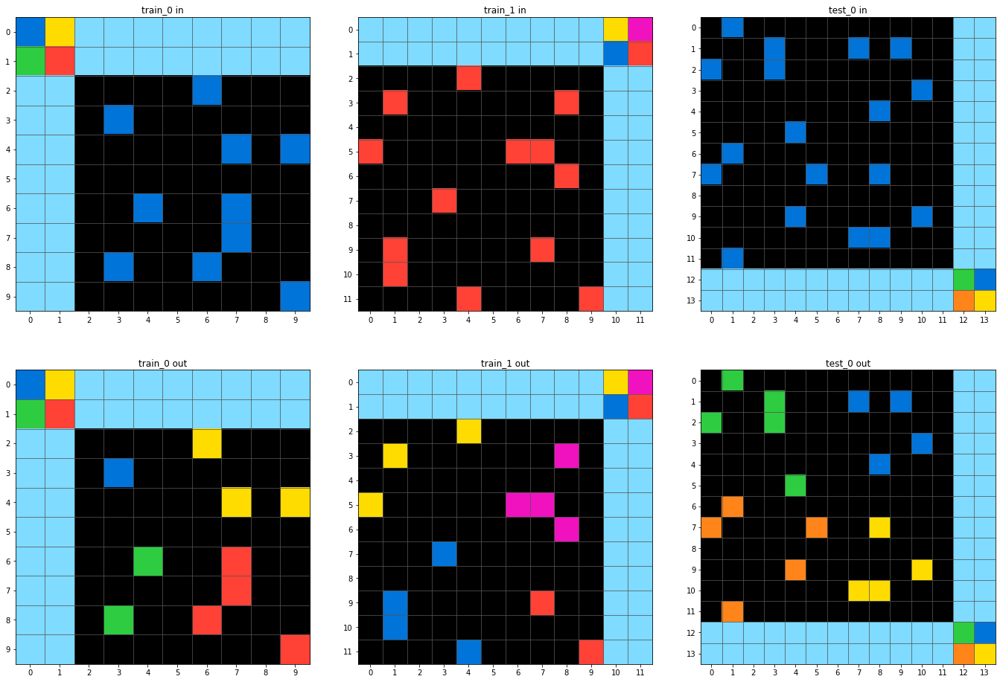

96a8c0cd
[True, False, False, False, True]


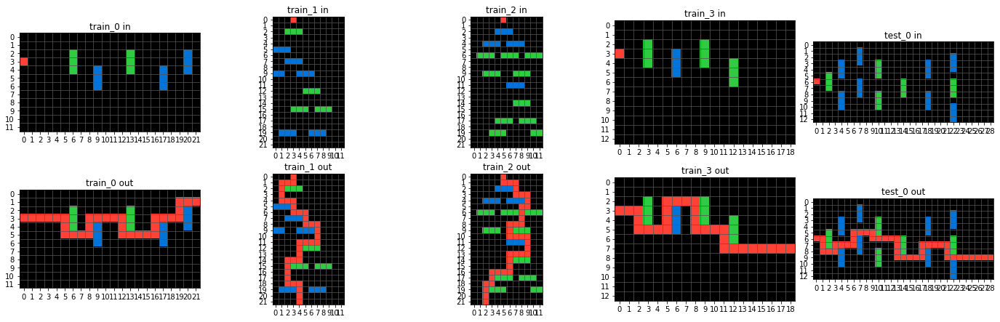

5833af48
no


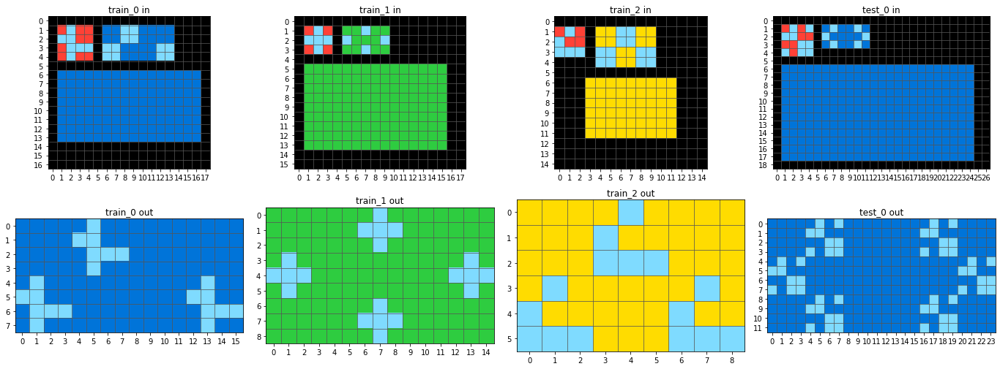

456873bc
no


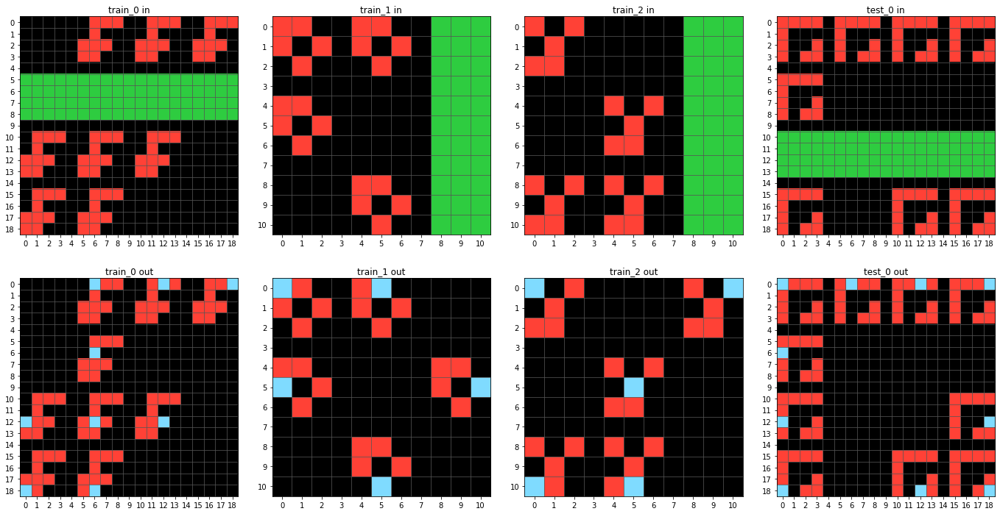

fea12743
no


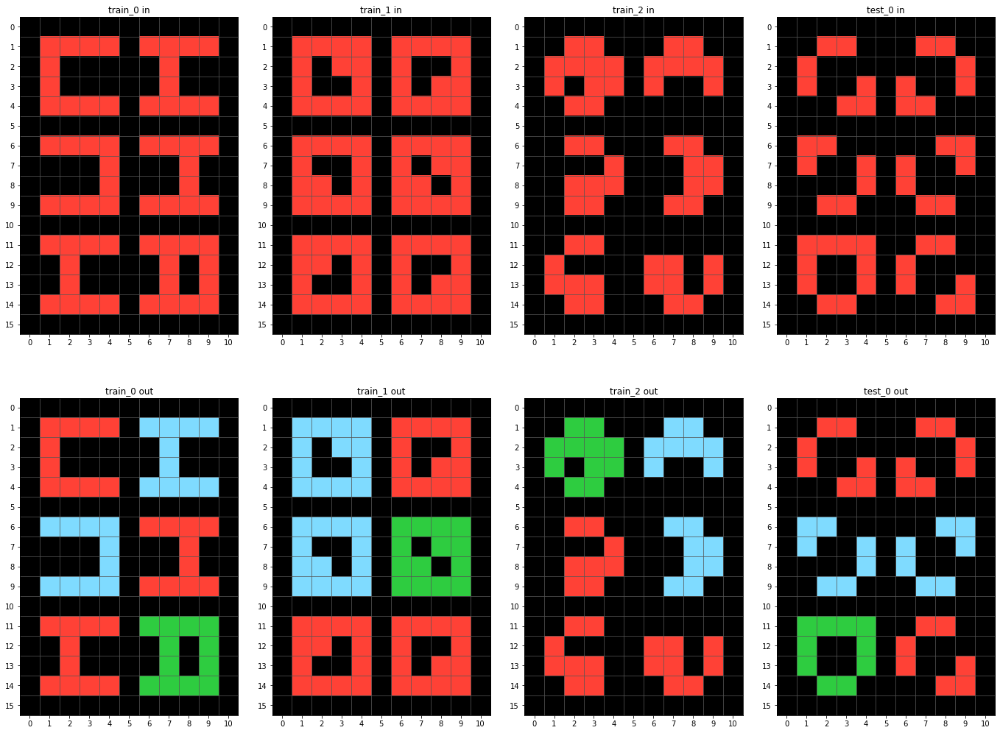

c62e2108
[True, True, True, True]


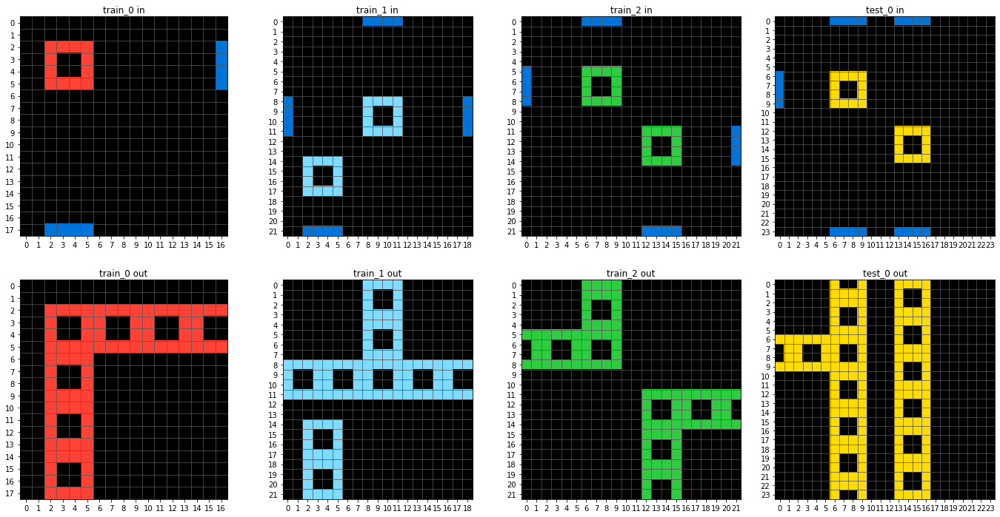

af24b4cc
no


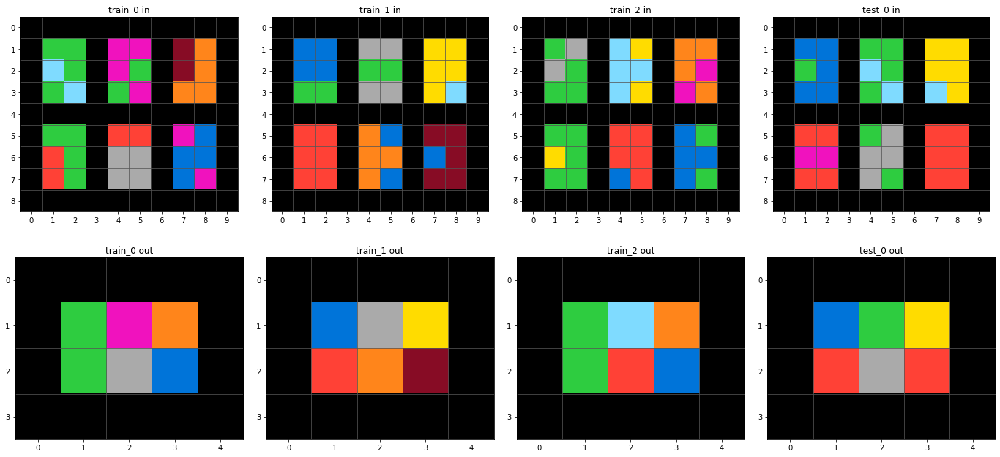

73182012
no


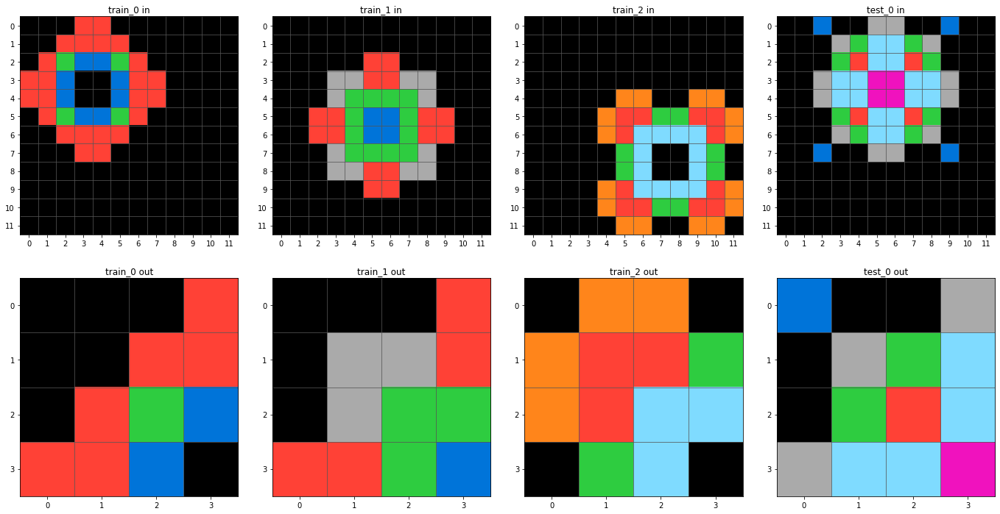

50aad11f
no


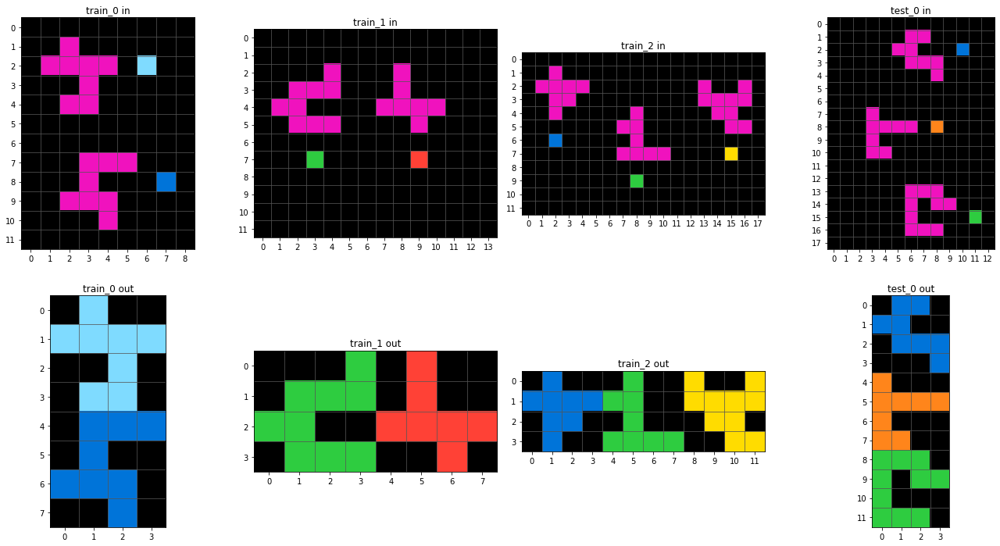

79fb03f4
no


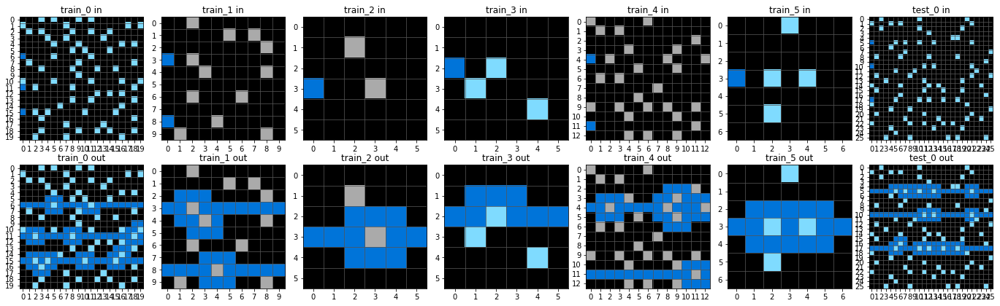

e9b4f6fc
no


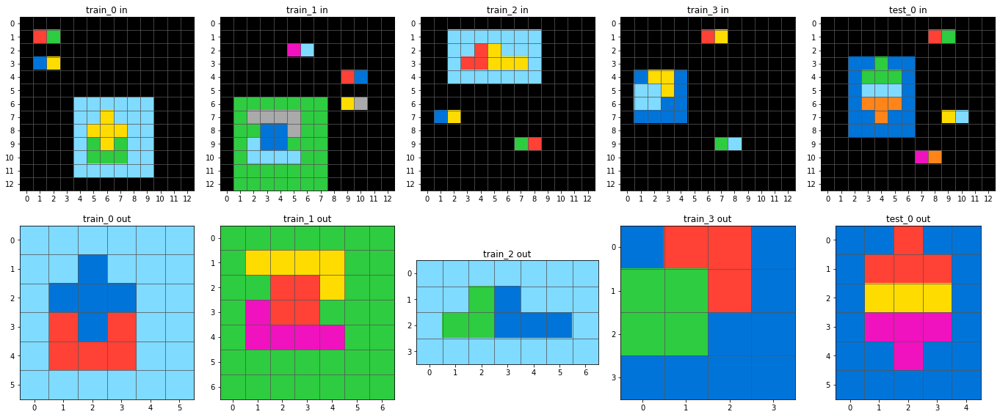

d931c21c
no


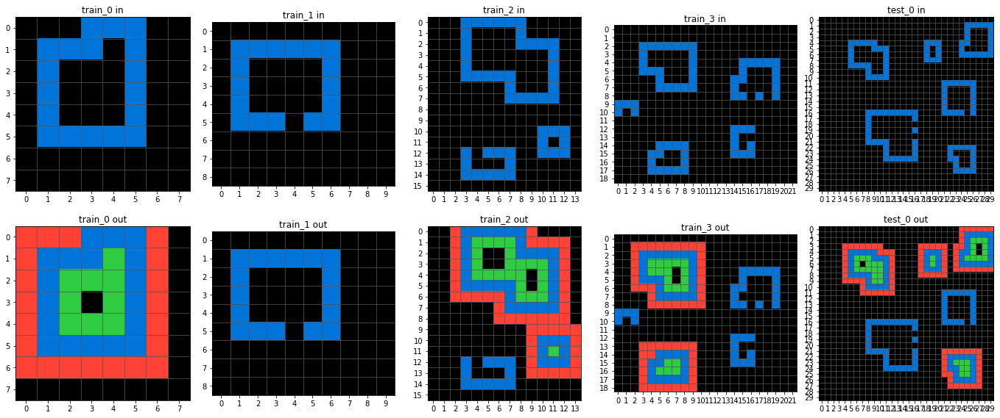

e21a174a
no


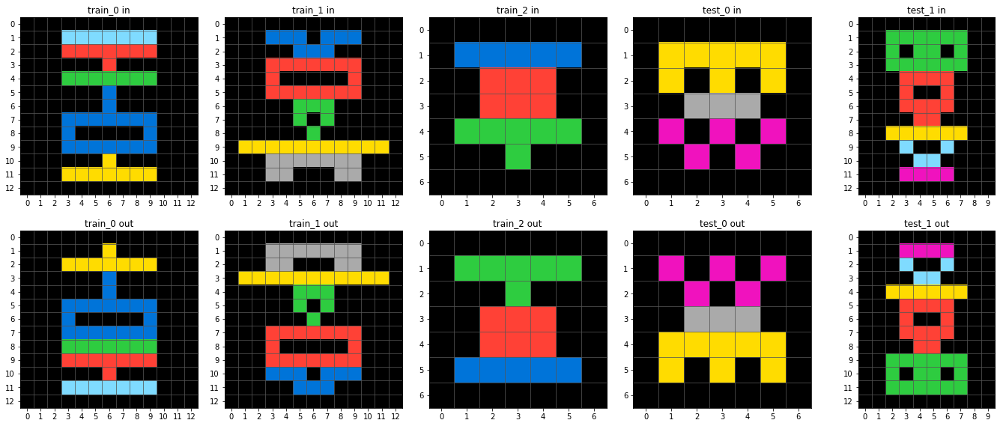

e69241bd
no


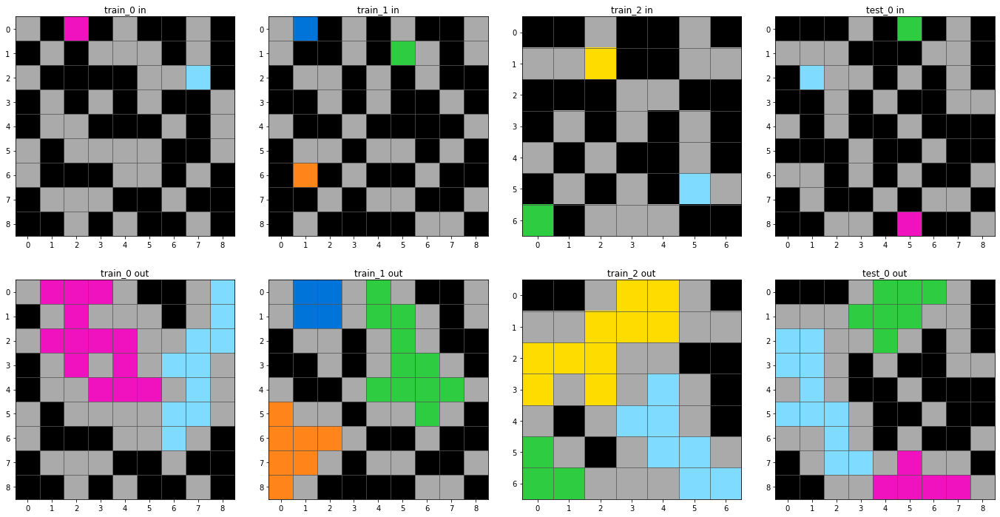

696d4842
[True, True, True, True]


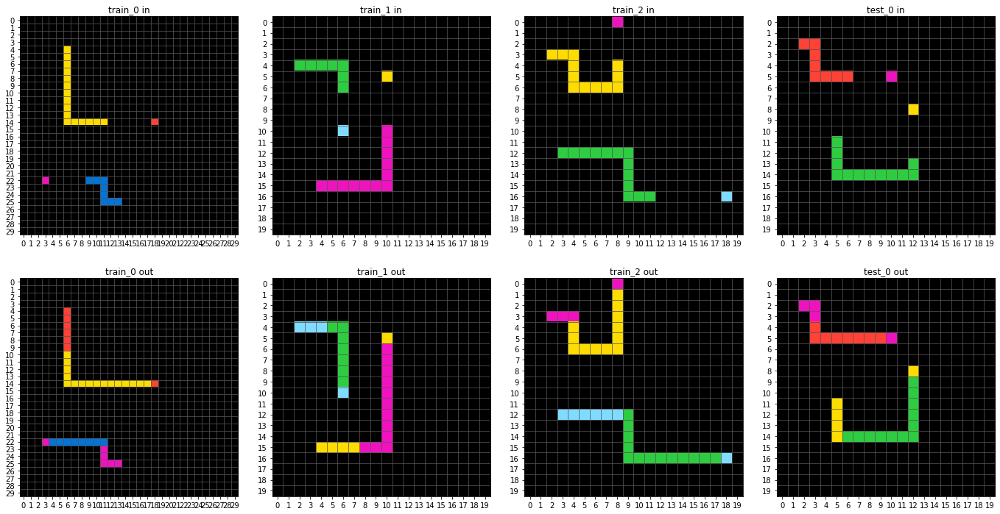

e760a62e
[True, True, True, False]


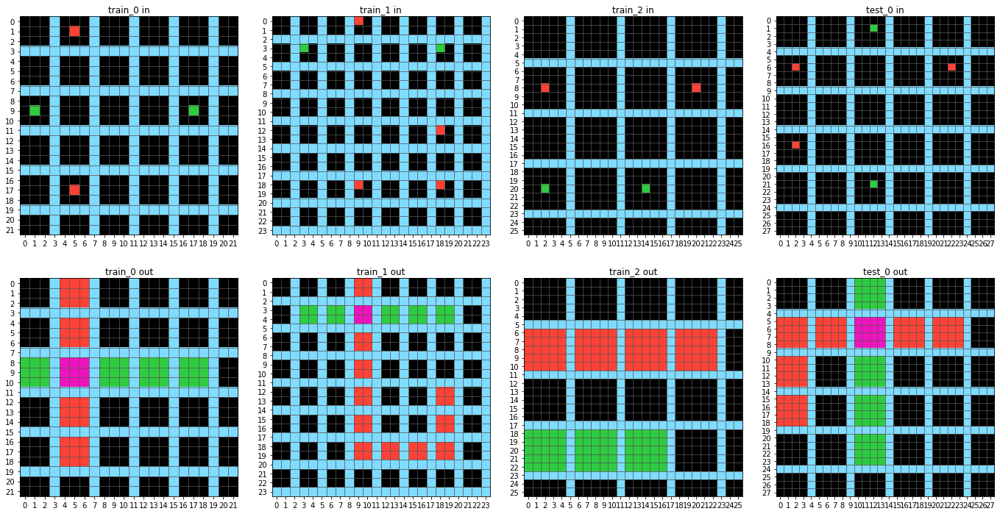

a57f2f04
[False, True, True, True]


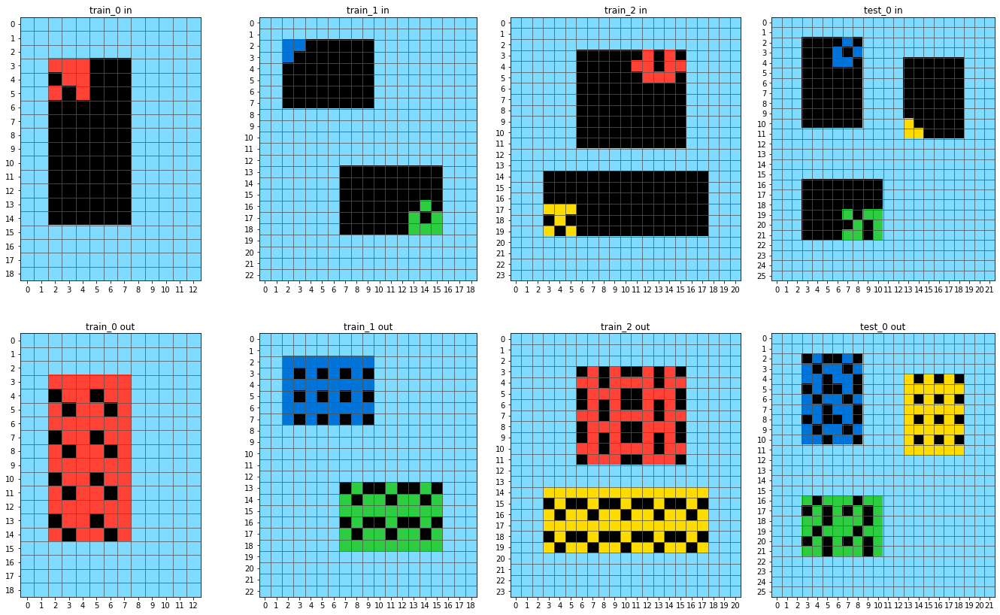

7c8af763
no


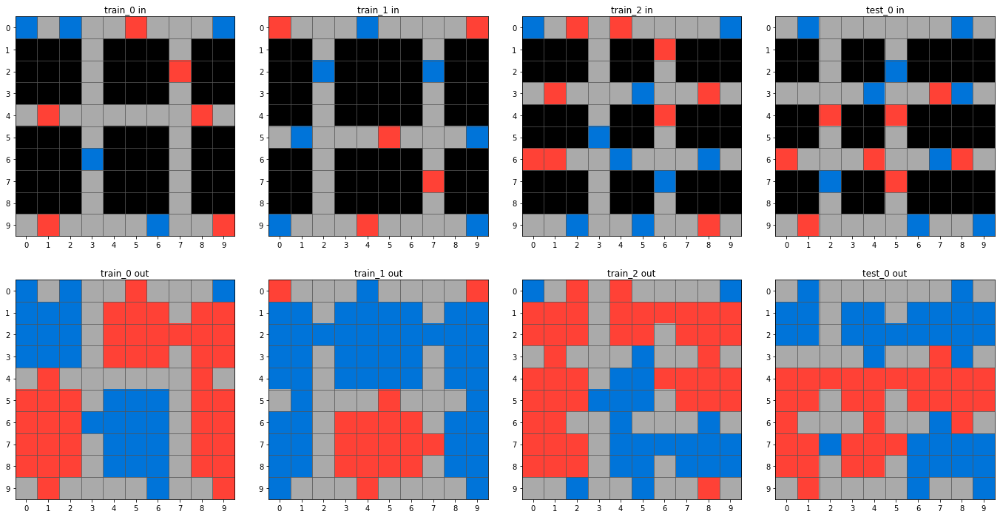

6df30ad6
no


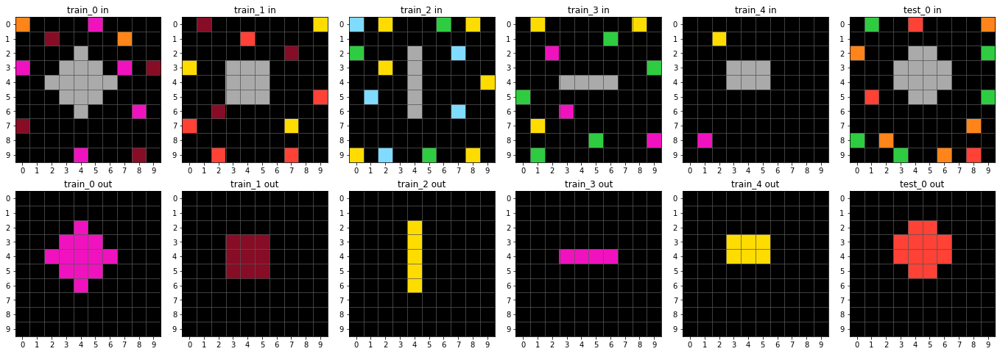

5b526a93
[True, False, False]


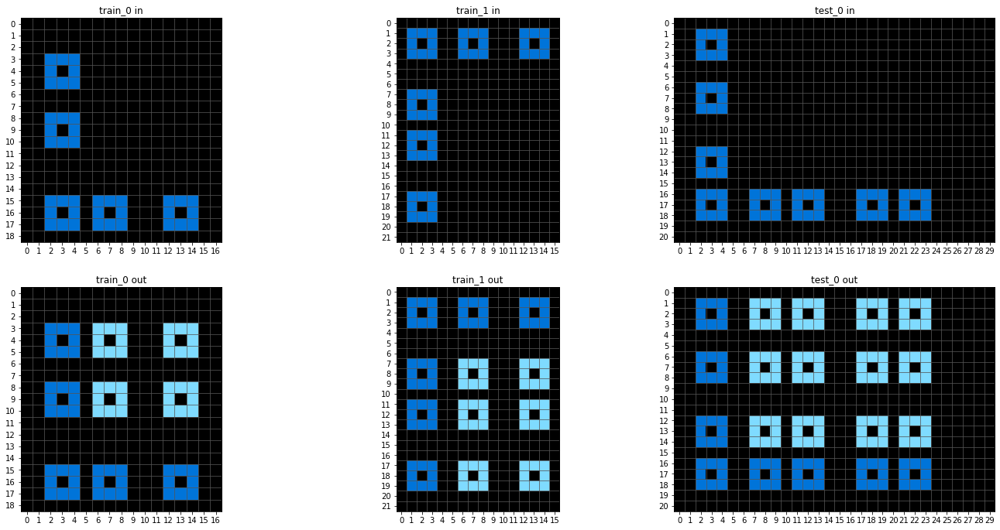

604001fa
no


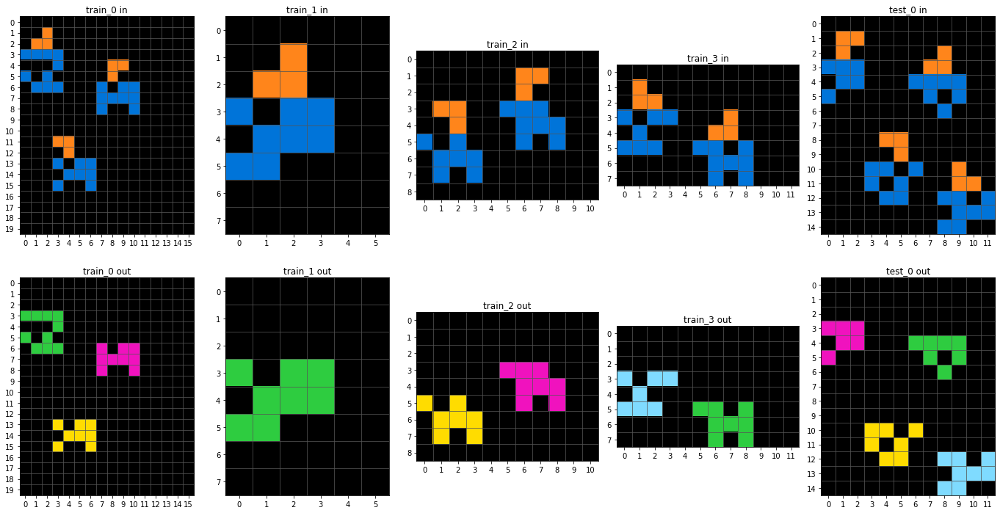

b0f4d537
no


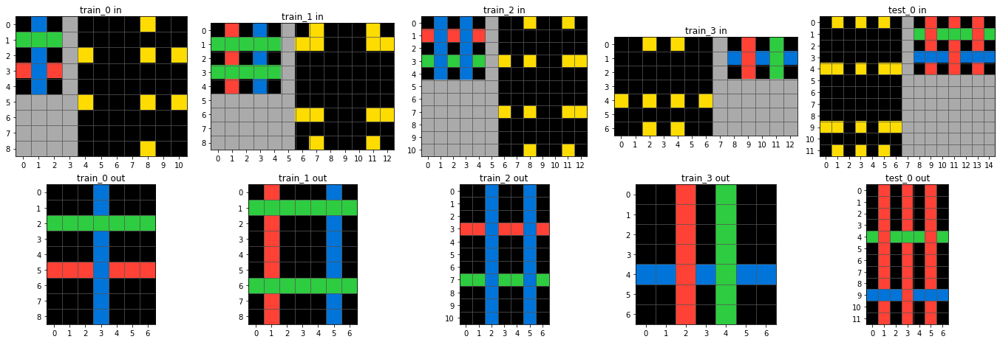

9110e3c5
no


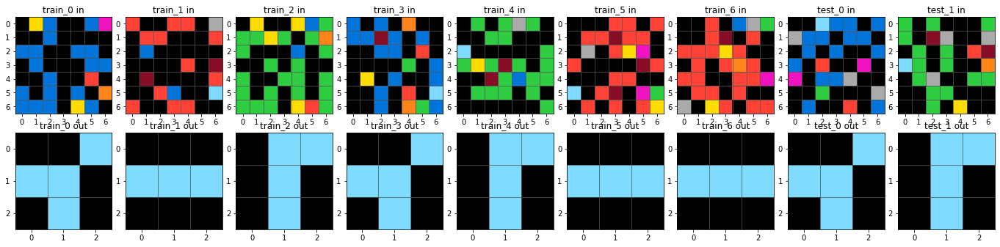

55059096
no


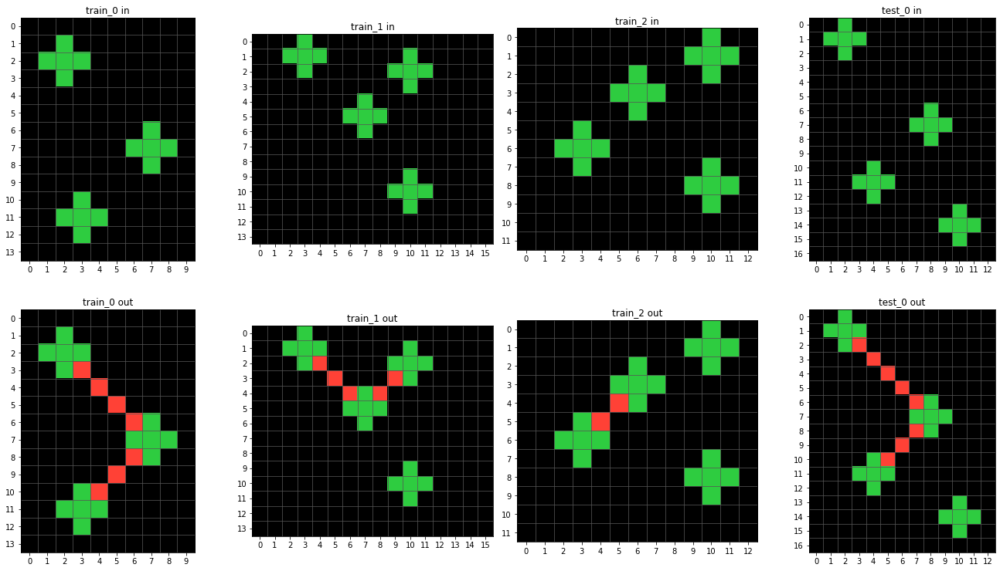

cd3c21df
no


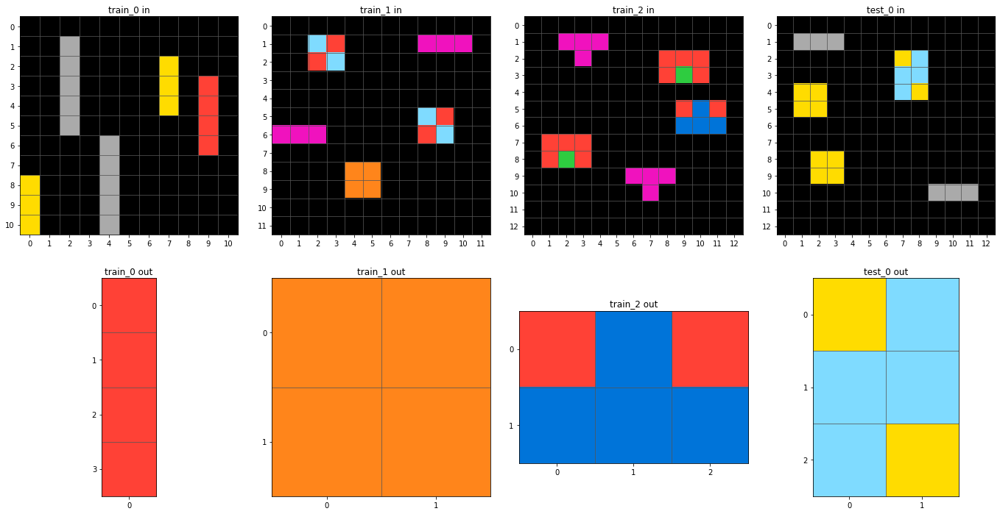

d2acf2cb
no


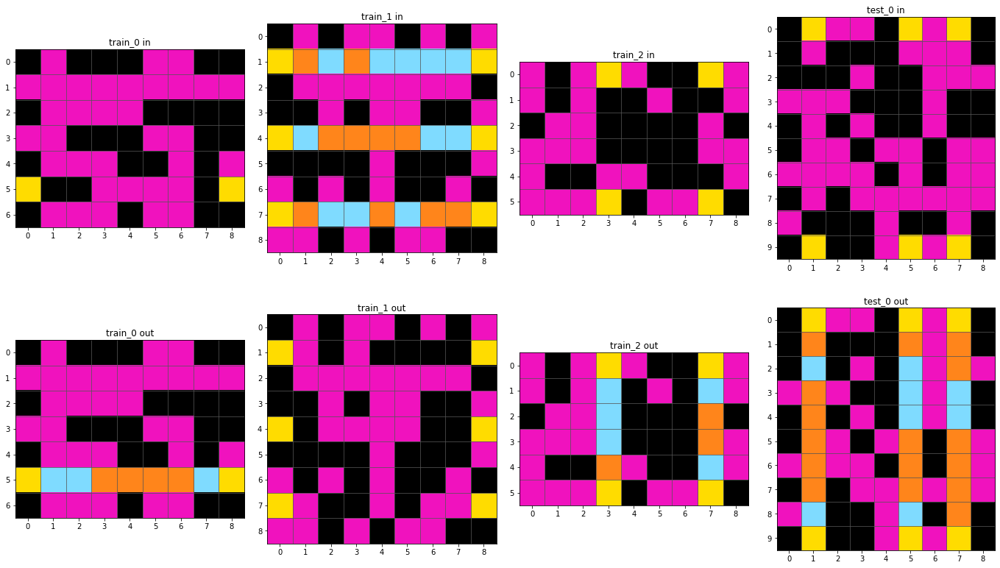

e74e1818
no


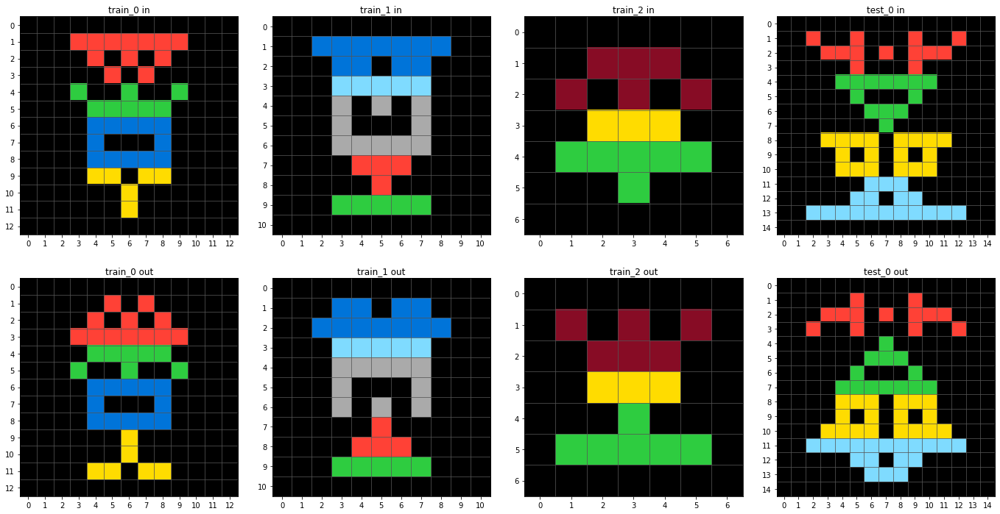

85fa5666
no


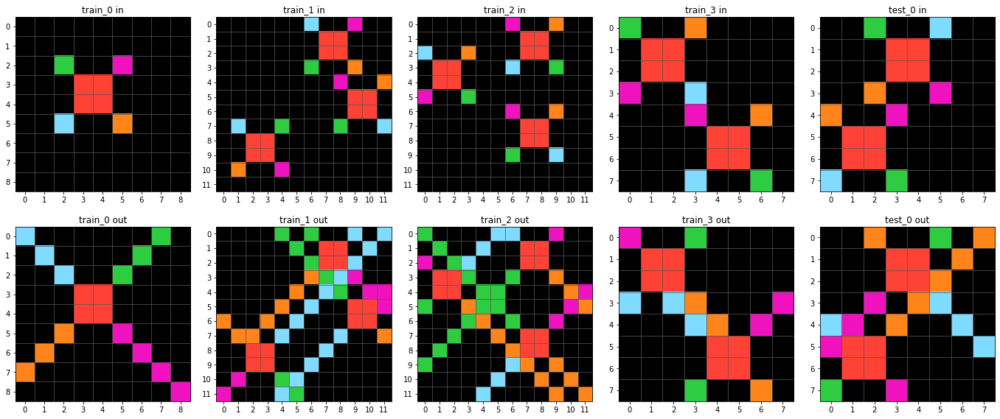

97239e3d
[True, True, True, True]


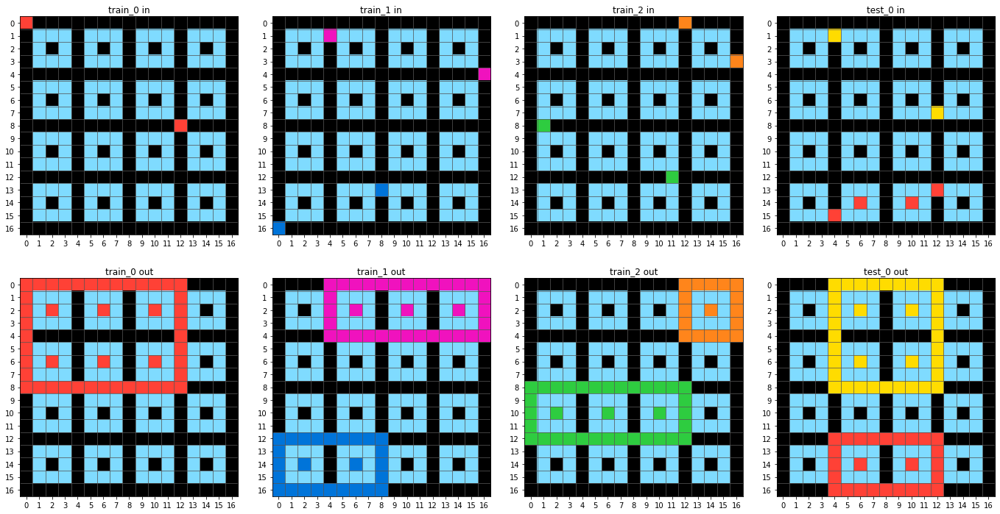

5af49b42
[False, True, True, True]


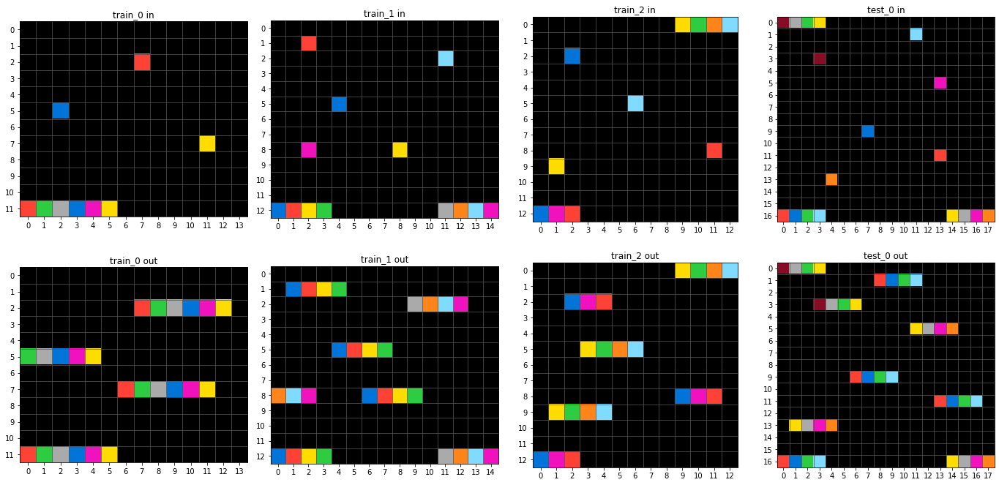

642248e4
no


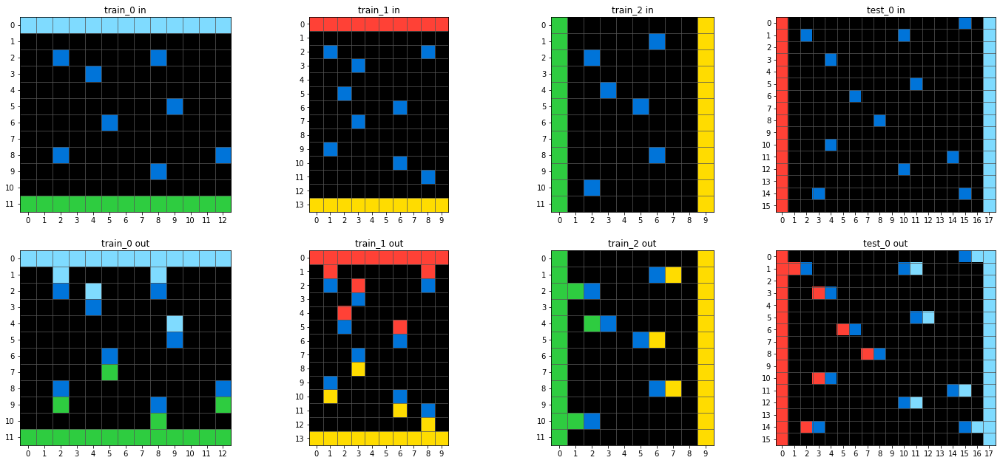

ef26cbf6
no


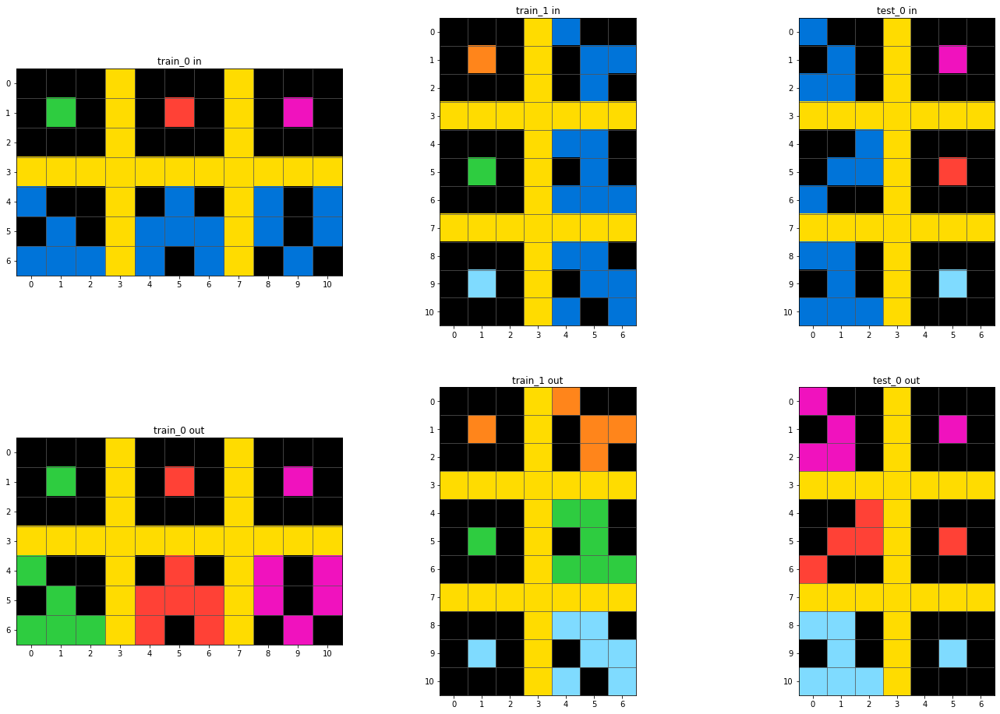

92e50de0
[True, True, True, True]


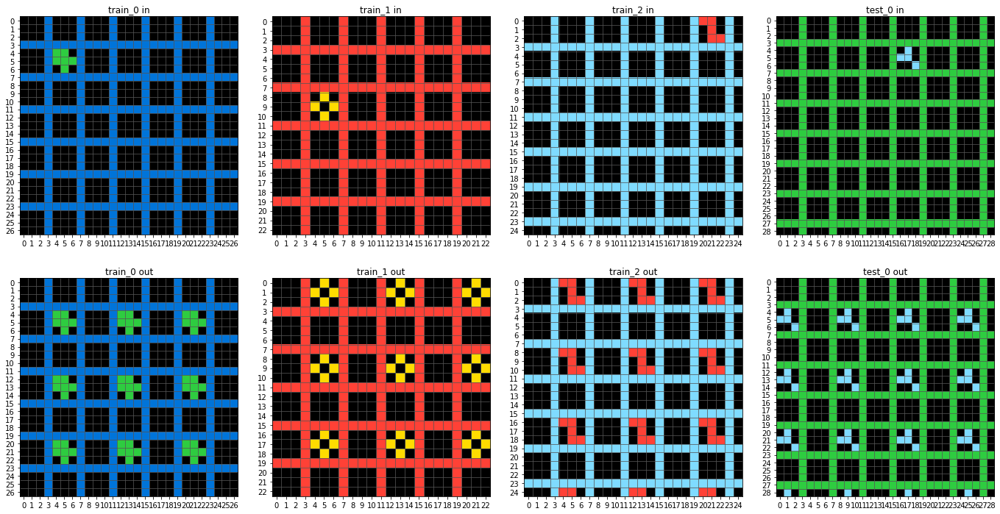

62ab2642
no


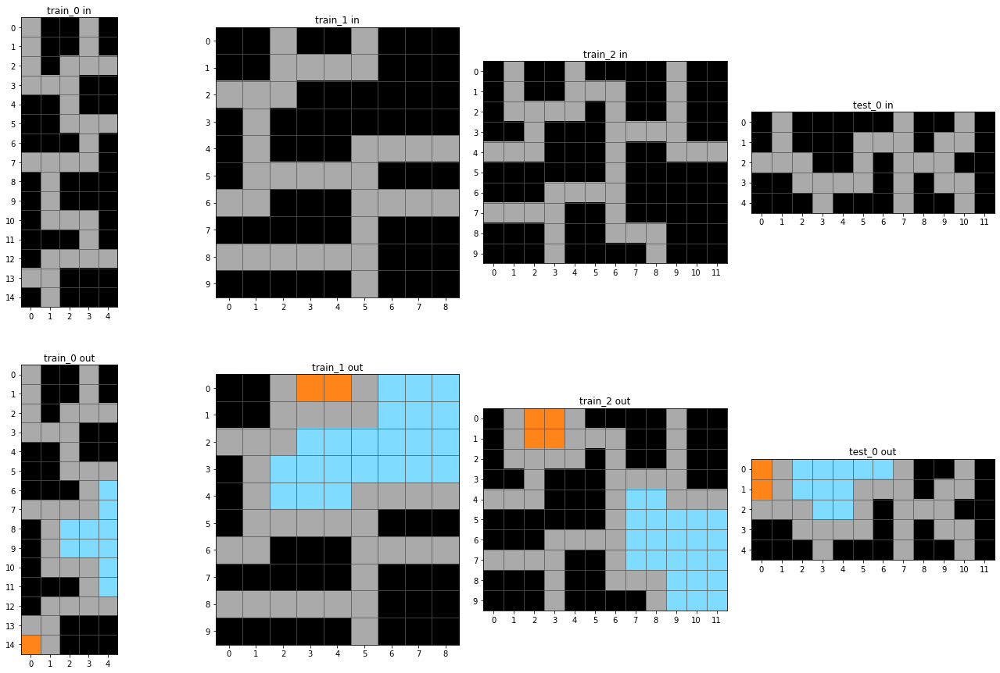

45737921
no


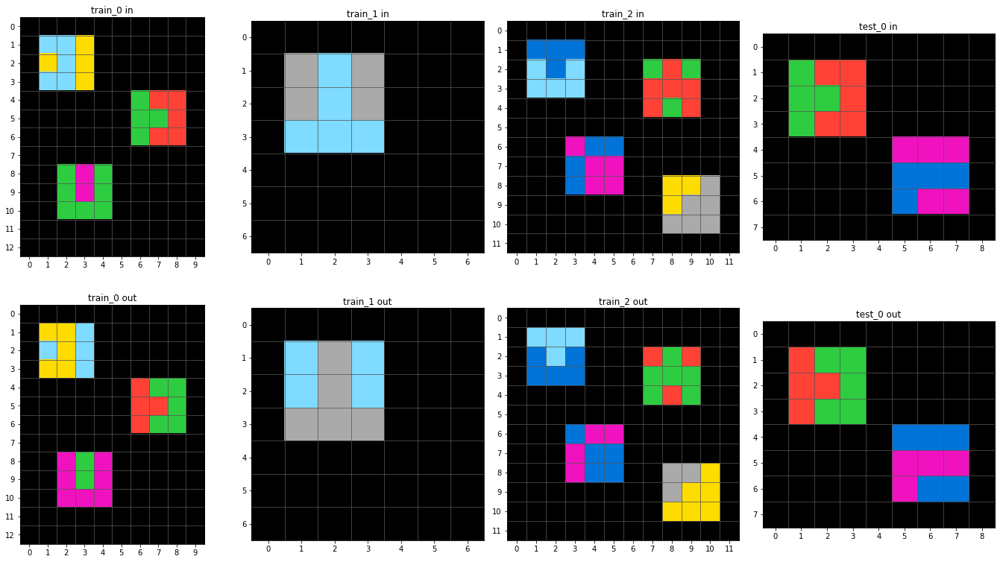

ce039d91
no


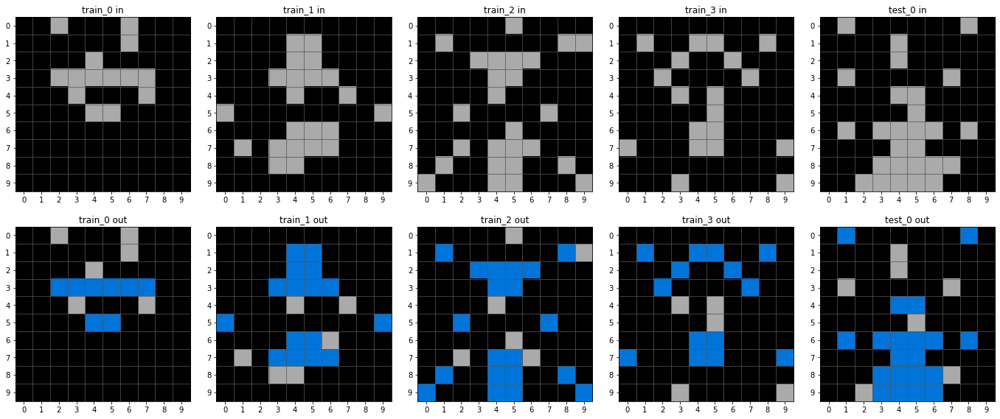

506d28a5
no


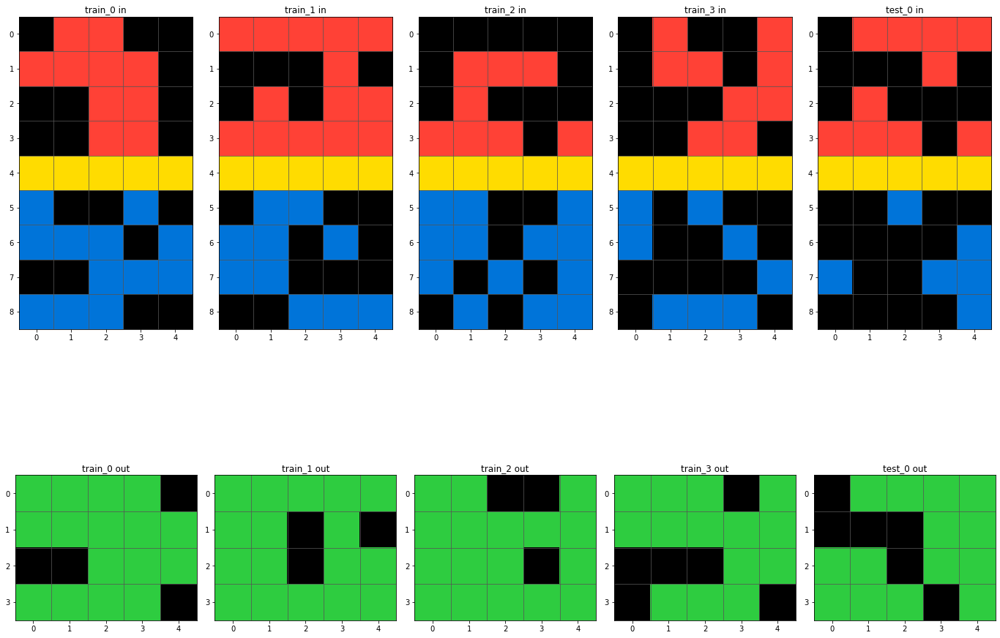

dd2401ed
no


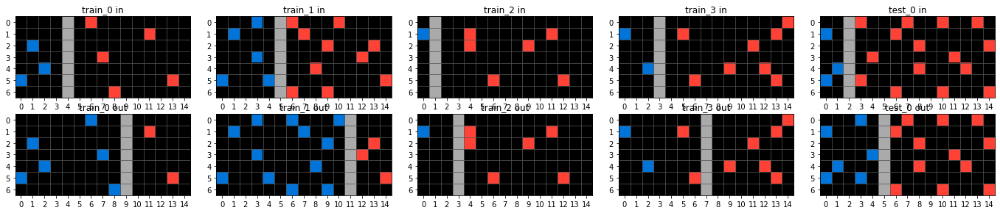

9b4c17c4
no


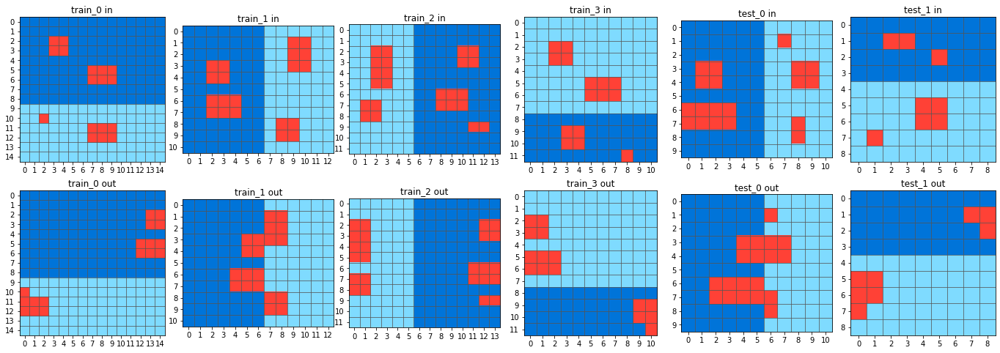

9b2a60aa
[True, True, True, False]


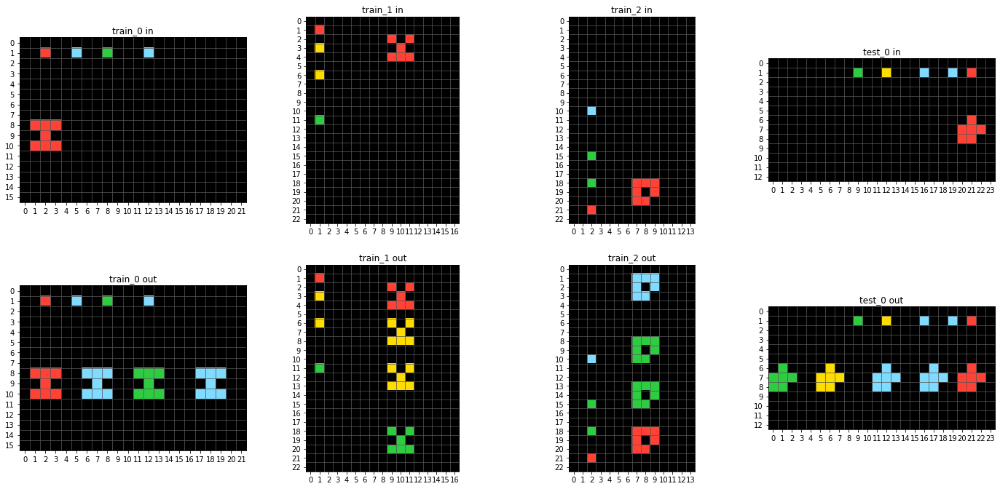

60a26a3e
no


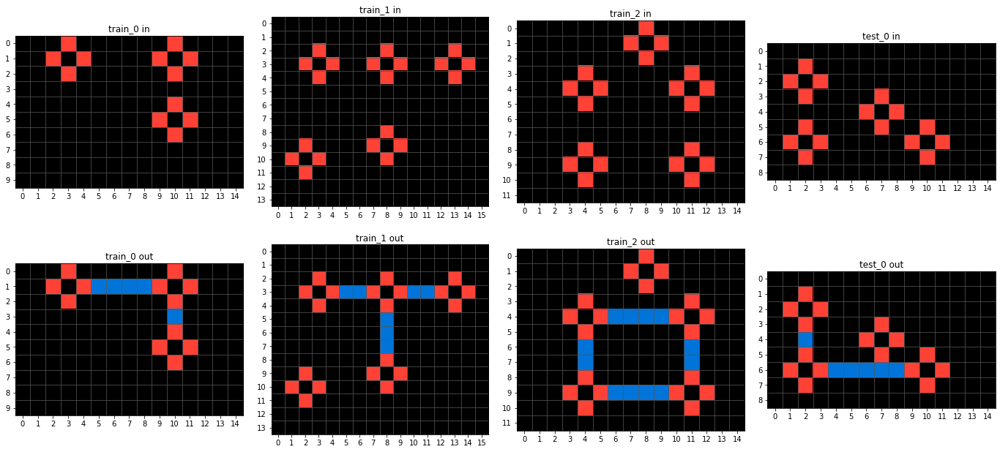

67636eac
no


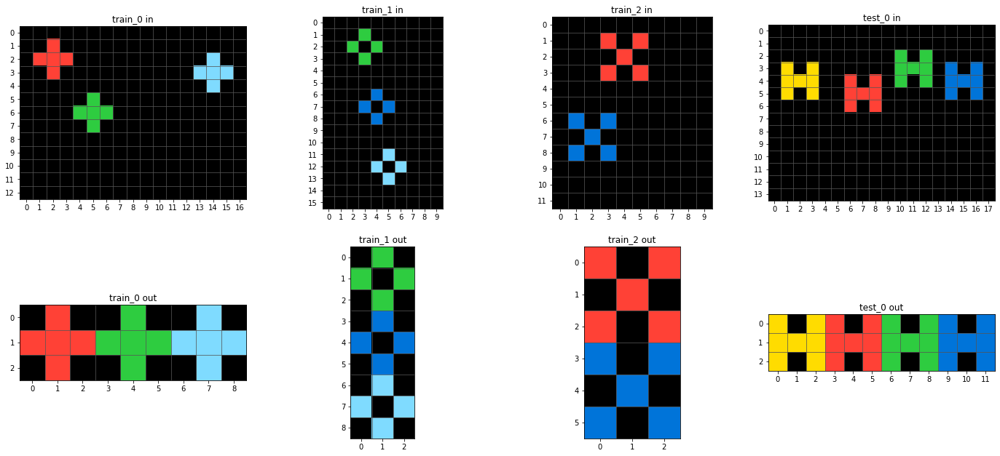

85b81ff1
[True, False, False, True, False]


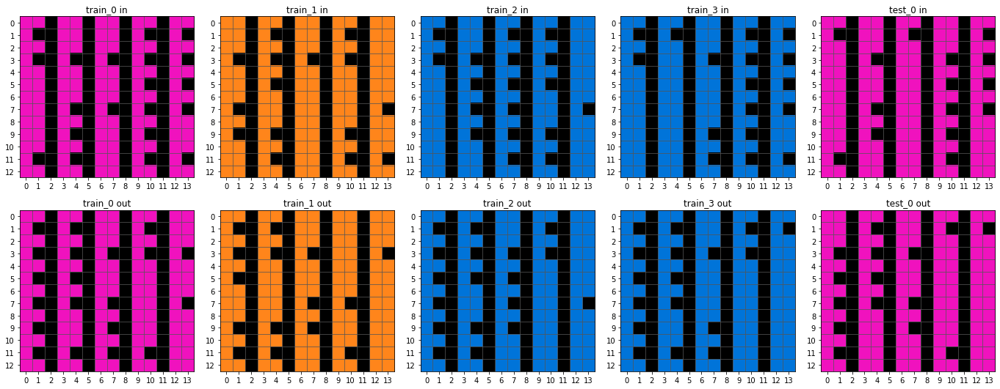

5289ad53
no


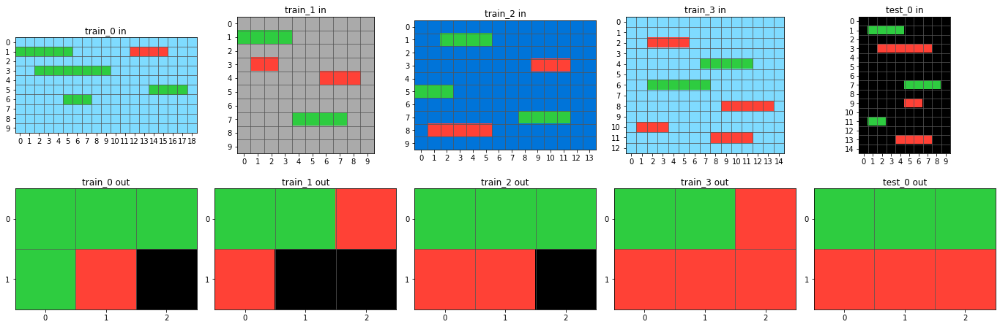

ac3e2b04
no


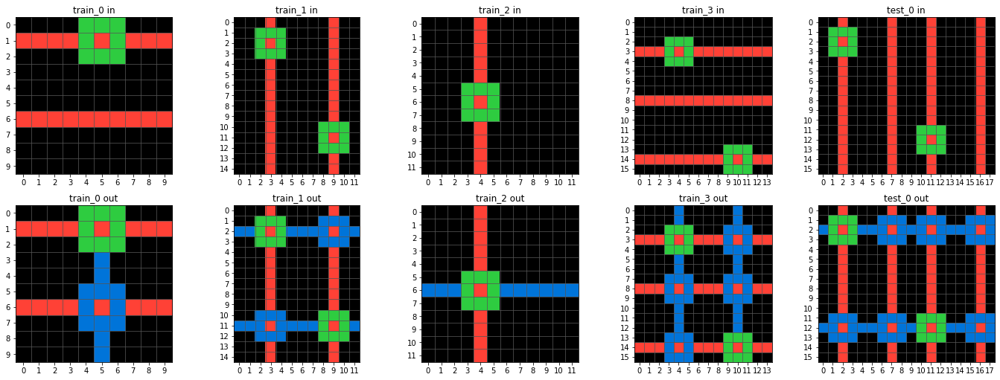

e7a25a18
no


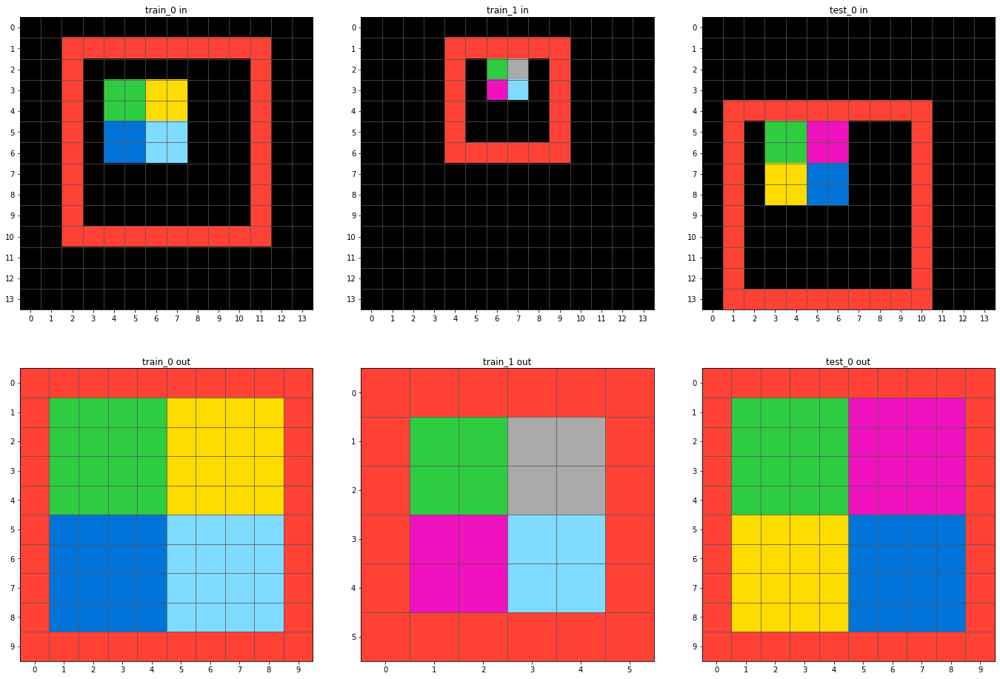

c8b7cc0f
no


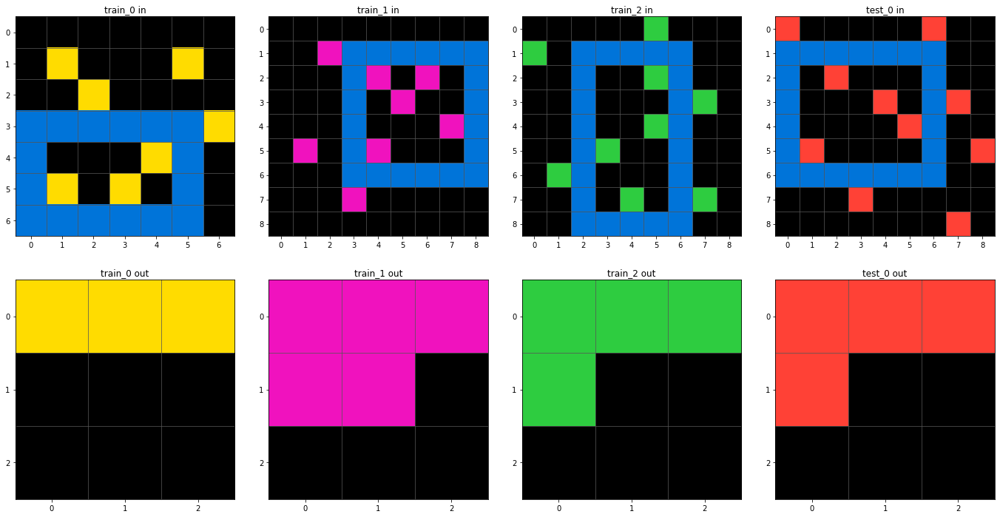

f9a67cb5
no


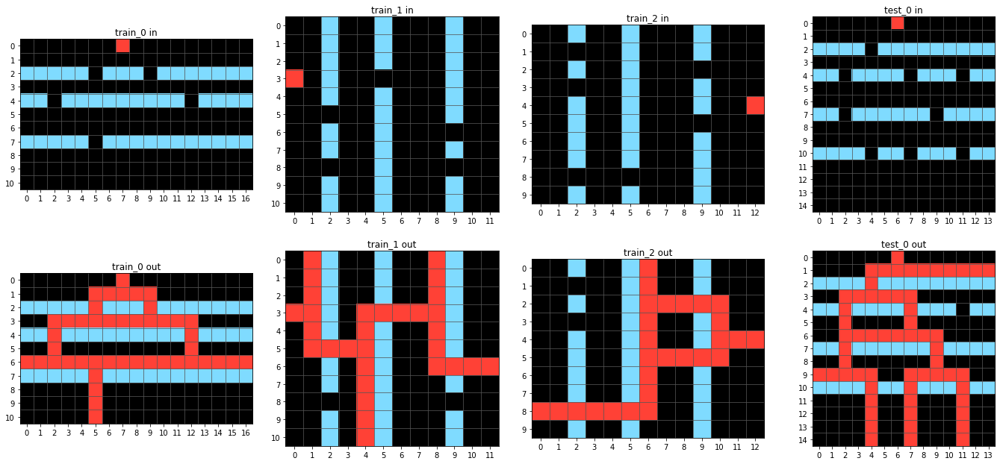

cfb2ce5a
no


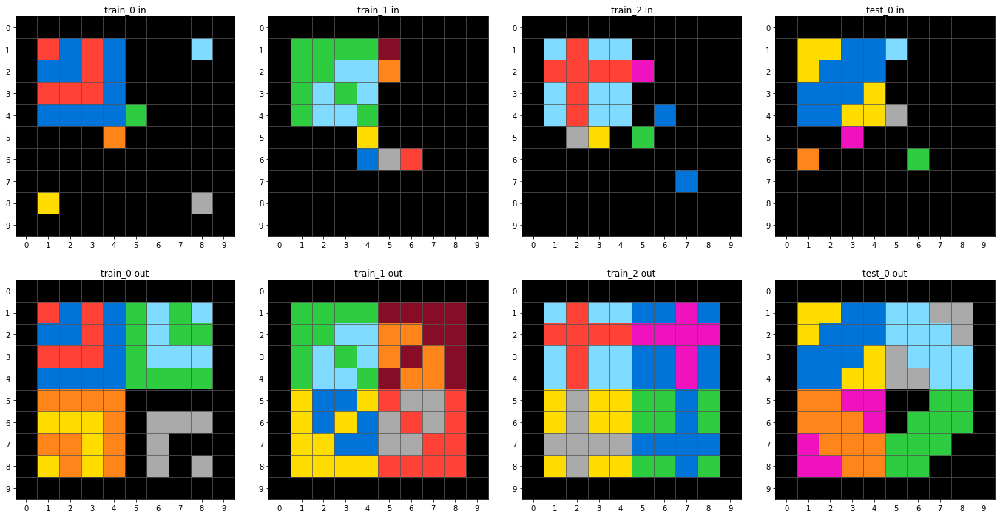

ce8d95cc
no


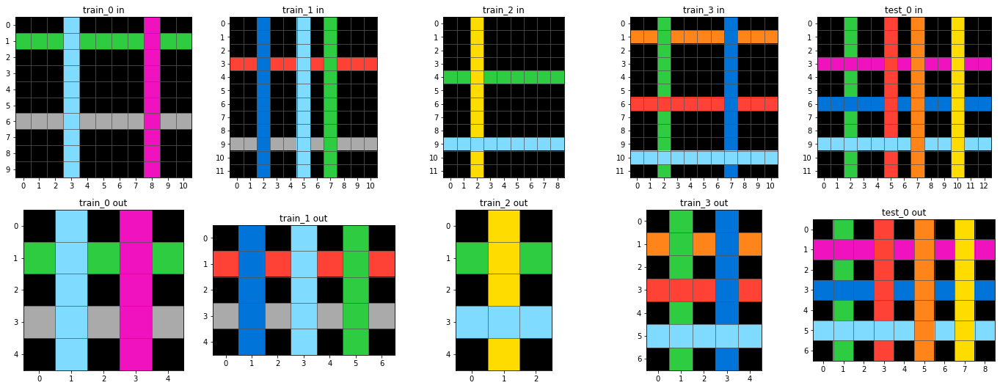

9c56f360
no


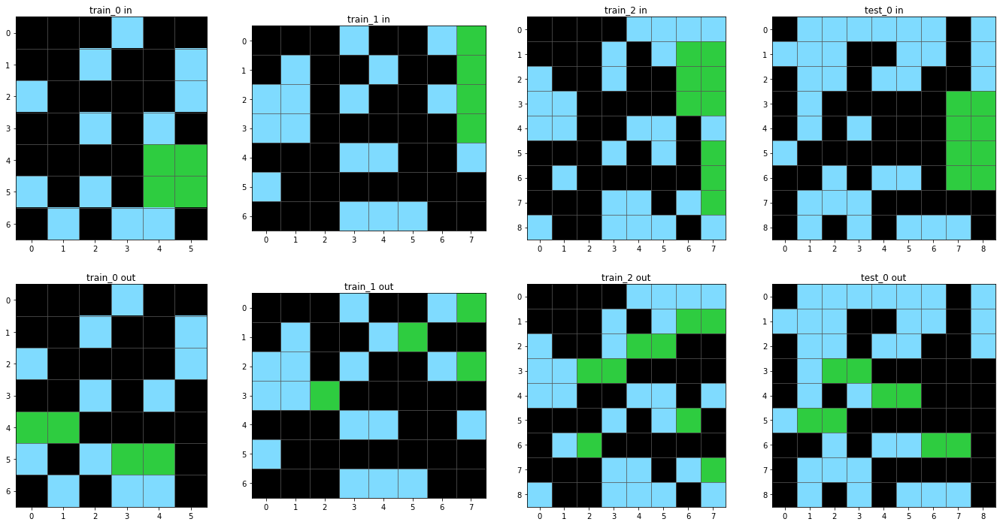

9f27f097
[True, True, False, True]


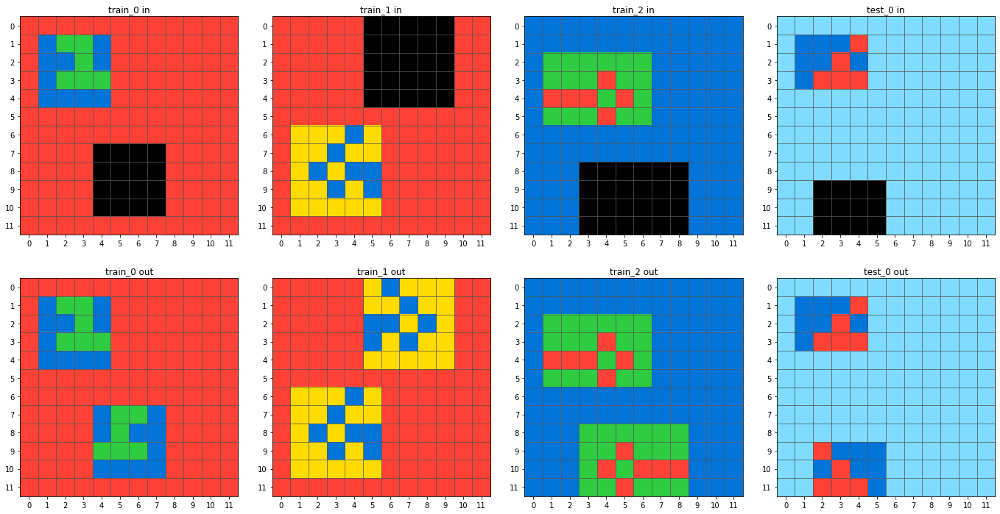

917bccba
[False, True, True, True]


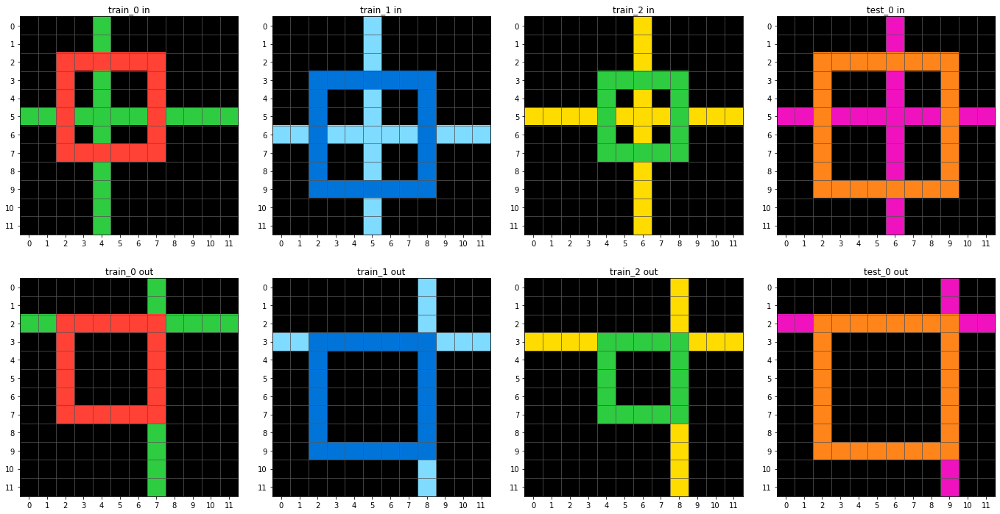

8ee62060
no


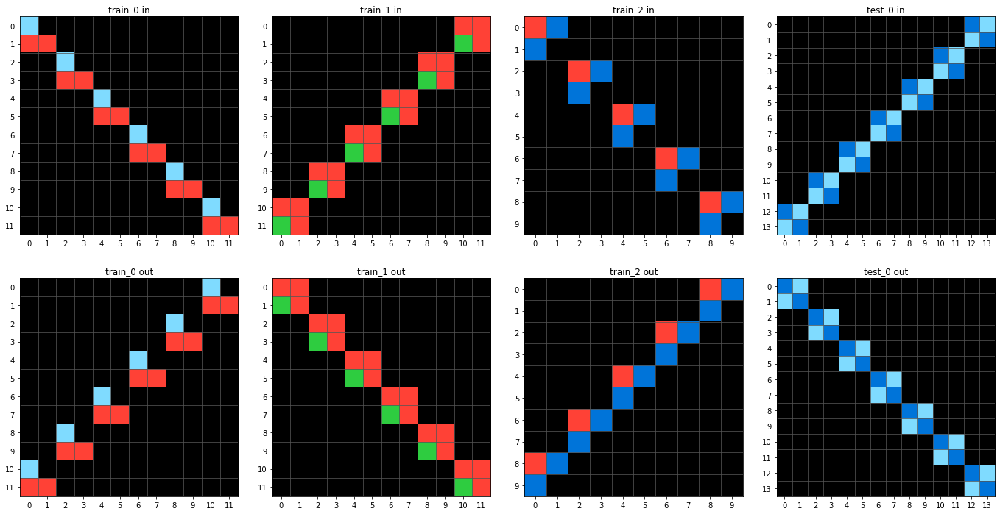

66f2d22f
no


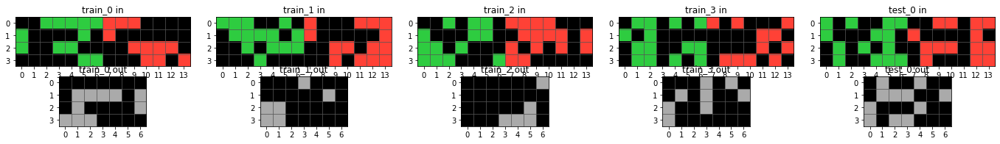

ae58858e
no


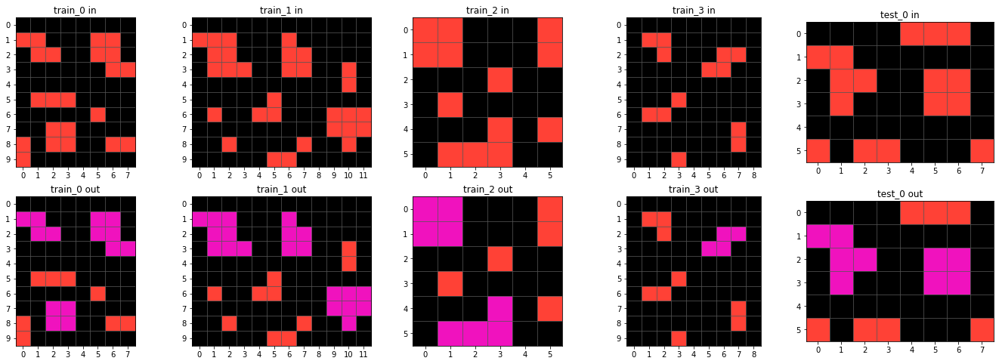

b4a43f3b
[False, False, False, False, False]


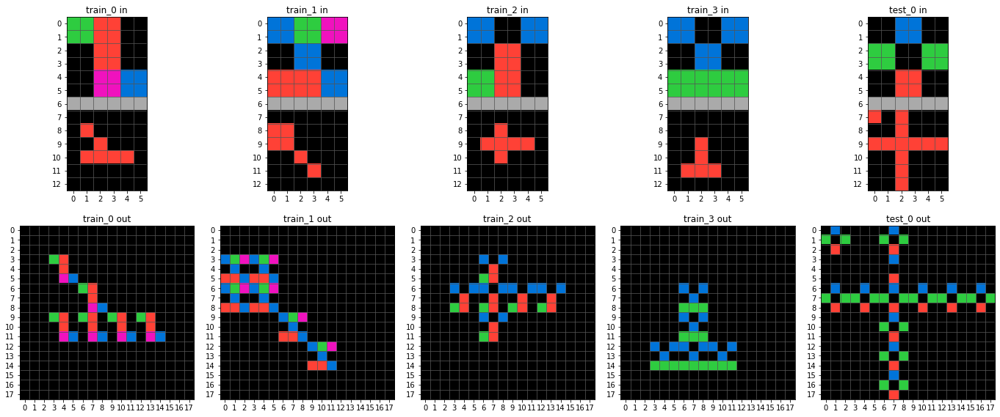

d19f7514
no


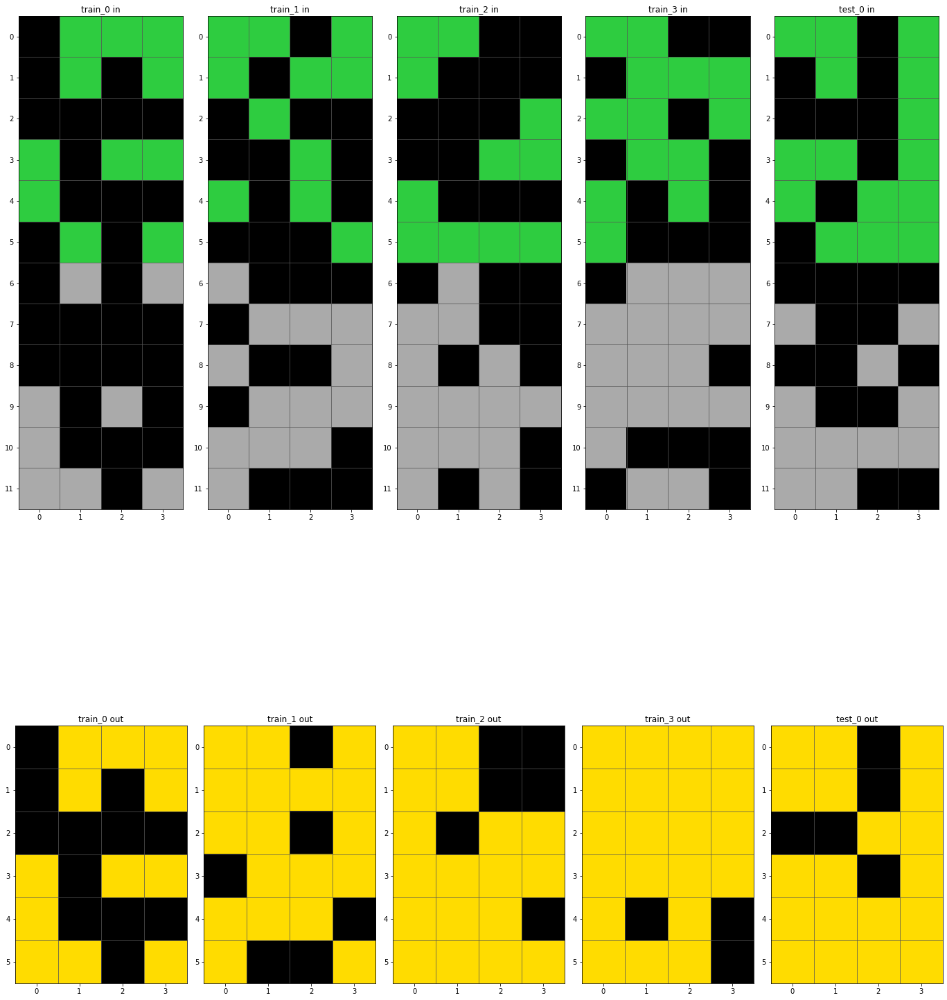

84f2aca1
no


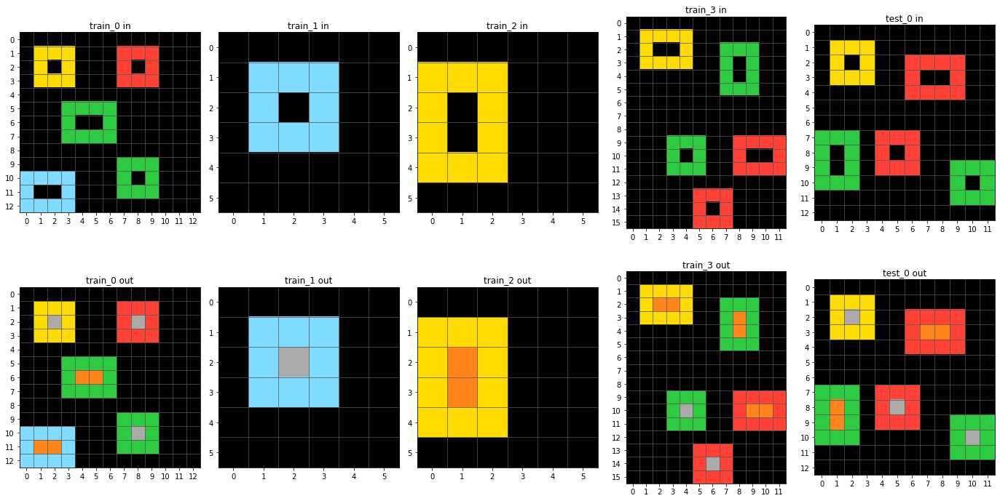

9b365c51
no


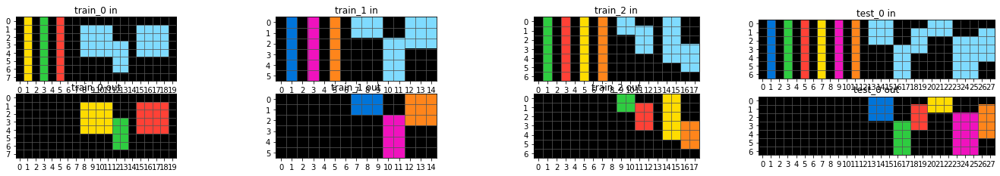

5783df64
no


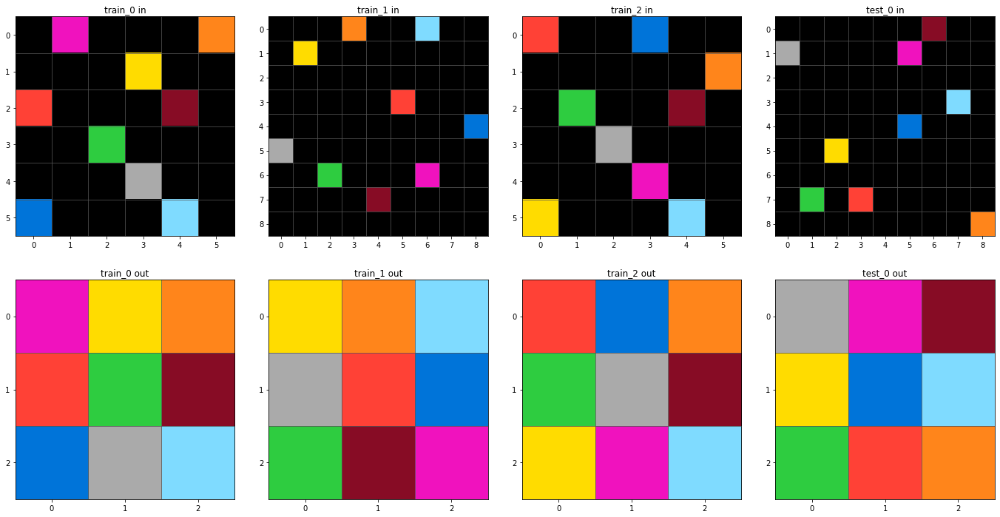

692cd3b6
[False, False, True, False]


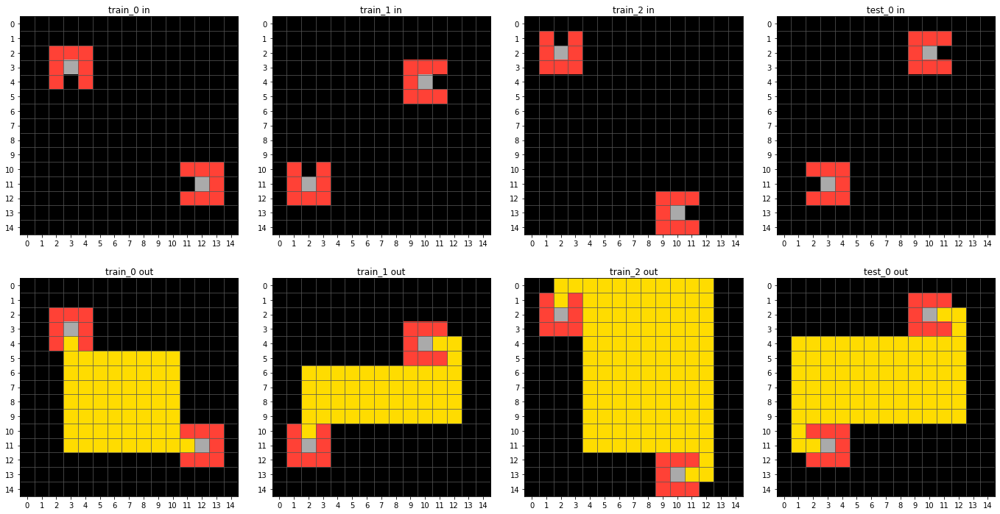

5d2a5c43
no


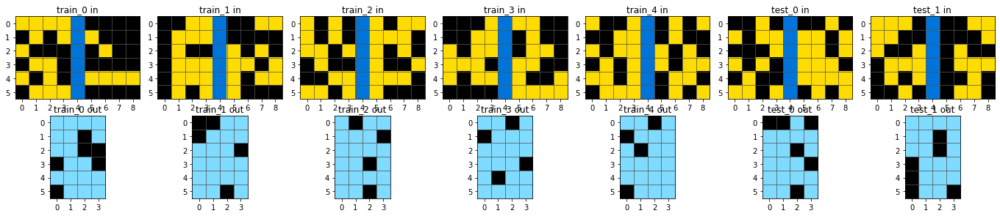

aa300dc3
no


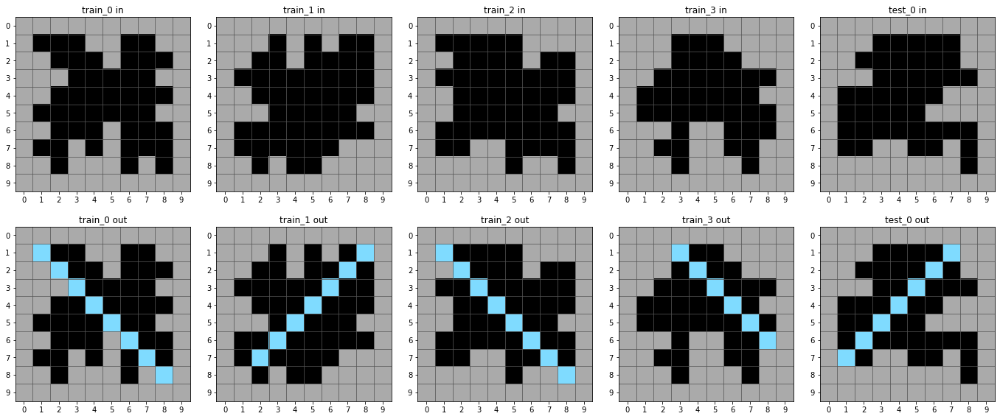

4acc7107
no


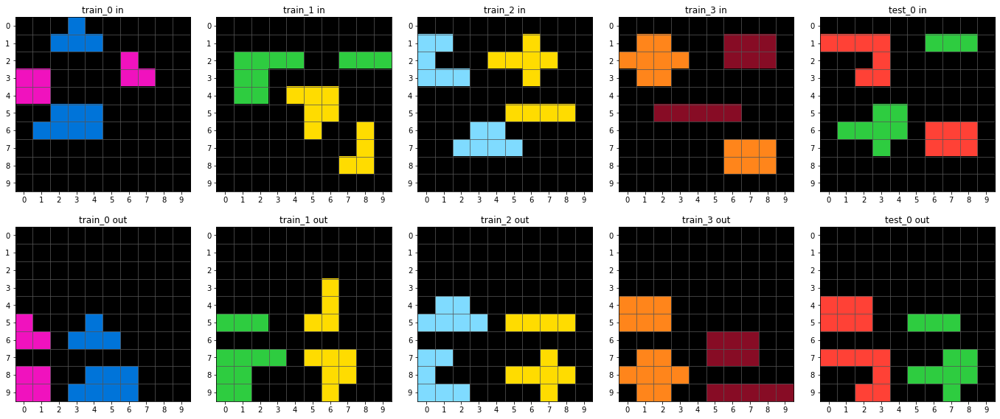

e4075551
[False, False, True, False]


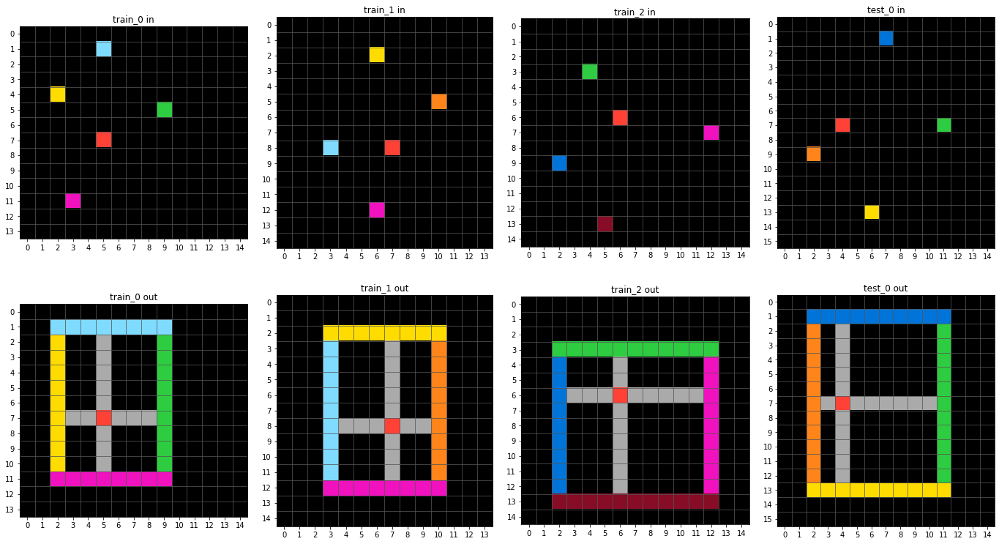

e5c44e8f
no


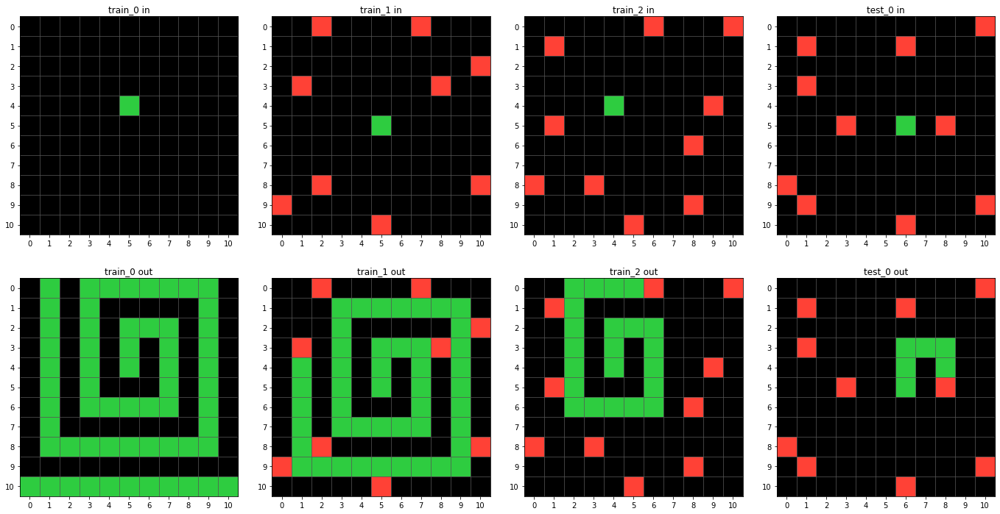

99306f82
no


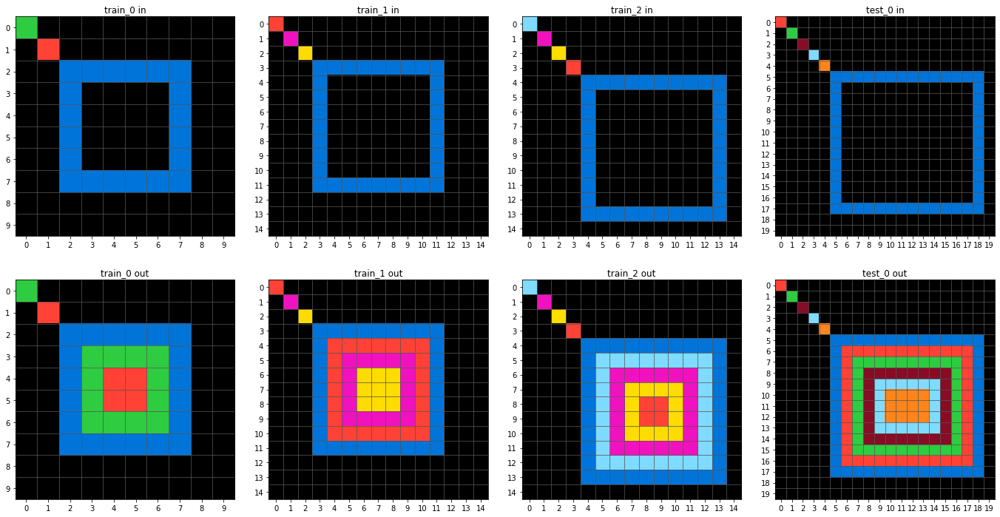

e872b94a
no


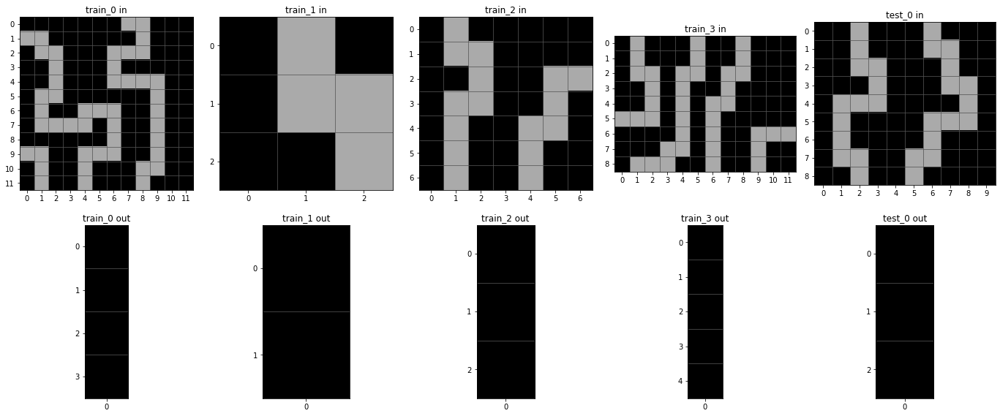

b942fd60
no


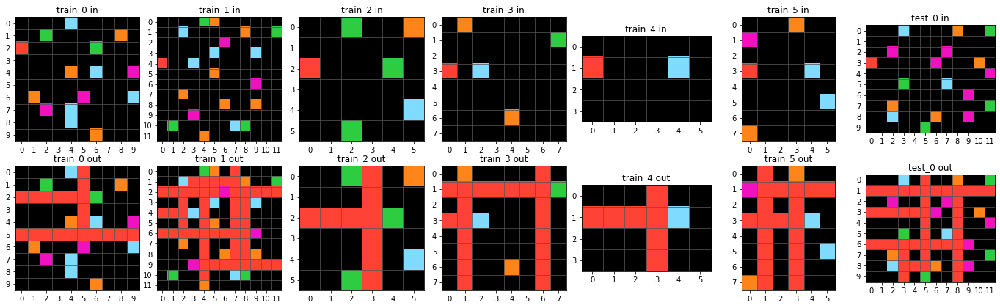

b7999b51
no


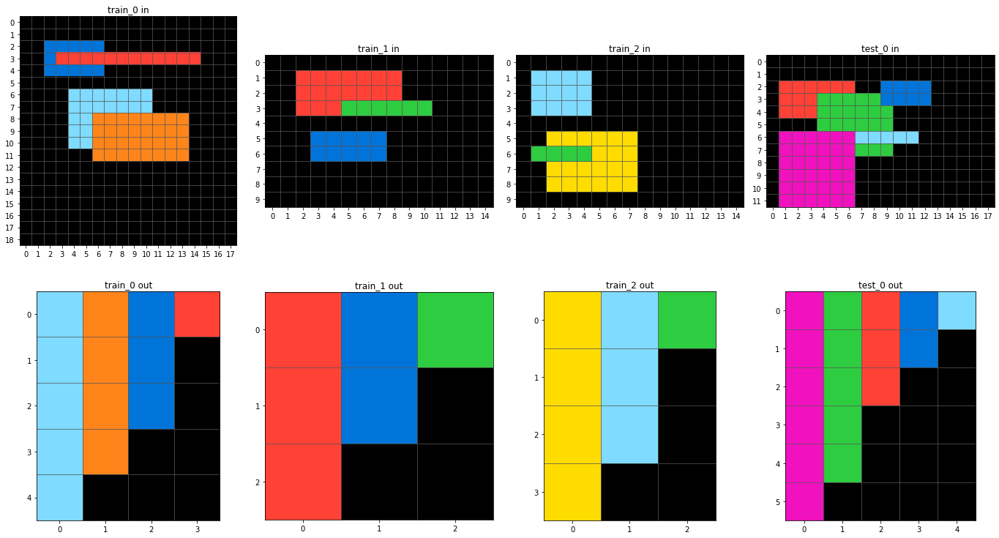

e619ca6e
[False, True, False, False]


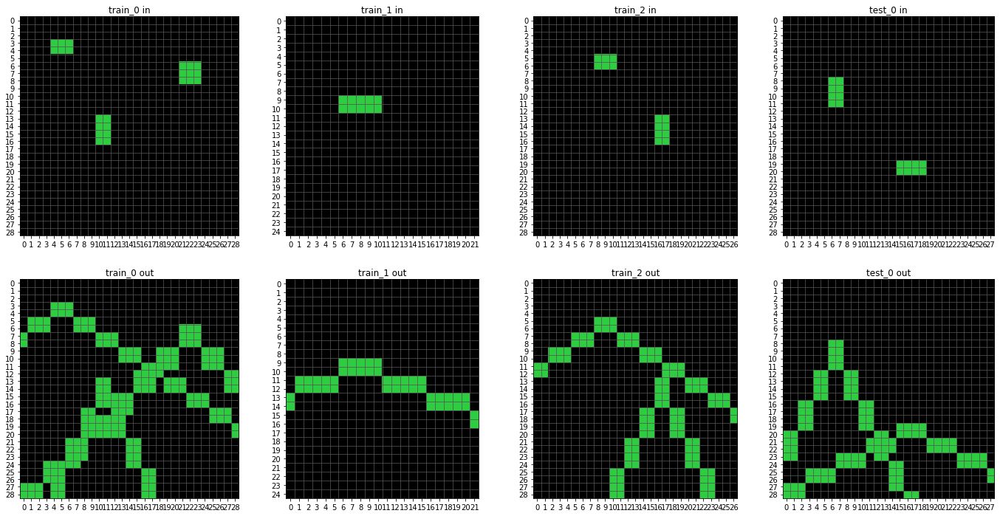

6ad5bdfd
no


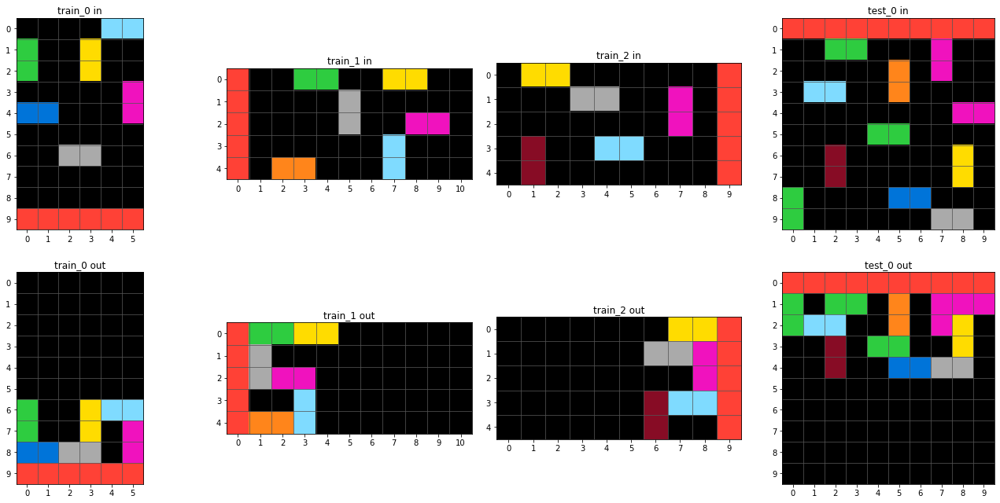

ecaa0ec1
no


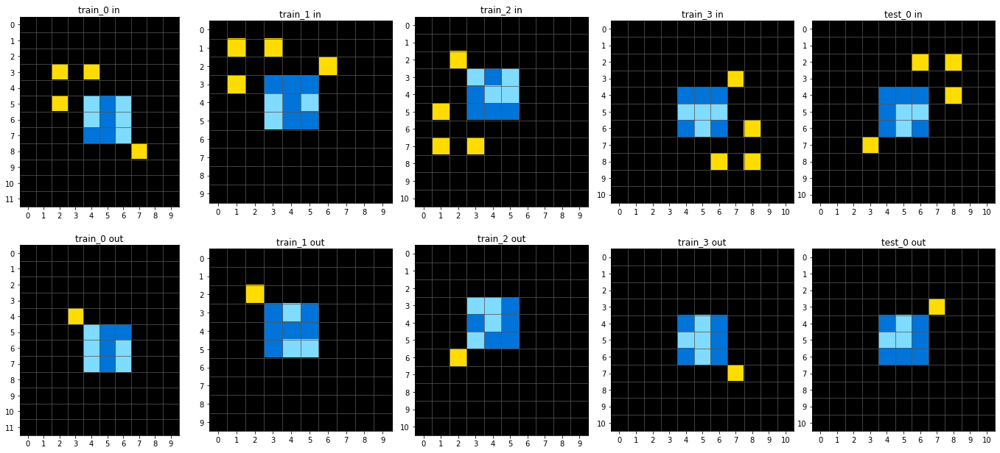

b7fb29bc
[False, False, False, False]


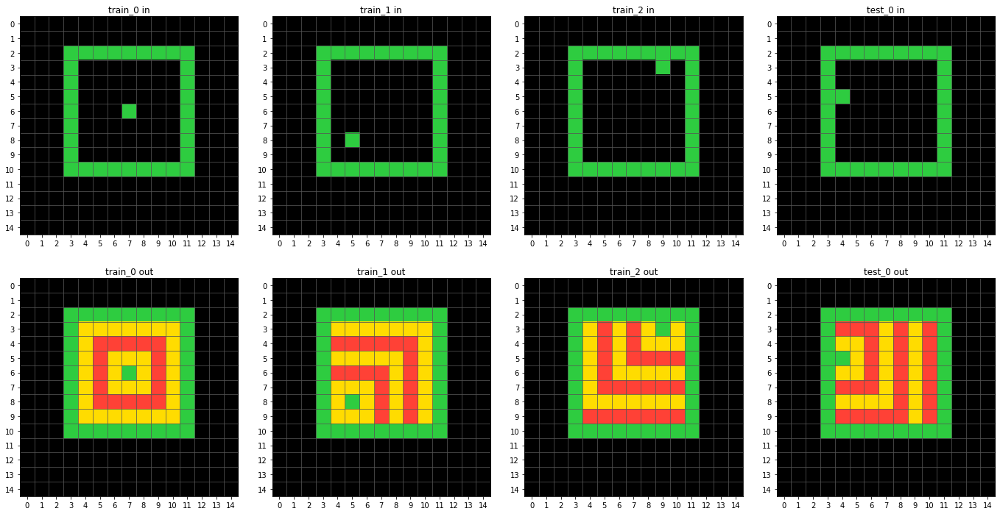

9356391f
[False, False, True]


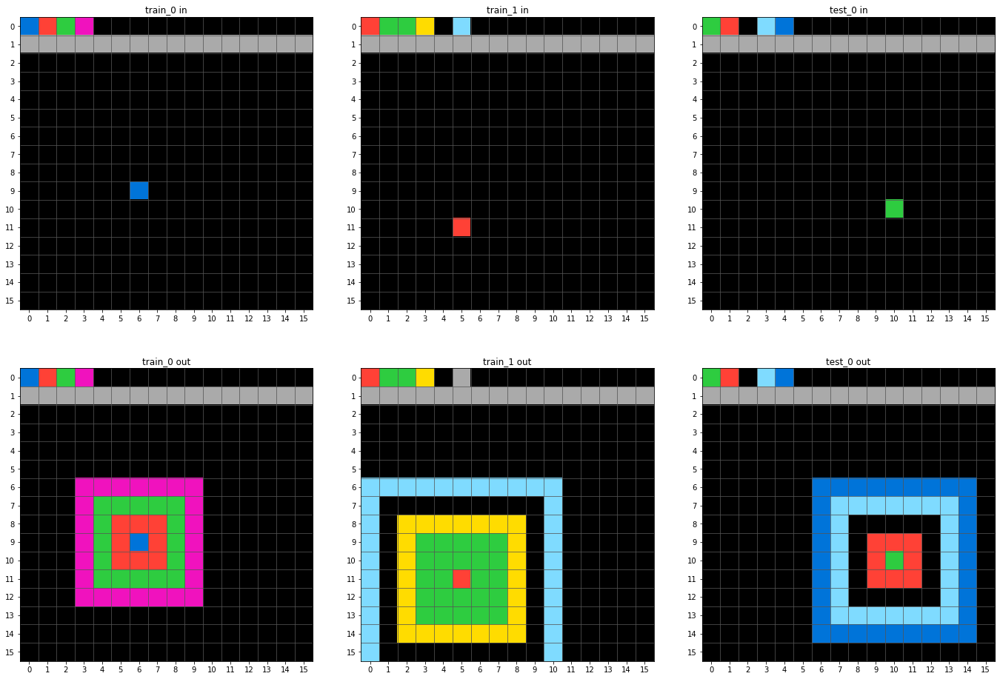

b7cb93ac
no


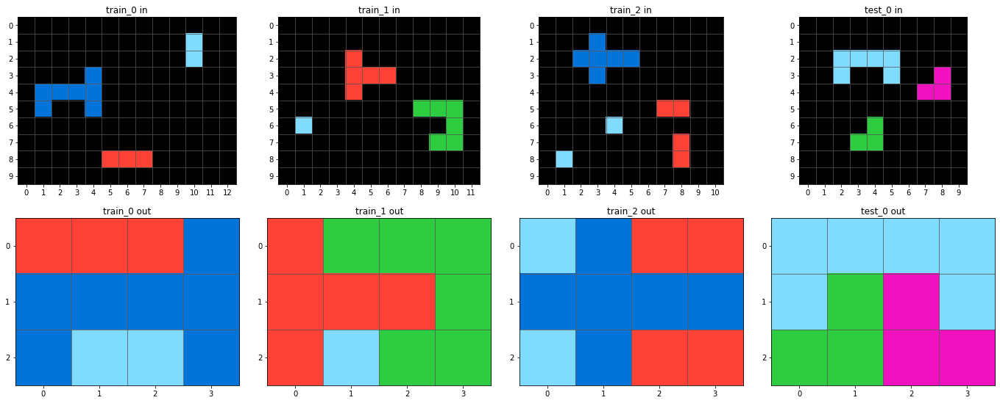

baf41dbf
no


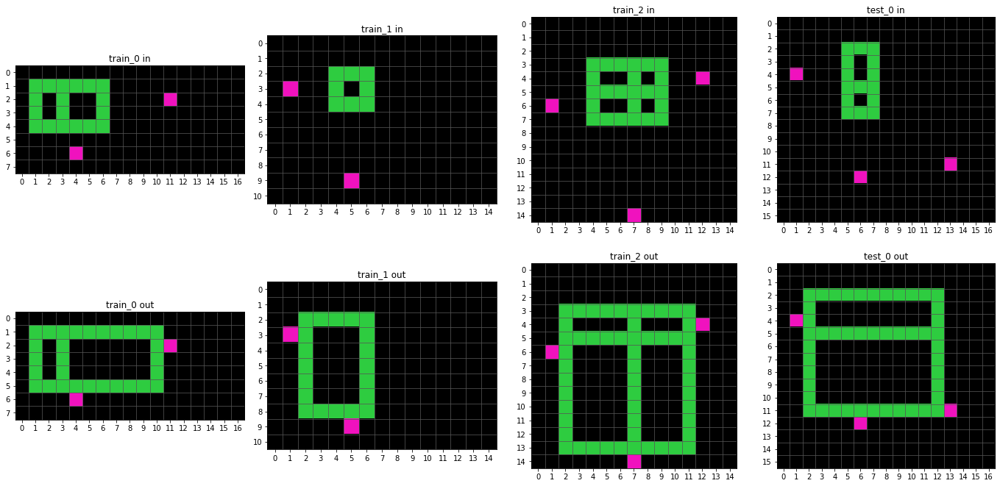

5ffb2104
no


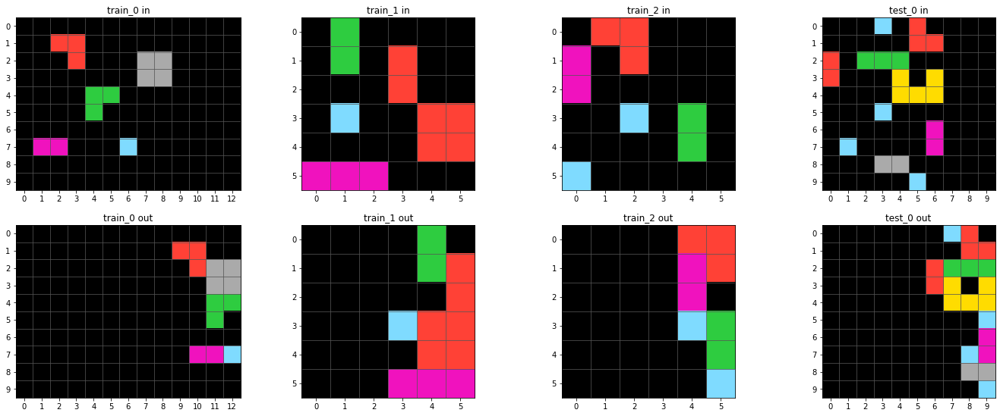

4f537728
[True, True, False]


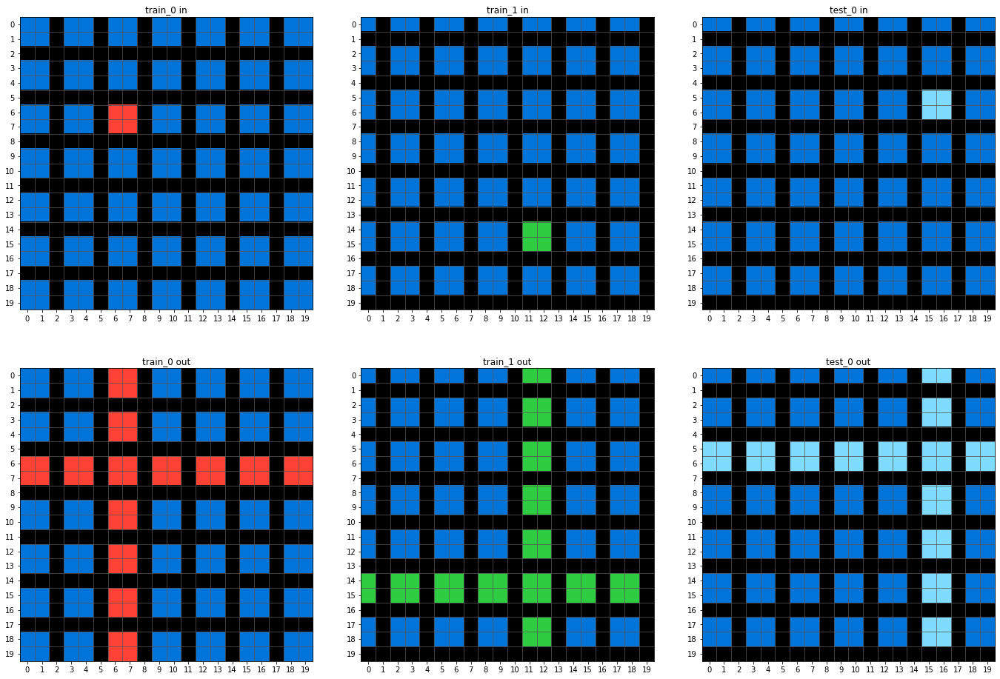

4364c1c4
[True, True, True, False]


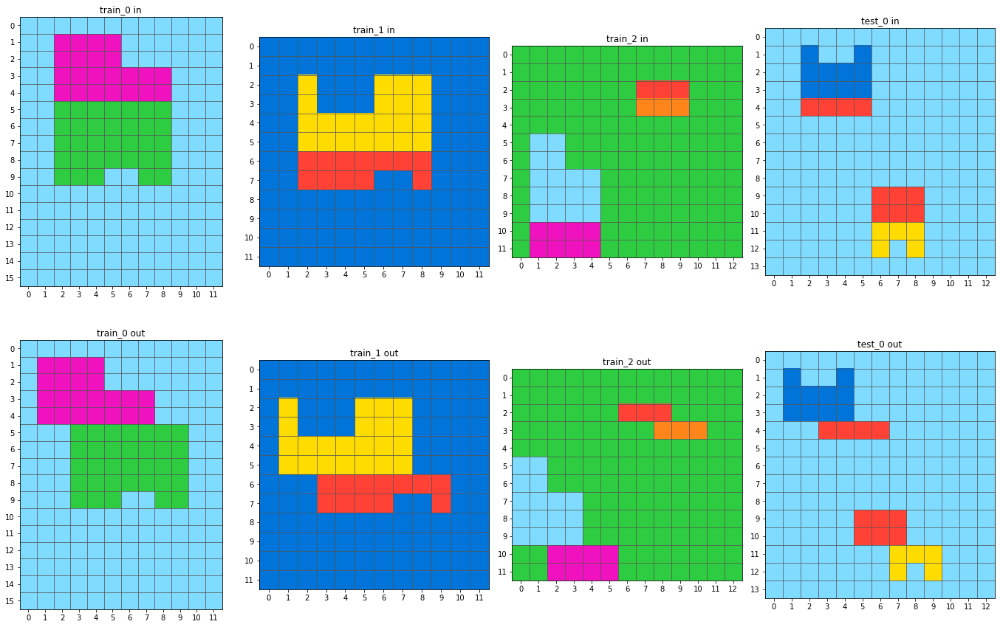

d37a1ef5
no


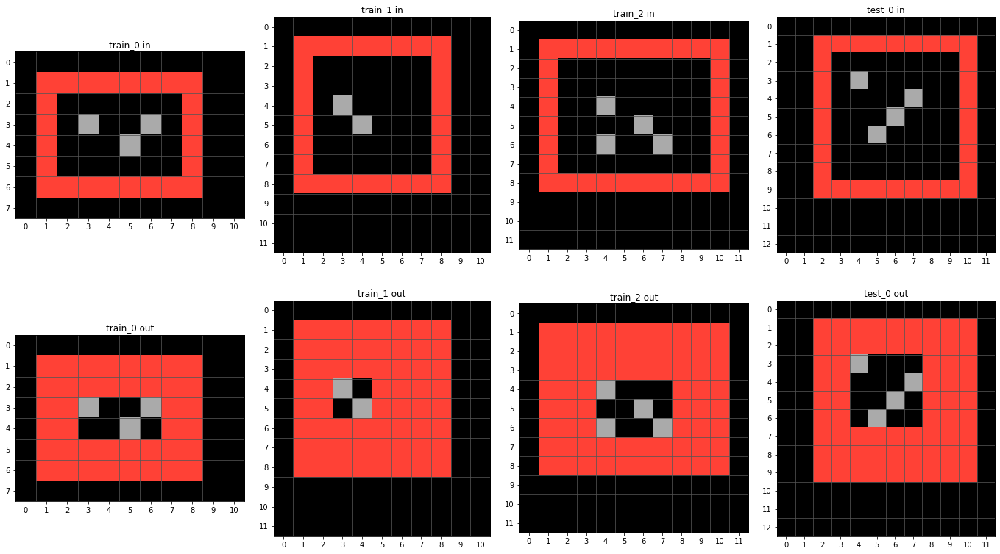

bf89d739
no


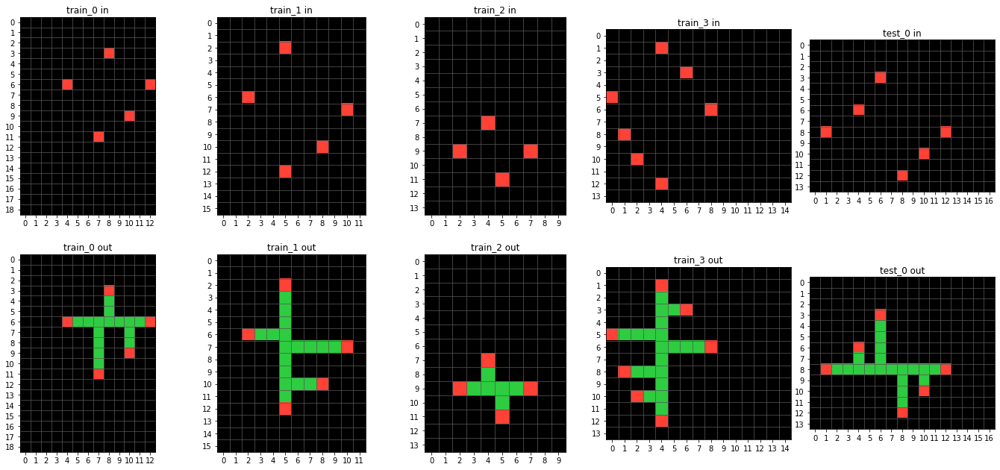

d5c634a2
no


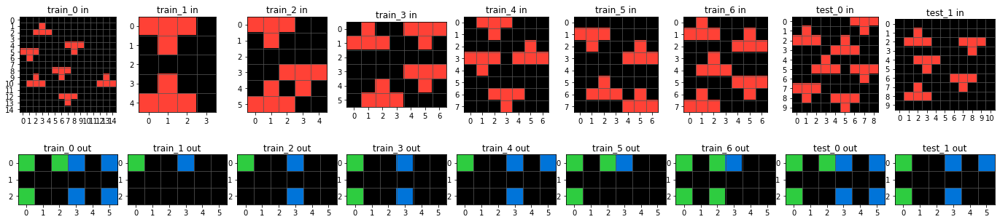

58e15b12
[True, True, True, True]


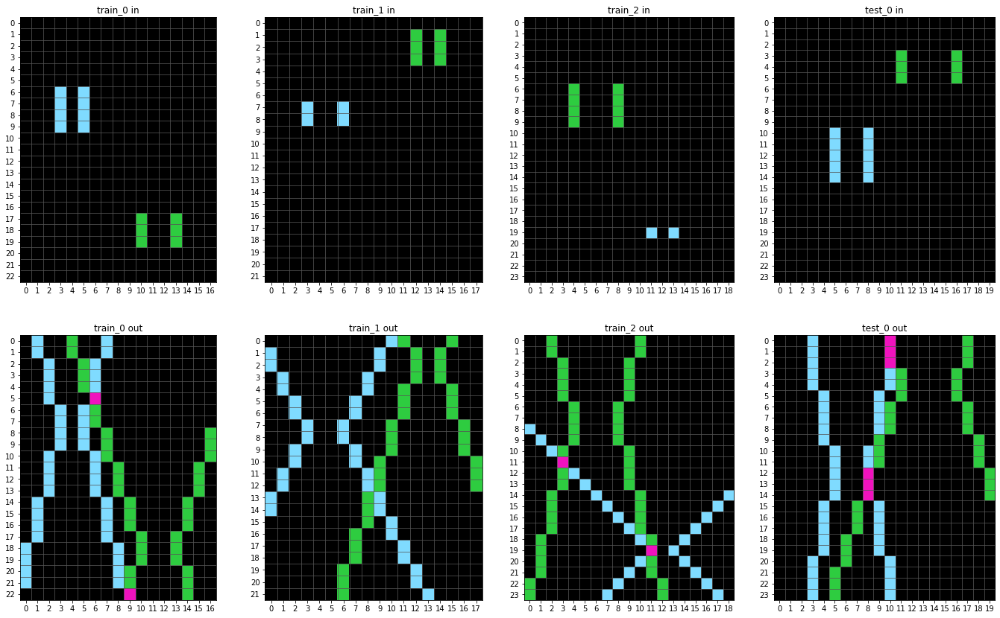

f5c89df1
[True, True, True, True]


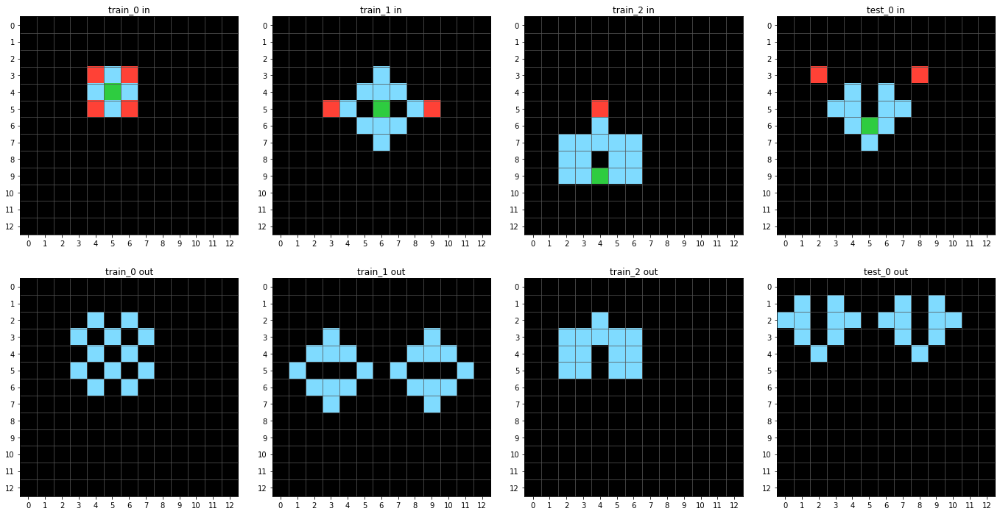

8cb8642d
[True, True, True, True]


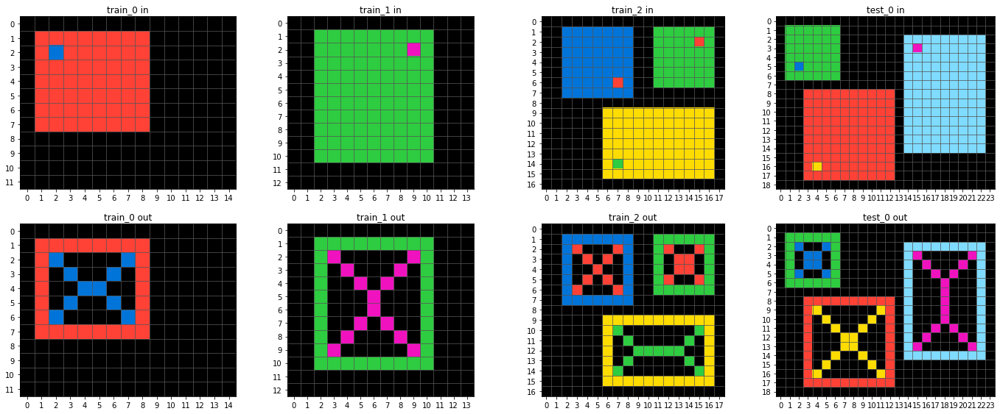

a406ac07
no


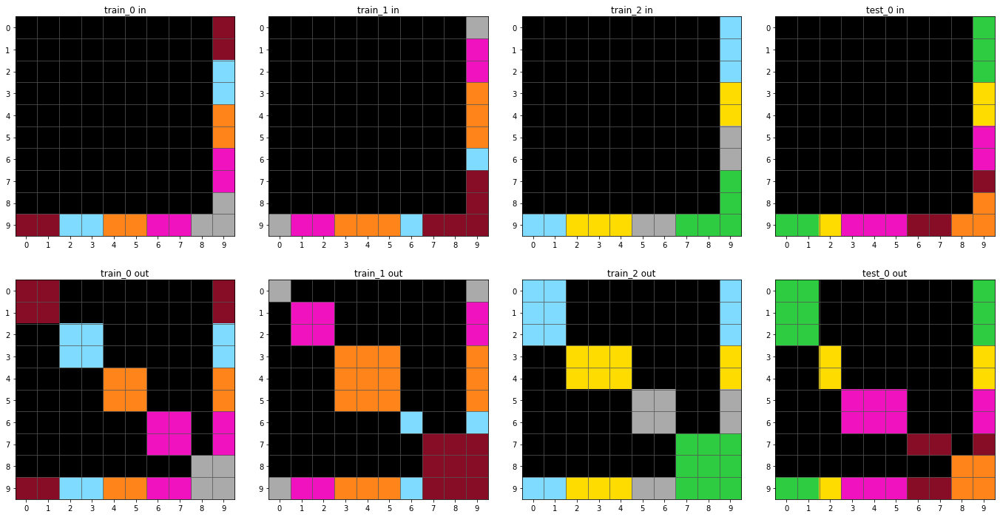

9bebae7a
no


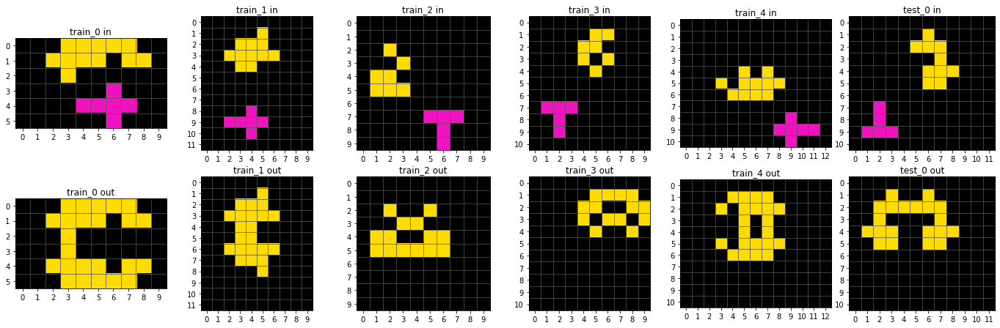

963f59bc
no


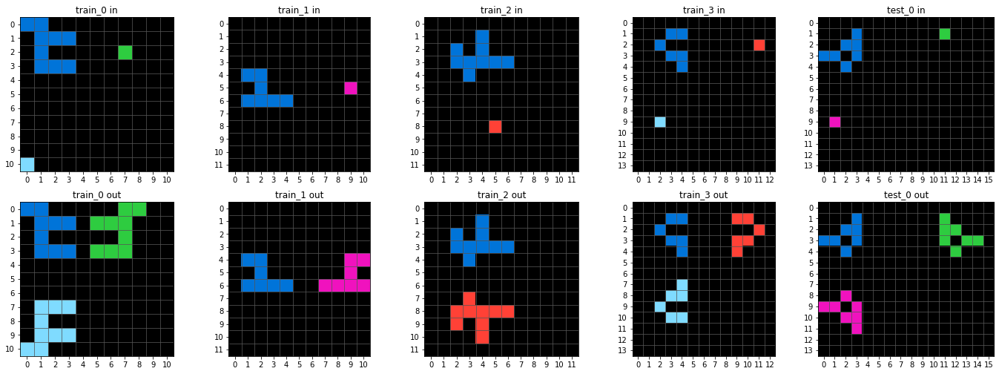

c7d4e6ad
no


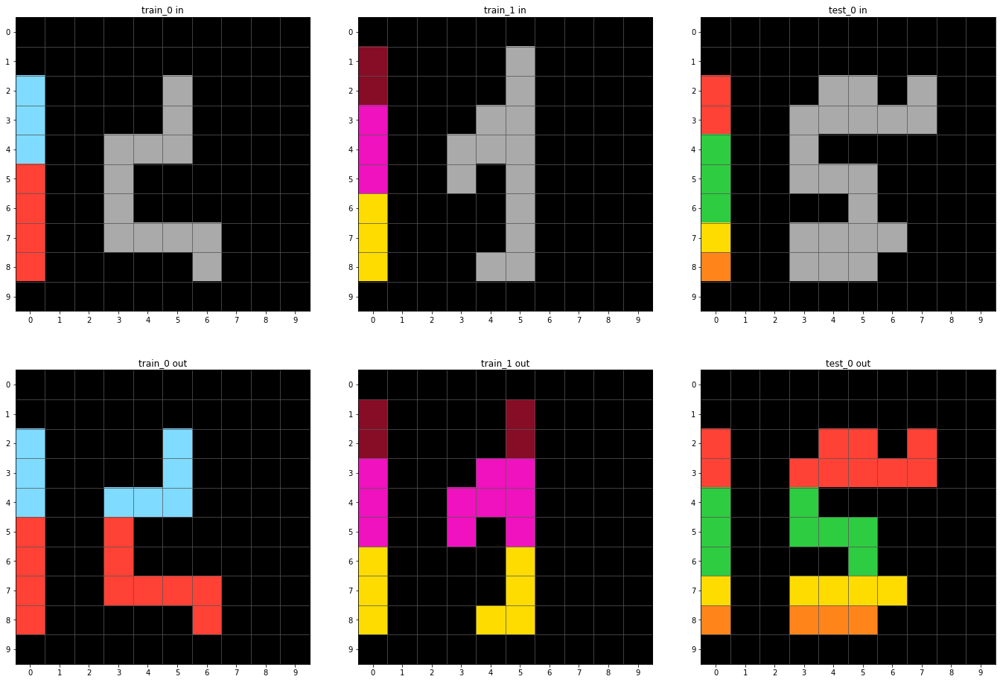

d304284e
[False, False, False]


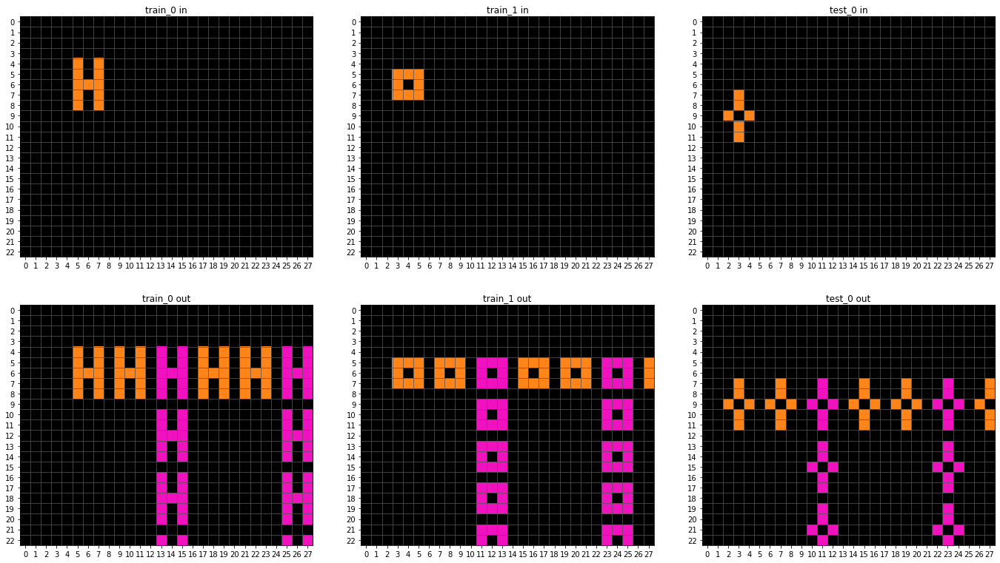

e9c9d9a1
[False, False, True, False]


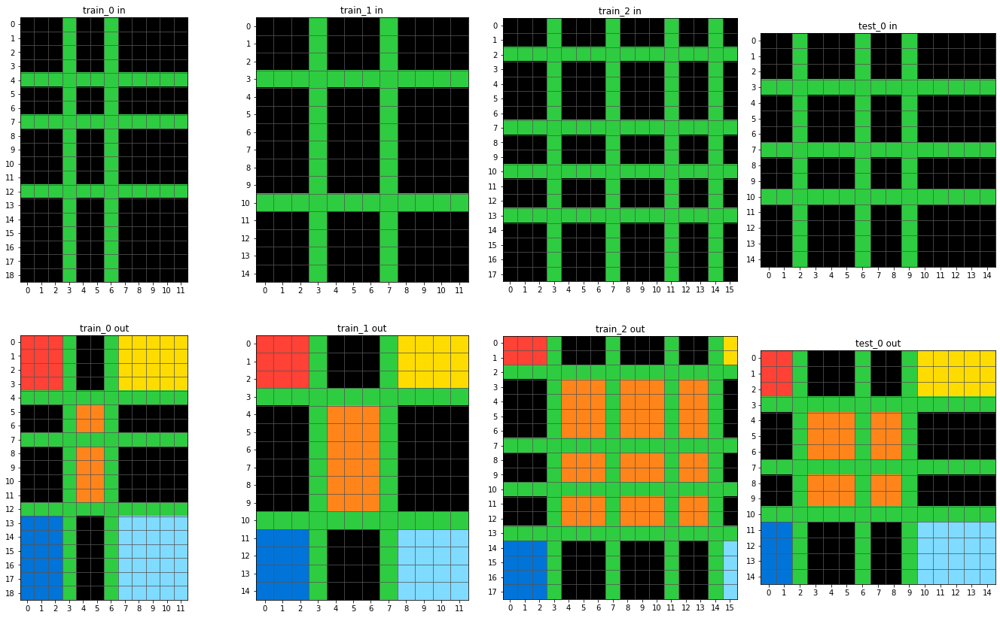

575b1a71
no


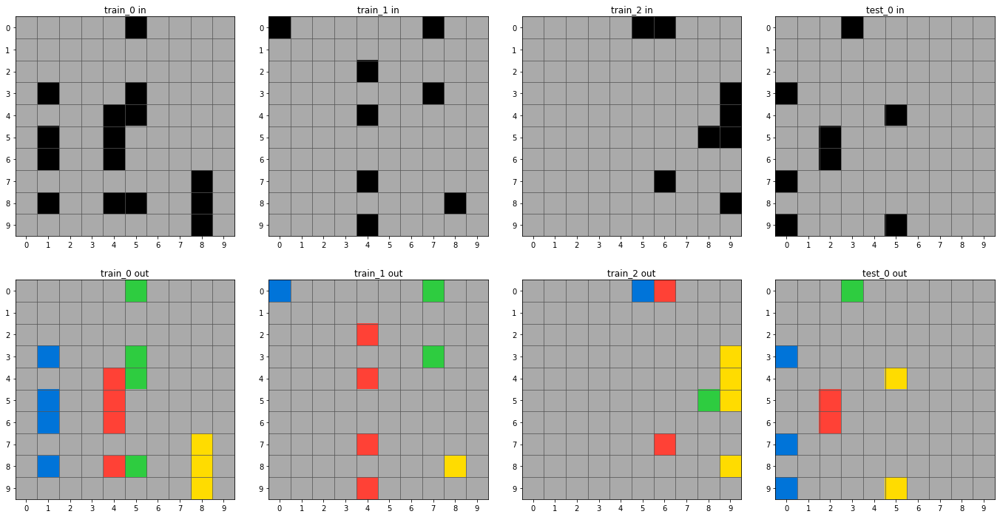

42a15761
no


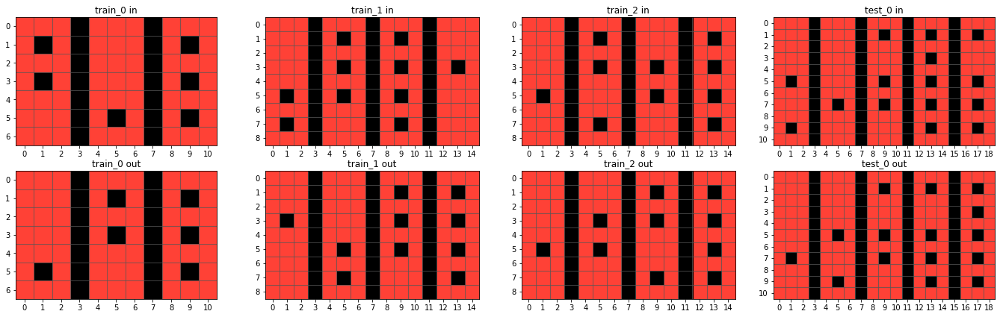

e345f17b
no


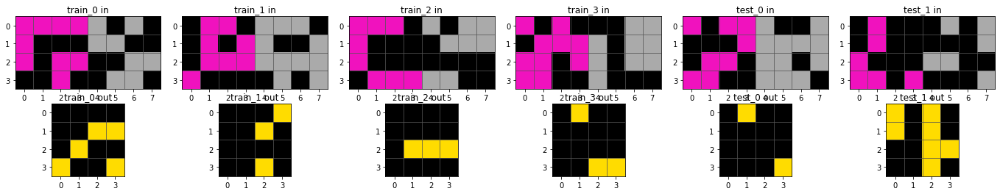

a8610ef7
no


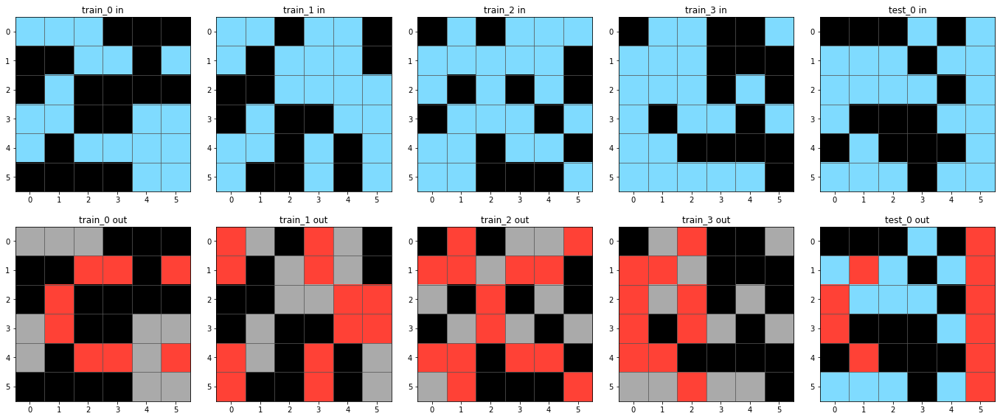

e1baa8a4
no


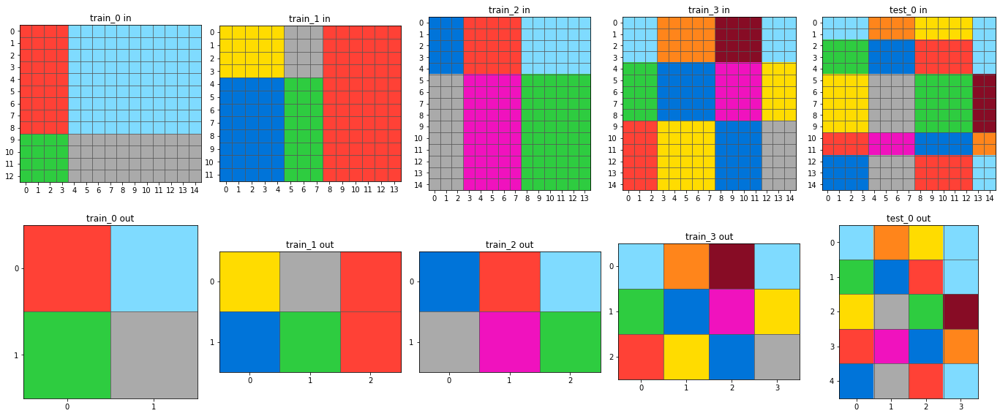

67c52801
no


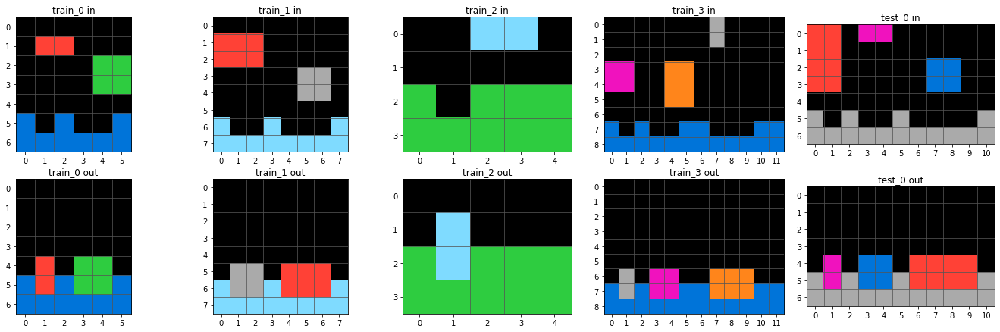

8fbca751
no


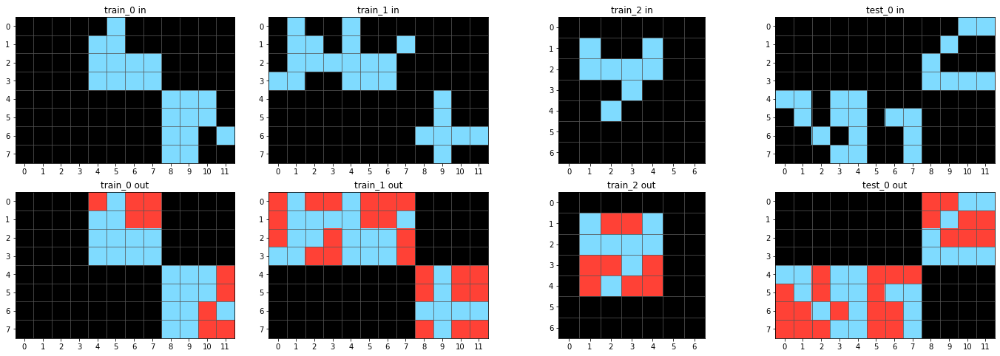

ca8de6ea
no


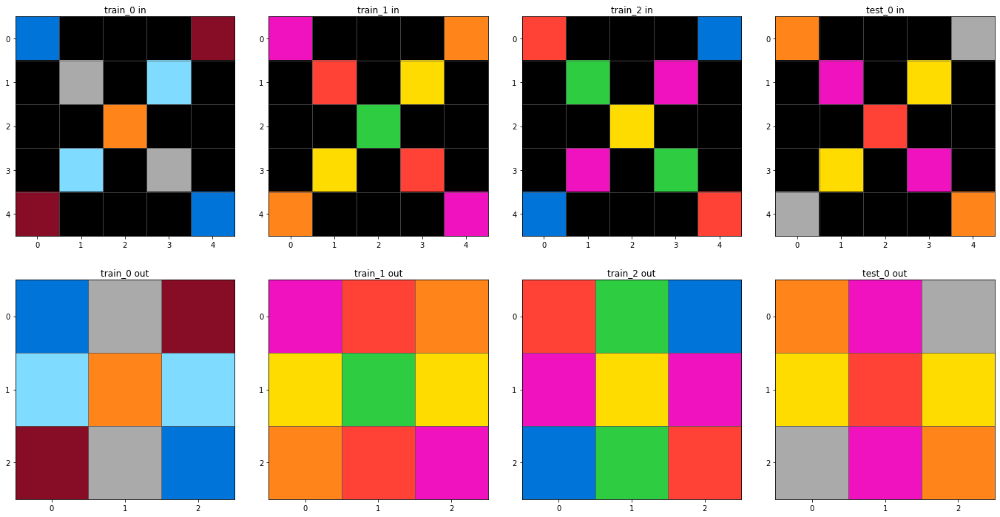

9c1e755f
no


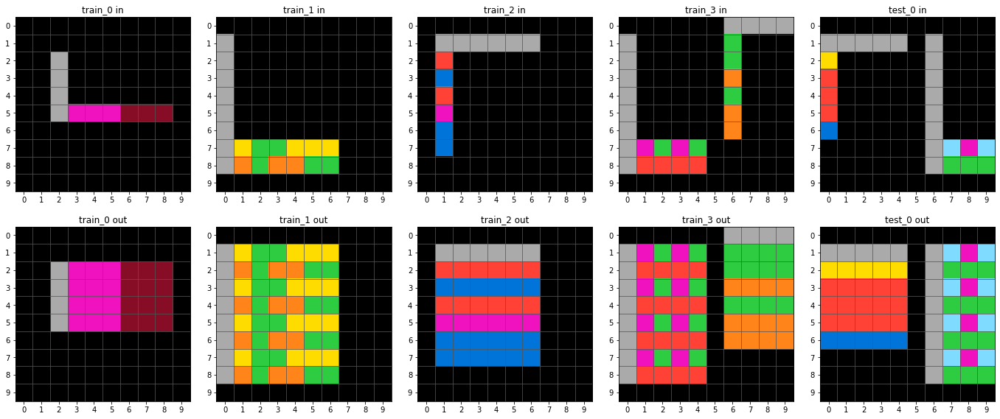

e9ac8c9e
no


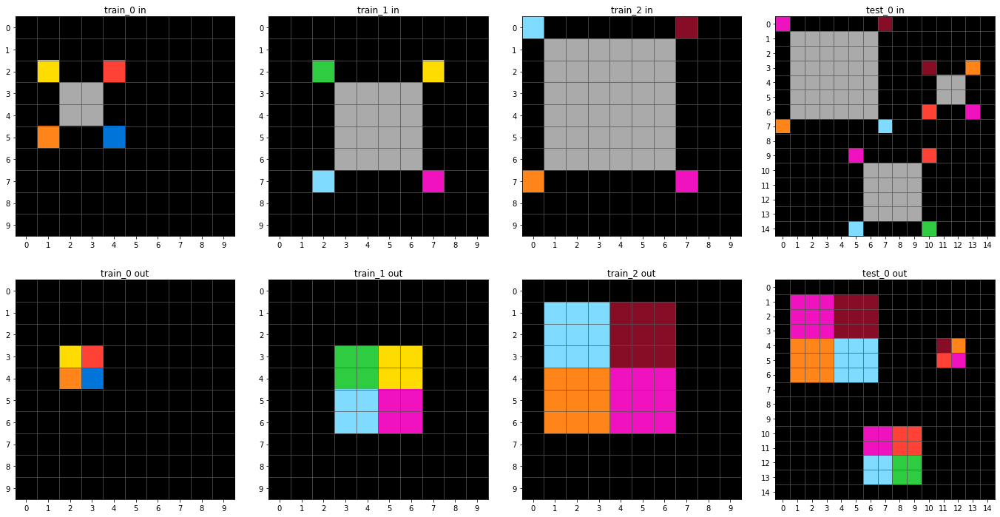

639f5a19
[False, False, True]


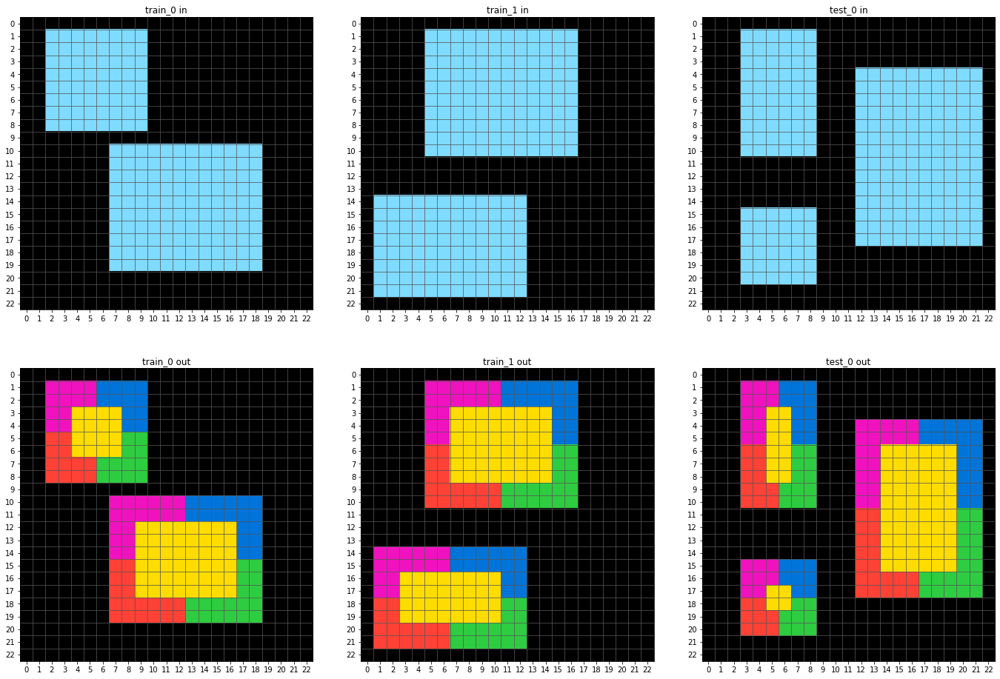

cad67732
no


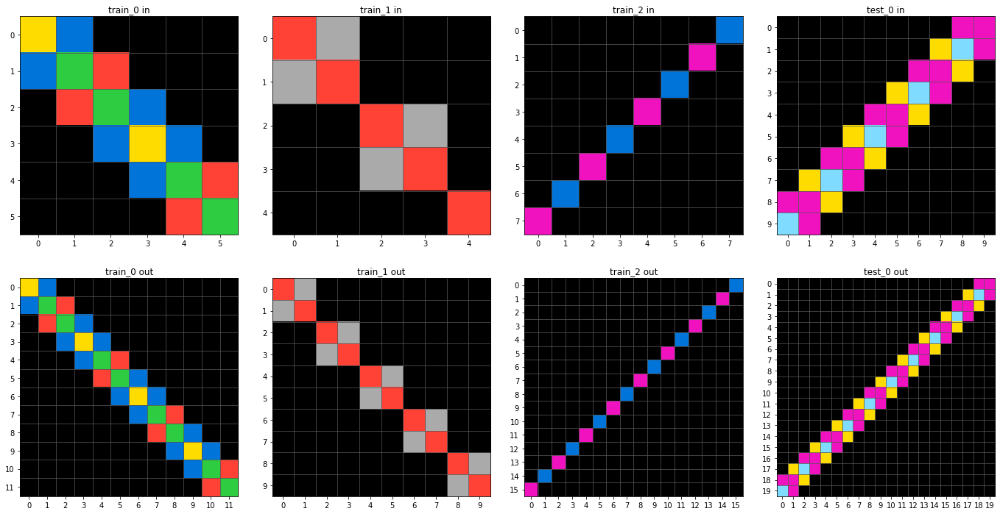

94414823
no


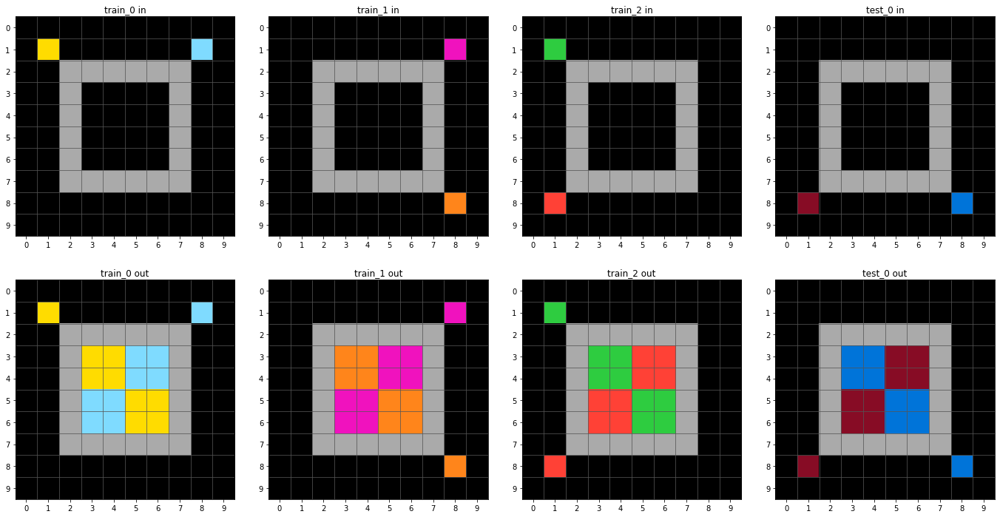

da515329
[True, False, False, True]


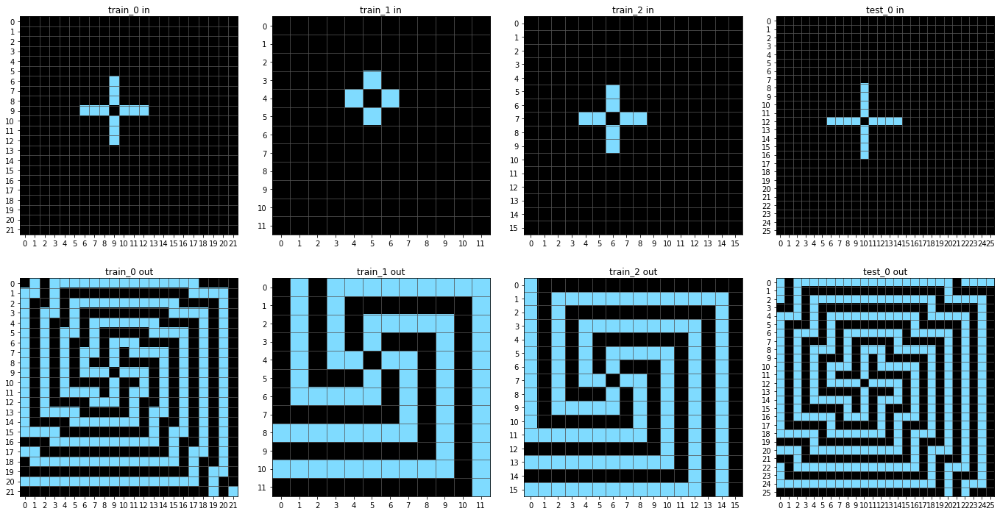

9ddd00f0
no


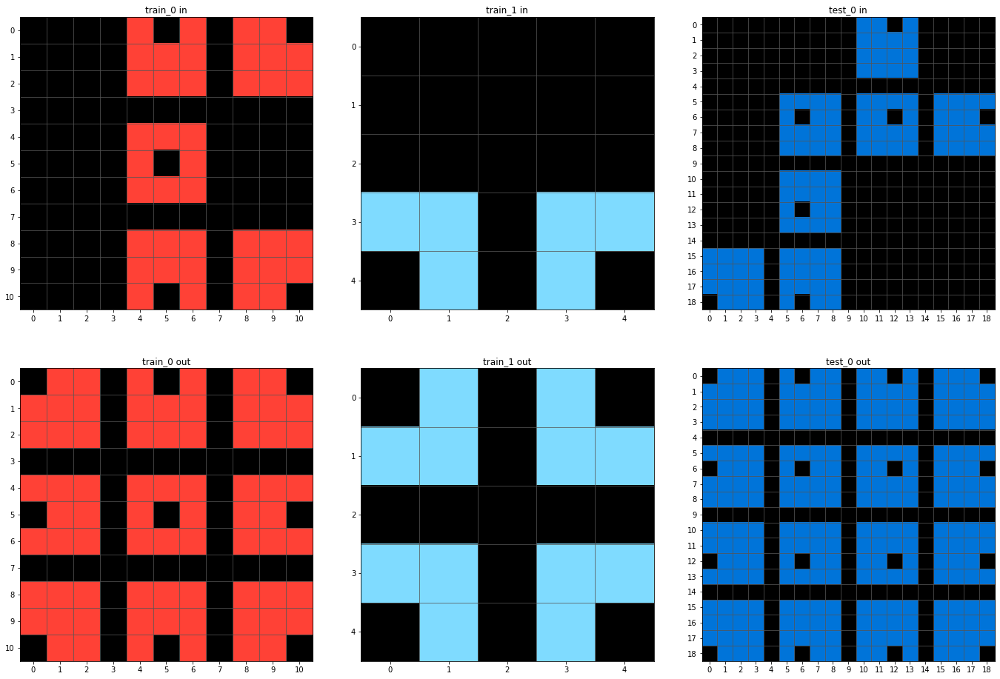

4852f2fa
no


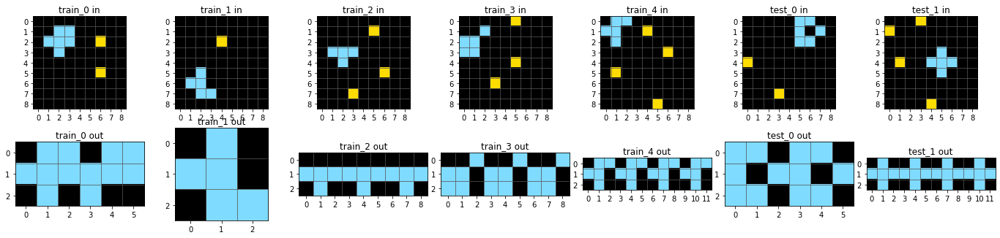

c87289bb
no


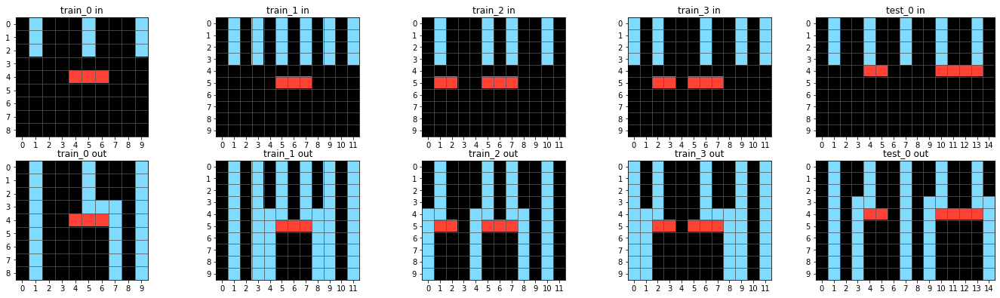

7039b2d7
no


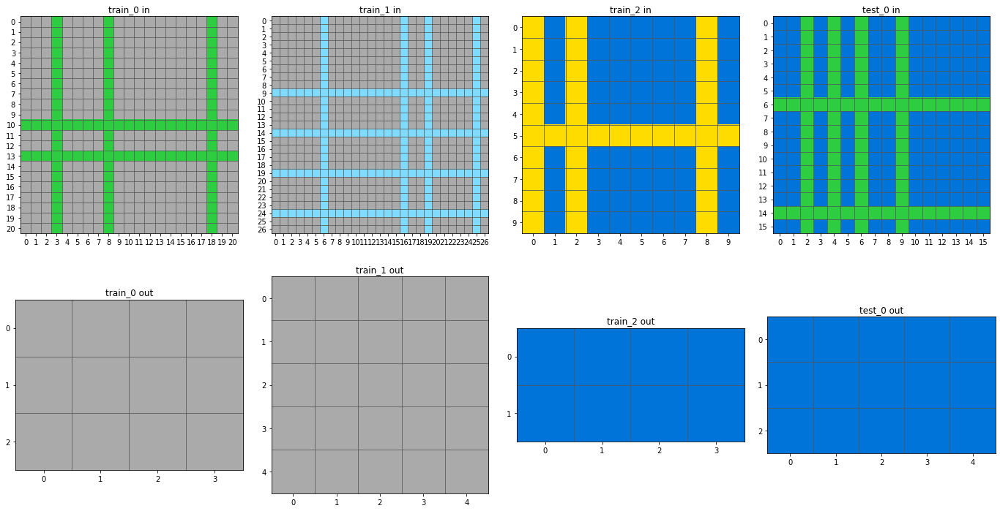

8a371977
[True, True, True, True]


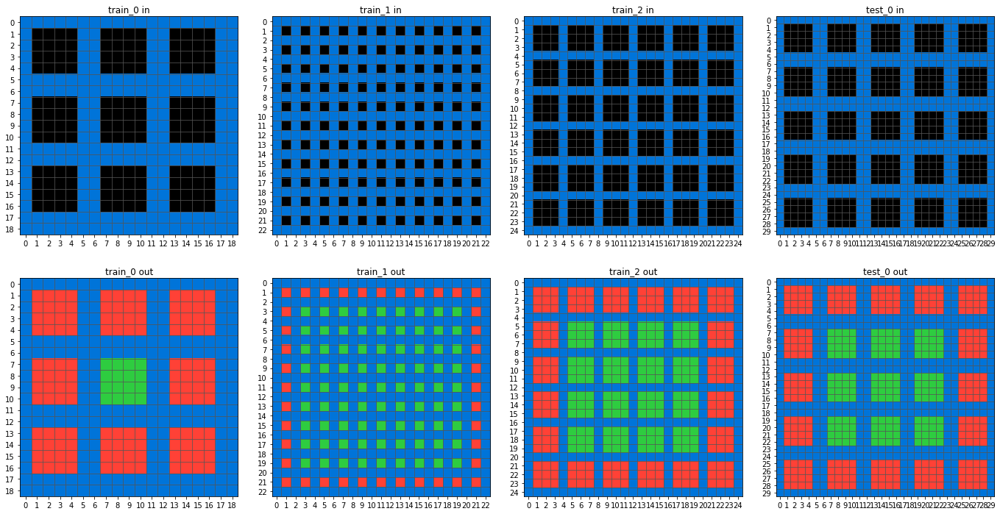

817e6c09
no


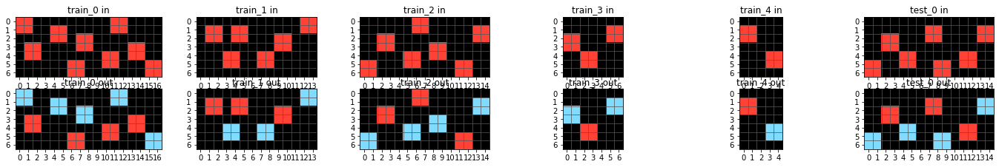

c97c0139
[False, True, True]


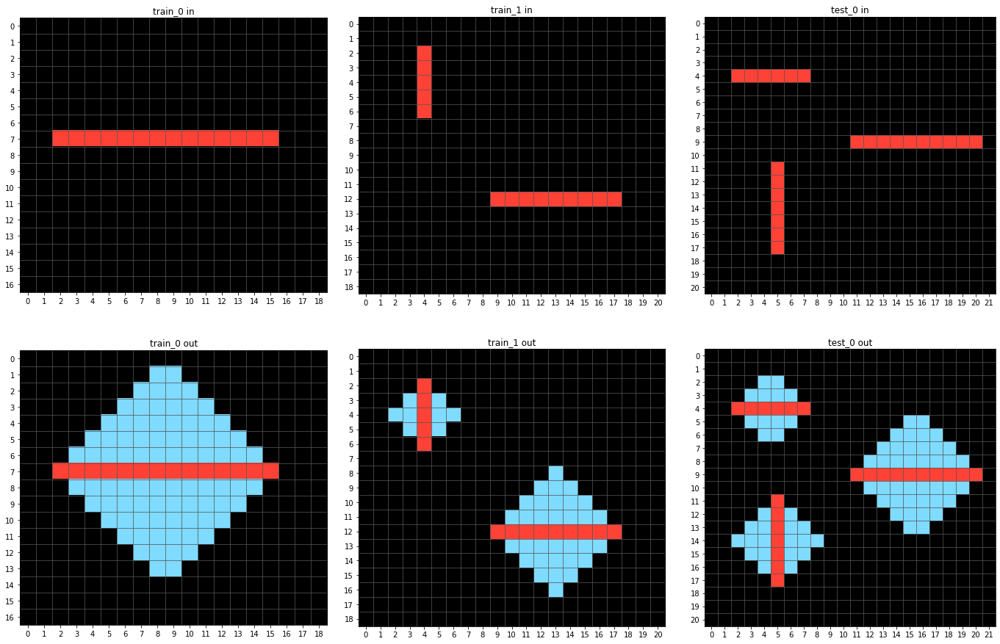

8597cfd7
no


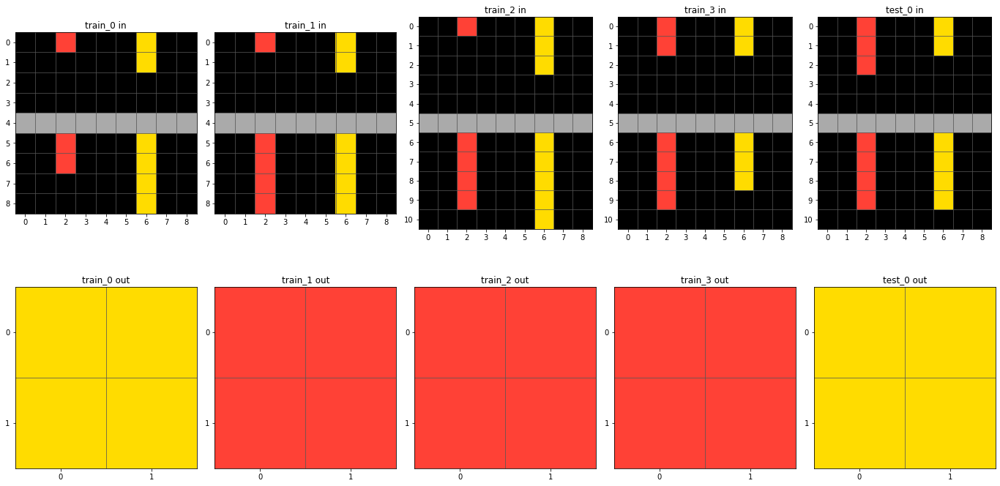

55783887
no


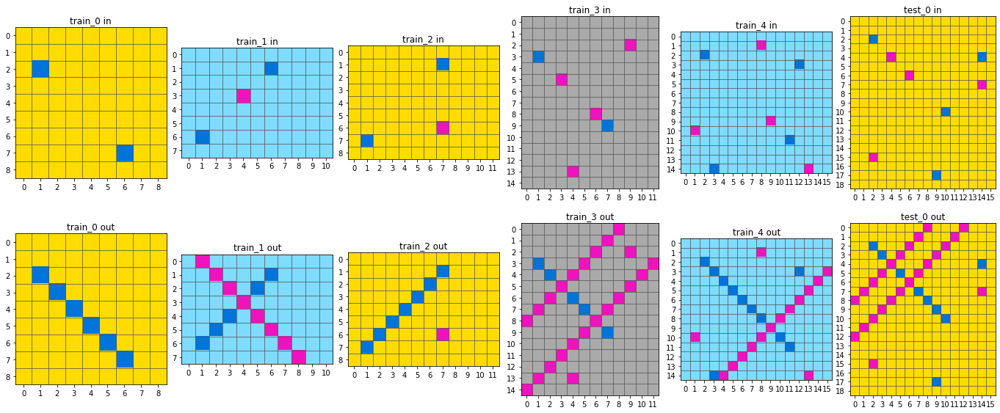

f45f5ca7
no


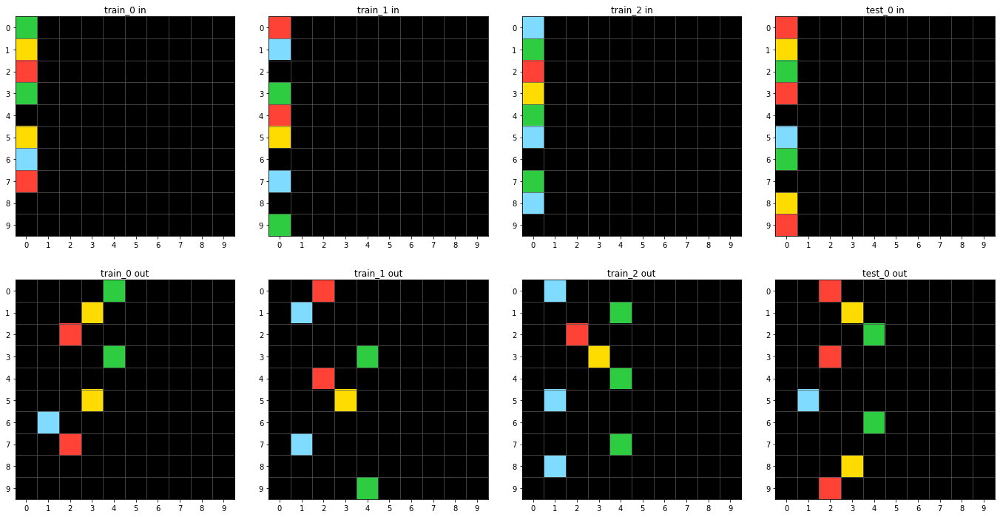

50a16a69
no


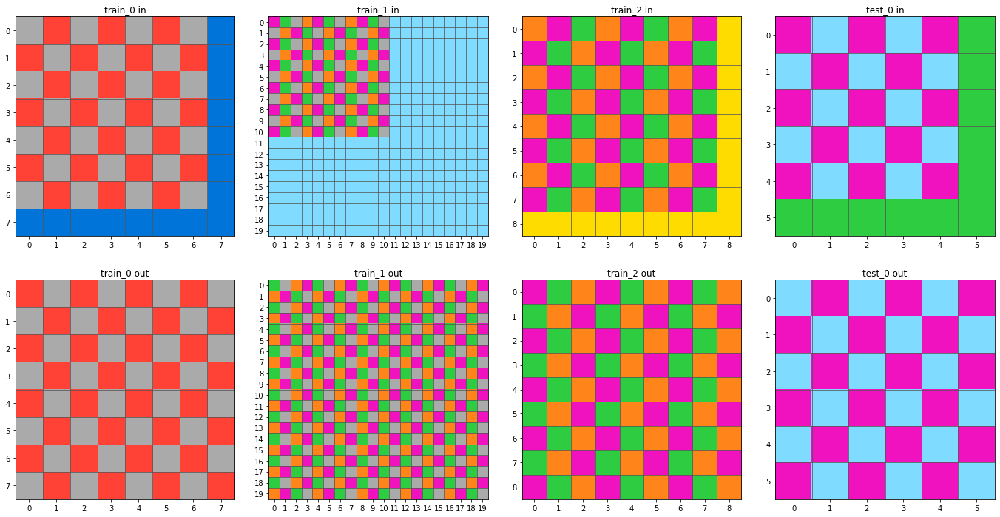

45bbe264
[True, True, False, True]


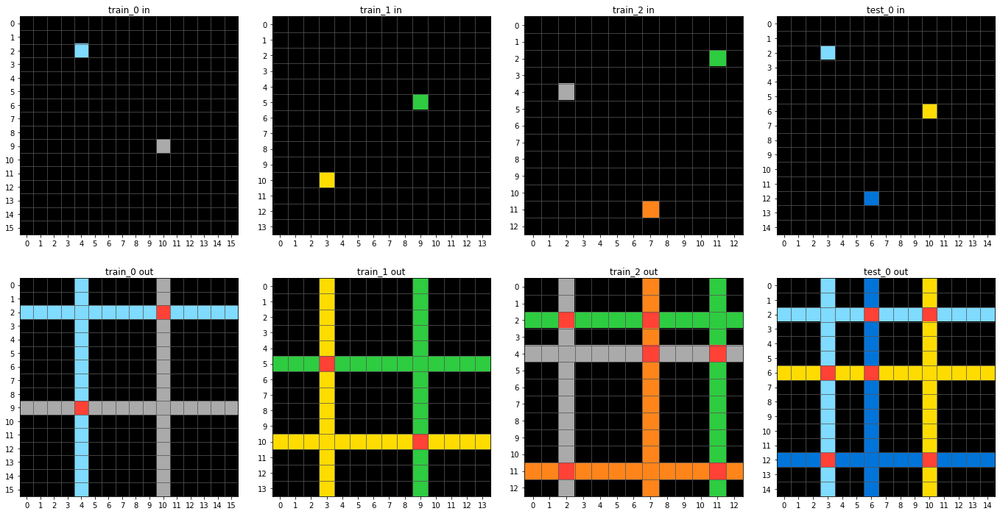

516b51b7
no


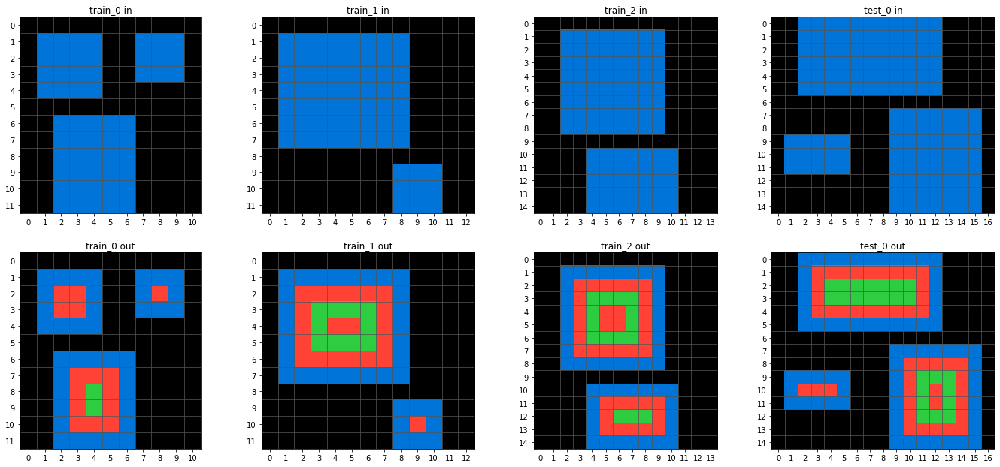

ba9d41b8
[False, False, False, False]


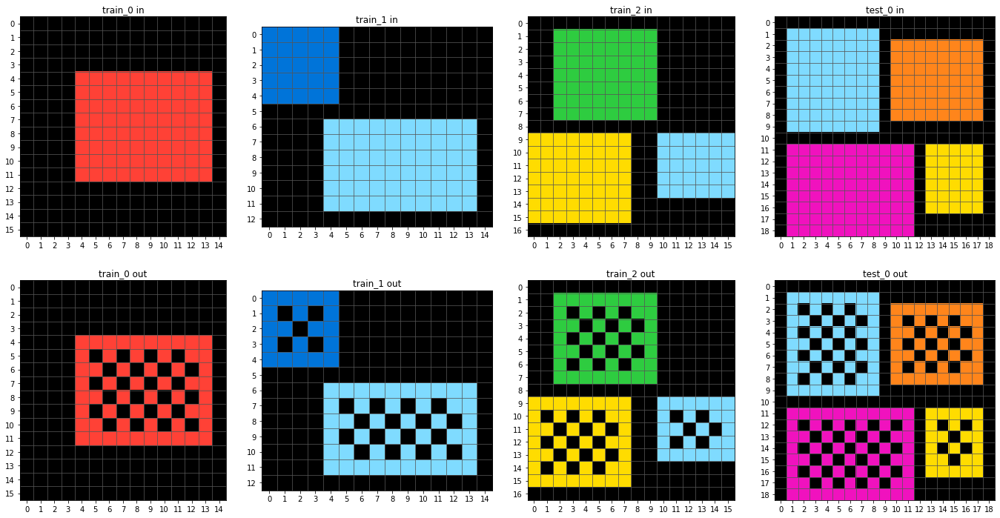

da2b0fe3
no


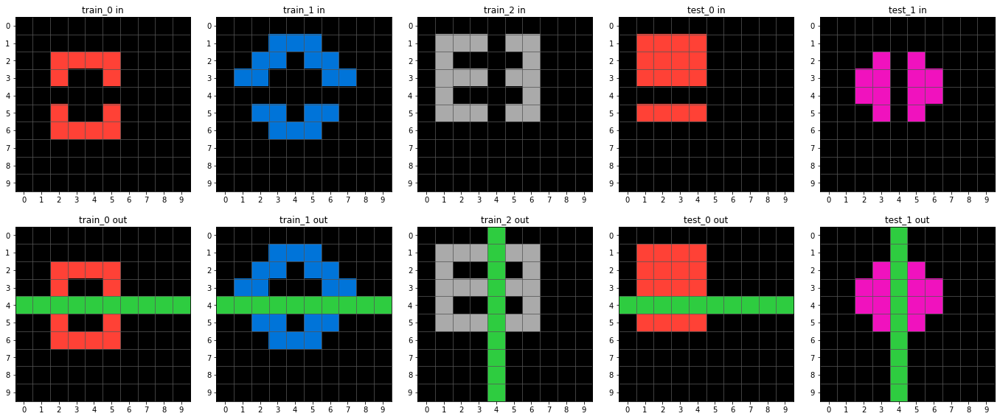

762cd429
no


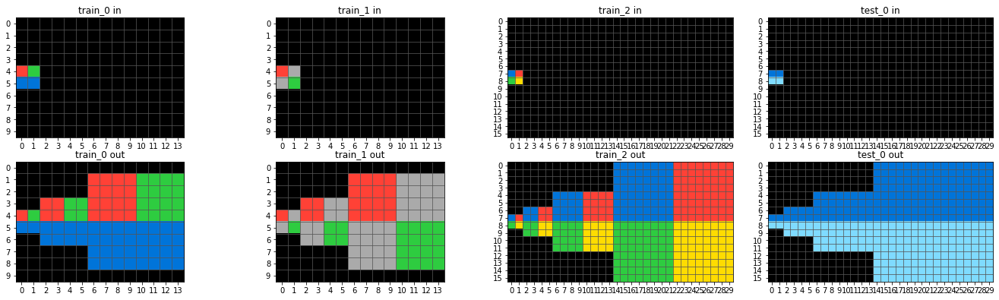

626c0bcc
no


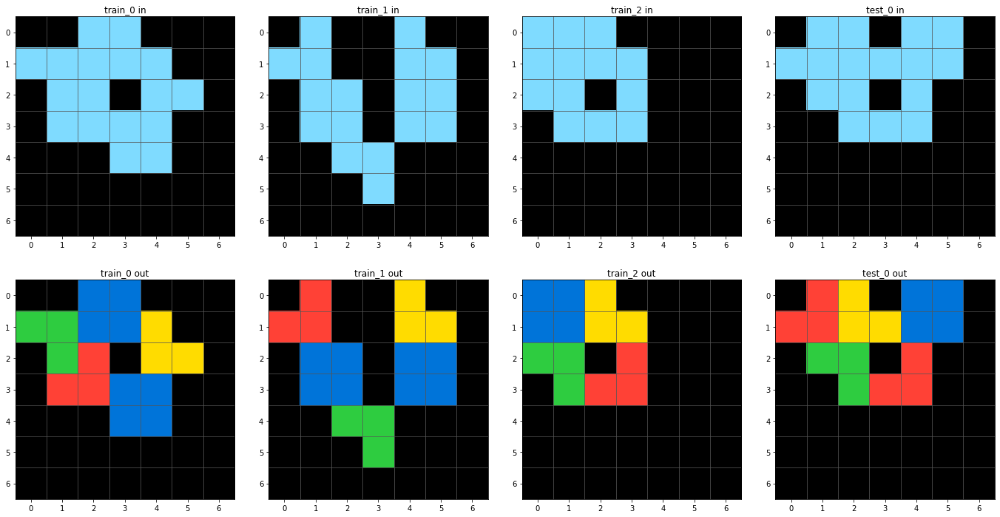

8ba14f53
no


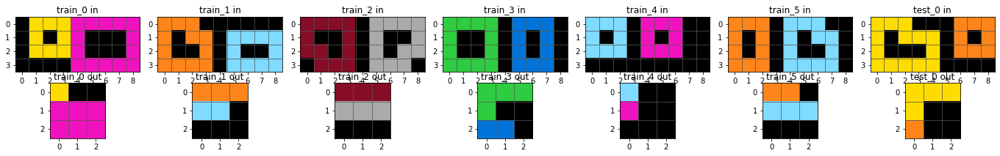

4e469f39
no


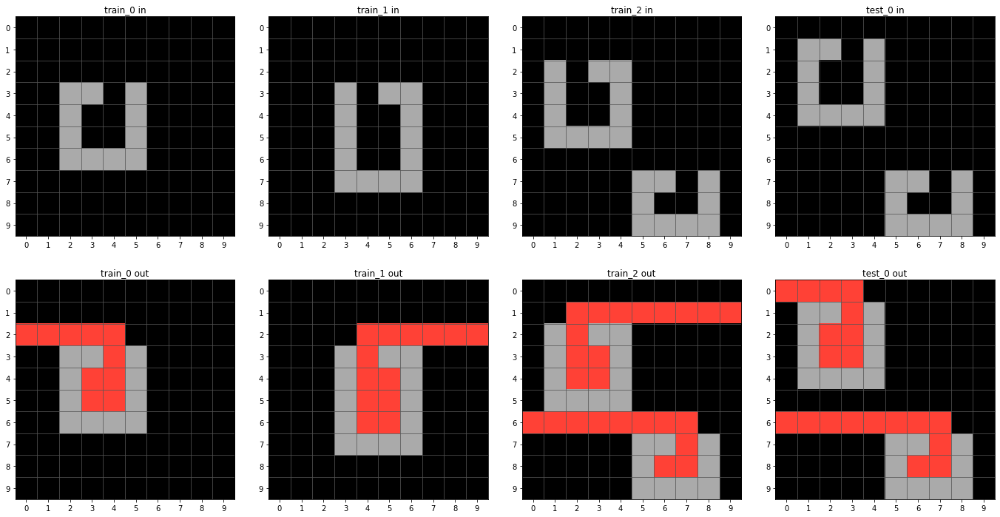

d017b73f
no


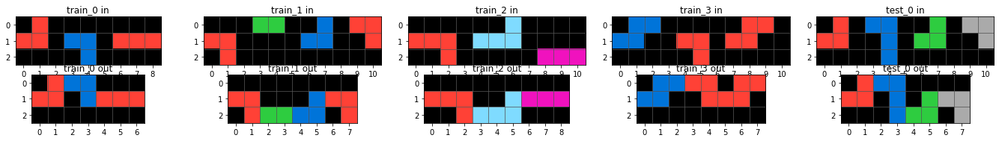

bbb1b8b6
no


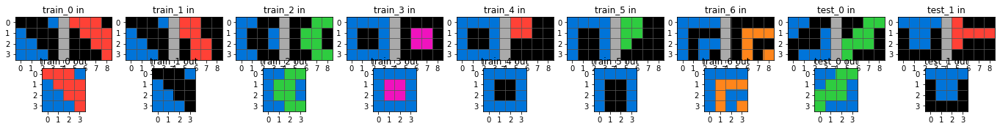

ff72ca3e
no


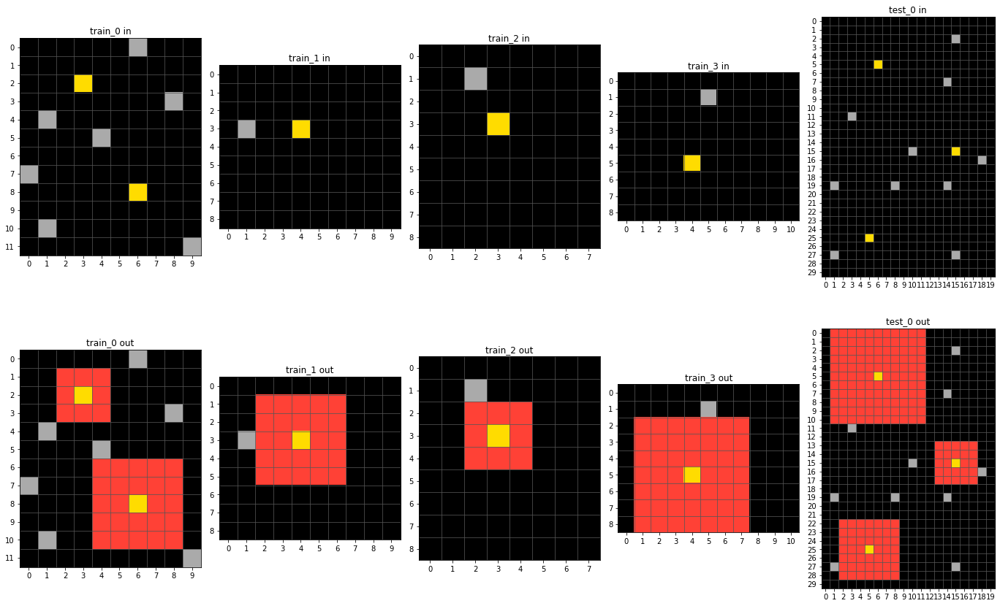

aa18de87
no


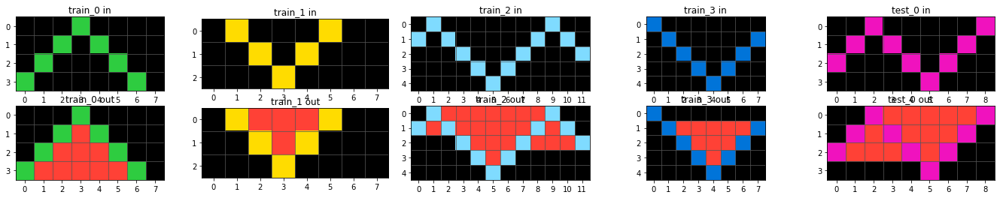

ed74f2f2
no


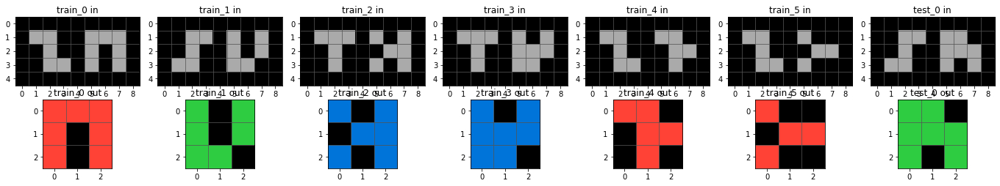

992798f6
[True, True, True, True, True]


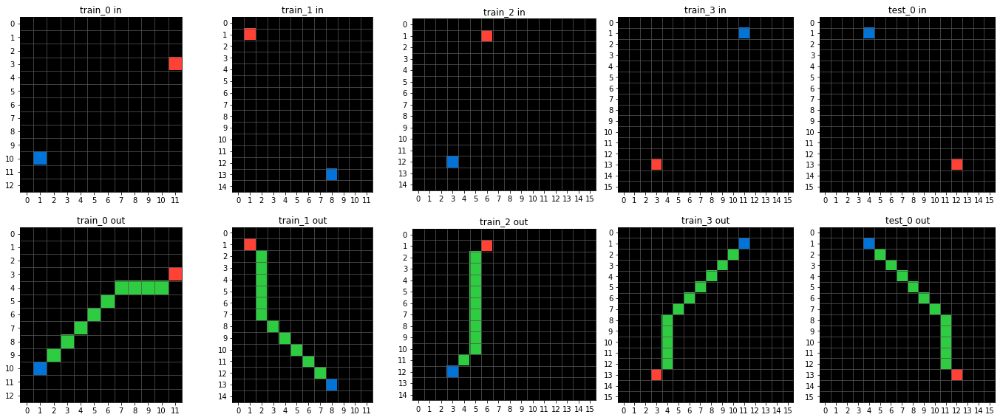

e57337a4
no


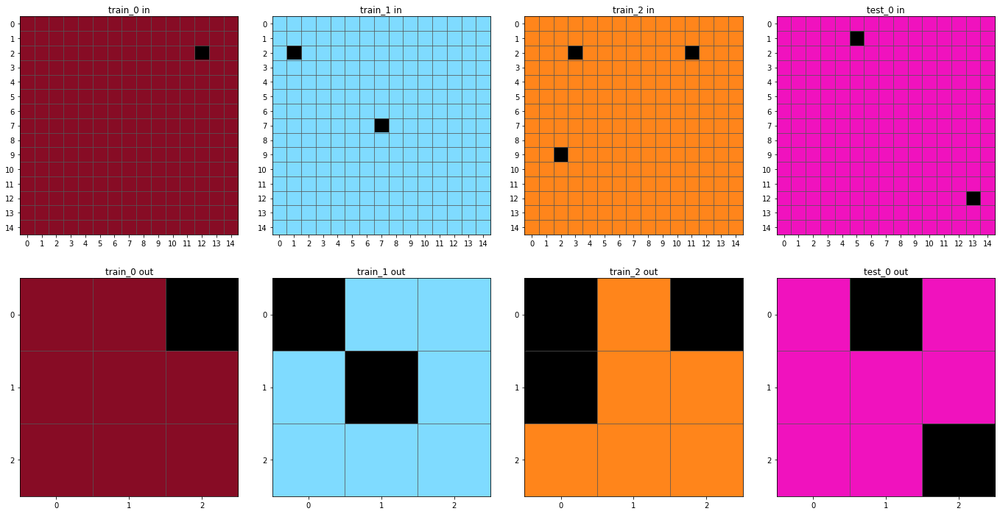

fd4b2b02
[True, True, False, True]


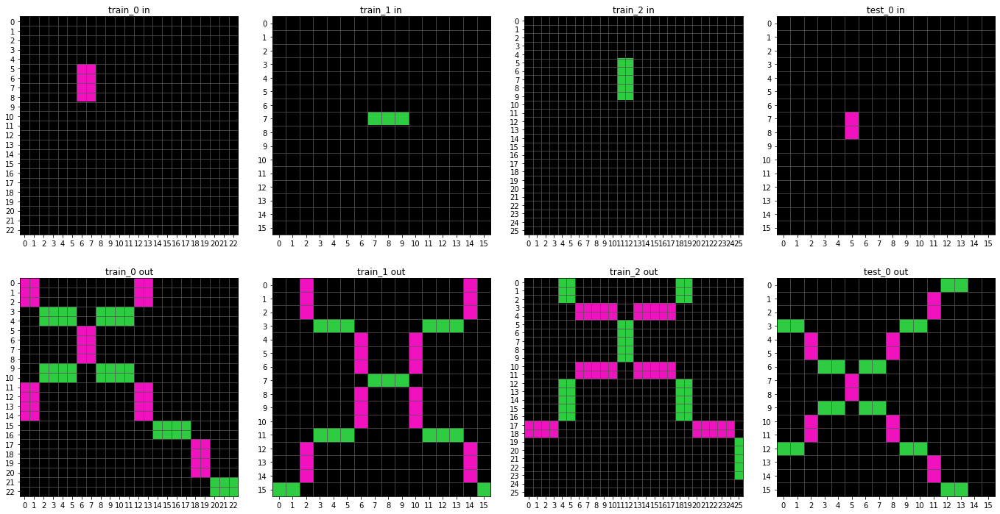

a3f84088
no


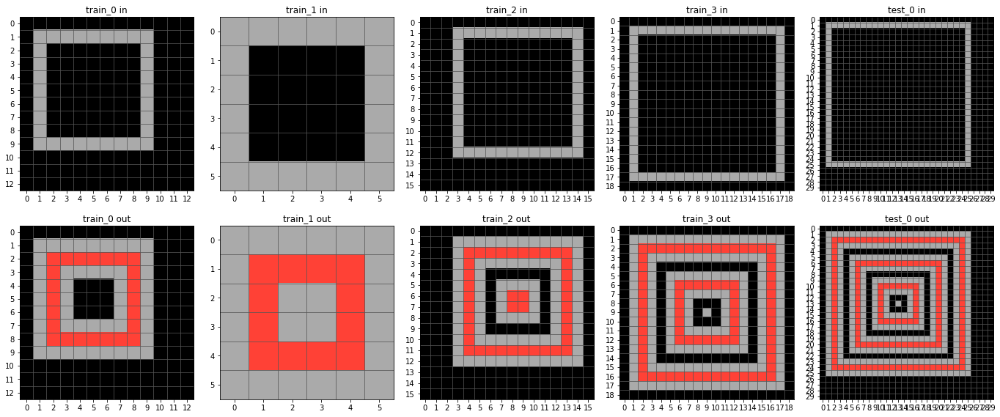

64a7c07e
no


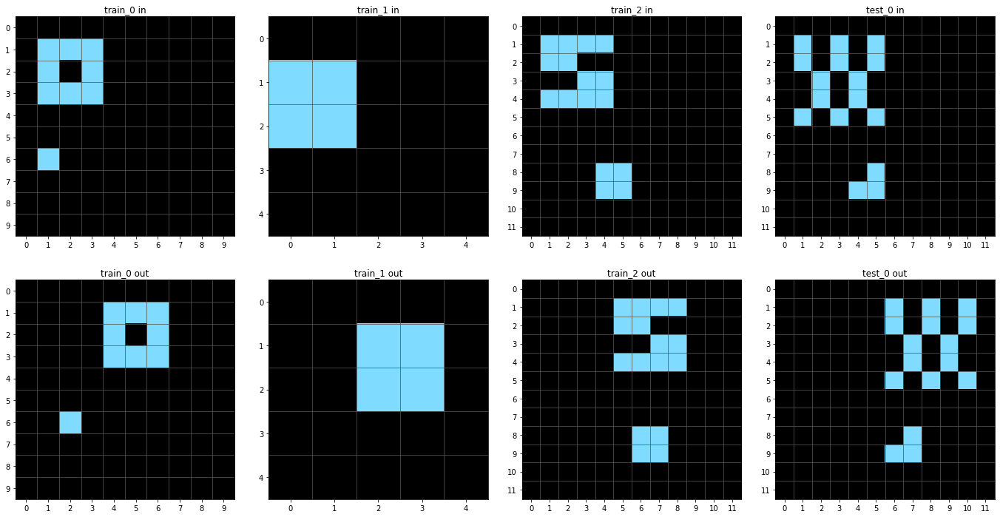

cb227835
no


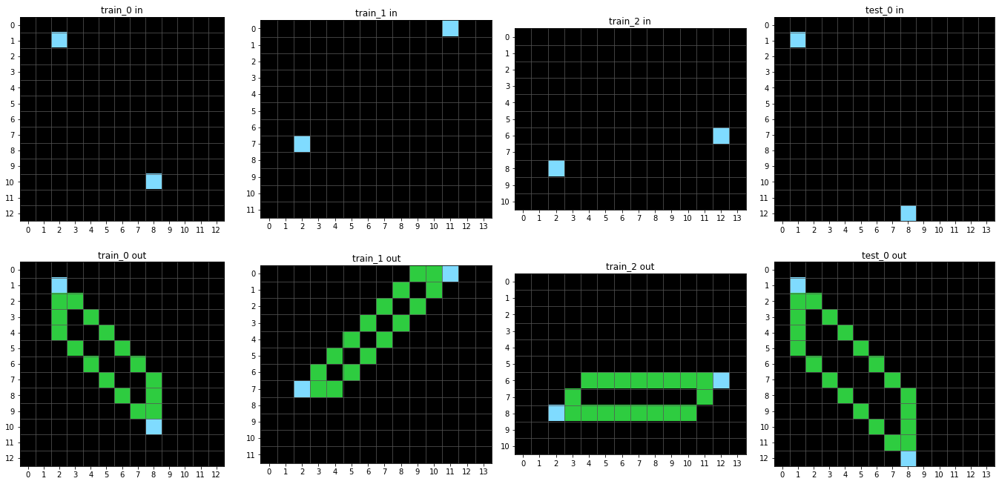

e7639916
no


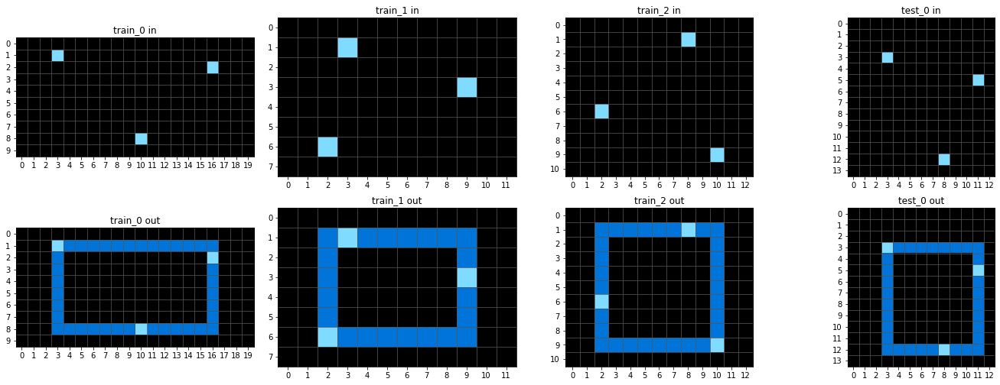

e133d23d
no


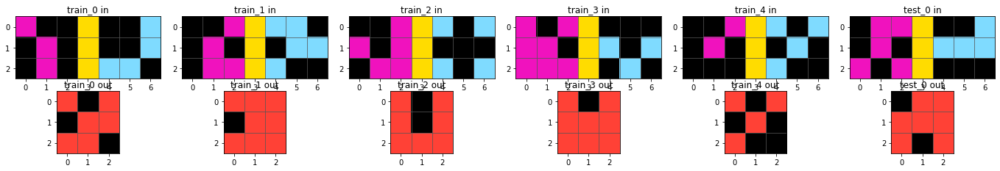

b15fca0b
no


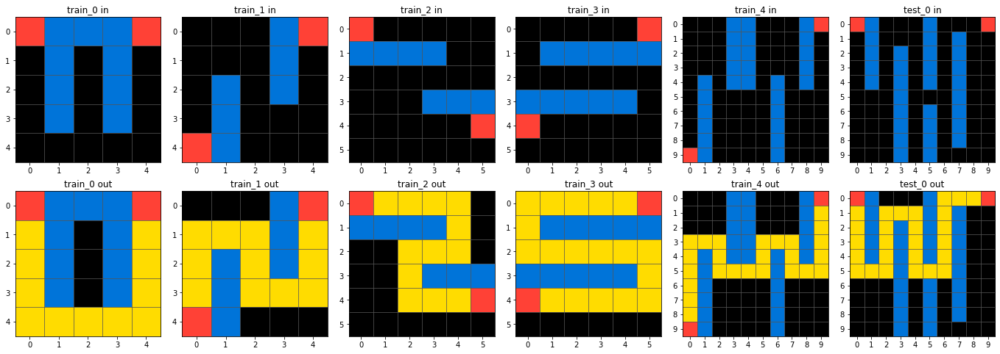

e7dd8335
no


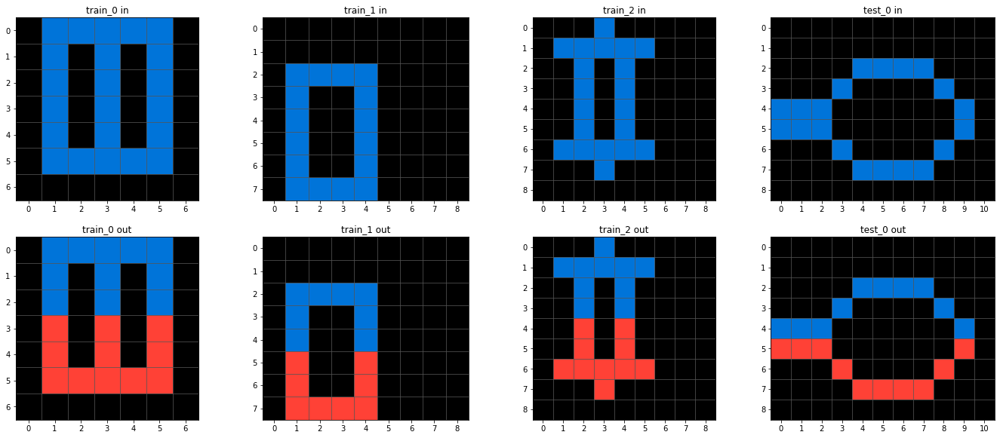

be03b35f
no


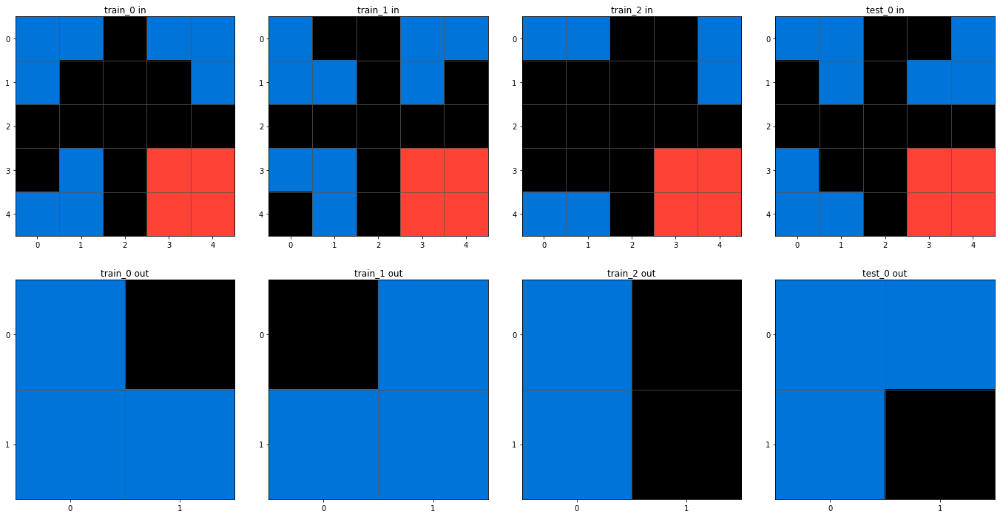

68b67ca3
no


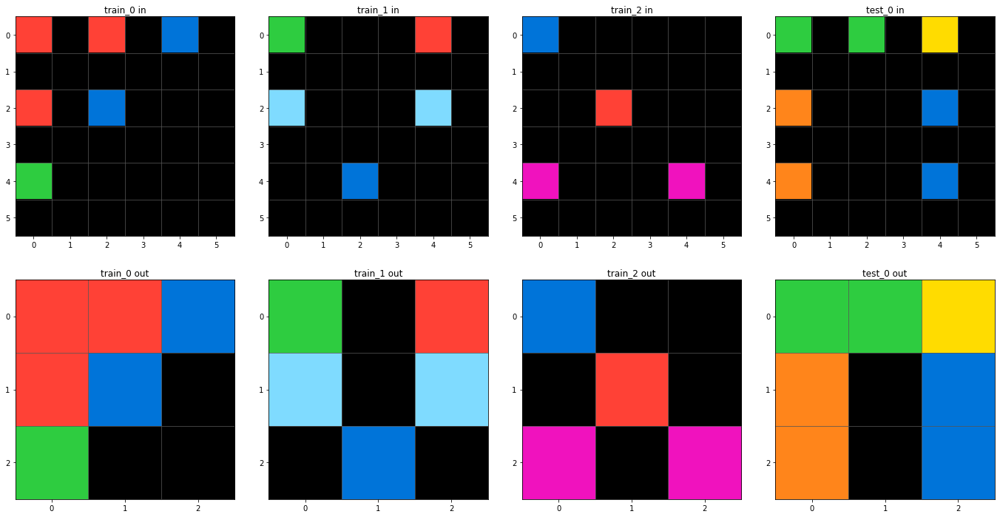

b1fc8b8e
no


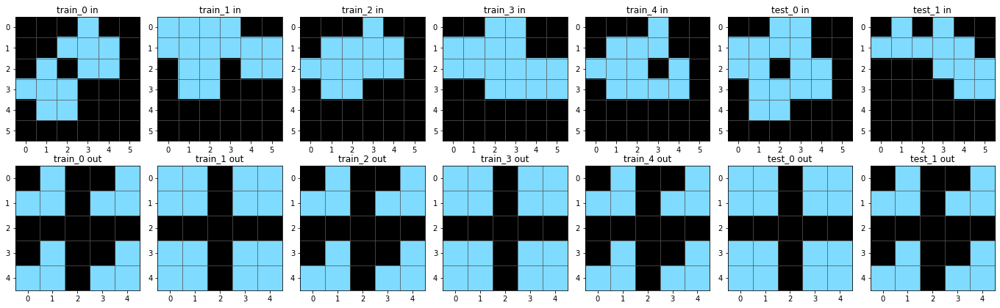

705a3229
no


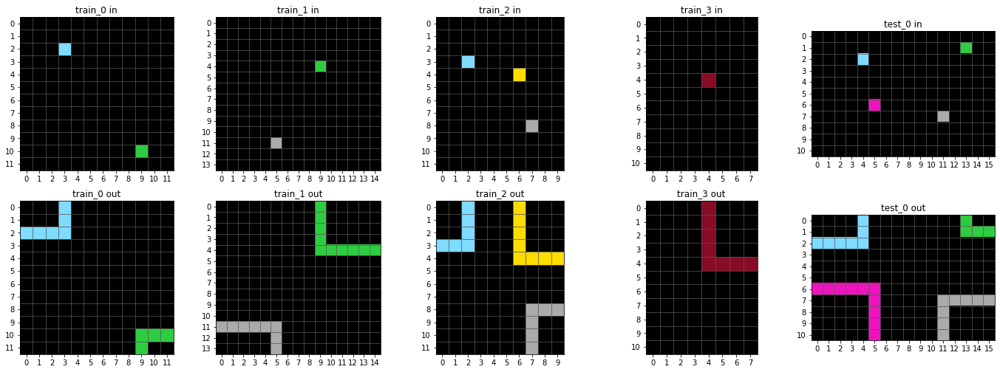

fe9372f3
no


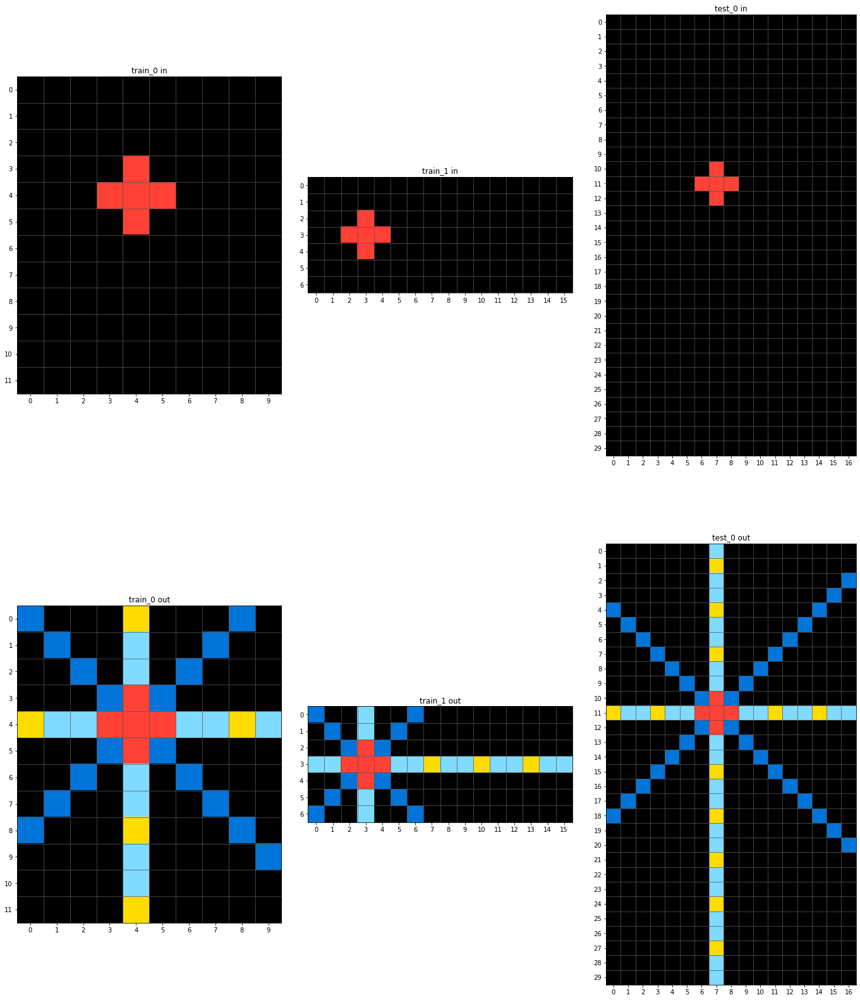

759f3fd3
no


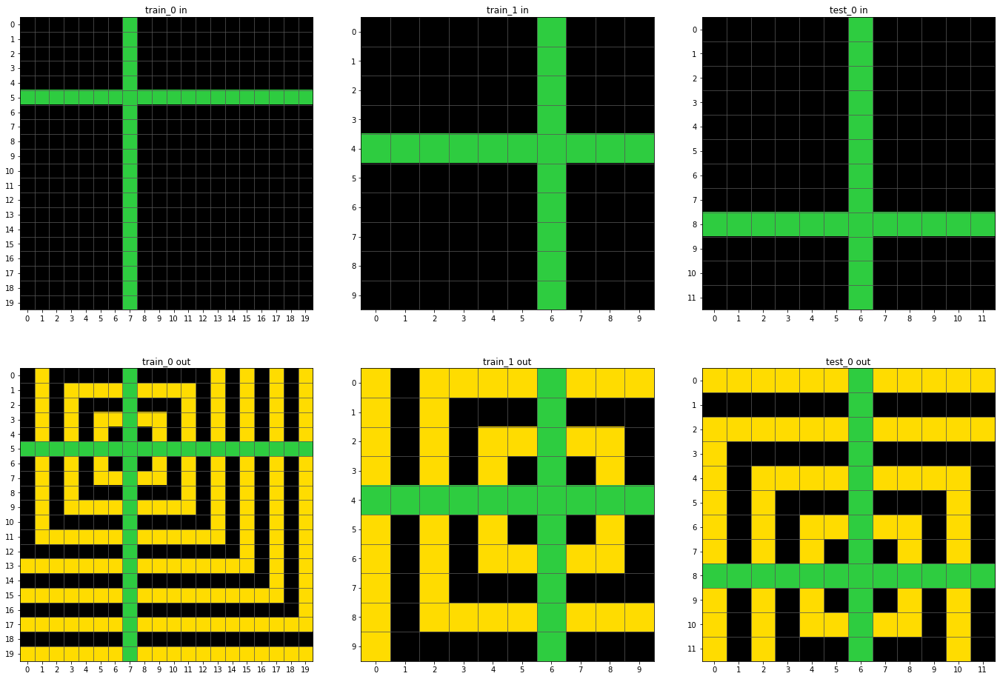

770cc55f
no


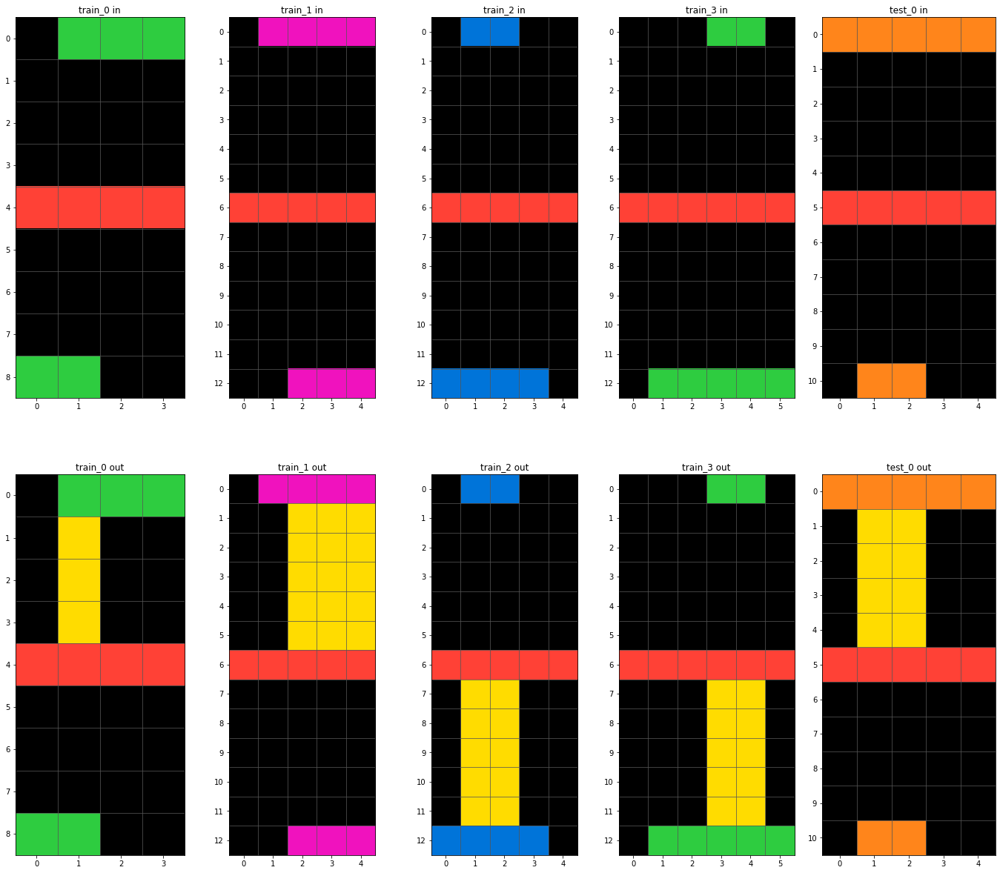

bf32578f
no


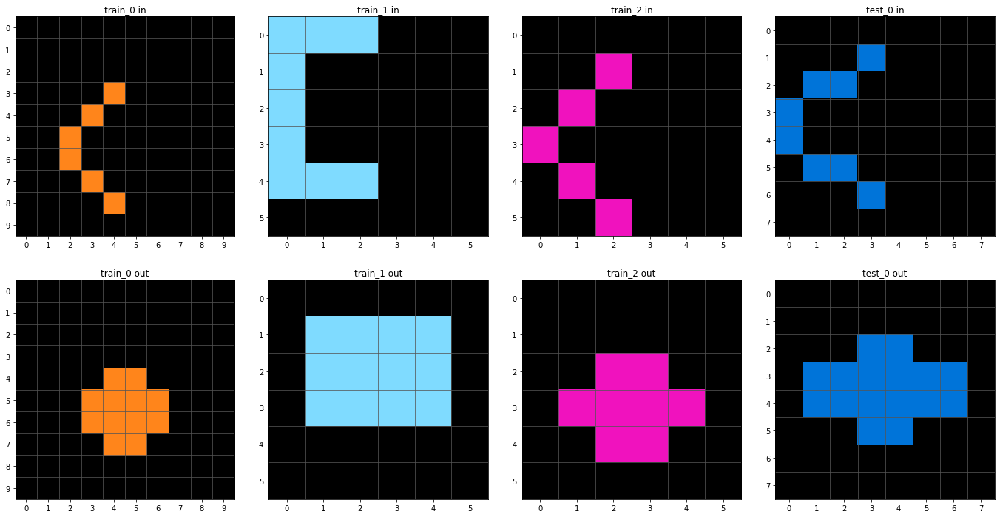

73c3b0d8
no


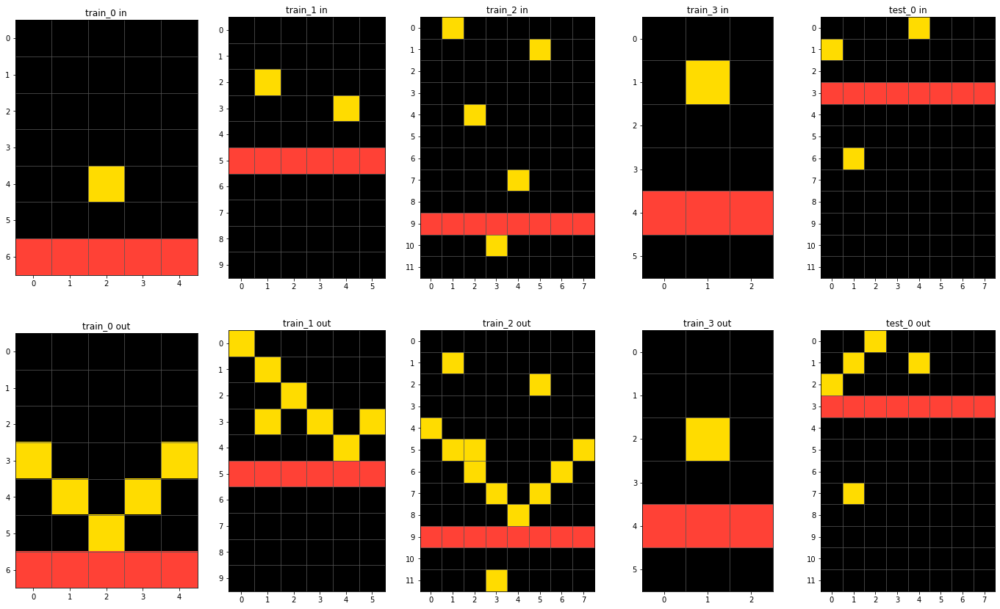

72a961c9
no


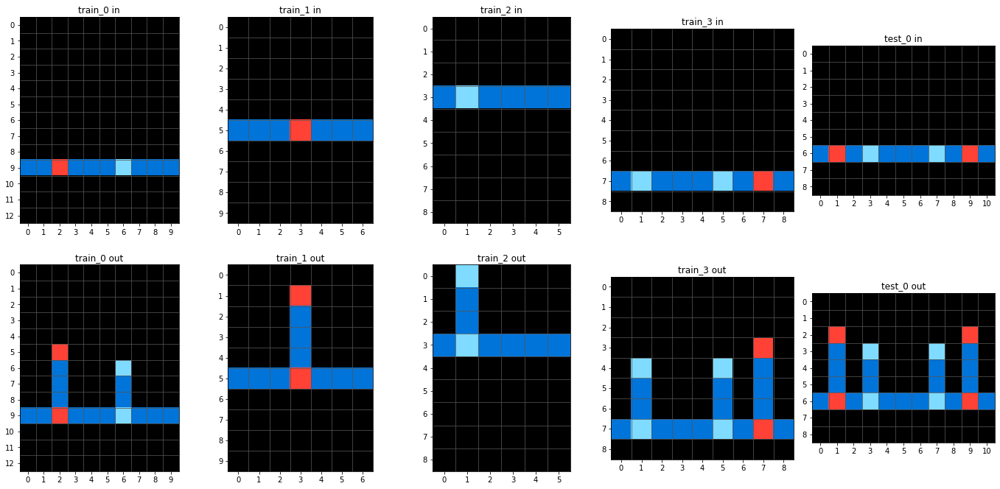

4cd1b7b2
no


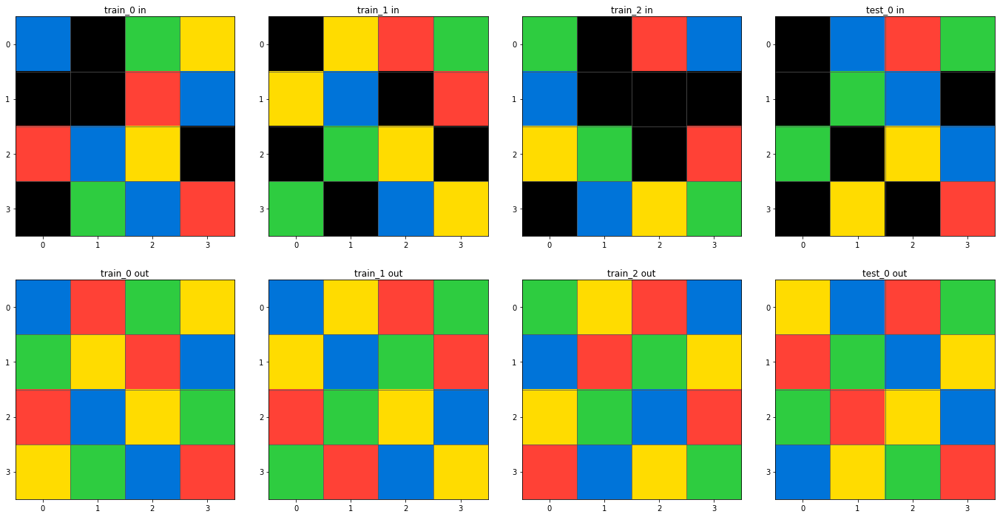

f3e62deb
no


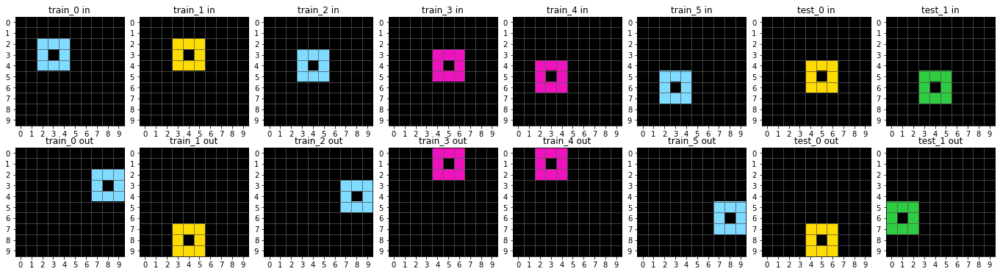

62b74c02
no


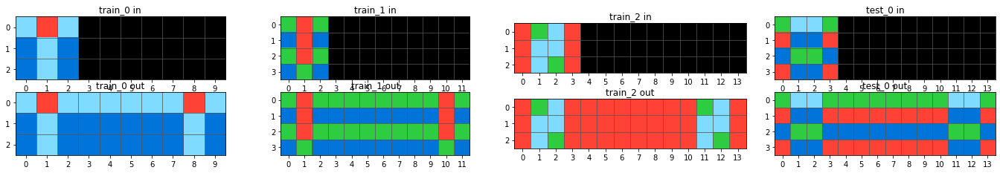

6f473927
no


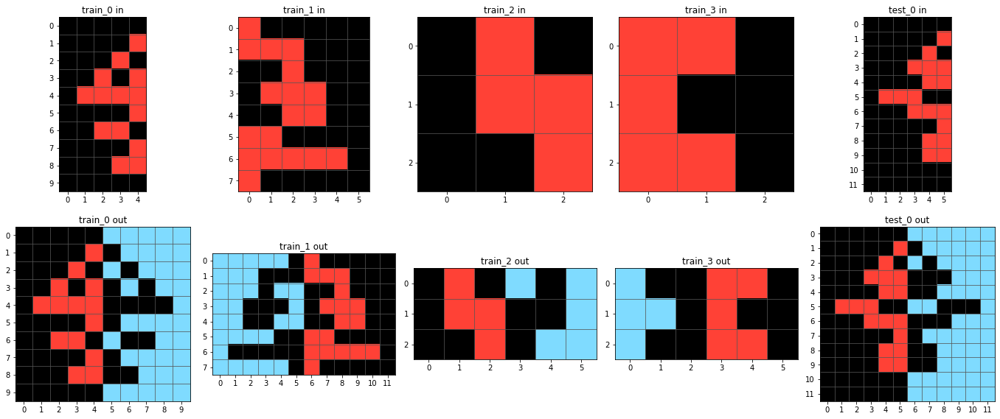

90347967
no


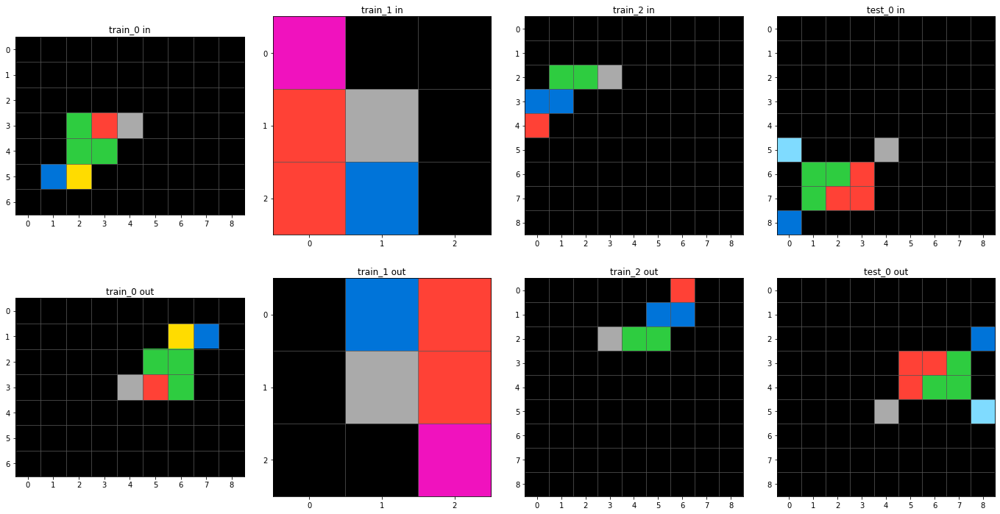

7953d61e
no


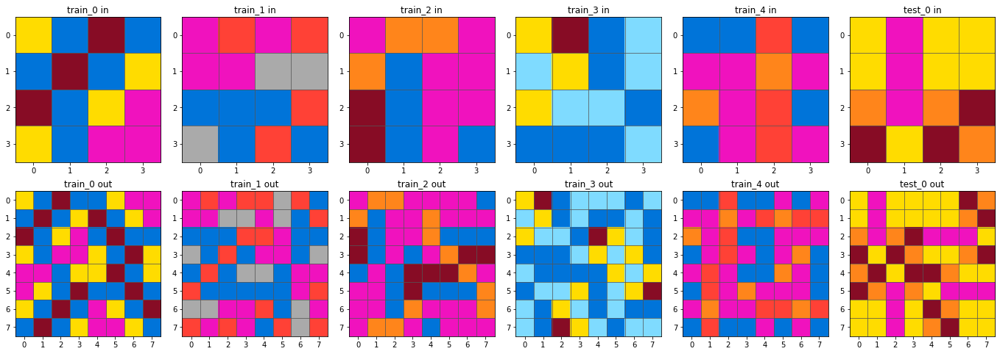

bc4146bd
no


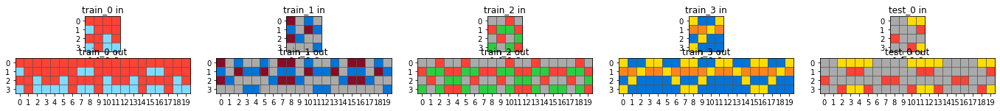

ac605cbb
no


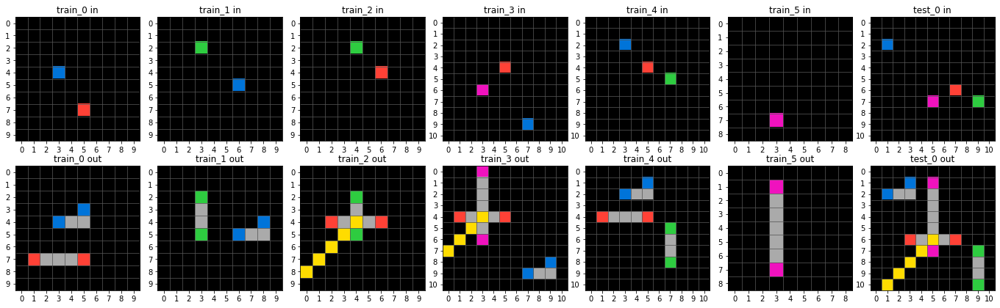

e5790162
no


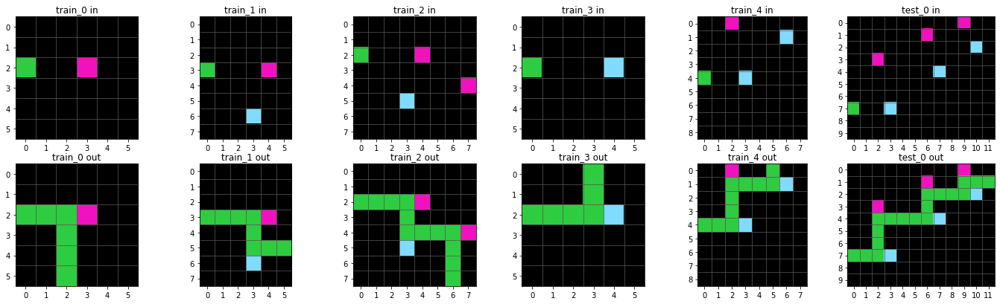

5b6cbef5
[False, False, True, True, False, False]


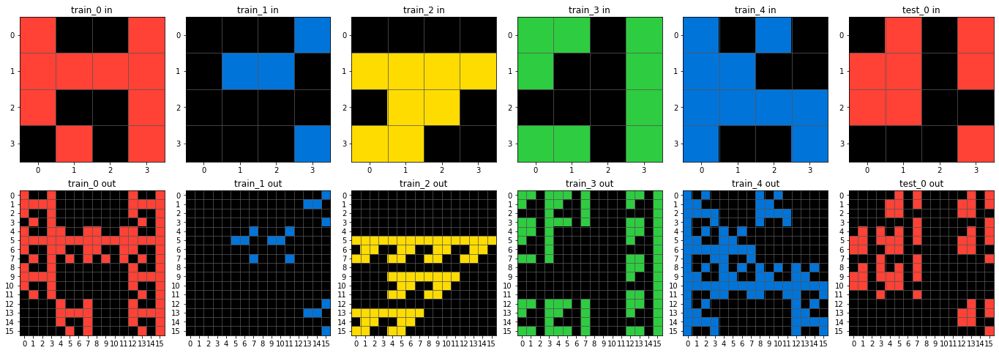

e6de6e8f
no


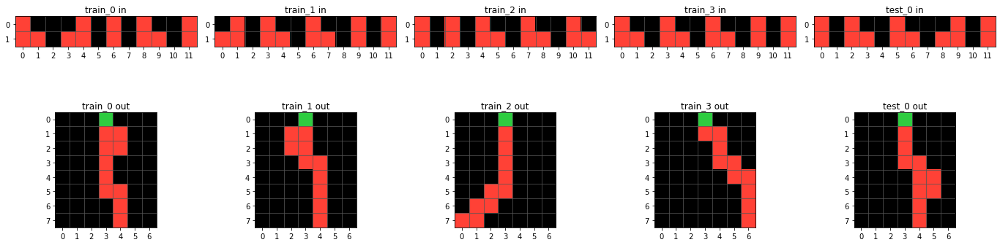

72207abc
no


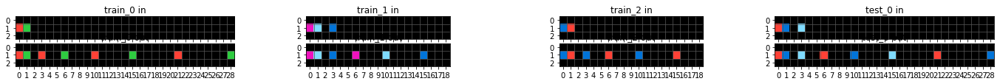

60c09cac
no


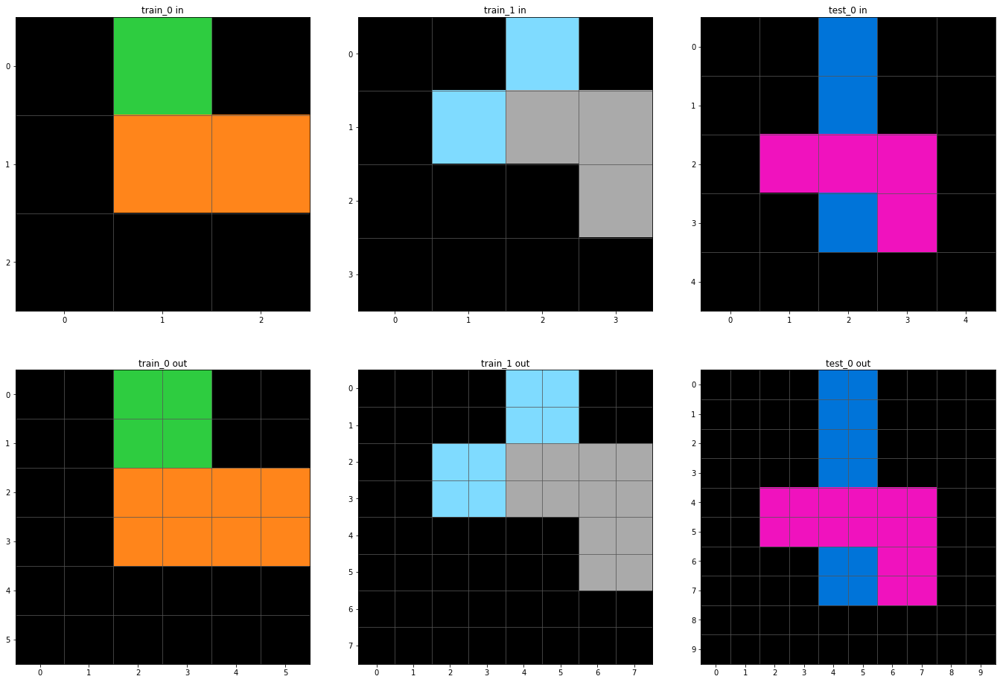

66e6c45b
no


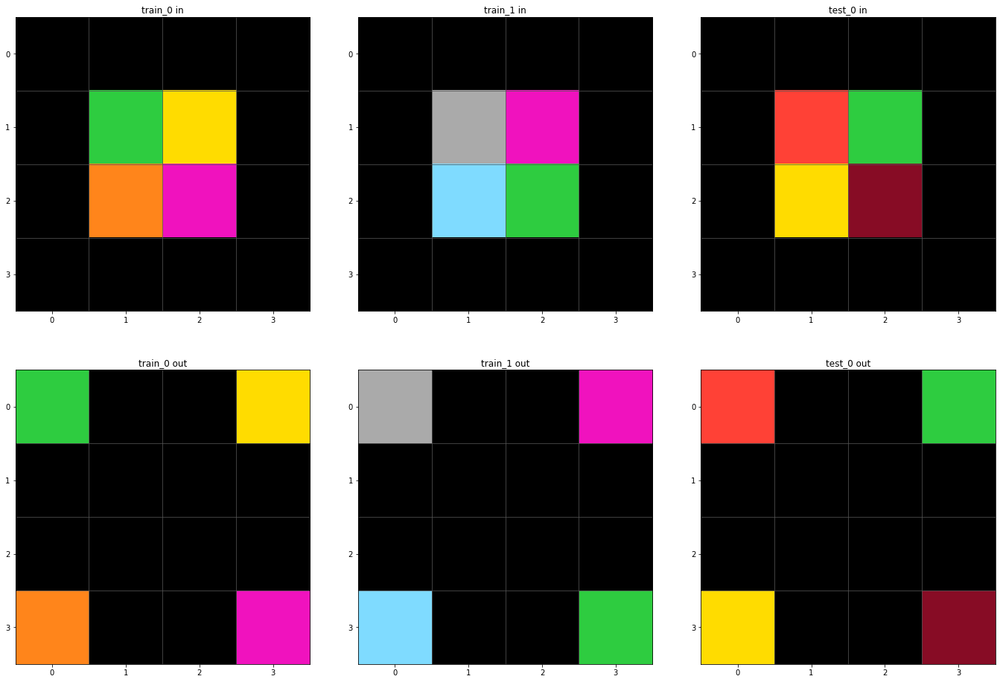

833dafe3
no


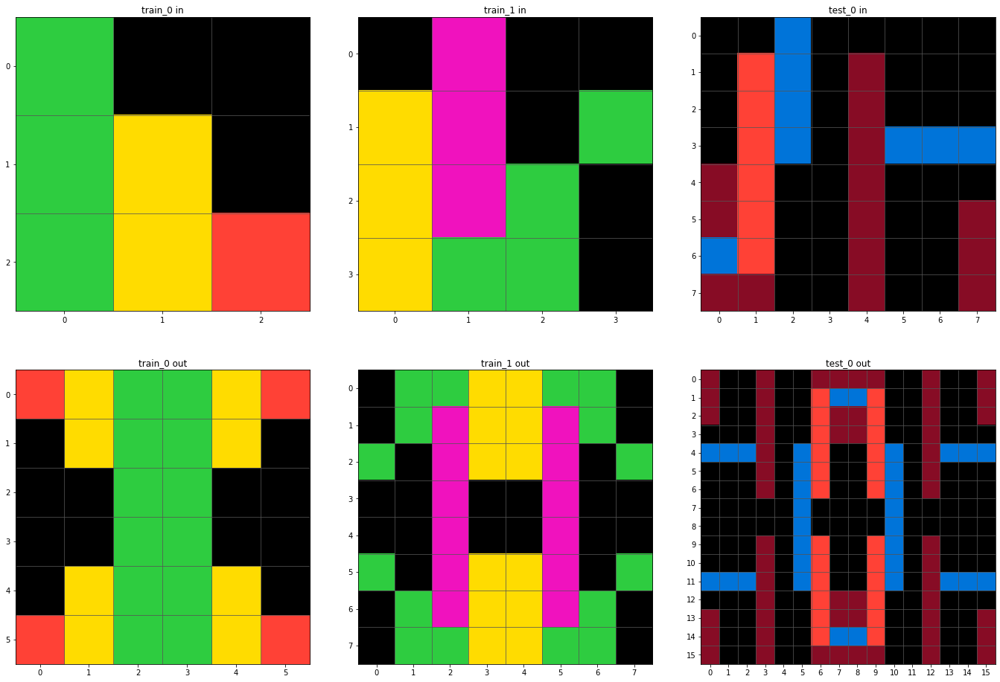

fb791726
no


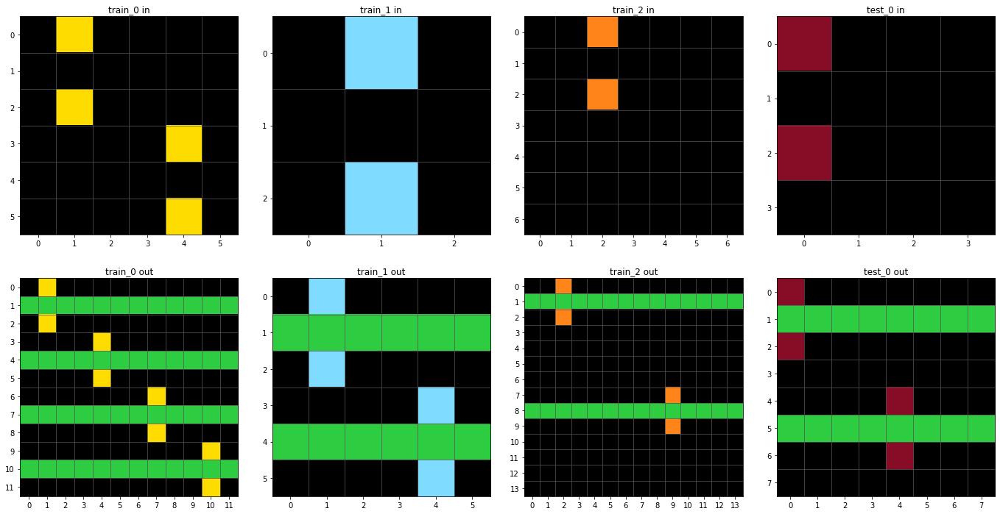

e7b06bea
no


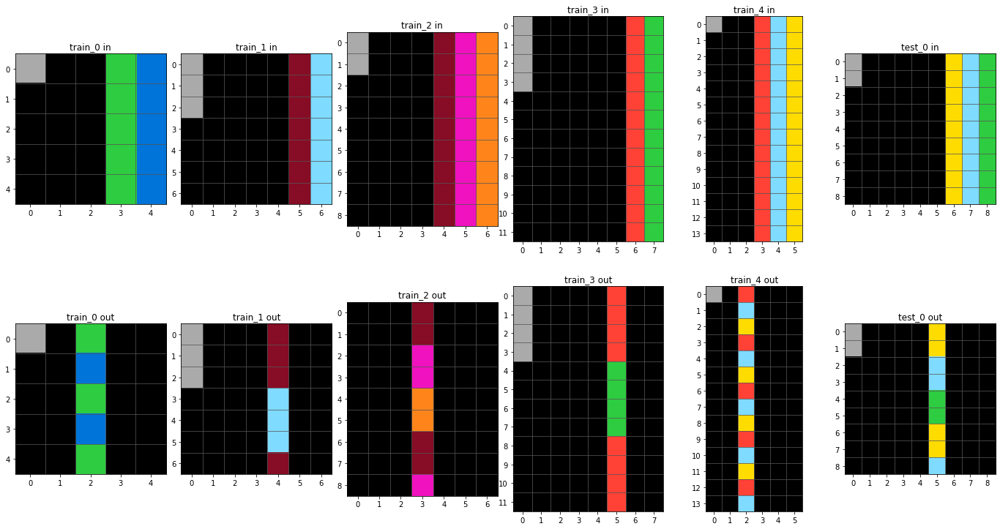

5207a7b5
no


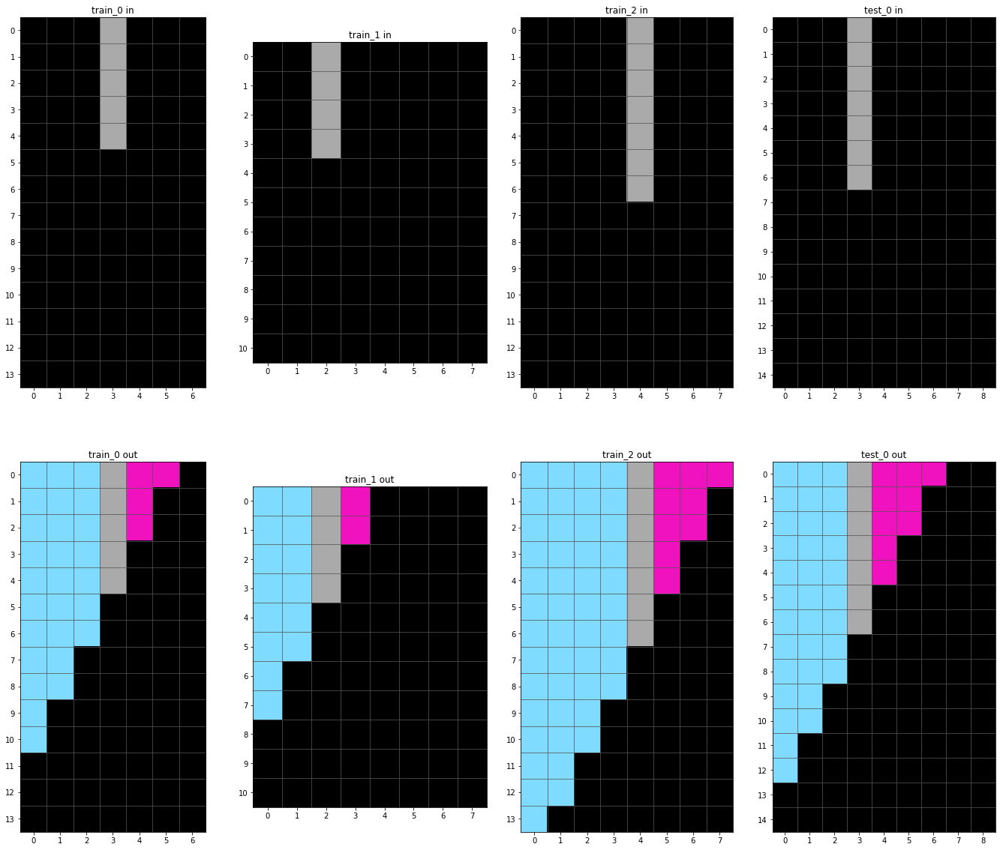

c074846d
no


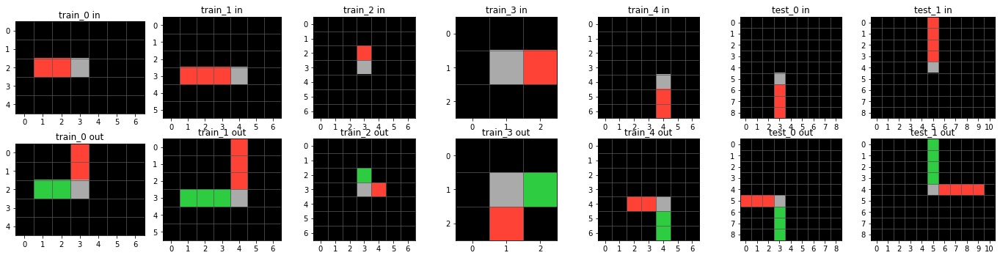

69889d6e
no


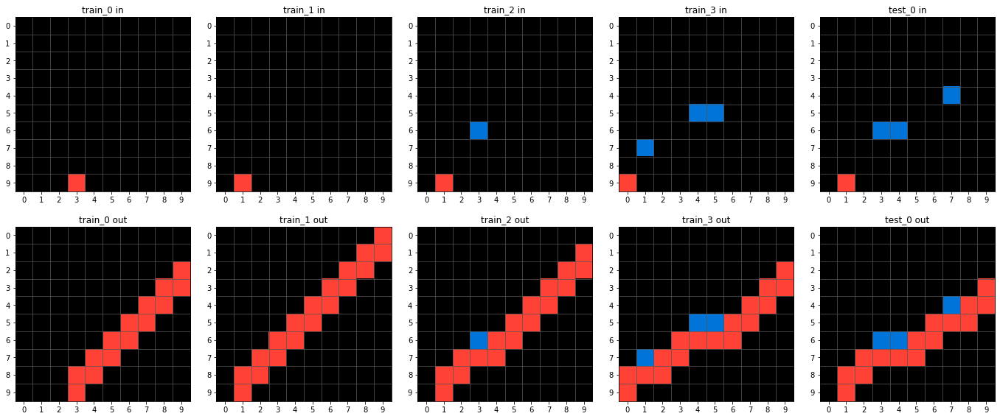

ad7e01d0
no


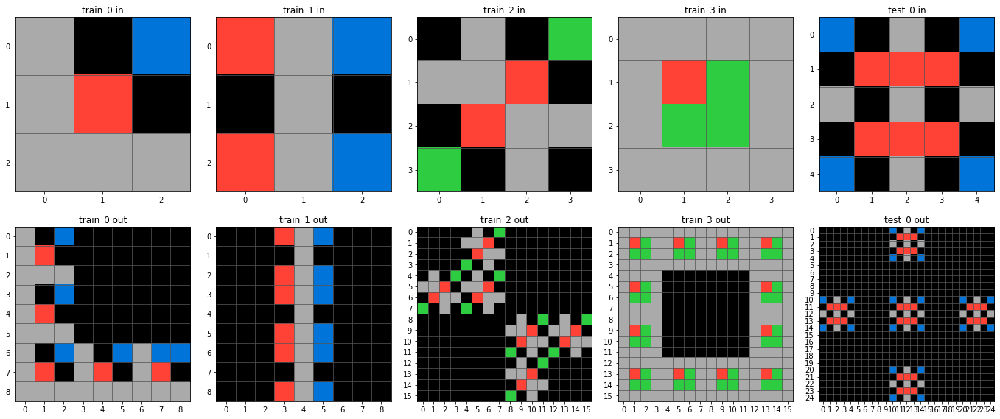

f0afb749
no


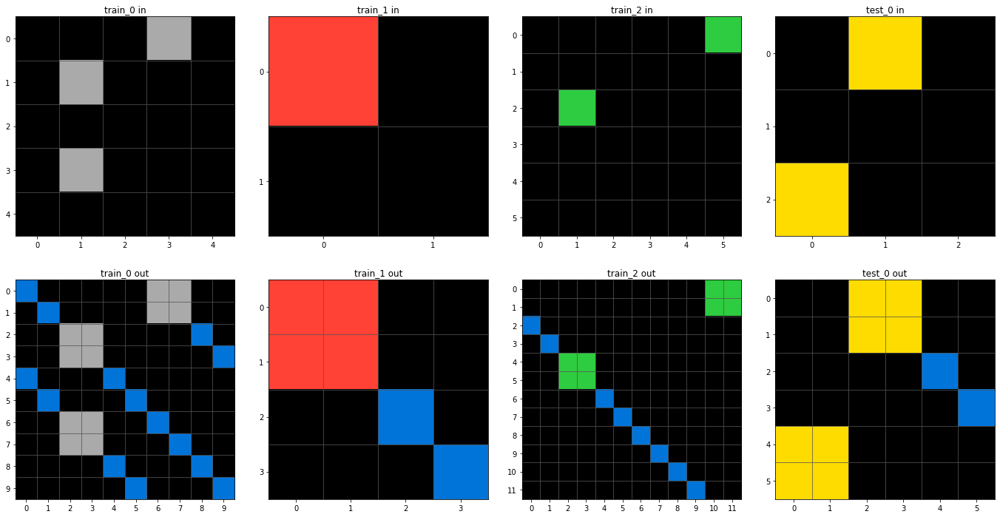

a59b95c0
no


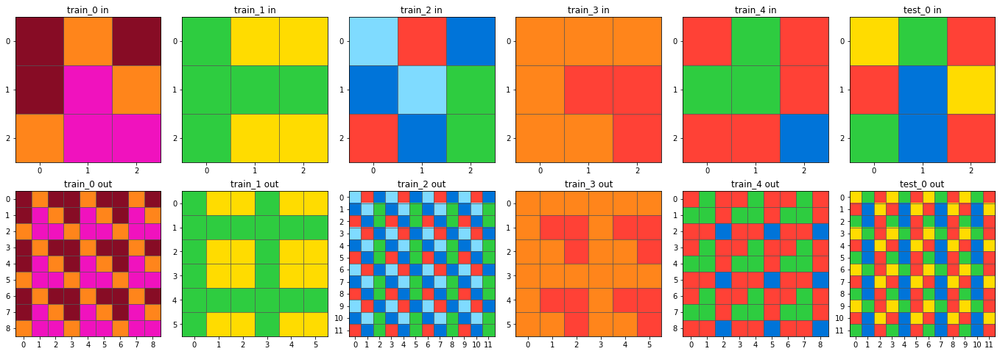

8719f442
[True, True, True, True]


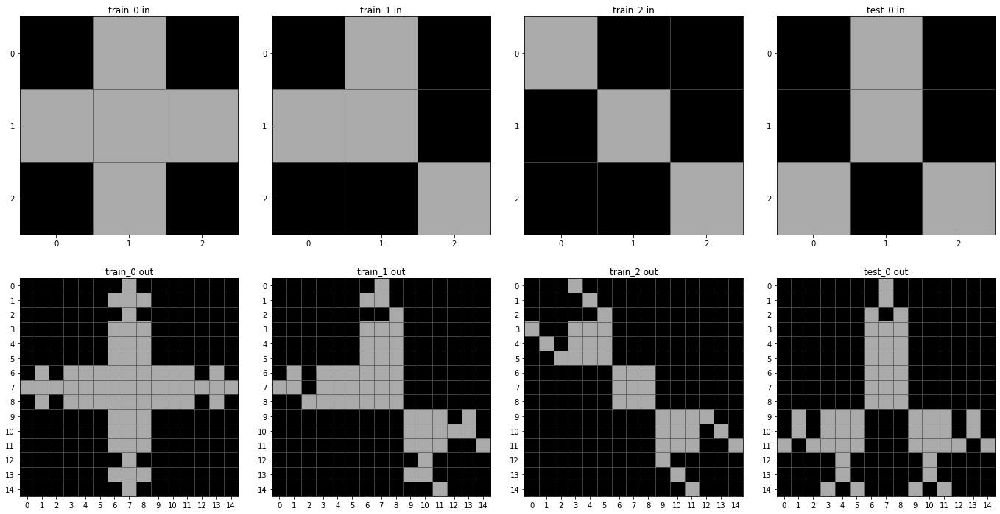

c92b942c
no


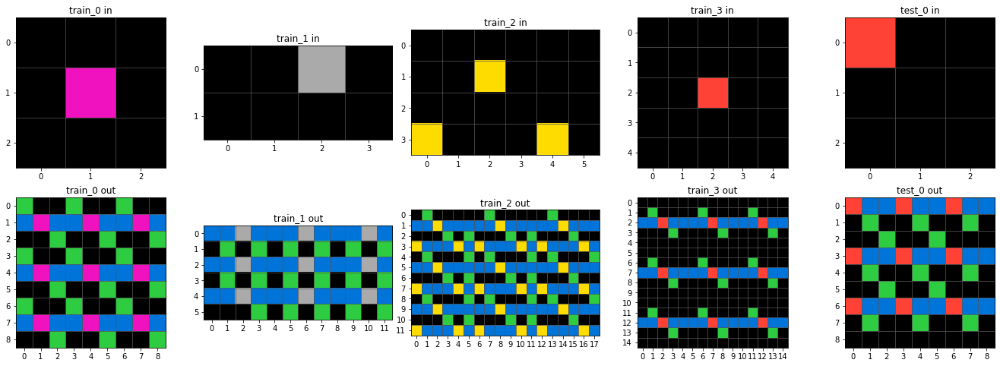

e633a9e5
no


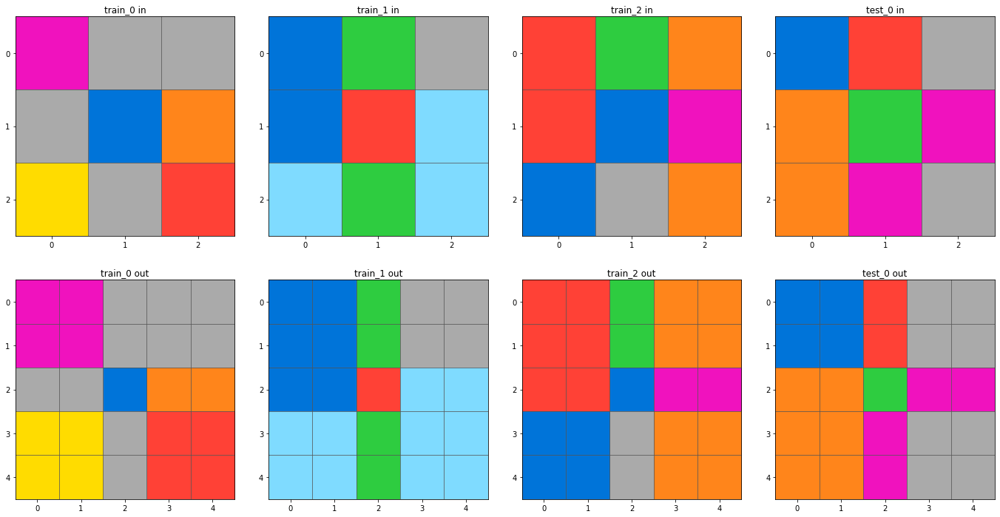

fc754716
no


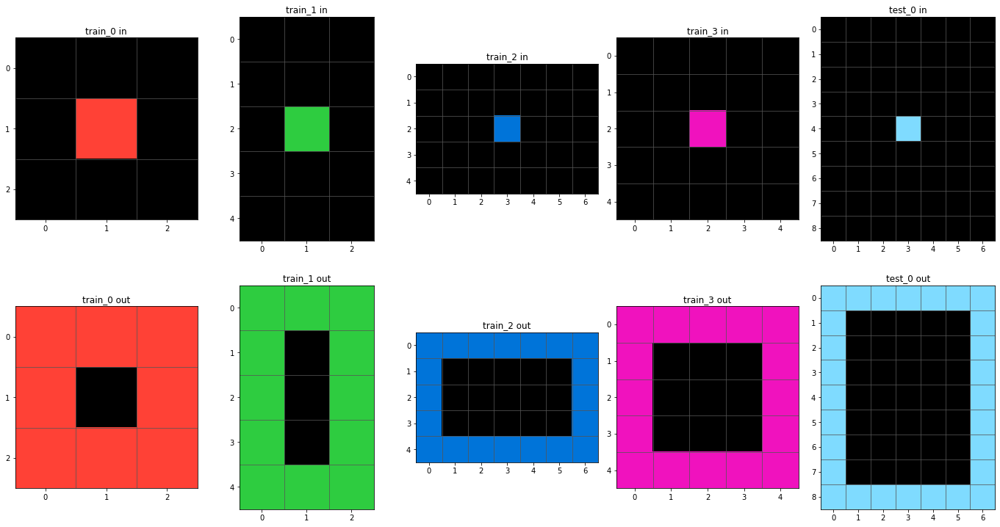

48131b3c
no


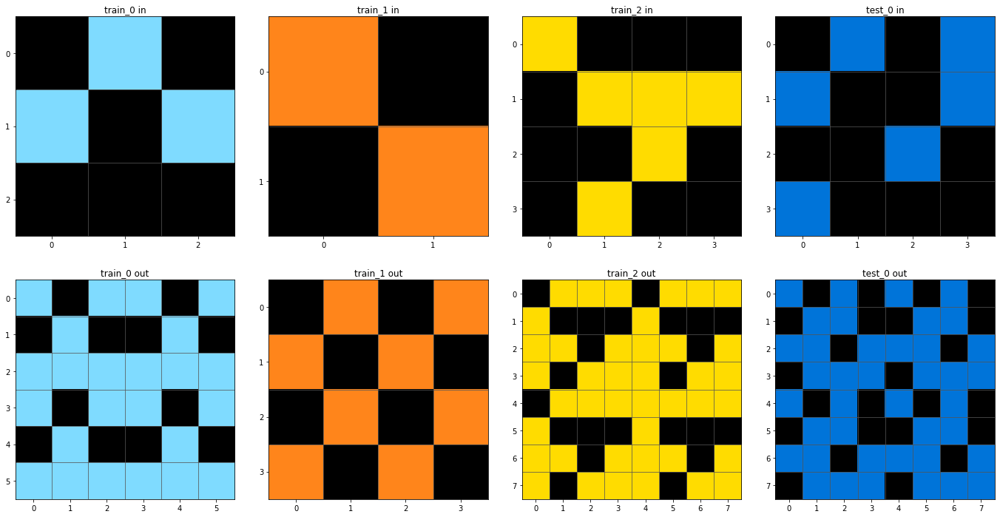

8b28cd80
no


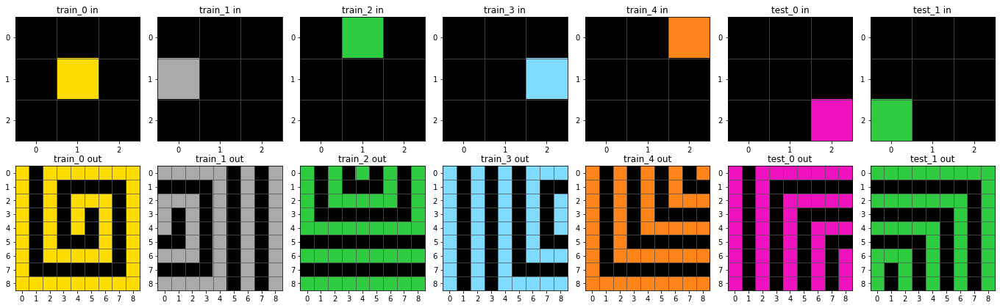

6ea4a07e
no


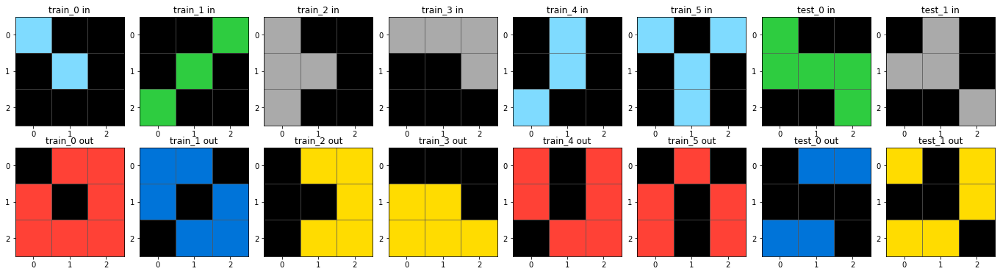

8e2edd66
no


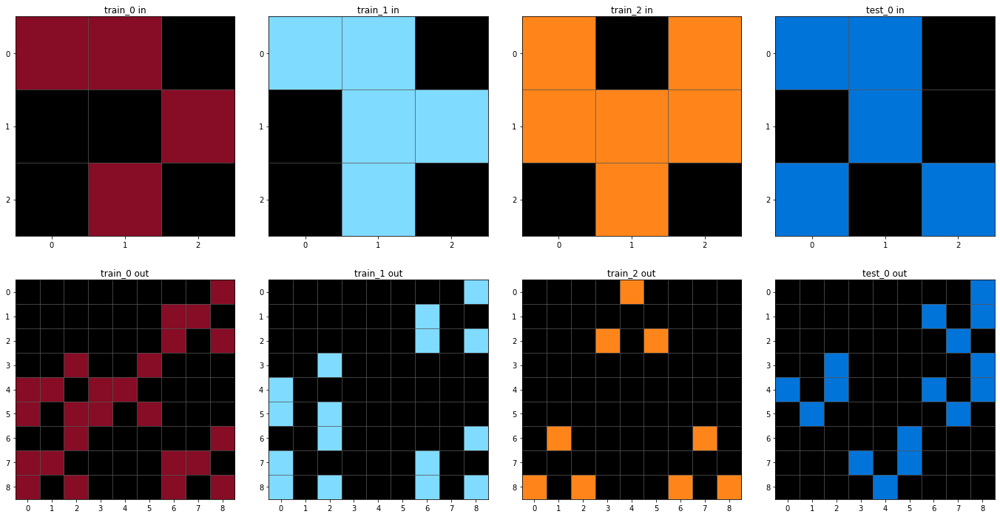

48f8583b
no


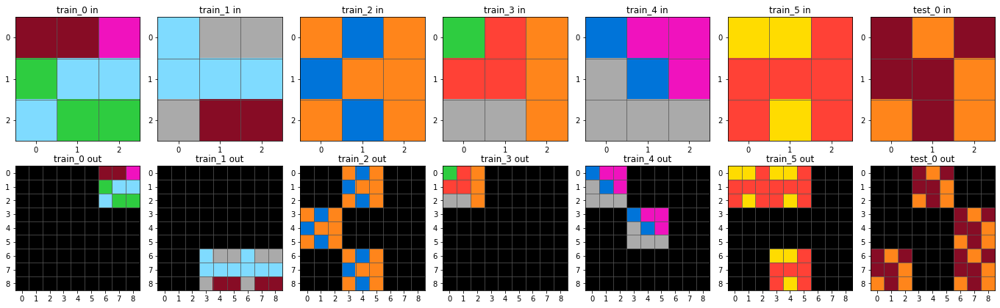

59341089
no


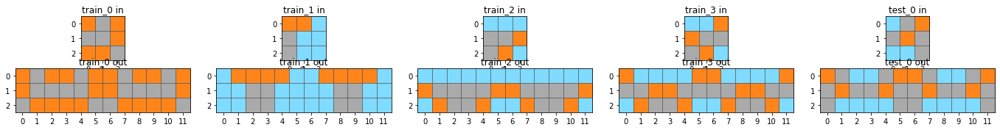

c48954c1
no


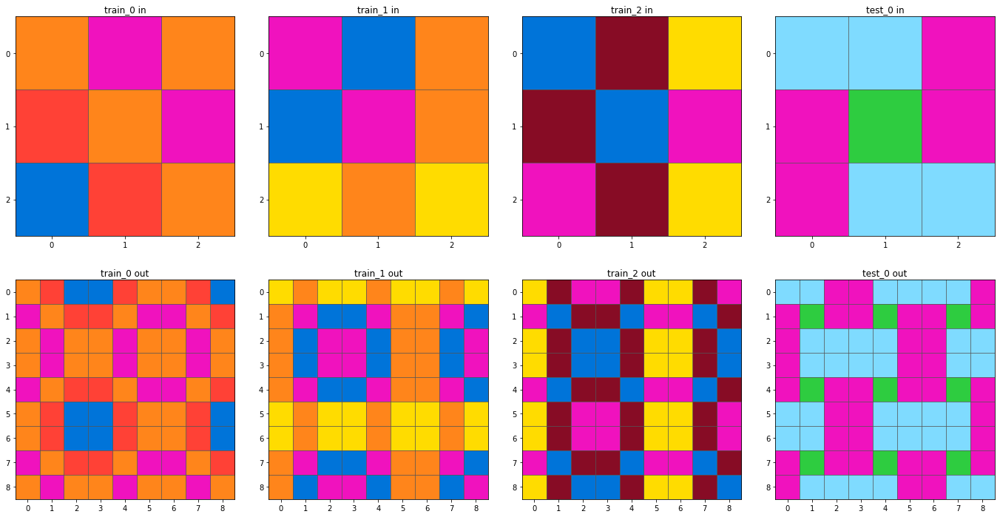

ed98d772
no


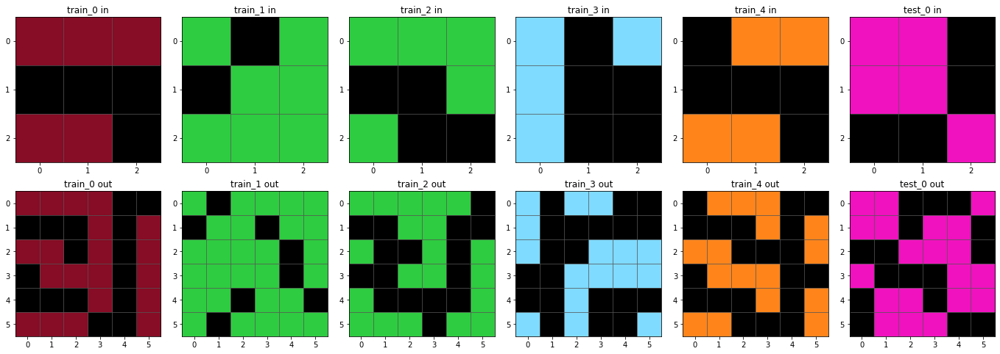

ccd554ac
no


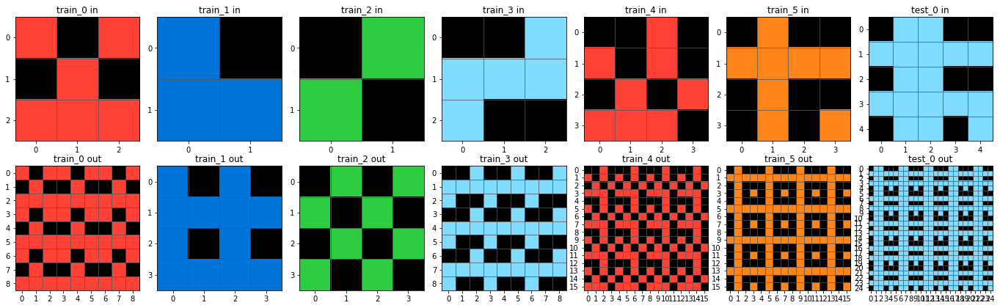

d4b1c2b1
no


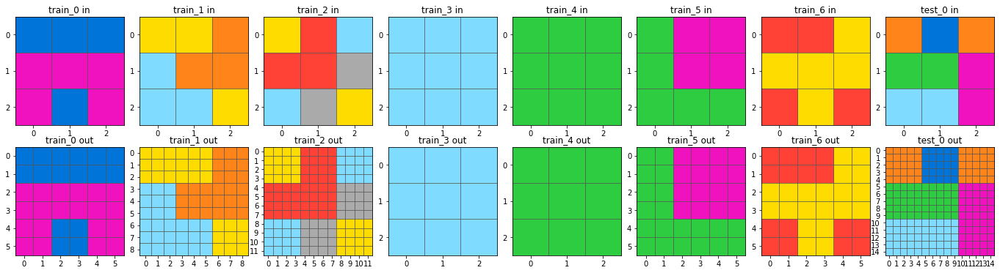

c1990cce
no


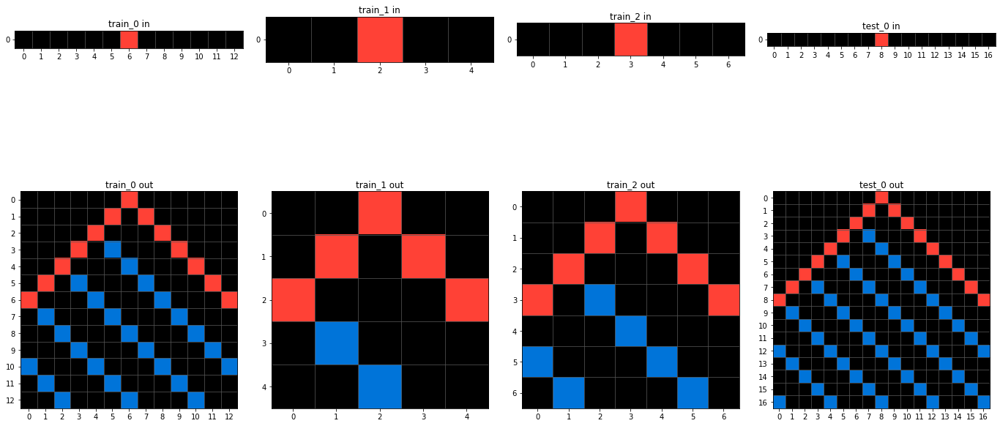

695367ec
[True, True, True, True]


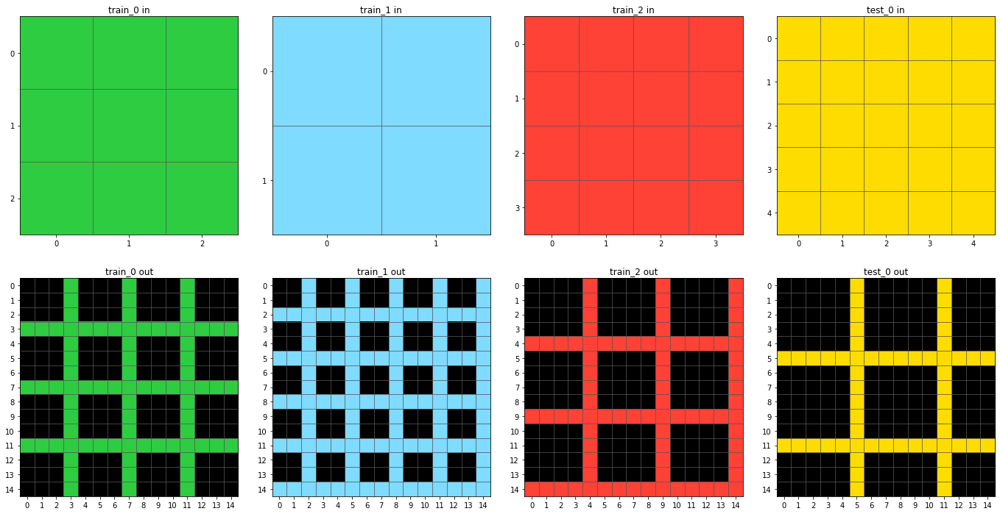

In [1849]:
for task_id in df_eval.sort_values('train_input_bytes_mean_lzma', ascending=False)['task_id']:
    print(task_id)
    task = Task(id_to_filepath[task_id])
    try:
        print([x[7,11] == x[11,7] for x in task.outputs])
    except:
        print('no')
    task.plot()

In [775]:
class BatchSampler(object):
    
    def __init__(self, 
                 data_batch, 
                 parent=None,
                 parent_indices=None):
        self.data_batch = data_batch
        self._parent = parent
        self._parent_indices = parent_indices
        if self._parent is not None:
            self.data_source = self._parent.data_source
            self.data_pool = self._parent.data_pool
        else:
            self.data_source = None
            self.data_pool = data_batch
        
        self.sample_shape = None
        self.sample_indices = None
        
    def __len__(self):
        return len(self.data_batch)
    
    @property
    def data(self):
        return self.data_batch
    
    def get(self, loss_f=None, num_reset=1):
        if loss_f is not None:
            return self._get_reset(loss_f, num_reset)
        else:
            return [np.asarray(x, dtype=np.float32) if i < 2 else list(x) 
                    for i, x 
                    in enumerate(zip(*self.data))]
    
    def _get_reset(self, loss_f, num_reset):
        x, y, *args = [
            np.asarray(x, dtype=np.float32) if i < 2 else list(x) 
            for i, x 
            in enumerate(zip(*self.data))
        ]
        num_args = len(args)
        loss_rank = loss_f(y, x).numpy().argsort()[::-1]
        x = x[loss_rank]
        y = y[loss_rank]
        indices = np.random.choice(range(len(self.data_source[0])), 
                                   num_reset)
        x[:num_reset] = self.data_source[0][indices].copy()
        y[:num_reset] = self.data_source[1][indices].copy()
        
        if len(args) > 0:
            for arg in args:
                arg = [arg[i] for i in loss_rank]
                arg[:num_reset] = [arg[i] for i in indices]
            return (x, y, *args)
        else:
            return x, y
            
    def update(self, batch):
        if isinstance(batch, list) and len(batch) != len(self):
            raise ValuError(f'Expected `batch` to be a list of size {len(self)}, '
                            f'got a {type(batch)} of size {len(batch)}')
        self.data_batch[:] = batch
        for i, idx in enumerate(self._parent_indices):
            self._parent.data_pool[idx] = self.data_batch[i]
            
    def sample(self, n):
        """Returns a batch sampler composed of `n` random samples."""
        indices = np.random.choice(range(len(self.data_pool)), n, replace=False)
        batch = [self.data_pool[i] for i in indices]
        batch_sampler = BatchSampler(batch, parent=self, parent_indices=indices)
        return batch_sampler
    
class Sampler(BatchSampler):
    
    def __init__(self, 
                 data_source,
                 pool_size=256):
        self.data_source = data_source
        self._pool_size = pool_size
        self.sample_shape = sample_shape
        self.data_pool = None
        
        self.update_pool(self.data_source)

    def __len__(self):
        return len(self.data_pool)
    
    @property
    def data(self):
        return self.data_pool
    
    @property
    def pool_size(self):
        return self._pool_size
    
    def update_pool(self, data_source, pool_size=None):
        # just do it up front because the small dataset is innexpensive 
        # normally wouldn't do this and would sample at runtime
        if pool_size is not None:
            self._pool_size = pool_size
        
        pool = []
        for i in range(len(data_source)):
            x = data_source[i]
            if isinstance(x, np.ndarray):
                pool.append(np.repeat(x, self.pool_size, axis=0))
            else:
                pool.append(list(x) * self.pool_size)
        
        self.data_pool = list(zip(*pool))
        
        
class GridSampler(Sampler):
    
    def __init__(self,
                 data_source,
                 pool_size=256,
                 sample_shape=None):
        self.sample_shape = sample_shape
        self.origin_indices = None
        super(GridSampler, self).__init__(data_source, pool_size)
    
    def update_pool(self, data_source, pool_size=None):
        # just do it up front because the small dataset is innexpensive 
        # normally wouldn't do this and would sample at runtime
        if pool_size is not None:
            self._pool_size = pool_size
            
        self._set_origin_indices(data_source[0])
        h, w = self.sample_shape
        
        pool = []
        idx = np.random.choice(range(len(self.origin_indices)), self.pool_size)
#         pool_indices = (
#             tuple(np.zeros(self.pool_size, np.uint8)), 
#             *list(zip(*self.origin_indices[idx]))
#         )
        pool_slices = [
            (slice(1), slice(p[0], p[0] + h), slice(p[1], p[1] + w), Ellipsis)
            for p in self.origin_indices[idx]
        ]
        
        pool = []
        for i, x in enumerate(data_source):
            if i < 2:
                pool.append(np.vstack([x[s] for s in pool_slices]))
            else:
                pool.append(np.repeat(x, self.pool_size, axis=0))
        
#         self.data_pool = pool
        self.data_pool = list(zip(*pool))
        
        
    def _set_origin_indices(self, x):
        """Sets the list of grid coordinates that are valid for sampling."""
        # currently only works for a single input
        b, h, w, d = get_dims(x)
        sh, sw = sample_shape
        indices = np.stack(np.meshgrid(np.arange(h), np.arange(w))).T.reshape(-1,2)

        mask_indices = np.array(list(zip(*np.where(x[0,...,-1] == 0))))
        num_masks = len(mask_indices)
        mask_coords = np.repeat(mask_indices, (sh-1) * (sw-1), 0)
        sample_coords = np.array([(i,j) for i in range(sh-1) for j in range(sw-1)])
        sample_coords_mask = np.tile(sample_coords, [num_masks, 1])

        border_indices = np.vstack([
            np.array(list(zip(np.repeat(h-1, h), np.arange(w)))),
            np.array(list(zip(np.arange(h), np.repeat(w-1, w))))
        ])
        num_borders = len(border_indices)
        border_coords = np.repeat(border_indices, (sh-1) * (sw-1), 0)
        sample_coords_border = np.tile(sample_coords, [num_borders, 1])

        padded_indices = [
            mask_coords - sample_coords_mask * np.array([i,j]) 
            for i in [1,0] 
            for j in [1,0]
        ]
        padded_indices.extend([
            border_coords - sample_coords_border * np.array([i,j]) 
            for i in [1,0] 
            for j in [0,1]
        ])
        padded_indices = np.vstack(padded_indices)

        self.origin_indices = np.array(diff(indices, padded_indices)) 

In [781]:
s = GridSampler([x, y, cmaps[:1], output_shapes[:1]], sample_shape=(3,3))

b = s.sample(5)

In [782]:
a = b.get()

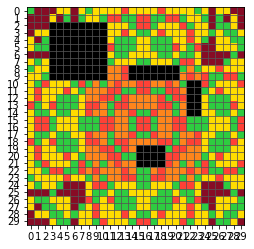

In [787]:
plot_grid(channel_to_grid(x[0], cmaps[0]))

- i need to find the most similar region

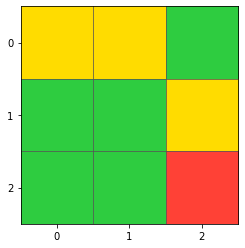

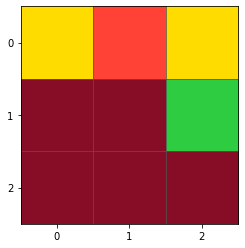

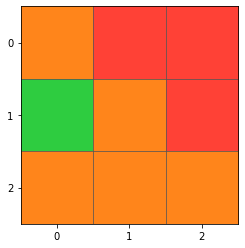

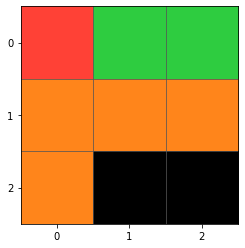

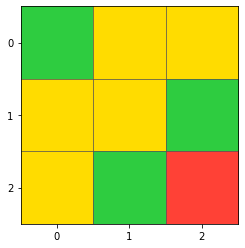

In [786]:
for i in range(len(a[0])):
    plot_grid(channel_to_grid(a[0][i], a[2][0]))
    plt.show()

In [ ]:
np.outer([])

In [1378]:
xy = np.array([
    [-2, -1,  0],
    [-1,  0,  1],
    [ 0,  1,  2]
], np.float32)

In [1384]:
flip_x(xy)

array([[ 0., -1., -2.],
       [ 1.,  0., -1.],
       [ 2.,  1.,  0.]], dtype=float32)

In [1383]:
model.dx[...,0,0]

array([[-0.125,  0.   ,  0.125],
       [-0.25 ,  0.   ,  0.25 ],
       [-0.125,  0.   ,  0.125]], dtype=float32)

In [1379]:
xy.T

array([[-2., -1.,  0.],
       [-1.,  0.,  1.],
       [ 0.,  1.,  2.]], dtype=float32)

In [1560]:
def get_living_mask(x, mask_th=.1):
    """As long as one neighbor has a value > `th` it will be considered 'alive'.
    Any cells with no neighbors > `th` will be considered dead (zero'd out)
    """
    a = x[:,:,:,-1:]
    return tf.nn.max_pool2d(a, 3, [1, 1, 1, 1], 'SAME') > mask_th


@tf.function
def get_updates(obj_matrix, obj_idx, h, w):
    num_updates = tf.shape(obj_idx)[0]
    ta = tf.TensorArray(tf.float32, num_updates)
    init_state = (0, ta)
    condition = lambda i, _: i < num_updates
    body = lambda i, ta: (i+1, ta.write(i, tf.reshape(obj_matrix[...,obj_idx[i]], (h * w,))))
    n, ta_updates = tf.while_loop(condition, body, init_state)
    return ta_updates.concat()


@tf.function
def get_object_mask(x, kernel, obj_th=.5):
    num_objs = tf.cast(tf.shape(kernel)[-1], tf.int64)
    obj_matrix = tf.reduce_sum(kernel, (-2))
    h, w, d = obj_matrix.shape
    obj_coords = tf.cast(
        tf.concat([
            tf.zeros([h * w, 1], tf.int32),
            tf.repeat(tf.range(h), w)[...,None],
            tf.tile(tf.range(w)[...,None], [h, 1]),
            tf.zeros([h * w, 1], tf.int32)
        ], axis=1), 
        tf.int64
    )
    
    y = tf.nn.depthwise_conv2d(x, kernel, [1,1,1,1], 'SAME')
    match_coords = tf.cast(tf.where(y > obj_th), tf.int64)
    num_matches = tf.shape(match_coords)[0]
    obj_idx = match_coords[:,-1] % num_objs
    match_coords = tf.concat(
        [match_coords[:,:-1], match_coords[:,-1:] // num_objs], 
        axis=1
    )
    
    match_coords = tf.repeat(match_coords, num_objs, axis=0)
    obj_coords = tf.tile(obj_coords, [num_matches,1])
    indices = match_coords + obj_coords
    updates = get_updates(obj_matrix, obj_idx, h, w)
    
    return tf.scatter_nd(indices, updates, tf.shape(x, tf.int64))


class CAModel(tf.keras.Model):

    def __init__(self, 
                 num_channels, 
                 object_filters=None):
        super(CAModel, self).__init__()
        self.num_channels = num_channels
        self.object_filters = object_filters
        self.dobjects = None
        
        identity = np.outer([0,1,0], [0,1,0], out=np.zeros((3,3), dtype=np.float32))
        self.identity = np.repeat(identity[..., None, None], self.num_channels, 2)
        
        dx = np.array(np.outer([1, 2, 1], [-1, 0, 1]) / 8., dtype=np.float32)
        dy = dx.T
        dxy = np.array([
            [-2, -1,  0],
            [-1,  0,  1],
            [ 0,  1,  2]
        ], np.float32)
        dyx = rot90(dxy)
        self.dx = np.repeat(dx[..., None, None], self.num_channels, axis=2)
        self.dy = np.repeat(dy[..., None, None], self.num_channels, axis=2)
        self.dxy = np.repeat(dxy[...,None, None], self.num_channels, axis=2)
        self.dyx = np.repeat(dyx[...,None, None], self.num_channels, axis=2)
        self.dcontext = tf.keras.layers.Conv2D(self.num_channels, 
                                               1,
                                               padding='same',
                                               activation=tf.nn.relu,
                                               use_bias=False)
        
        self.dpercept = tf.concat([
            self.identity,
            self.dx,
            self.dy,
#             self.dxy,
#             self.dyx,
        ], axis=-1)
        if self.object_filters is not None:
            self.dobjects = tf.concat(object_filters, axis=-1)
    
        self.dmodel = tf.keras.Sequential([
              tf.keras.layers.Conv2D(128,
                                     1,
                                     activation=tf.nn.relu,
                                     use_bias=False
                                    ),
              tf.keras.layers.Conv2D(self.num_channels, 
                                     1,
                                     activation=None,
                                     use_bias=False,
                                     kernel_initializer=tf.zeros_initializer
                                    )
            
        ])
        
        self._set_inputs(tf.zeros([1, 3, 3, self.num_channels]))

    @tf.function
    def perceive(self, x, obj_th=.5):
        y = tf.nn.depthwise_conv2d(x, self.dpercept, [1,1,1,1], 'SAME')
        if self.dobjects is not None:
            x_obj = get_object_mask(x, self.dobjects, obj_th)
            y = tf.concat([y, x_obj], axis=-1)
#         yc = self.dcontext(x)
#         y = tf.concat([y,yc],axis=-1)
        return y

    @tf.function
    def call(self, 
             x,
             dropout=.5,
             step_size=1.,
             mask_th=.1,
             obj_th=.5):
        pre_life_mask = get_living_mask(x, mask_th)

        y = self.perceive(x, obj_th)
        dx = self.dmodel(y) * step_size
        update_mask = tf.random.uniform(tf.shape(x[...,:1])) <= dropout
        x += dx * tf.cast(update_mask, tf.float32)
        
        post_life_mask = get_living_mask(x, mask_th)
        life_mask = pre_life_mask & post_life_mask
        return x * tf.cast(life_mask, tf.float32)
    
def warmup(model, x, **kwargs):
    with tf.GradientTape() as g:
        x = model(x, **kwargs)
        
@tf.function
def compute_gradients(model, x, y, sims=64, **kwargs):
    
    with tf.GradientTape(persistent=False) as g:
        for _ in tf.range(sims):
            x = model(x, **kwargs)
        loss = tf.reduce_mean(mean_squared_error(y, get_pred(x, y.shape[-1]-1)))

    # backprop
    gw = g.gradient(loss, model.weights)
    gw = [g/(tf.norm(g)+1e-8) for g in gw]
    optim.apply_gradients(zip(gw, model.weights))
    return x, loss

In [2347]:
[build_blob(x, idx, 2) for obj in task.input_blobs[0] for idx in obj.blobs]

8

In [2027]:
################################################################################
# preprocess functions
################################################################################

def preprocess(task,
               index,
               output_shape,
               alpha=None,
               add_channels=0,
               pad_value=0.,
               num_augs=0,
               aug_fns=None,
               aug_params=None,
               ):
    
    x = task.inputs[index]
    y = task.outputs[index]
    background_color = task.background_colors[index]
    num_channels = task.num_channels
    continuity_symbols = task.continuity_symbols
    spatial_symbols = task.spatial_symbols
    # local spatial object positions
    blobs = [build_blob(x, idx, 2) for obj in task.input_blobs[index] for idx in obj.blobs]
    
    x_padded = pad_grid(x, output_shape, pad_value)
    if y is not None:
        y_padded = pad_grid(y, output_shape, pad_value)
    else:
        y_padded = None
        y_augs = None
        y_output = None
        
    
    if num_augs > 0:
        x_augs, y_augs = generate_augmentations(x_padded, 
                                                y_padded,
                                                aug_fns, 
                                                num_samples=num_augs,
                                                params=aug_params)
    else:
        x_augs = x_padded[None,...]
        y_augs = y_padded[None,...] if y is not None else None
    
    # need to come back to this when the input and output palette don't overlap
    palettes = pal_per_example(x_augs)
    x_channels = []
    y_channels = []
    cmaps = []
    for i in range(len(x_augs)):
        if num_augs > 0:
            cmaps.append(get_cmap(palettes[i], 
                                  num_channels,
                                  continuity_symbols=continuity_symbols,
                                  spatial_symbols=spatial_symbols,
                                  background_color=background_color))
        else:
            cmaps.append(task.cmaps[index])
        x_channels.append(grid_to_channel(x_augs[i], 
                                         cmaps[i],
                                         background_color=background_color))
        if y is not None:
            y_channels.append(grid_to_channel(y_augs[i], 
                                              cmaps[i],
                                              background_color=background_color))
    x_channels = np.stack(x_channels)
    x_alpha = x_augs.astype(bool)[...,None]
    
    if y is not None:
        y_channels = np.stack(y_channels)
        y_alpha = y_augs.astype(bool)[...,None]
        y_output = np.concatenate([y_channels, y_alpha], axis=-1)
        
    if add_channels > 0:
        padded_template = np.repeat(x_alpha, add_channels, axis=-1)
        x_channels = np.concatenate([x_channels, padded_template], 
                                     axis=-1)
    
#     x_channels[x_channels == 0] = pad_value
#     x_channels = pad_gradient(x_channels, 100)
    # ADD TO POSTPROCESSING!!!!
#     stale_channels = np.where(x_channels.sum(axis=(0,1,2)) == 0)[0]
#     for ch in stale_channels:
#         x_channels[...,ch] = x_alpha[...,-1]
    x_output = np.concatenate([x_channels, x_alpha], axis=-1)
    
    data = {
        'input': x_output,
        'output': y_output,
        'cmap': cmaps,
    }
        
    return x_output, y_output, cmaps


def pad_gradient(x, n_iter=10):
    xg = np.asarray(x)
    b, h, w, d = get_dims(xg)
    if b == 0:
        xg = xg[None, ...]
    if d == 0:
        xg = xg[..., None]
        d = 1
    
    mid_point = np.array([h//2, w//2])
    alive_arrs = np.where(xg == 1)
    indices = np.array(list(zip(*alive_arrs)))[:,1:]
    
    scale = []
    for i in range(d):
        indices_ch = indices[indices[:,-1] == i,:-1]
        if len(indices_ch) > 0:
            scale.append((mid_point - indices_ch).mean(0))
        else:
            scale.append(np.array([0., 0.]))
    scale = -1. * np.stack(scale)
    
    dx_filter = np.repeat((SOBEL_X)[...,None], d, axis=-1) * scale[:,1]
    dy_filter = np.repeat((SOBEL_Y)[...,None], d, axis=-1) * scale[:,0]
    dx_filter = dx_filter[...,None].astype(np.float32) / 8.
    dy_filter = dy_filter[...,None].astype(np.float32) / 8.
    
    for i in range(n_iter):
        dx = tf.nn.depthwise_conv2d(xg, 
                                    dx_filter,
                                    [1,1,1,1], 
                                    'SAME').numpy()
        dy = tf.nn.depthwise_conv2d(xg, 
                                    dy_filter,
                                    [1,1,1,1], 
                                    'SAME').numpy()
        xg = (xg 
              + dx / (np.abs(dx).sum((0,1,2)) + 1e-7) 
              + dy / (np.abs(dy).sum((0,1,2)) + 1e-7))
        xg = np.clip(xg, -1 + .1, 1. - .1)
        xg[alive_arrs] = 1.
    
    return xg

################################################################################


def generate_augmentations(x, y, f_pool, num_samples=8, params=None):
    """Generates shifted samples of an input and output."""
    params = params or {}
    x_augs = []
    y_augs = []
    augs_per_example = params.get('augs_per_example', 1)
    if isinstance(augs_per_example, int):
        augs_per_example = np.random.choice(range(1, augs_per_example+1), 
                                            num_samples)
    elif len(augs_per_example) != num_samles:
        raise ValueError('Expected `augs_per_example` == `num_samples`, '
                         f'but got {augs_per_example}')
     

    for i in range(num_samples):
        f_sampled = np.random.choice(f_pool, augs_per_example[i])
        x_aug = x.copy()
        y_aug = y.copy()
        for f in f_sampled:
            f_name = f.__name__
            f_params = params.get(f_name, {}).copy()
            if f_params.get('include_y'):
                f_params.pop('include_y')
                x_aug, y_aug = f(x_aug, y_aug, **f_params)
            elif f_params.get('omit_y'):
                f_params.pop('omit_y')
                x_aug = f(x_aug, **f_params)
            else:
                x_aug = f(x_aug, **f_params)
                y_aug = f(y_aug, **f_params)
        
        x_augs.append(x_aug)
        y_augs.append(y_aug)
        
    return np.stack(x_augs), np.stack(y_augs)


def score_ca(y_true, y_pred, cmaps=None, mask_th=0.1, output_shapes=None):
    n = len(y_true)
    if cmaps is not None:
        y_true_grid = []
        y_pred_grid = []
        if not isinstance(cmaps, list):
            cmaps = [cmaps]
        for i in range(n):
            y_true_grid.append(channel_to_grid(y_true[i], 
                                               cmaps[i],
                                               0))
            y_pred_grid.append(channel_to_grid(y_pred[i], 
                                               cmaps[i],
                                               mask_th))
        if output_shapes is not None:
            if not isinstance(output_shapes, list):
                output_shapes = [output_shapes]
            y_true_grid = [unpad(y_true_grid[i], output_shapes[i]) for i in range(n)]
            y_pred_grid = [unpad(y_pred_grid[i], output_shapes[i]) for i in range(n)]
        
        y_true = np.asarray(y_true_grid)
        y_pred = np.asarray(y_pred_grid)
    
    acc = np.mean([score_task(y_true[i], y_pred[i]) for i in range(n)])
    return acc


def get_active_ch(x, num_colors=10):
    chs = tuple(range(num_colors)) + (-1,)
    if x.ndim == 3:
        values = (x[:,:,:num_colors], x[:,:,-1:])
        if isinstance(x, tf.Tensor):
            return tf.concat(values, axis=-1)
        else:
            return np.concatenate(v, axis=-1)
    else:
        values = [x[:,:,:,:num_colors], x[:,:,:,-1:]]
        if isinstance(x, tf.Tensor):
            return tf.concat(values, axis=-1)
        else:
            return np.concatenate(v, axis=-1)
        return x[:,:,chs]
    

In [1991]:
aug_fns = [rot90, flip_x, flip_y, flip_xy, shift_obj, transpose, identity]
aug_fns = [add_mask]

padding = 0
padded_shape = task.max_shape + padding * 2
num_augs = 0
add_channels = 0
pad_value = 0.1
seed = 420

aug_params = {
    'shift_obj': {
        'include_y': True, 
        'max_shift': 3},
    'augs_per_example': 1,
    'add_mask': {
        'mask_shape': (6,4), 
        'omit_y': True,
        'random_state': np.random.RandomState(seed),
        
    }
}

input_train = []
output_train = []
input_test = []
output_test = []
cmaps = []
output_shapes = []
complexity = []

for i in range(task.num_train):
    aug_params['add_mask']['random_state'] = np.random.RandomState(seed)
    background_color = task.background_colors[i]
    output_shape = task.output_shapes[i]
    input_examples, output_examples, cmap_examples = preprocess(
        task,
        i,
        padded_shape,
        pad_value=pad_value,
        add_channels=add_channels,
        num_augs=num_augs,
        aug_fns=aug_fns,
        aug_params=aug_params,
    )
    
    input_train.append(input_examples)
    output_train.append(output_examples)
    cmaps.extend(cmap_examples)
    output_shapes.extend([output_shape for _ in range(len(input_examples))])
    complexity.append(compute_complexity(task.train_input[i])[0])
    
input_train = np.vstack(input_train)
output_train = np.vstack(output_train)

for i in range(task.num_test):
    output_shape = task.output_shapes[task.num_train + i]
    background_color = task.background_colors[task.num_train + i]
    
    input_examples, output_examples, cmap_examples = preprocess(
        task,
        i+task.num_train,
        padded_shape,
        pad_value=pad_value,
        add_channels=add_channels,
    )
    
    input_test.append(input_examples)
    output_test.append(output_examples)
    cmaps.extend(cmap_examples)
    output_shapes.extend([output_shape for _ in range(len(input_examples))])
    
input_test = np.vstack(input_test)
output_test = np.vstack(output_test)

In [2367]:
objs = task.input_blobs[0]
obj = objs[0]

{0: 'blue', 1: 'red', 2: 'pink'}


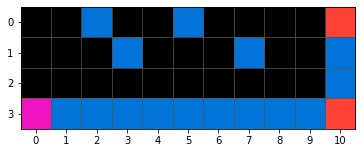

{0: 'blue', 1: 'red', 2: 'green'}


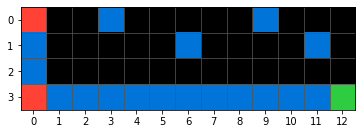

{0: 'blue', 1: 'pink', 2: 'red', 3: 'light blue'}


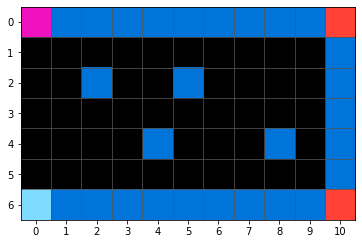

{0: 'blue', 1: 'red', 2: 'green'}


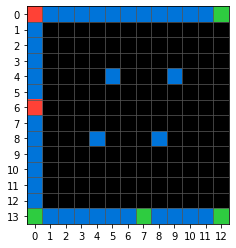

{0: 'blue', 1: 'light blue', 2: 'red', 3: 'green'}


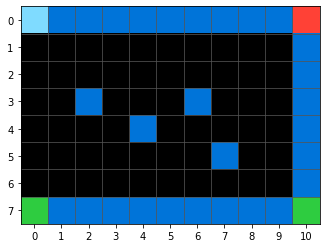

{0: 'blue', 1: 'green', 2: 'red'}


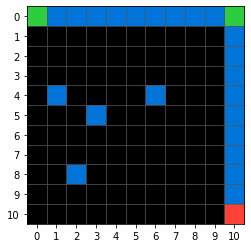

{0: 'blue', 1: 'green', 2: 'red', 3: 'light blue'}


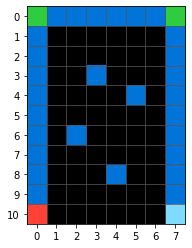

{0: 'blue', 1: 'green', 2: 'light blue'}


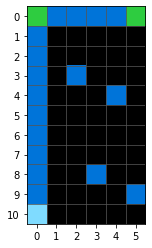

In [2386]:
for indices in obj.blobs:
    b = build_blob(task.inputs[0], indices, 1)
    plot_grid(b)
    print({k: idx_to_color[v] for k,v in b.cmap.items()})
    plt.show()

In [2329]:
def build_blob(x, indices, padding=0):
    if not isinstance(padding, (tuple, list)):
        padding = (padding, padding)
    hp, wp = padding
        
    b, h, w, d = get_dims(x)
    shape = indices.max(0) - indices.min(0) + 1
    h_min, w_min = indices.min(0)
    h_max, w_max = indices.max(0)
    
    if hp > 0 or wp > 0:
        padded_h = [
            (np.clip(h_min+i, 0, h-1), j)
            for i in range(0-hp, shape[0]+hp)
            for j in range(max(w_min-wp, 0), min(w_max+wp+1, w))
        ]
        padded_w = [
            (i, np.clip(w_min+j, 0, w-1))
            for j in range(0-wp, shape[1]+wp)
            for i in range(max(h_min-hp, 0), min(h_max+hp+1, h))
        ]
        indices = np.array(union(indices, padded_h, padded_w))
        shape = indices.max(0) - indices.min(0) + 1
    
    blob = Object(x[tuple(zip(*indices))], indices, shape)
    
    return blob

In [ ]:
f

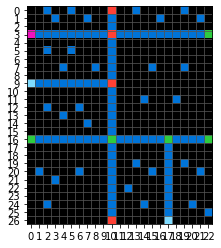

In [1993]:
plot_grid(task.inputs[0])

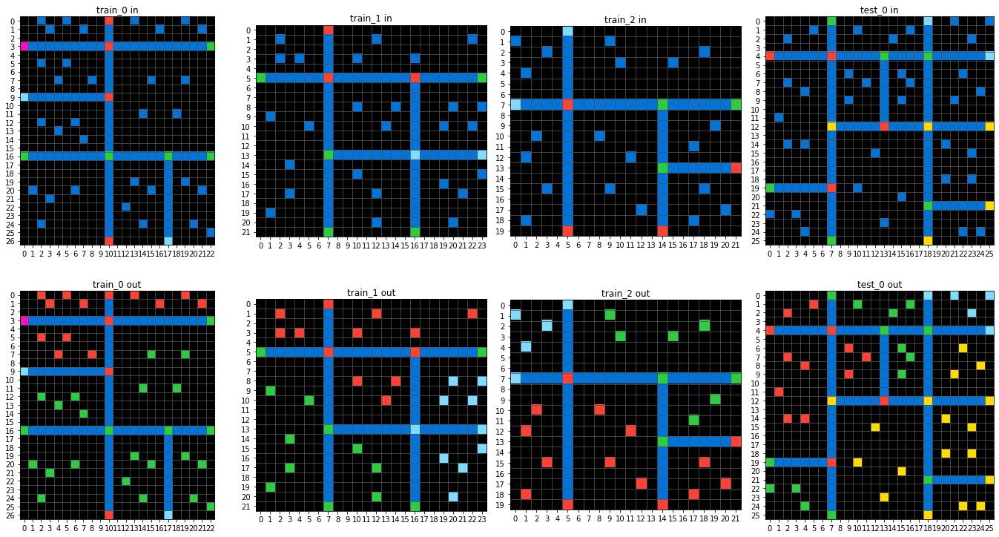

In [2179]:
task.plot()

<Figure size 432x432 with 0 Axes>

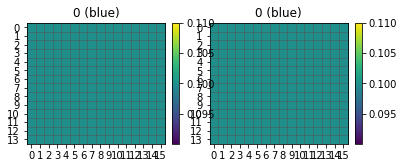

<Figure size 432x432 with 0 Axes>

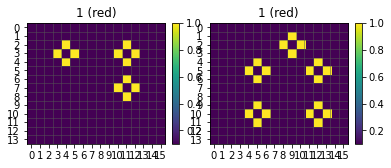

<Figure size 432x432 with 0 Axes>

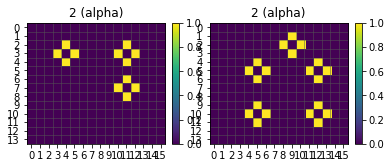

In [1605]:
b, h, w, d = get_dims(input_train)
idx = 0
a = pad_gradient(input_train[:1,...], 0)
b = pad_gradient(input_train[-1:,...], 0)
for i in range(a.shape[-1]):
    fig = plt.figure(figsize=(6,6))
    fig, ax = plt.subplots(1,2, figsize=(6,6))
    c = idx_to_color.get(cmaps[idx].get(i), 'alpha')
    
    ax1 = plot_gradient(a[0,...,i], ax[0]); 
    ax1.set_title(f"{i} ({c})")
    
    ax2 = plot_gradient(b[0,...,i], ax[1]); 
    ax2.set_title(f"{i} ({c})")
    plt.show()
    

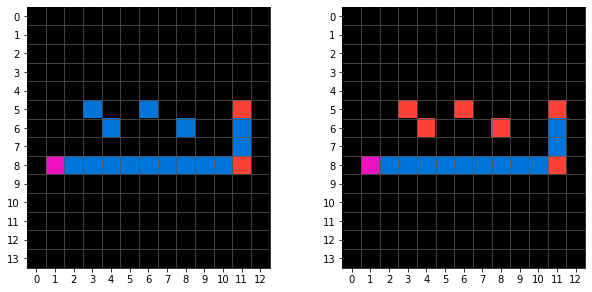

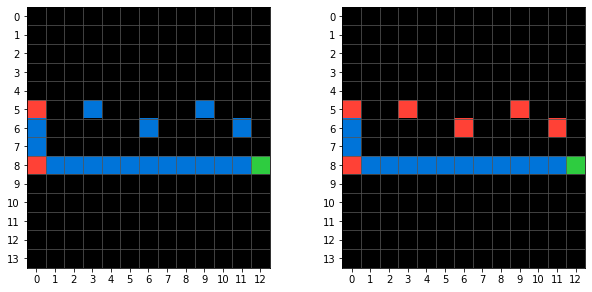

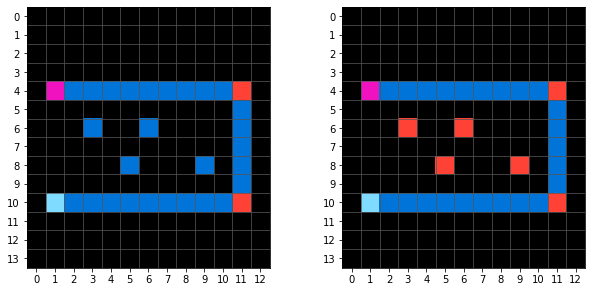

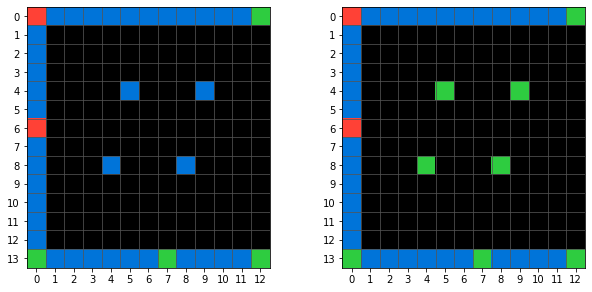

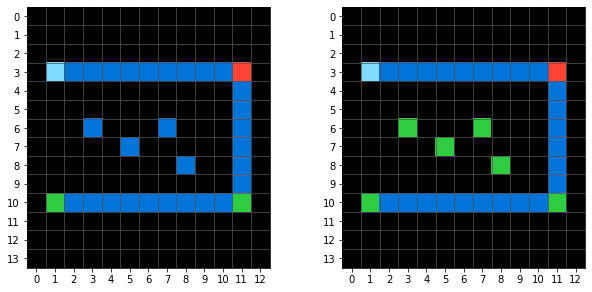

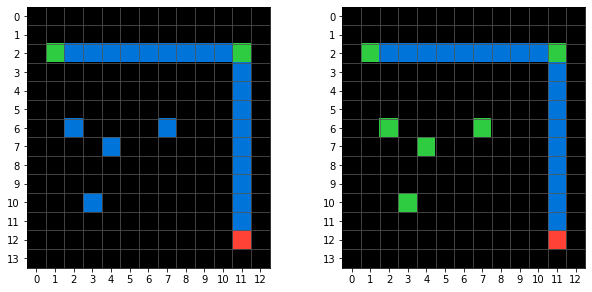

In [2548]:
b, h, w, d = get_dims(input_train)
fig_ratio = (w*2) / h

for i in range(input_train.shape[-1]):
    fig, ax = plt.subplots(1, 2, figsize=(10, 10/fig_ratio))
    plt.subplots_adjust(wspace=0.3, hspace=0.3)
    plot_grid(channel_to_grid(input_train[i], cmaps[i]), ax=ax[0])
    plot_grid(channel_to_grid(output_train[i], cmaps[i]), ax=ax[1])
    plt.show()

In [ ]:
`# class PostProcess:
    
#     def __init__(self):
#         pass
    
#     def fit(self, input_train, output_train):
        
#         for i in range(len(input_train)):
            

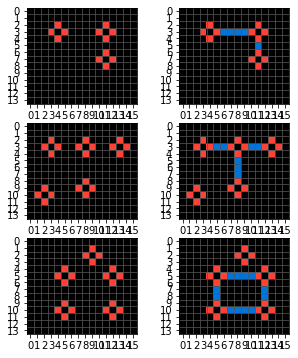

In [1551]:
b, h, w, d = get_dims(input_train)
fig = plt.figure(figsize=(int(h*2/5), int(w*2/5)))
gs = gridspec.GridSpec(b, 2, fig, wspace=0.2, hspace=0.2)

for i in range(len(input_train)):
    
    plot_grid(channel_to_grid(input_train[i], cmaps[i]), ax=plt.subplot(gs[i,0]))
    plot_grid(channel_to_grid(output_train[i], cmaps[i]), ax=plt.subplot(gs[i,1]))


In [929]:
# symbol_to_ch = {v: k for k,v in cmaps[0].items()}
# obj_filters = []
# obj_kernels = []

# for symbol in task.output_symbol_to_objects.keys():
#     for obj in task.output_symbol_to_objects[symbol]:
#         obj_filter = np.zeros((*obj.shape, input_train.shape[-1]), 
#                               dtype=np.float32)
#         obj_matrix = np.asarray(obj.numpy().astype(bool), dtype=np.float32)
#         obj_matrix = (obj_matrix / obj_matrix.sum())
#         ch = symbol_to_ch[int(symbol)]
#         obj_filter[:,:,ch] = obj_matrix
        
#         obj_filters.append(obj_filter[...,None])
#         obj_kernels.append(obj_matrix)

In [1647]:
num_input_channels = input_train.shape[-1]
num_channels = len(cmaps[0])

model = CAModel(num_channels=num_input_channels,)
initial_lr = 3e-4
optim = tf.keras.optimizers.Adam(initial_lr)

# adaptive hyperparameters and scheduler
dropout = AdapativeParam(start_value=.5, 
                         factor=.95,
                         update_f=log_scale,
                         mode='min', 
                         upper_bound=1.,
                         patience=10,
                         name='dropout')

step_size = AdapativeParam(start_value=1., 
                           factor=1,
                           mode='min',
                           lower_bound=.5,
                           patience=15,
                           name='step_size')

mask_th = AdapativeParam(start_value=0.3, 
                         factor=.95,
                         mode='min', 
                         update_f=log_scale,
                         upper_bound=.5,
                         patience=15,
                         name='mask_th')

obj_th = AdapativeParam(start_value=0.25, 
                        factor=.95,
                        update_f=log_scale,
                        upper_bound=.99,
                        patience=15,
                        name='obj_th')

sim_duration = AdapativeParam(start_value=16,
                              factor=1.1,
                              upper_bound=96,
                              patience=10,
                              reset=True,
                              update_f=duration_fn,
                              name='sim_duration')
update_params_lr = {
    'optim': optim,
    'min_lr': 1e-6,
}

lr = AdapativeParam(start_value=initial_lr, 
                    factor=.1,
                    lower_bound=update_params_lr['min_lr'],
                    patience=25,
                    update_f=decay_lr,
                    update_params=update_params_lr,
                    name='lr')

params = {
    'dropout': dropout, 
    'step_size': step_size, 
    'mask_th': mask_th,
    'lr': lr,
    'obj_th': obj_th
}
sched = Scheduler(params)

pool_size = 128
batch_size = 3
num_reset = 1
rank_loss_f = lambda y, x: mean_squared_error(y, get_pred(x, num_channels))
start_data = [input_train[:1], output_train[:1], output_shapes[:1], cmaps[:1]]
sampler = Sampler(start_data, pool_size,)

cleanup()
dt_str = datetime.datetime.now().strftime('%Y%m%d_%H-%M-%S')
ckpt_dir = os.path.join(LOG_DIR, f'{task.name}_{dt_str}')
if not os.path.exists(ckpt_dir):
    os.makedirs(ckpt_dir)

use_sampler = True
print(sched)

<Scheduler: 
	<AdapativeParam (dropout): 0.5>
	<AdapativeParam (step_size): 1.0>
	<AdapativeParam (mask_th): 0.3>
	<AdapativeParam (lr): 0.0003>
	<AdapativeParam (obj_th): 0.25>>


In [2542]:
@tf.function
def compute_apply_gradients(model, optim, x, y, sims=64, **kwargs):
    with tf.GradientTape(persistent=False) as g:
        for _ in tf.range(sims):
            x = model(x, **kwargs)
        loss = tf.reduce_mean(mean_squared_error(y, get_pred(x, y.shape[-1]-1)))

    # backprop
    gw = g.gradient(loss, model.weights)
    gw = [g/(tf.norm(g)+1e-8) for g in gw]
    optim.apply_gradients(zip(gw, model.weights))
    return x, loss

# x_start = tf.convert_to_tensor(input_train[(slice(1),Ellipsis,slice(ch,ch+1))].copy())
x_start = tf.convert_to_tensor(input_train[:1].copy())
x = x_start
y = tf.convert_to_tensor(output_train[:1].copy())
# y = tf.convert_to_tensor(output_train[(slice(1),Ellipsis,slice(ch,ch+1))].copy())
# x_val = tf.convert_to_tensor(input_train[(slice(1,2),Ellipsis,slice(ch,ch+1))].copy())
# y_val = tf.convert_to_tensor(output_train[(slice(1,2),Ellipsis,slice(ch,ch+1))].copy())
x_val = tf.convert_to_tensor(input_test.copy())
y_val = tf.convert_to_tensor(output_test.copy())
cmap = cmaps
shapes = output_shapes

val_cmap = cmaps[-1:]
val_shapes = cmaps[-1:]

input_states = []
output_states = []
losses = []
accs = []
dx = []
val_preds = []

best_loss = np.inf
best_acc = 0
best_loss_step = 0
best_acc_step = 0
val_acc = 0
best_val_acc = 0
best_val_step = 0

steps = 300
new_best = False
new_best_val = False

for _ in range(steps):
    step = optim.iterations.numpy()
    sims = tf.random.uniform([], 64, 96, tf.int32)
    
    # update inputs, outputs, and metadata when using sampler
    if use_sampler:
        batch = sampler.sample(batch_size)
        x, y, shapes, cmap = batch.get(rank_loss_f, num_reset)
        
    input_states.append(x)
    dx.append(model.perceive(x))
    x, loss = compute_apply_gradients(model, 
                                      optim,
                                      x,
                                      y, 
                                      sims=sims,
                                      dropout=sched['dropout'], 
                                      mask_th=sched['mask_th'], 
                                      step_size=sched['step_size'],
                                      obj_th=sched['obj_th'])

    acc = score_ca(y, 
                   get_pred(x, num_channels), 
                   cmap, 
                   mask_th=mask_th,
                   output_shapes=shapes)

    if loss < best_loss:
        best_loss = loss
        best_loss_step = step
        new_best = True
        save_model(model, os.path.join(ckpt_dir, f'{step:04d}_{loss}_{acc}'), sched)
    if acc > best_acc:
        best_acc = acc
        best_acc_step = step
        new_best = True
        save_model(model, os.path.join(ckpt_dir, f'{step:04d}_{loss}_{acc}'), sched)
        
    y_pred_val = generate_predictions(model, 
                                      x_val,
                                      cmaps[-1], 
                                       target=y_val,
                                       mask_th=mask_th.value, 
                                       step_size=tf.constant(1.),
                                       obj_th=sched['obj_th'],
                                       dropout=tf.constant(.8), 
                                       steps=tf.constant(80),
                                       return_best=True)
    val_acc = score_ca(y_val, 
                        get_pred(y_pred_val, num_channels), 
                        cmaps[-1],
                        mask_th=mask_th,
                        output_shapes=output_shapes[-1])
    
    if val_acc > best_val_acc:
        best_val_acc = val_acc
        best_val_step = step
        val_preds.append(y_pred_val)
        new_best_val = True
    
    print(f'step {step} - loss : {loss.numpy():.4f} - acc : {acc:.4f} '
          f' - best : {best_loss:.4f} ({best_loss_step}) '
          f' - {best_acc:.4f} ({best_acc_step}) '
          f' - {val_acc:.4f} ({best_val_acc:.4f}, {best_val_step})')
    
    if new_best:
        plot_grids(get_pred(x, num_channels), cmap, mask_th, 6)
        
    if new_best_val:
        plot_grids(get_pred(y_pred_val, num_channels), val_cmap, mask_th)
        
    sched(loss, step)
    
    output_states.append(x.numpy())
    losses.append(loss.numpy())
    accs.append(acc)
    
    if use_sampler:
        batch.update(list(zip(*[x, y, shapes, cmap])))
    else:
        x = x_start
    
    new_best = False
    new_best_val = False

IndexError: list index out of range

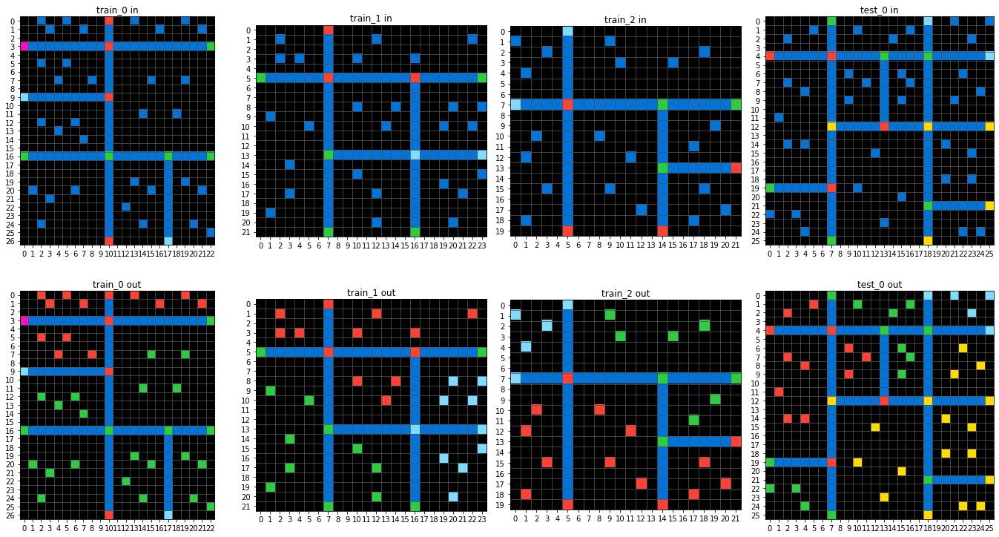

In [2543]:
task.plot()

In [1650]:
score_ca(y_val, model(x_val), val_cmap, output_shapes=val_shapes)

1.0

In [1618]:
batch = sampler.sample(3)

In [1619]:
tmp = batch.get()

In [1640]:
score_ca(tmp[0][:1],tmp[1][:1], tmp[3][0], mask_th=.3)

0.8125

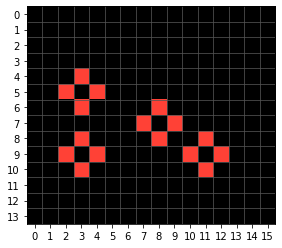

In [1666]:
plot_grid(channel_to_grid(model(x_val, dropout=1., mask_th=.000001)[0], val_cmap[0], mask_th=.01))

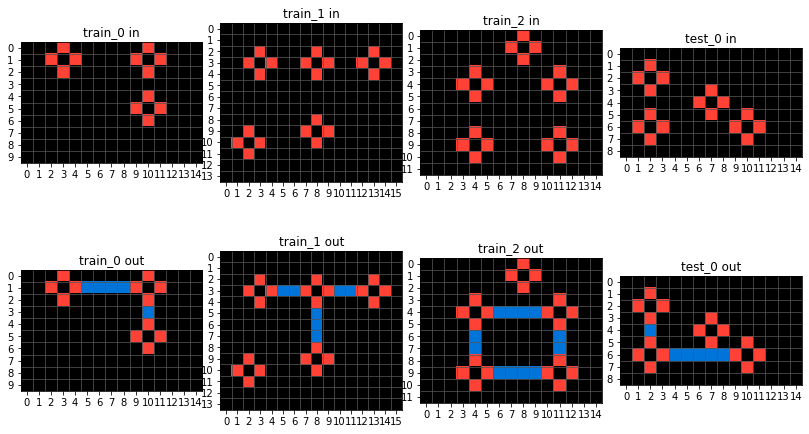

In [1667]:
task.plot()

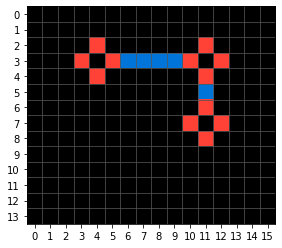

In [1646]:
plot_grid(channel_to_grid(tmp[0][0], tmp[3][0], mask_th=.4))

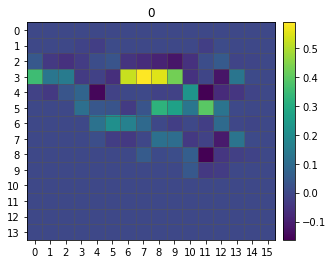

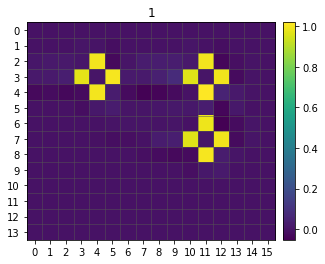

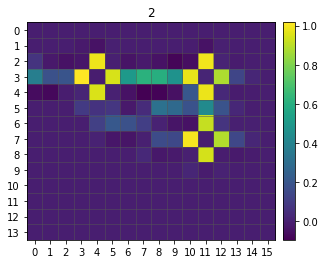

In [1624]:
for i in range(3):
    ax = plot_gradient(tmp[0][0,...,i])
    ax.set_title(i)
    plt.show()

In [1571]:
y.shape

TensorShape([3, 14, 16, 3])

In [1575]:
score_ca(y, x_start, cmaps=cmaps, mask_th=mask_th, output_shapes=output_shapes[:-1])

0.9562500000000002

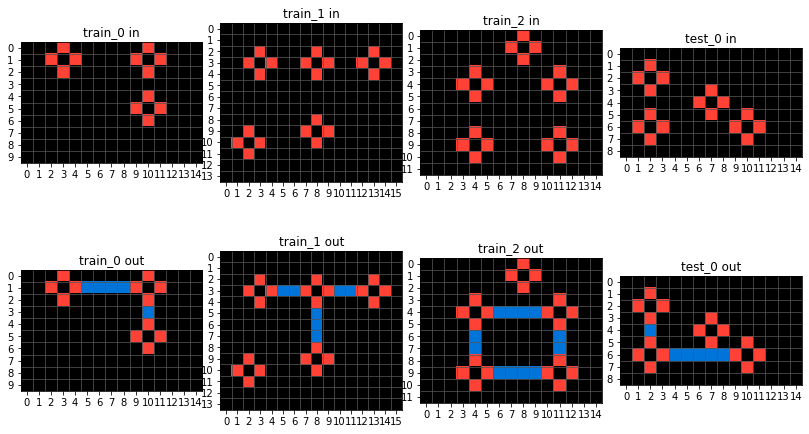

In [1554]:
task.plot()

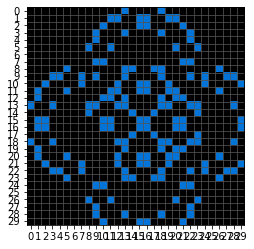

In [1504]:
plot_grid(x_start[0,...,0].numpy())

In [1506]:
np.where(target - target.T != 0)

(array([], dtype=int64), array([], dtype=int64))

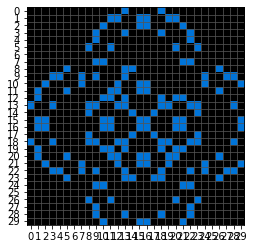

In [1496]:
plot_grid(x_start[0,...,0].numpy().T)

In [1482]:
target = y[0,...,0].numpy()
_x = target[8:24, 8:24]
_z = target[15:20, 1:6]

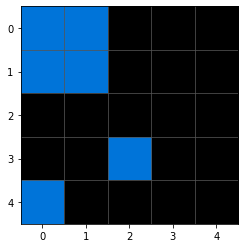

In [1483]:
plot_grid(_z)

In [1513]:
idx = np.where(task.outputs[0] == 9)

In [1530]:
tmp = np.arange(30*30).reshape(30,30)
np.where(tmp.T == 333)

(array([3]), array([11]))

In [1532]:
tmp[11,3]

333

In [1533]:
[x[3,11] == x[11,3] for x in task.outputs]

[True, True, True, True, True]

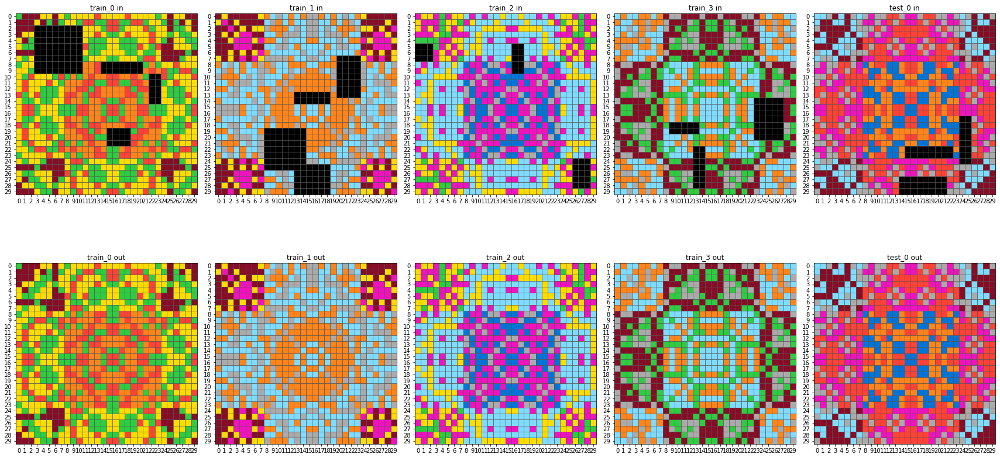

In [1515]:
task.plot()

In [1514]:
task.outputs[1][idx]

array([4, 9, 9, 9, 9, 9, 9, 4, 6, 9, 9, 9, 9, 9, 9, 9, 9, 6, 4, 4, 6, 9,
       9, 4, 4, 9, 9, 9, 9, 9, 9, 4, 4, 9, 4, 6, 6, 4, 9, 4, 4, 9, 6, 4,
       4, 6, 9, 9, 6, 4, 4, 6, 9, 9, 9, 4, 4, 9, 4, 6, 6, 4, 9, 4, 4, 9,
       9, 9, 9, 9, 4, 4, 9, 9, 9, 6, 4, 4, 6])

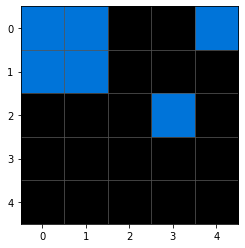

In [1489]:
plot_grid(_z.T)

In [1487]:
sum(_z - transpose(_z)).sum()

0.0

In [1462]:
tmp = (np.random.uniform(size=(10,10)) > .5).astype(np.float32)

In [1473]:
np.sum(tmp - transpose(tmp), axis=0)

array([-2.,  0.,  3.,  1.,  1.,  0., -3.,  0.,  2., -2.], dtype=float32)

In [1470]:
(tmp - transpose(tmp)).sum()

0.0

In [1469]:
sum(_z - transpose(_z)).sum()

0.0

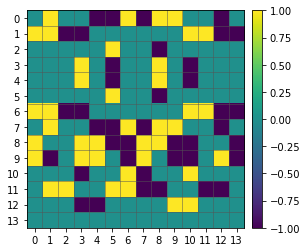

In [1453]:
plot_gradient(_z - rot90(_z))

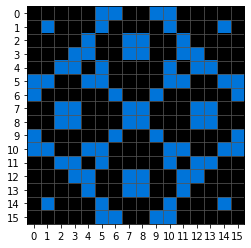

In [1447]:
plot_grid(_x)

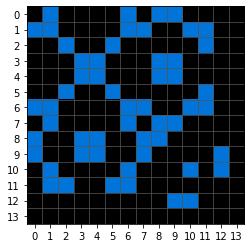

In [1374]:
plot_grid(_z)

In [1369]:
_y = _x.copy()
_y[8:11, 12:] = 3

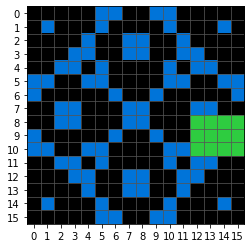

In [1370]:
plot_grid(_y)

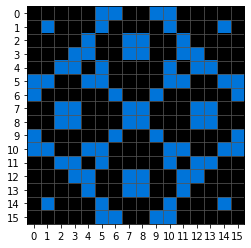

In [1250]:
plot_grid(_x)

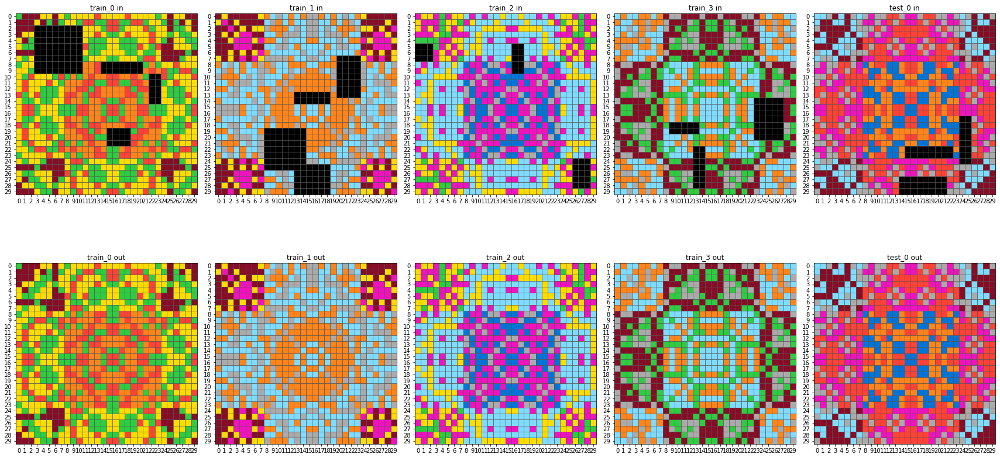

In [1363]:
task.plot()

In [1280]:
objs = get_objects(_x)

In [1254]:
objs[0]

<Object: shape=(2, 2), dtype=uint8, numpy=
array([[1, 1],
       [1, 0]], dtype=uint8)>

In [1301]:
obj1,obj2,obj3,obj4 = objs[4], objs[6], objs[22], objs[23]

In [1294]:
obj1,obj2,obj3,obj4 = objs[0], objs[1], objs[7], objs[8]

In [1297]:
a,b = obj1.data, obj3.data

In [1329]:
sum(c - transpose(c))

array([-3.,  0.,  0.,  3.], dtype=float32)

In [1335]:
c

array([[1., 1., 1., 1.],
       [0., 0., 0., 1.],
       [0., 0., 0., 1.],
       [0., 0., 0., 1.]], dtype=float32)

In [1336]:
flip_x(c)

array([[1., 1., 1., 1.],
       [1., 0., 0., 0.],
       [1., 0., 0., 0.],
       [1., 0., 0., 0.]], dtype=float32)

In [1337]:
flip_y(c)

array([[0., 0., 0., 1.],
       [0., 0., 0., 1.],
       [0., 0., 0., 1.],
       [1., 1., 1., 1.]], dtype=float32)

In [1339]:
sum(c - flip_x(c))

array([-3.,  0.,  0.,  3.], dtype=float32)

In [1334]:
transpose(c)

array([[1, 0, 0, 0],
       [1, 0, 0, 0],
       [1, 0, 0, 0],
       [1, 1, 1, 1]], dtype=uint8)

In [1343]:
sum(c - flip_y(c))

array([0., 0., 0., 0.], dtype=float32)

In [1332]:
rot90(c)

array([[0., 0., 0., 1.],
       [0., 0., 0., 1.],
       [0., 0., 0., 1.],
       [1., 1., 1., 1.]], dtype=float32)

In [1330]:
c - flip_x(c)

array([[ 0.,  0.,  0.,  0.],
       [-1.,  0.,  0.,  1.],
       [-1.,  0.,  0.,  1.],
       [-1.,  0.,  0.,  1.]], dtype=float32)

In [1327]:
np.sum(c - transpose(c))

0.0

In [1347]:
a - transpose(a)

array([[0., 0.],
       [0., 0.]], dtype=float32)

In [1348]:

c - transpose(c)

array([[ 0.,  1.,  1.,  1.],
       [-1.,  0.,  0.,  1.],
       [-1.,  0.,  0.,  1.],
       [-1., -1., -1.,  0.]], dtype=float32)

In [1361]:
sum(c3 - rot90(c3)), sum(c - rot90(c)), sum(a - transpose(a))

(array([0., 0., 0.], dtype=float32),
 array([0., 0., 0., 0.], dtype=float32),
 array([0., 0.], dtype=float32))

In [1362]:
c3 = np.array([
    [0,1,0],
    [1,1,1],
    [0,1,0]
], np.float32)
c = np.array([
    [1,1,1,1],
    [0,0,0,1],
    [0,0,0,1],
    [0,0,0,1]
], np.float32)

d = np.array([
    [1,1,1,1,1],
    [1,0,1,0,1],
    [0,0,1,0,1],
    [0,0,1,0,0],
    [0,0,0,0,0]
], np.float32)

dd = np.array([
    [1,1,1,1,1],
    [1,0,1,0,1],
    [0,0,1,0,0],
    [0,0,1,0,0],
    [0,0,0,0,0]
], np.float32)

In [1323]:
np.sum(d - rot90(dd))

1.0

In [1310]:
np.sum(c - flip_y(c))

0.0

In [1305]:
sum(c - c.T)

array([-3.,  0.,  3.,  0.], dtype=float32)

In [1291]:
a-c

array([[-1., -1.,  0.],
       [ 0.,  1.,  0.],
       [ 1.,  1., -1.]], dtype=float32)

In [1302]:
obj1,obj2,obj3,obj4

(<Object: shape=(3, 3), dtype=uint8, numpy=
 array([[0, 0, 1],
        [0, 1, 1],
        [1, 1, 0]], dtype=uint8)>,
 <Object: shape=(3, 3), dtype=uint8, numpy=
 array([[1, 0, 0],
        [1, 1, 0],
        [0, 1, 1]], dtype=uint8)>,
 <Object: shape=(3, 3), dtype=uint8, numpy=
 array([[1, 1, 0],
        [0, 1, 1],
        [0, 0, 1]], dtype=uint8)>,
 <Object: shape=(3, 3), dtype=uint8, numpy=
 array([[0, 1, 1],
        [1, 1, 0],
        [1, 0, 0]], dtype=uint8)>)

In [1298]:
a-b

array([[ 1.,  0.],
       [ 0., -1.]], dtype=float32)

In [1288]:
a,b

(array([[0., 0., 1.],
        [0., 1., 1.],
        [1., 1., 0.]], dtype=float32),
 array([[1., 0., 0.],
        [1., 1., 0.],
        [0., 1., 1.]], dtype=float32))

0


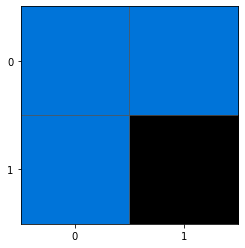

1


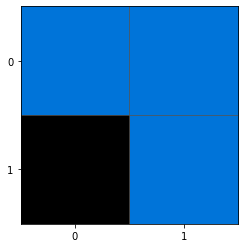

2


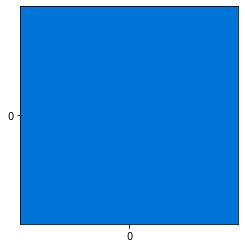

3


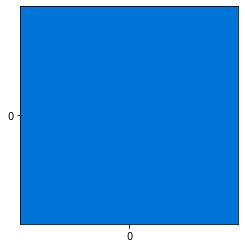

4


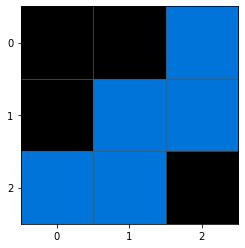

5


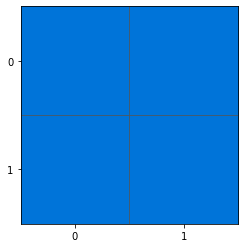

6


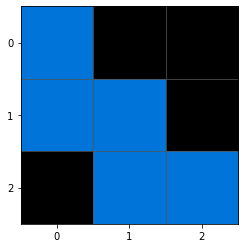

7


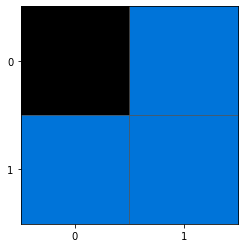

8


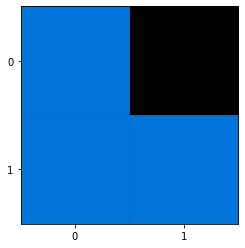

9


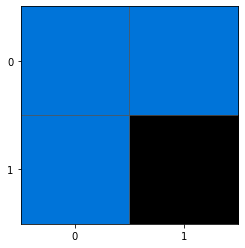

10


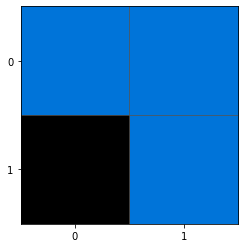

11


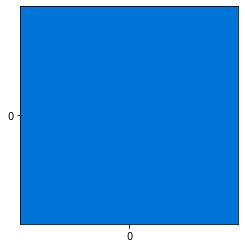

12


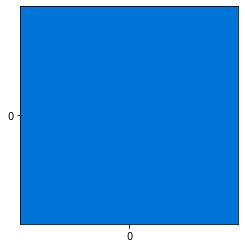

13


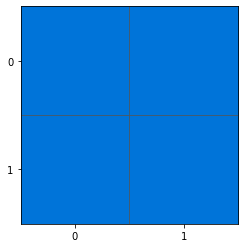

14


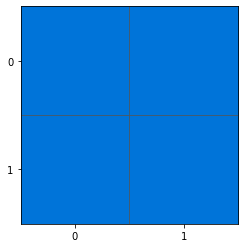

15


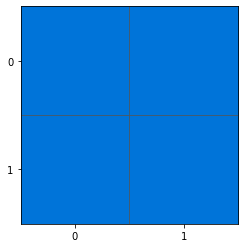

16


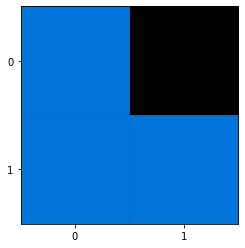

17


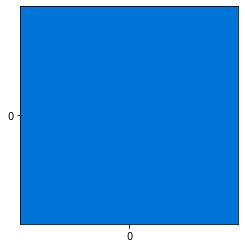

18


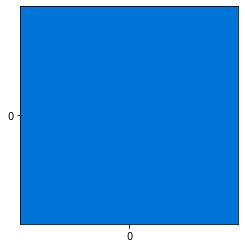

19


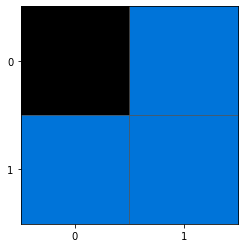

20


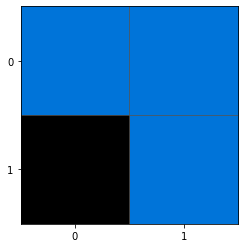

21


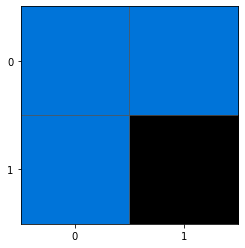

22


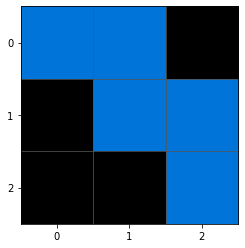

23


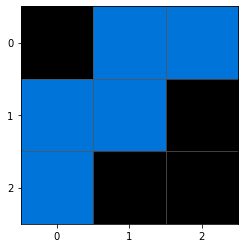

24


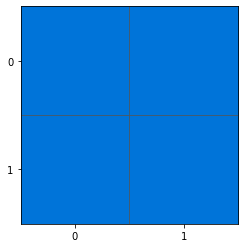

25


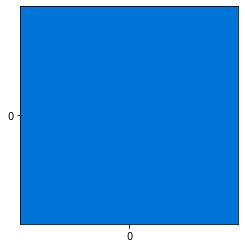

26


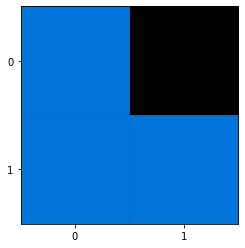

27


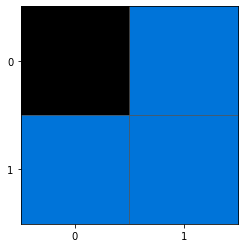

28


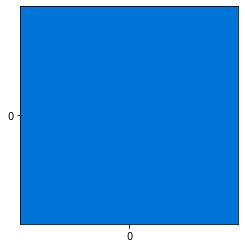

In [1265]:
for i, obj in enumerate(objs):
    print(i)
    obj.plot()
    plt.show()

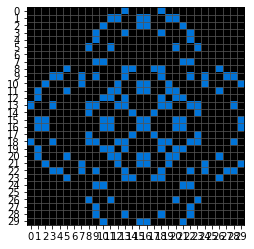

In [1243]:
plot_grid(target)

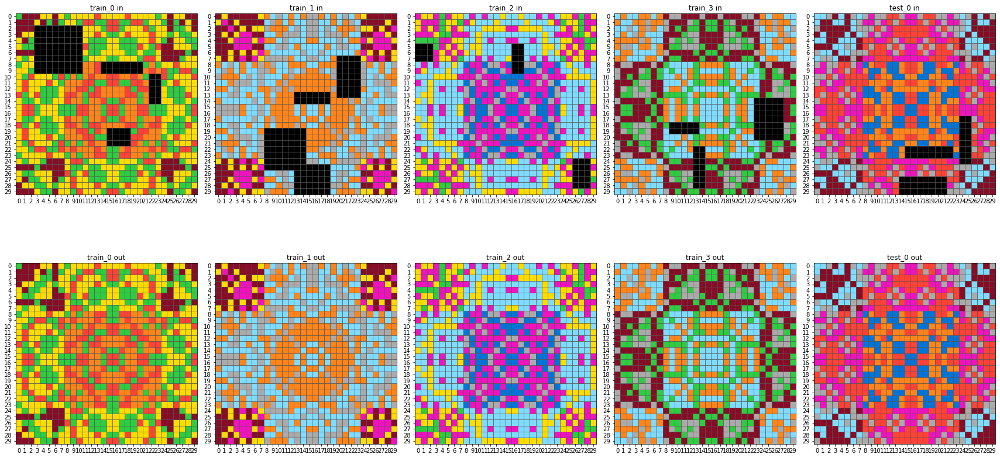

In [1234]:
task.plot()

In [ ]:
def compute_meta_gradients(model, optim, x, y, cmap, sims=64, mask_th=.1, **kwargs):
    losses = []
    accs = []
    with tf.GradientTape(persistent=False) as g:
        for _ in tf.range(sims):
            x = model(x, **kwargs)
            loss = tf.reduce_mean(mean_squared_error(y, get_pred(x, y.shape[-1]-1)))
            losses.append(loss)
            accs.append(score_ca(y, get_pred(x, len(cmap)), cmap, mask_th=mask_th))
        

    # backprop
    gw = g.gradient(loss, model.weights)
    gw = [g/(tf.norm(g)+1e-8) for g in gw]
    optim.apply_gradients(zip(gw, model.weights))
    return x, losses, accs

In [1190]:
score_ca(y_val, x_val,cmaps[0],mask_th=.99)

0.9911111111111112

In [1188]:
score_ca(y_val, np.array(x_val.numpy() > .99, np.float32))

0.9911111111111112

In [1181]:
x_val

<tf.Tensor: shape=(1, 30, 30, 1), dtype=float32, numpy=
array([[[[ 1.59143987e-08],
         [ 1.77211490e-07],
         [ 3.20647678e-06],
         [ 4.97995970e-05],
         [ 6.37417426e-04],
         [ 6.51052827e-03],
         [ 5.02178483e-02],
         [ 2.65440583e-01],
         [ 3.46176118e-01],
         [ 1.00000000e+00],
         [ 2.09776983e-01],
         [ 1.00000000e+00],
         [ 2.08131507e-01],
         [ 1.00000000e+00],
         [-1.07664913e-02],
         [ 5.75285219e-02],
         [ 3.12291771e-01],
         [ 5.96754551e-01],
         [ 1.00000000e+00],
         [ 2.05248103e-01],
         [ 1.00000000e+00],
         [-3.27072106e-02],
         [ 1.00000000e+00],
         [-2.13530771e-02],
         [-1.82683878e-02],
         [ 2.71957787e-03],
         [-2.14808548e-04],
         [ 1.17403988e-05],
         [-4.90583432e-07],
         [ 1.66795449e-08]],

        [[ 1.89069212e-07],
         [ 2.89330387e-07],
         [ 2.90895878e-06],
         [ 4.55534

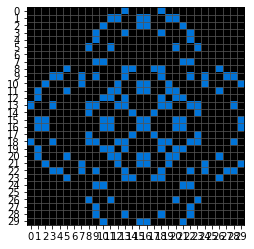

In [1144]:
plot_grid(y[0,...,0])

In [1142]:
np.repeat(x,2, -1).shape

(1, 30, 30, 2)

In [76]:
hist = sched.get_history()

In [80]:
hist[194]

{'loss': <tf.Tensor: shape=(), dtype=float32, numpy=0.022809297>,
 'params': {'dropout': 0.5686030528382462,
  'step_size': 1.0,
  'mask_th': 0.2,
  'lr': 0.0003,
  'obj_th': 0.25}}

In [1422]:
# step = 194
# m_best = load_model(ckpt_dir, step, model.num_channels, object_filters=obj_filters)

idx = 0
preds = generate_predictions(model, 
                             x,
#                              input_train[idx:idx+1],
                             cmaps[idx], 
#                              target=output_train[idx:idx+1],
                             y,
                             steps=200,
                             step_size=1,
                             dropout=.6,
                             mask_th=.05,
                             obj_th=.25,
                             verbose=True)

step 0 - loss : 0.0076 - acc : 0.9856
step 1 - loss : 0.0076 - acc : 0.9856
step 2 - loss : 0.0076 - acc : 0.9856
step 3 - loss : 0.0076 - acc : 0.9856
step 4 - loss : 0.0076 - acc : 0.9856
step 5 - loss : 0.0076 - acc : 0.9856
step 6 - loss : 0.0076 - acc : 0.9856
step 7 - loss : 0.0076 - acc : 0.9856
step 8 - loss : 0.0076 - acc : 0.9856
step 9 - loss : 0.0076 - acc : 0.9856
step 10 - loss : 0.0076 - acc : 0.9856
step 11 - loss : 0.0076 - acc : 0.9856
step 12 - loss : 0.0076 - acc : 0.9856
step 13 - loss : 0.0076 - acc : 0.9856
step 14 - loss : 0.0076 - acc : 0.9844
step 15 - loss : 0.0076 - acc : 0.9833
step 16 - loss : 0.0076 - acc : 0.9833
step 17 - loss : 0.0076 - acc : 0.9822
step 18 - loss : 0.0076 - acc : 0.9811
step 19 - loss : 0.0076 - acc : 0.9800
step 20 - loss : 0.0076 - acc : 0.9800
step 21 - loss : 0.0076 - acc : 0.9778
step 22 - loss : 0.0076 - acc : 0.9767
step 23 - loss : 0.0076 - acc : 0.9744
step 24 - loss : 0.0077 - acc : 0.9722
step 25 - loss : 0.0076 - acc : 0.9

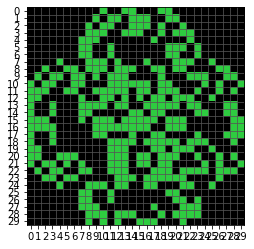

In [1419]:
plot_grid(channel_to_grid(preds[100][0], cmaps[0], .01))

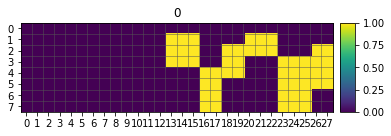

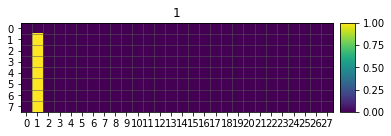

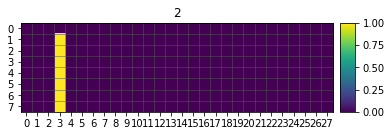

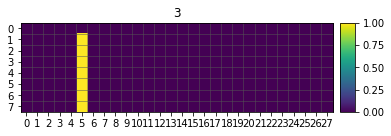

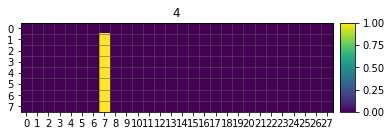

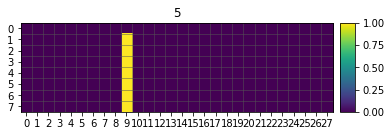

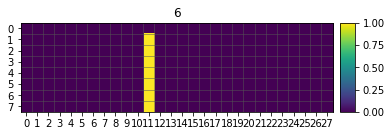

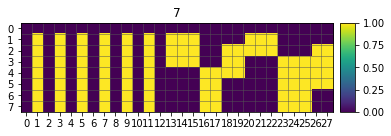

In [441]:
for i in range(8):
    ax = plot_gradient(x_test[0,...,i])
    ax.set_title(i)
    plt.show()

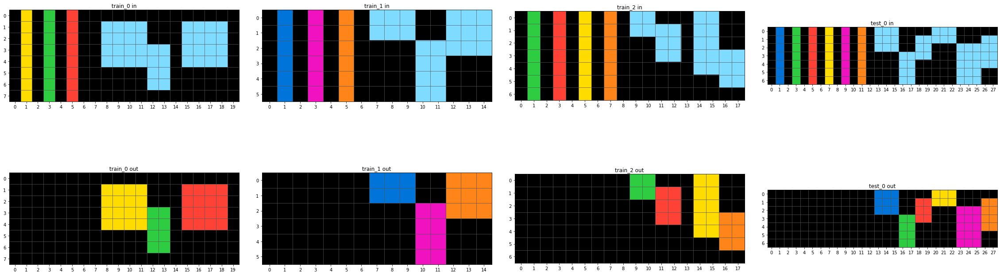

In [432]:
task.plot()

In [626]:
x_swap = np.array(x)
n = 3
b, h, w, d = get_dims(x_swap)

indices = np.array(list(zip(*np.where(x_swap != 0))))
swap_idx = np.random.choice(range(len(indices)), n+1, replace=False)
swap_indices = indices[swap_idx]
swap_indices_zip = tuple(zip(*swap_indices))
values = x_swap[swap_indices_zip]
new_values = [values[i+1] if i < n else values[0] for i in range(n+1)]
x_swap[swap_indices_zip] = new_values

return x_swap
# h_swap = np.random.choice(range(h), n+1)
# w_swap = np.random.choice(range(w), n+1)

# values = x[h_swap, w_swap]

In [ ]:
def swap_cells(x, n=1, background_color=0):
    x_swap = np.array(x)
    b, h, w, d = get_dims(x_swap)

    indices = np.array(list(zip(*np.where(x_swap != background_color))))
    swap_idx = np.random.choice(range(len(indices)), n+1, replace=False)
    swap_indices = indices[swap_idx]
    swap_indices_zip = tuple(zip(*swap_indices))
    
    values = x_swap[swap_indices_zip]
    new_values = [values[i+1] if i < n else values[0] for i in range(n+1)]
    x_swap[swap_indices_zip] = new_values

    return x_swap


def offset_object(x):
    pass

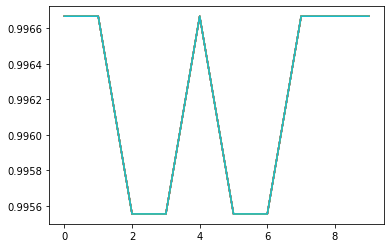

In [1012]:
fig = plt.figure()
_a = accs[-10:]
for i in range(len(_a)):
    plt.plot(_a, label=i)
# plt.legend()

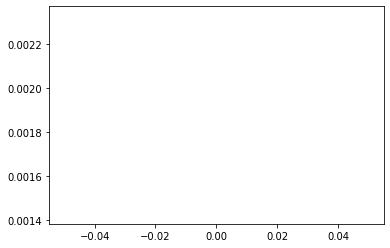

In [1008]:
fig = plt.figure()
_l = losses[-100:]
for i in range(len(_l)):
    plt.plot(_l[i], label=i)
# plt.legend()

In [1191]:
def generate_metadata(x, y, cmap, steps=64, shapes=None, verbose=1, **kwargs):
    dropout = kwargs.get('dropout', .5)
    mask_th = kwargs.get('mask_th', .1)
    step_size = kwargs.get('step_size', 1.)
    
    metadata = {
        'accs': [],
        'losses': [],
        'inputs': [],
        'outputs': [],
        'perceptions': [],
        'grads_x': []
    }
    
    x = tf.convert_to_tensor(x)
    for step in range(steps):
        metadata['inputs'].append(x.numpy())
        metadata['perceptions'].append(model.perceive(x).numpy())

        with tf.GradientTape() as g:
            x = model(x, 
                      dropout=dropout,
                      step_size=step_size, 
                      mask_th=mask_th)
            loss = tf.reduce_mean(
                mean_squared_error(y, get_pred(x, len(cmap)))
            )
        
        metadata['grads_x'].append(g.gradient(loss, x).numpy())
        metadata['losses'].append(loss.numpy())
        metadata['accs'].append(score_ca(y, 
                                         get_pred(x, len(cmap)), 
                                         cmap, 
                                         mask_th=mask_th,
                                         output_shapes=shapes))
        metadata['outputs'].append(x.numpy())

        if verbose is not None:
            print(f"step {step} - loss : {metadata['losses'][step]:.4f} - "
                  f"acc : {metadata['accs'][step]:.4f}")
    return metadata

In [ ]:
score_

In [1195]:

cmap = cmaps[0]
shape = output_shapes[-1]
steps = 150
metadata = generate_metadata(x_start, 
                             y, 
                             cmap,
                             shapes=shape,
                             steps=steps,
                             **sched.params)

step 0 - loss : 0.0389 - acc : 0.5944
step 1 - loss : 0.0375 - acc : 0.5944
step 2 - loss : 0.0362 - acc : 0.5956
step 3 - loss : 0.0350 - acc : 0.5956
step 4 - loss : 0.0339 - acc : 0.5956
step 5 - loss : 0.0328 - acc : 0.5967
step 6 - loss : 0.0317 - acc : 0.5967
step 7 - loss : 0.0307 - acc : 0.5978
step 8 - loss : 0.0298 - acc : 0.5978
step 9 - loss : 0.0289 - acc : 0.5989
step 10 - loss : 0.0280 - acc : 0.6000
step 11 - loss : 0.0272 - acc : 0.6011
step 12 - loss : 0.0265 - acc : 0.6033
step 13 - loss : 0.0257 - acc : 0.6056
step 14 - loss : 0.0249 - acc : 0.6056
step 15 - loss : 0.0242 - acc : 0.6067
step 16 - loss : 0.0235 - acc : 0.6078
step 17 - loss : 0.0229 - acc : 0.6078
step 18 - loss : 0.0223 - acc : 0.6078
step 19 - loss : 0.0217 - acc : 0.6078
step 20 - loss : 0.0211 - acc : 0.6078
step 21 - loss : 0.0206 - acc : 0.6089
step 22 - loss : 0.0200 - acc : 0.6111
step 23 - loss : 0.0195 - acc : 0.6111
step 24 - loss : 0.0189 - acc : 0.6156
step 25 - loss : 0.0184 - acc : 0.6

In [1225]:
def plot_metadata(metadata, cmap, steps=None, example_idx=0):
    if steps is None:
        steps = range(len(metadata['inputs']))
    elif isinstance(steps, int):
        steps = [steps]
        
    num_channels = len(cmap)
    num_channels = 1
    num_extra_channels = metadata['inputs'][0].shape[-1] - len(cmap)

    dx_ch = list(range(num_extra_channels, num_extra_channels + num_channels))
    dy_ch = list(range(num_extra_channels * 2, num_extra_channels * 2 + num_channels))
    dx_ch, dy_ch = [1], [2]

    num_plots = 4 + num_channels * 2
    num_cols = 3 # num_channels
    num_rows = int(np.ceil(num_plots / num_cols))

    color_map = {k: idx_to_color[v] for k,v in cmap.items()}

    for step in steps:
        print(f"step {step}\n{'-'*80}")
        
        inp = metadata['inputs'][step][example_idx]
        out = metadata['outputs'][step][example_idx]
        grads_x = metadata['grads_x'][step][example_idx]
        perceptions = metadata['perceptions'][step][example_idx]

        fig, ax = plt.subplots(num_rows, num_cols, figsize=(20,12))
        plt.subplots_adjust(wspace=0.3, hspace=0.3)
        plot_grid(channel_to_grid(inp, mask_th=mask_th, cmap=cmap), 
                  output_shape, 
                  ax=ax[0][0],
                  title='input')
        plot_grid(channel_to_grid(out, mask_th=mask_th, cmap=cmap), 
                  output_shape, 
                  ax=ax[0][1], 
                  title='output')

        ax_a = plot_gradient(out[...,-1], ax[0][2], True)
        ax_a.set_title('alpha', size=12)

        ax_g = plot_gradient(grads_x.sum(axis=-1), ax[1][-1], True)
        ax_g.set_title('grad_x', size=12)

        for i in range(num_channels):
            ax_dx = plot_gradient(perceptions[..., dx_ch[i]], ax[1][i])
            ax_dx.set_title(f'dx_{color_map[i]}')
            ax_dy = plot_gradient(perceptions[..., dy_ch[i]], ax[1][i+1])
            ax_dy.set_title(f'dy_{color_map[i]}')
    
#         for i in range(num_channels):
#             ax_dx = plot_gradient(perceptions[...,tuple(np.arange(i, 24, 6))].sum(-1), ax[1][i])
#             ax_dx.set_title(f'obj_{color_map[i]}')

        plt.show();

step 0
--------------------------------------------------------------------------------


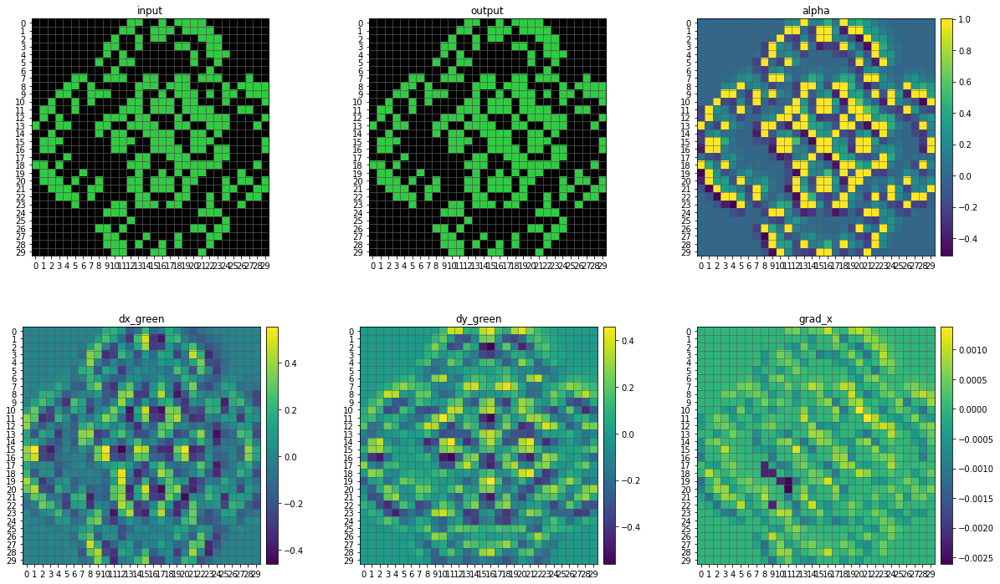

step 1
--------------------------------------------------------------------------------


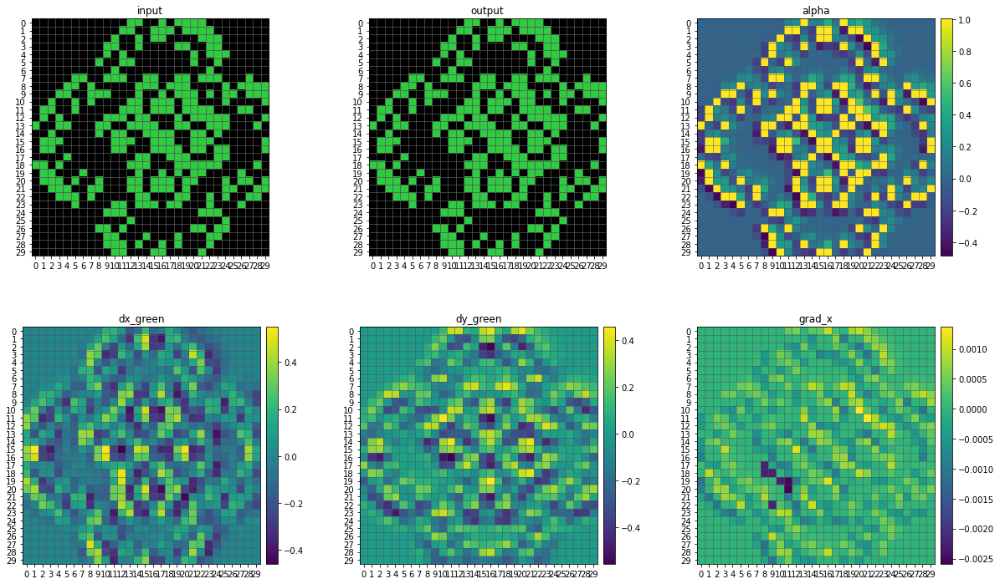

step 2
--------------------------------------------------------------------------------


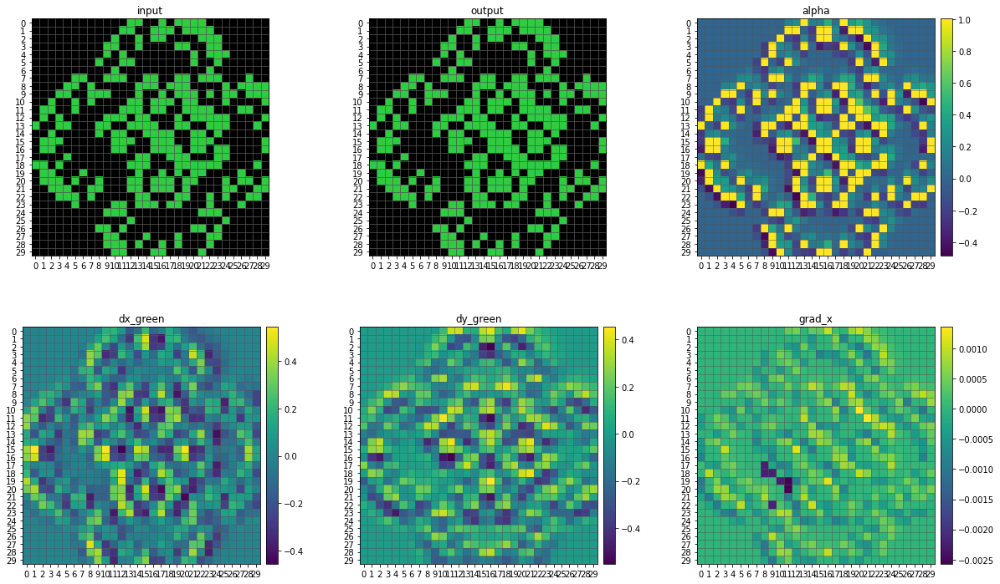

step 3
--------------------------------------------------------------------------------


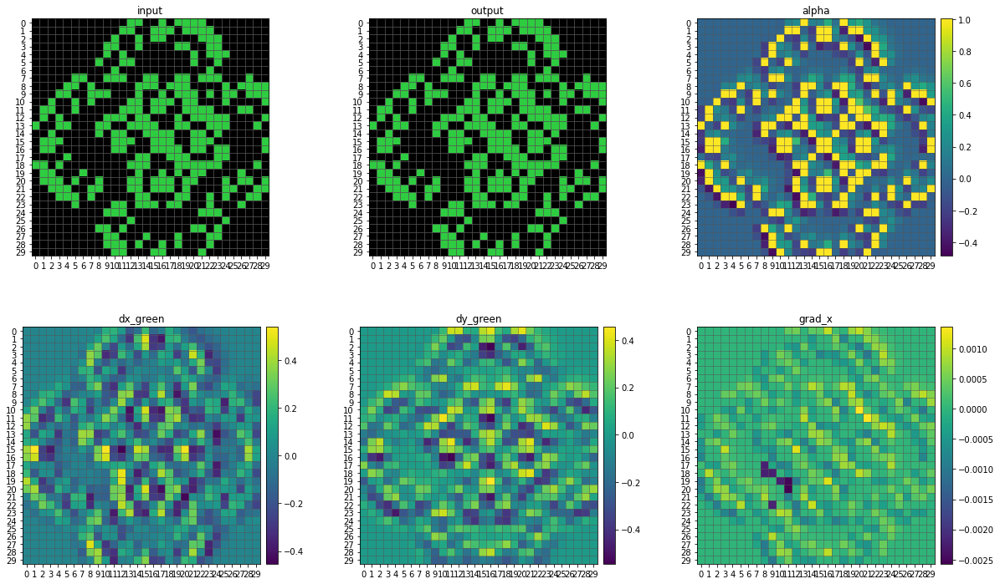

step 4
--------------------------------------------------------------------------------


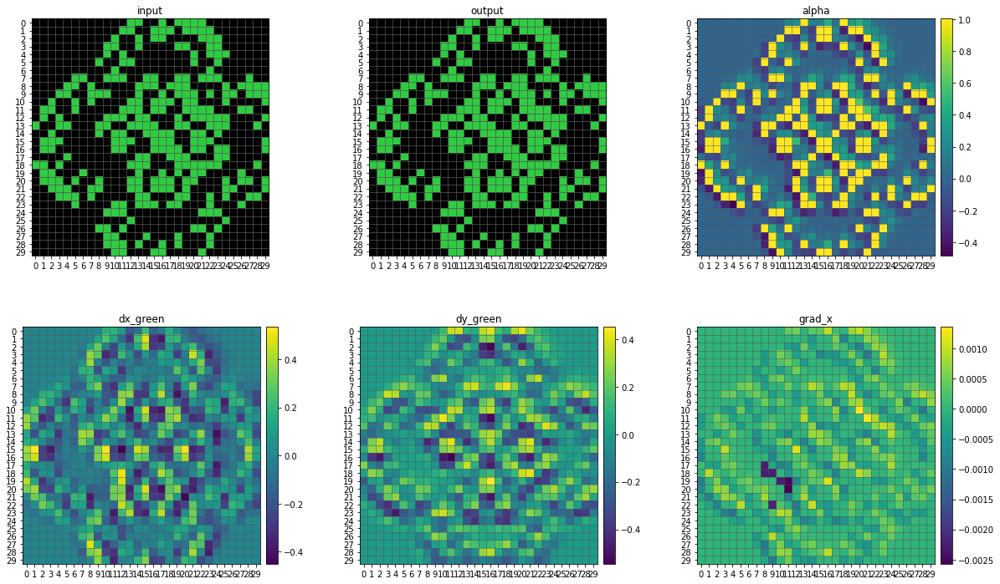

step 5
--------------------------------------------------------------------------------


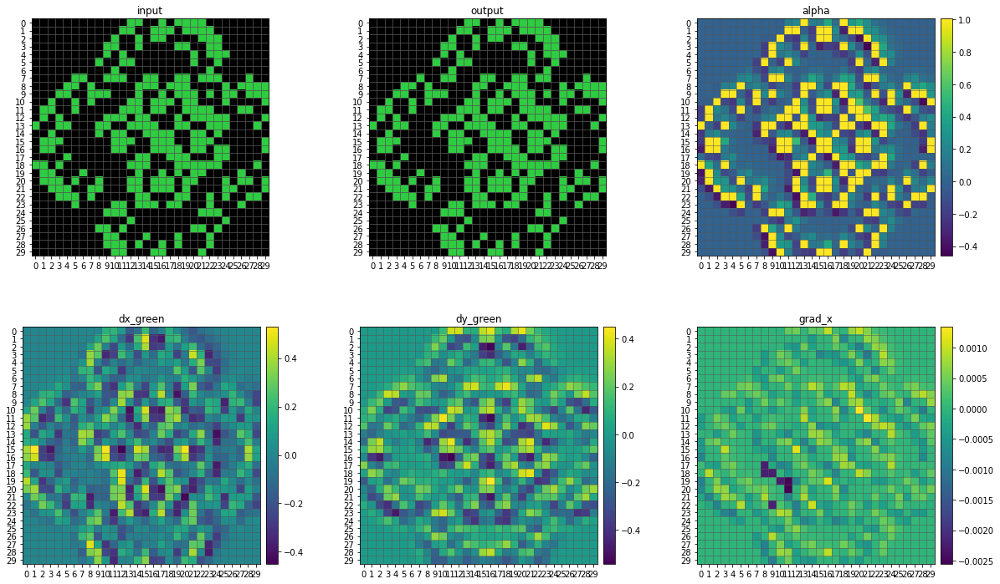

step 6
--------------------------------------------------------------------------------


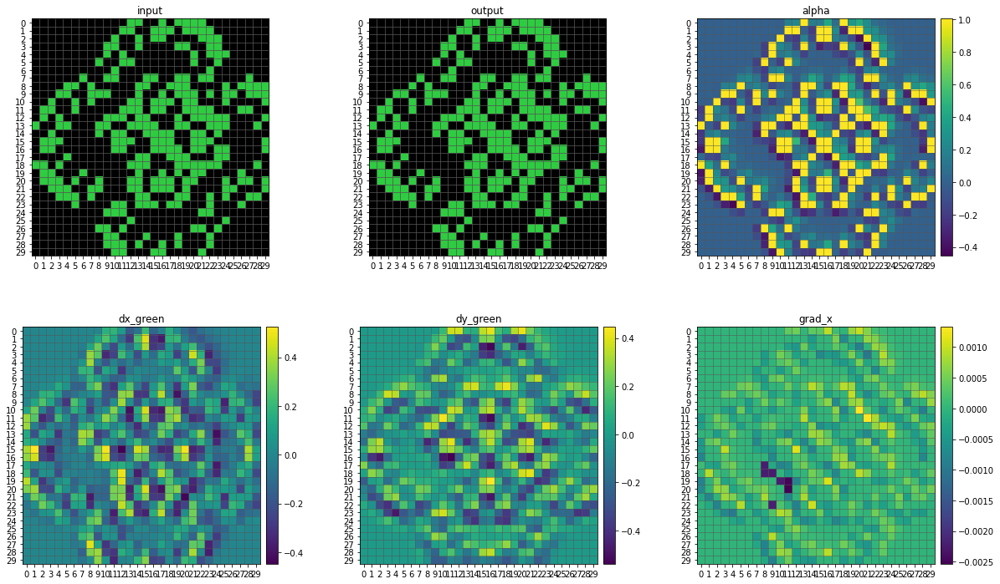

step 7
--------------------------------------------------------------------------------


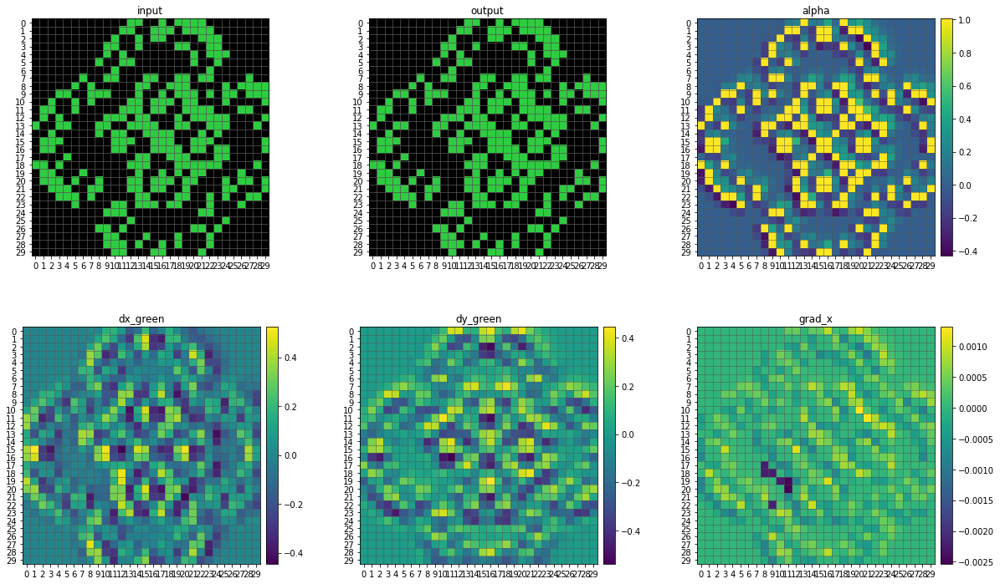

step 8
--------------------------------------------------------------------------------


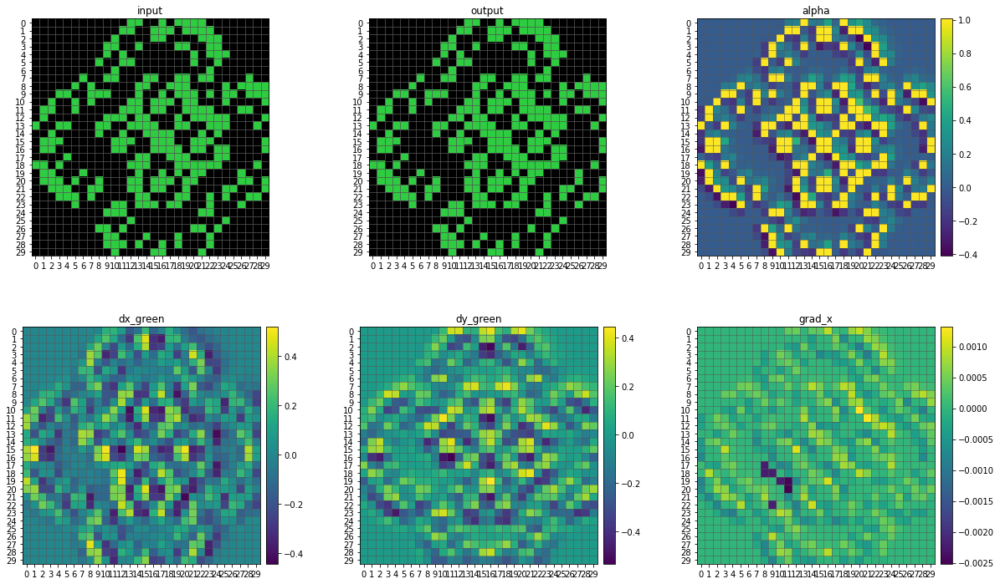

step 9
--------------------------------------------------------------------------------


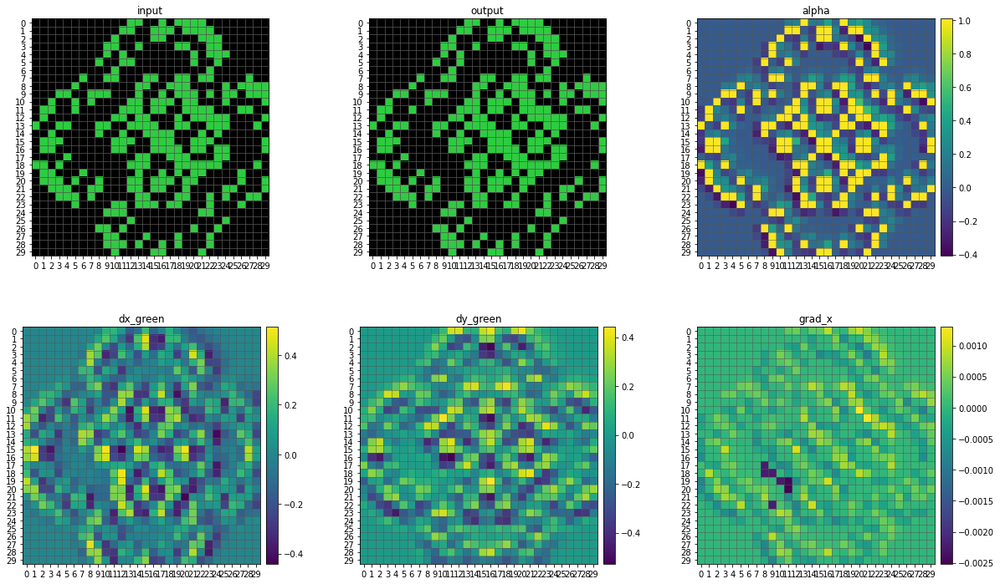

step 10
--------------------------------------------------------------------------------


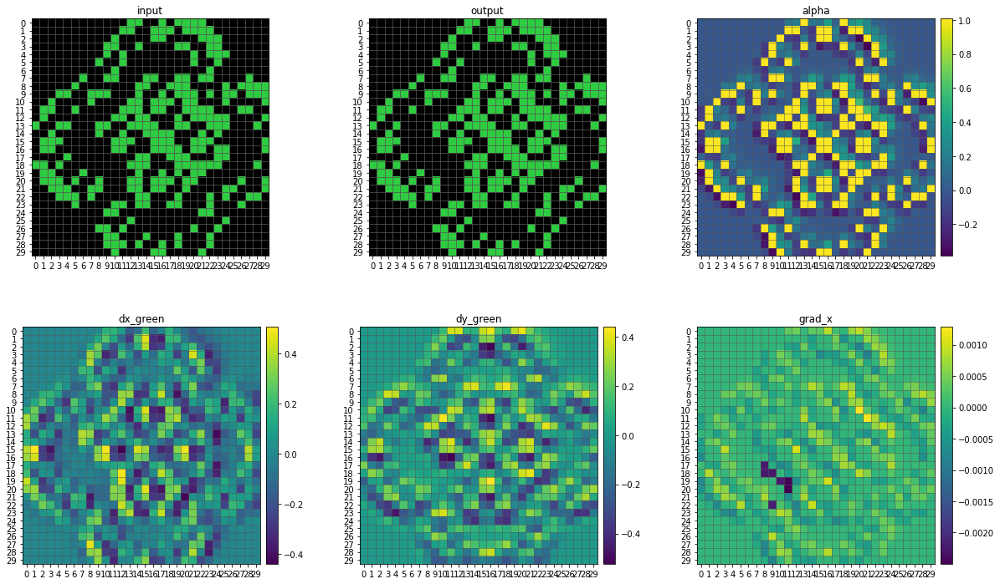

step 11
--------------------------------------------------------------------------------


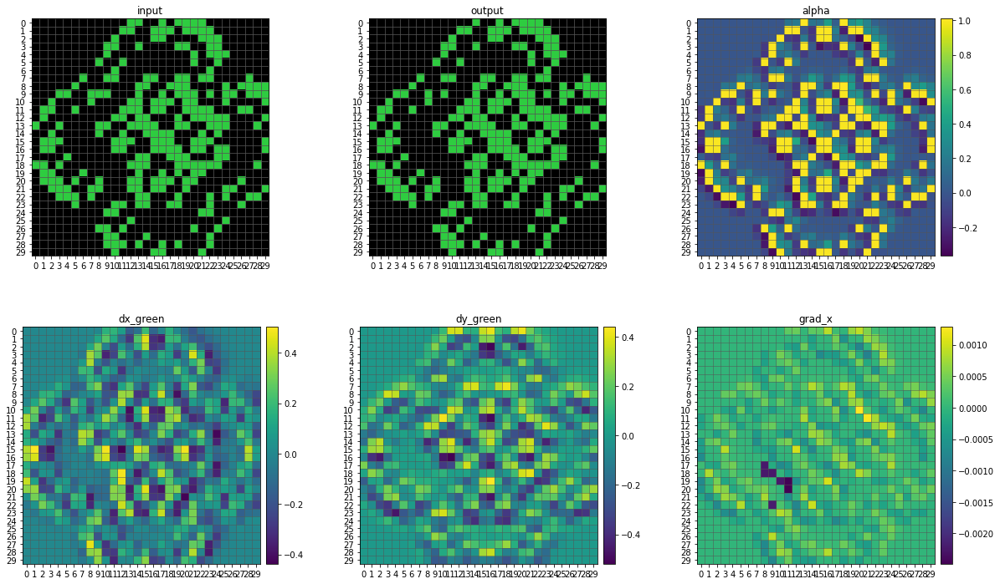

step 12
--------------------------------------------------------------------------------


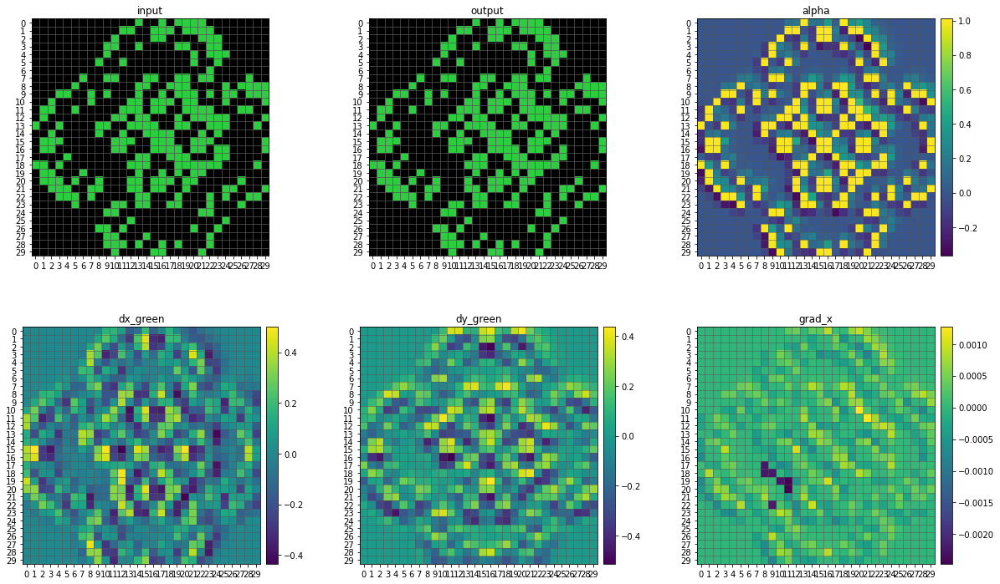

step 13
--------------------------------------------------------------------------------


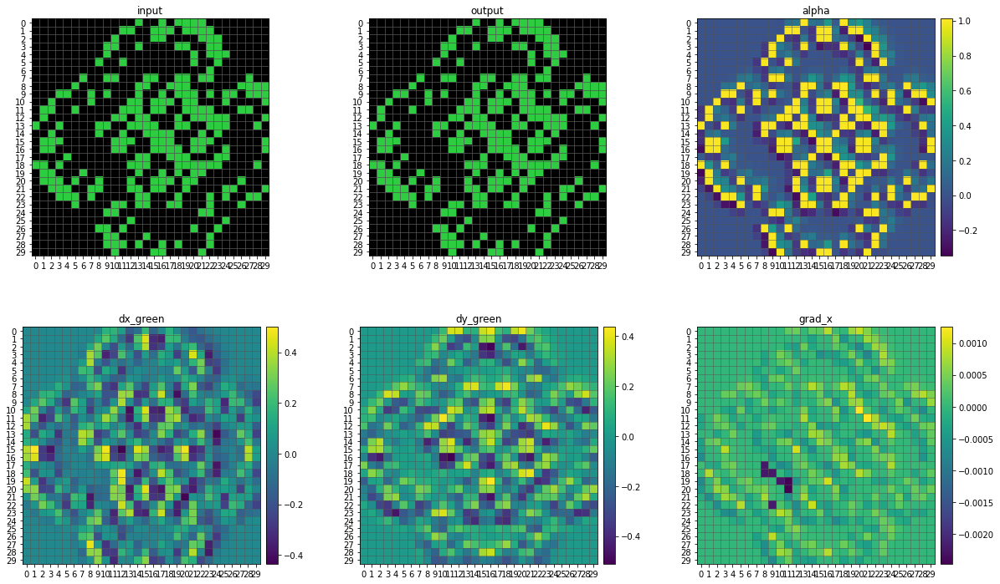

step 14
--------------------------------------------------------------------------------


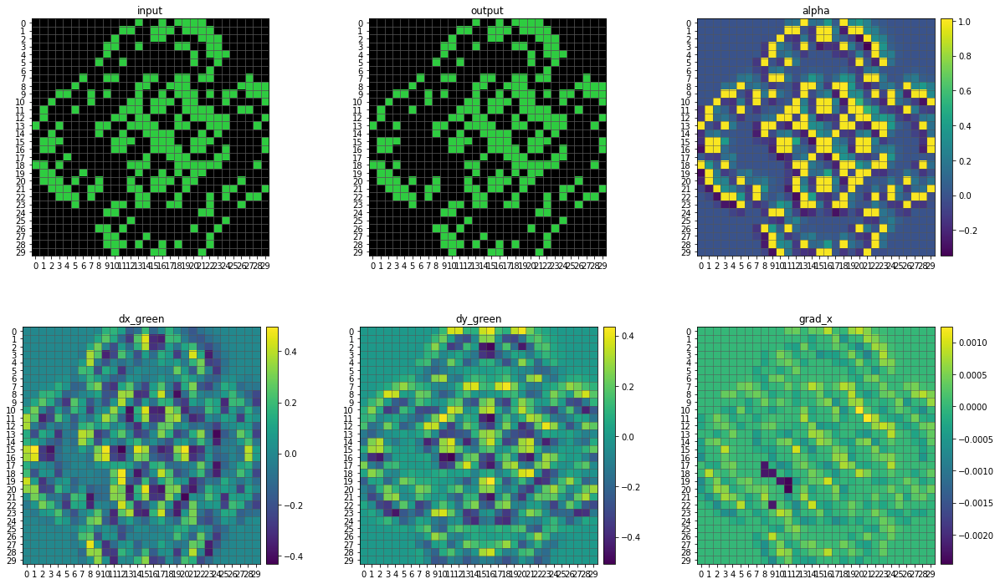

step 15
--------------------------------------------------------------------------------


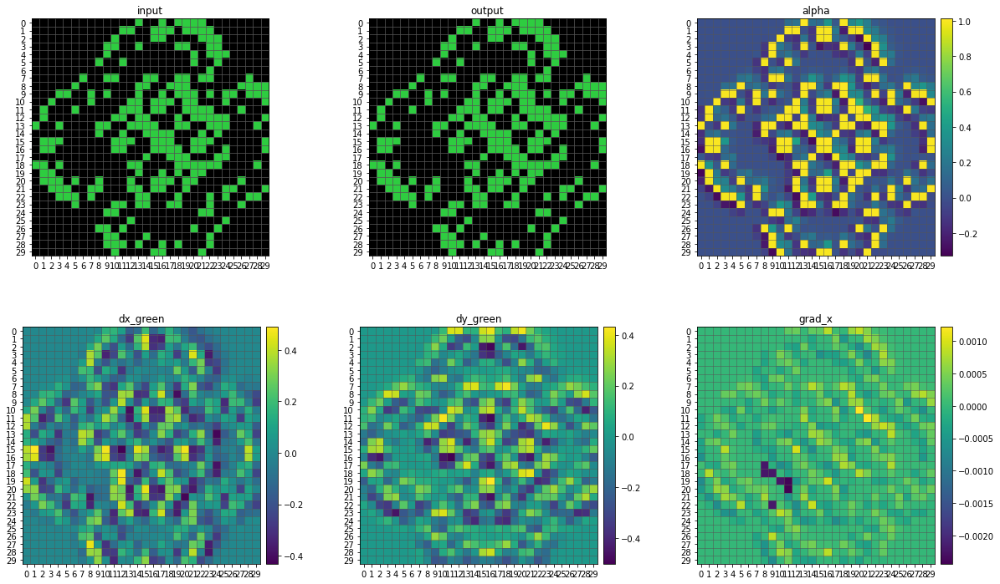

step 16
--------------------------------------------------------------------------------


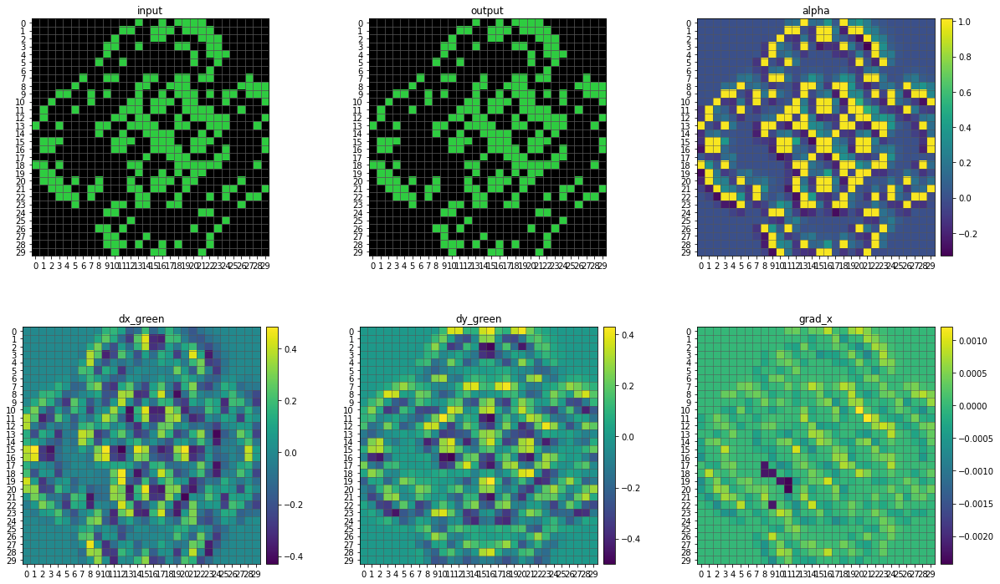

step 17
--------------------------------------------------------------------------------


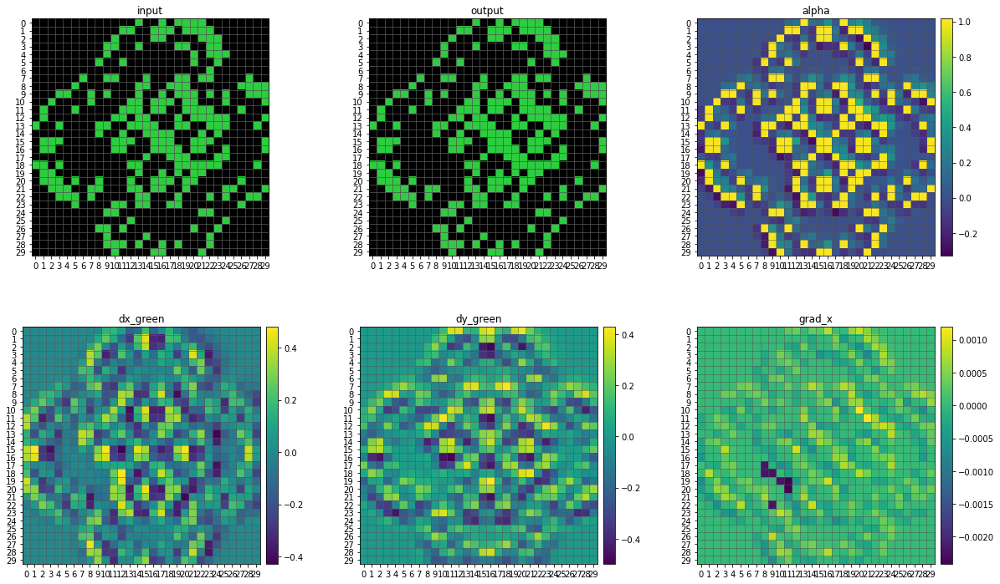

step 18
--------------------------------------------------------------------------------


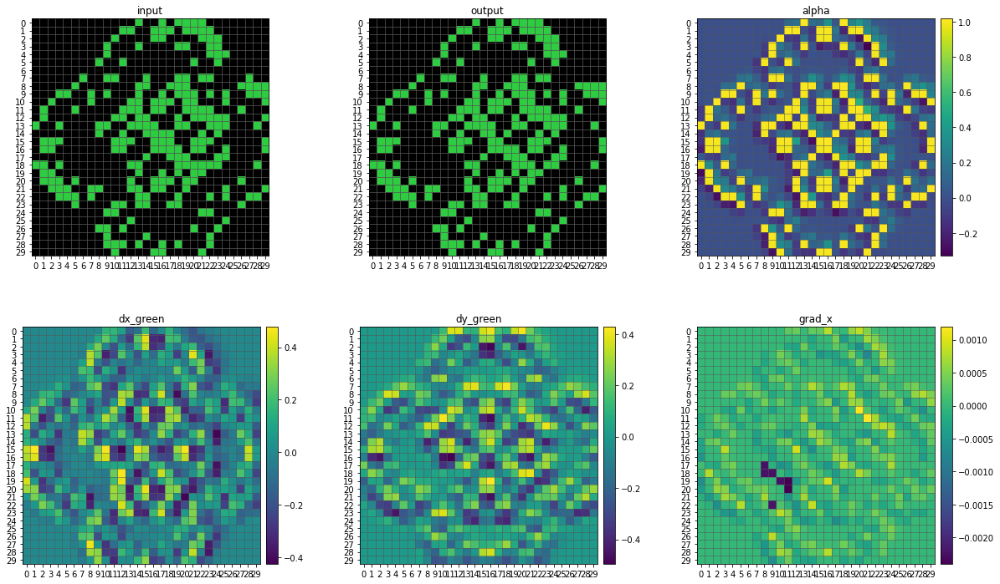

step 19
--------------------------------------------------------------------------------


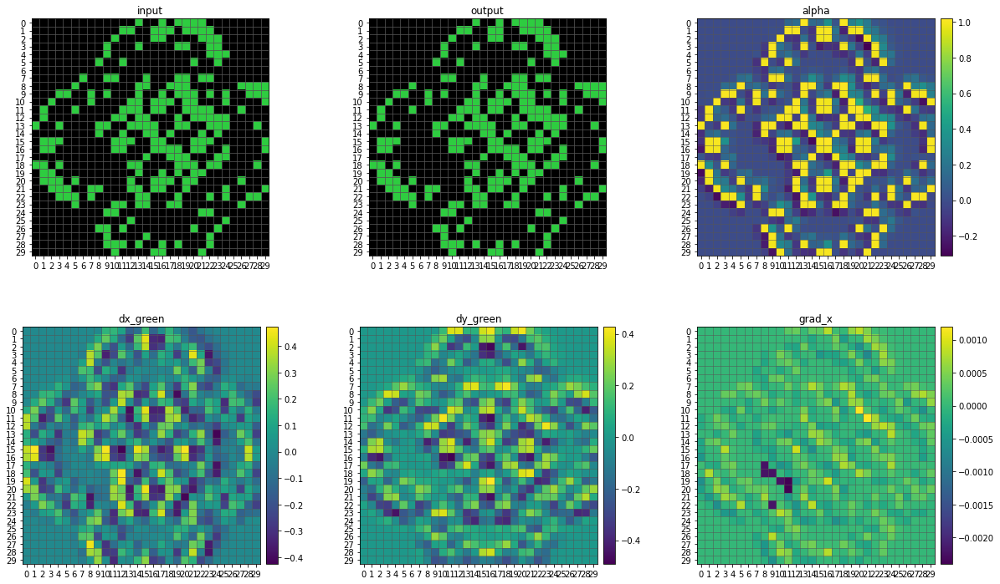

step 20
--------------------------------------------------------------------------------


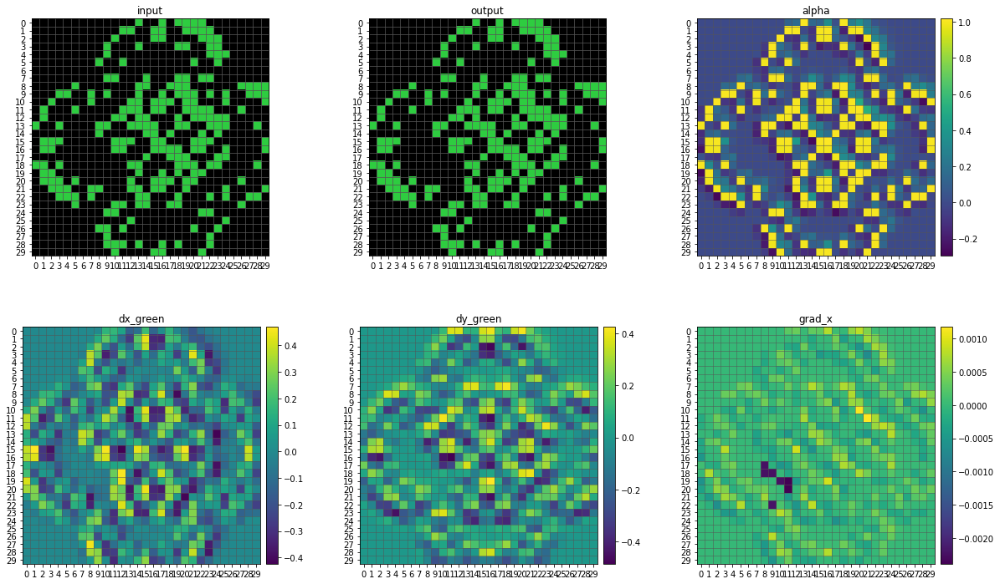

step 21
--------------------------------------------------------------------------------


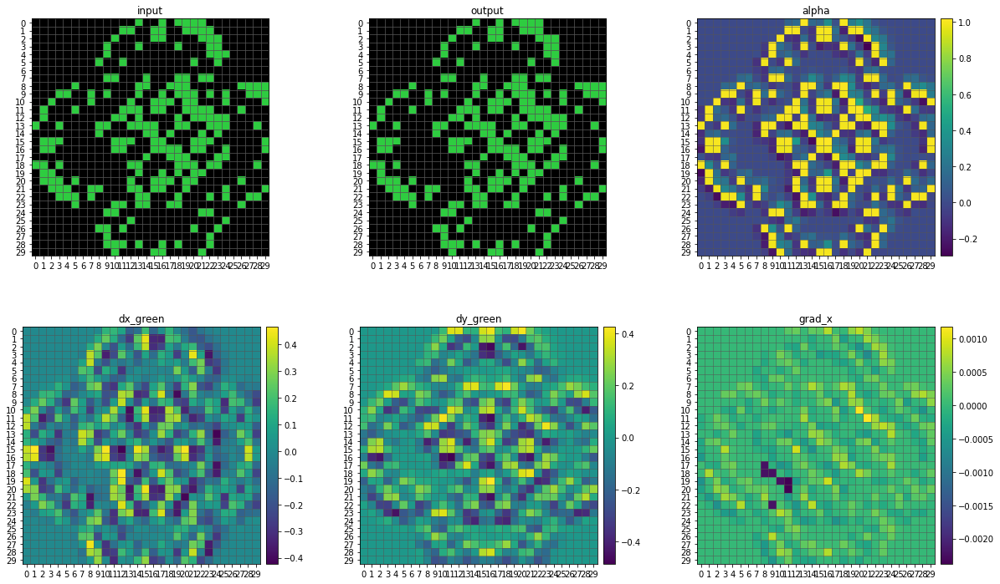

step 22
--------------------------------------------------------------------------------


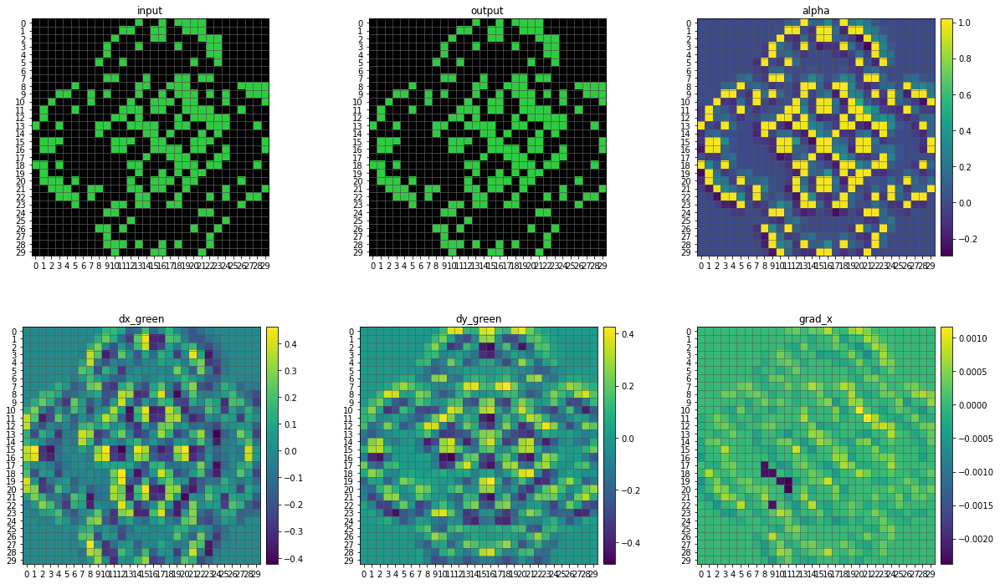

step 23
--------------------------------------------------------------------------------


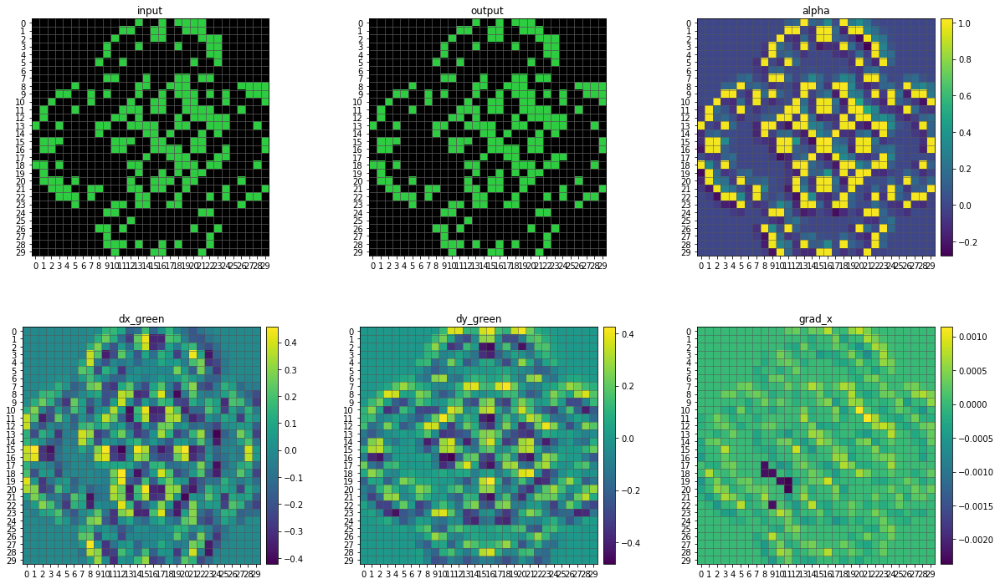

step 24
--------------------------------------------------------------------------------


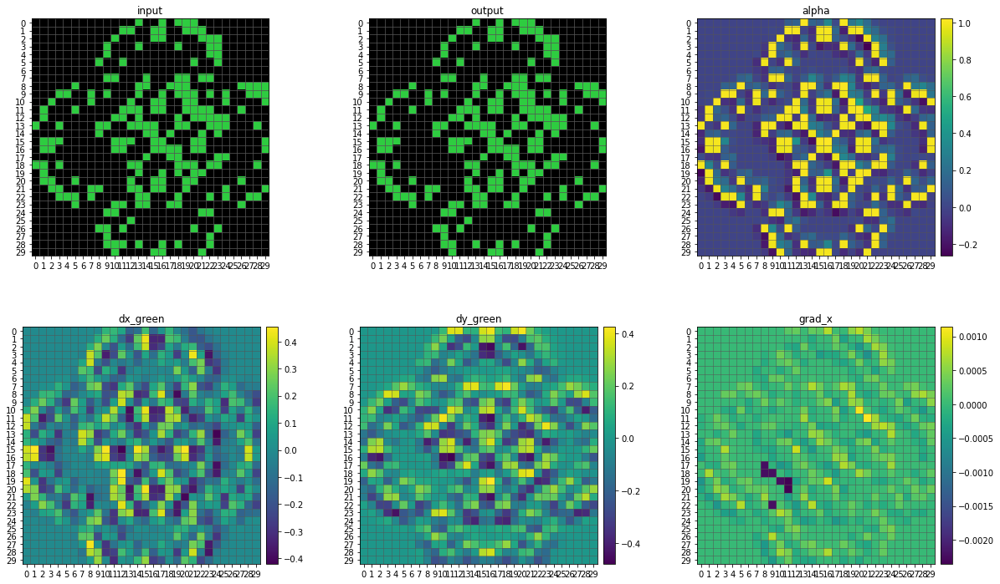

step 25
--------------------------------------------------------------------------------


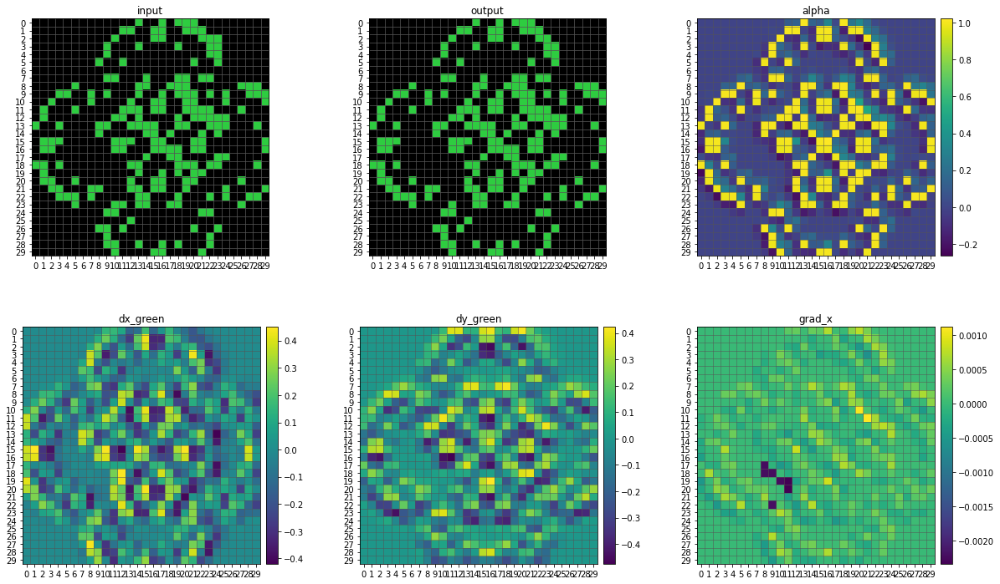

step 26
--------------------------------------------------------------------------------


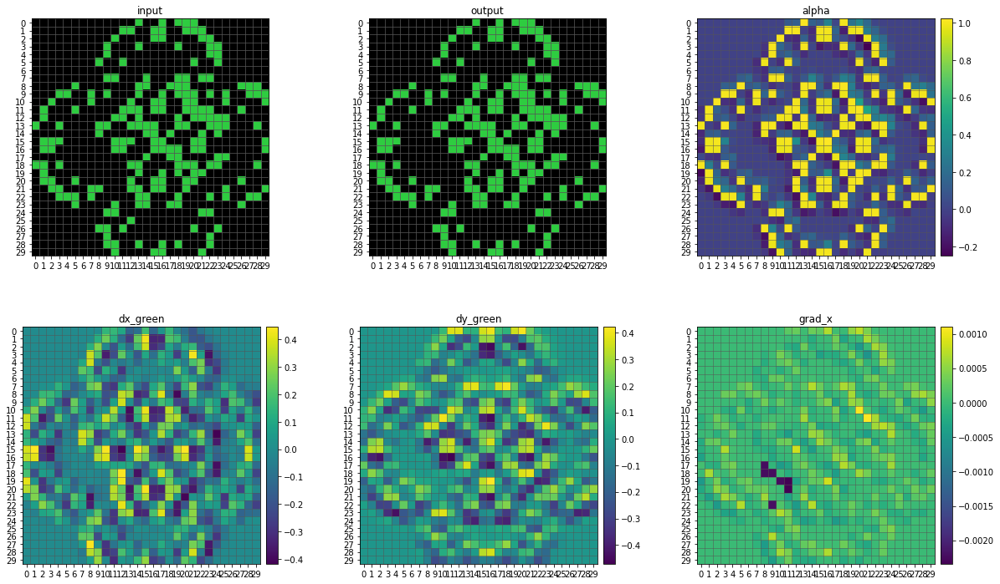

step 27
--------------------------------------------------------------------------------


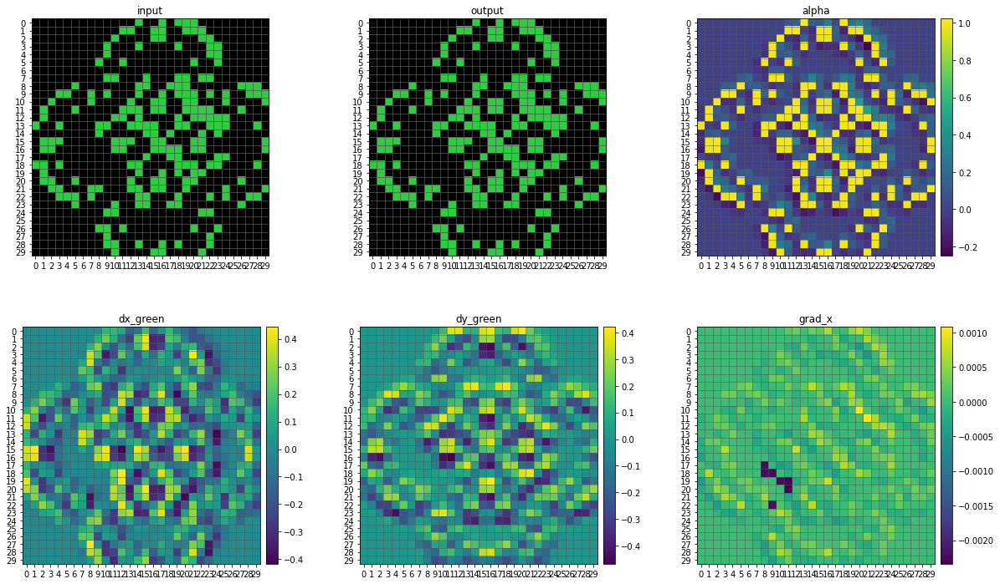

step 28
--------------------------------------------------------------------------------


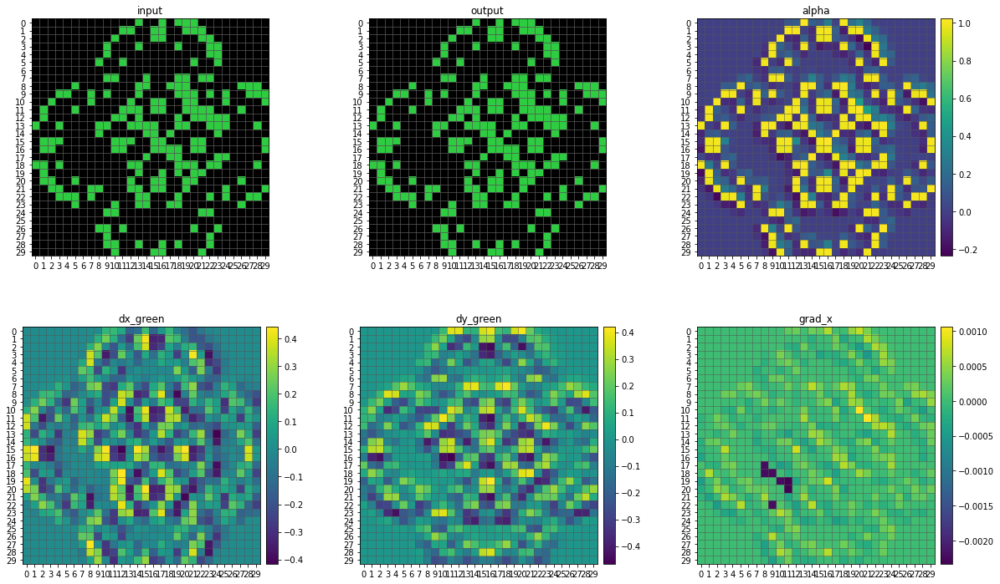

step 29
--------------------------------------------------------------------------------


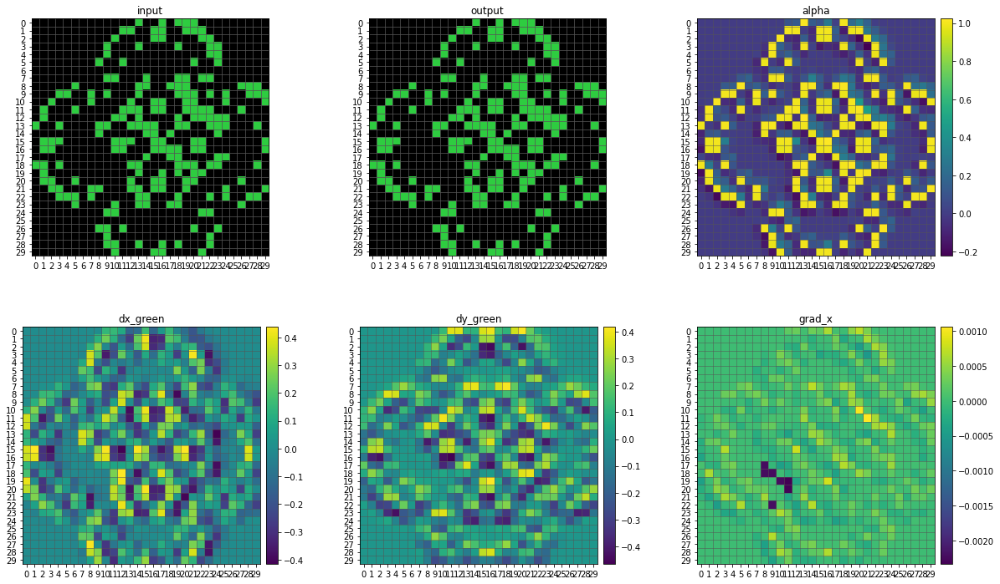

step 30
--------------------------------------------------------------------------------


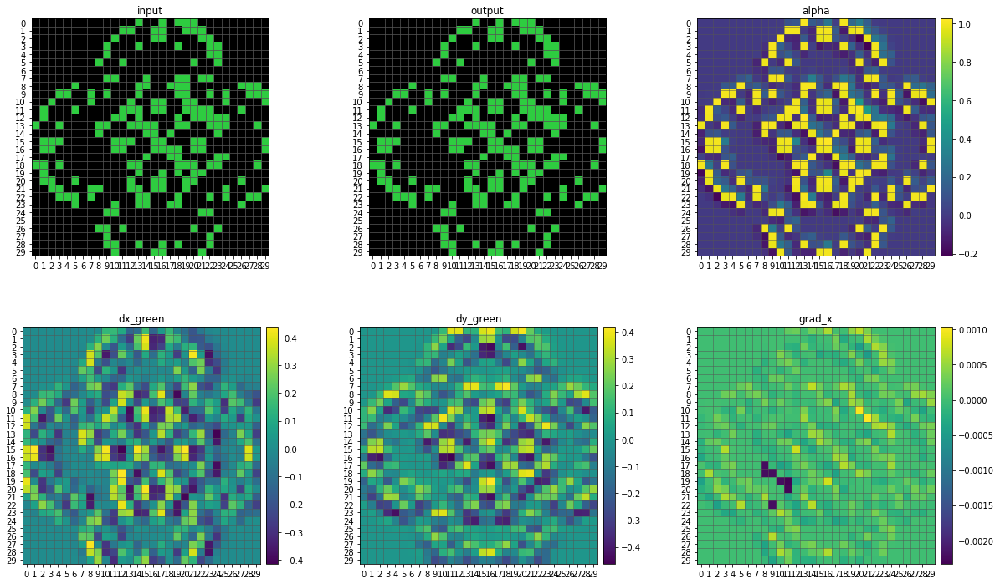

step 31
--------------------------------------------------------------------------------


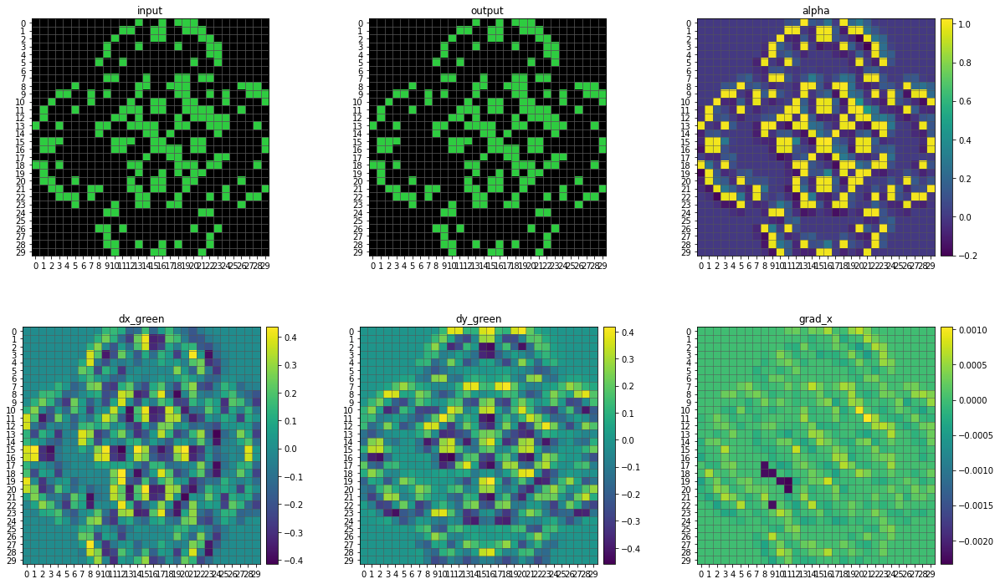

step 32
--------------------------------------------------------------------------------


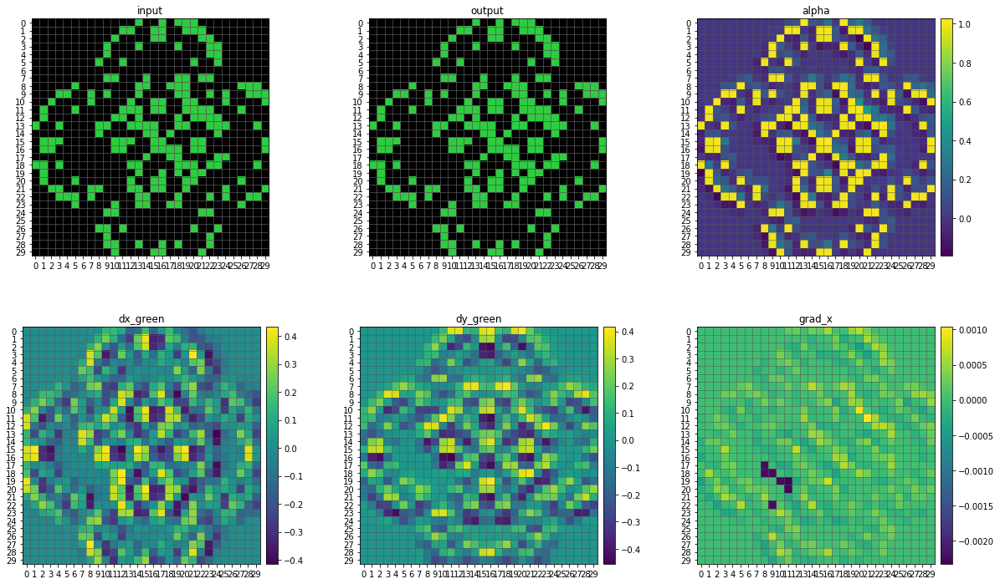

step 33
--------------------------------------------------------------------------------


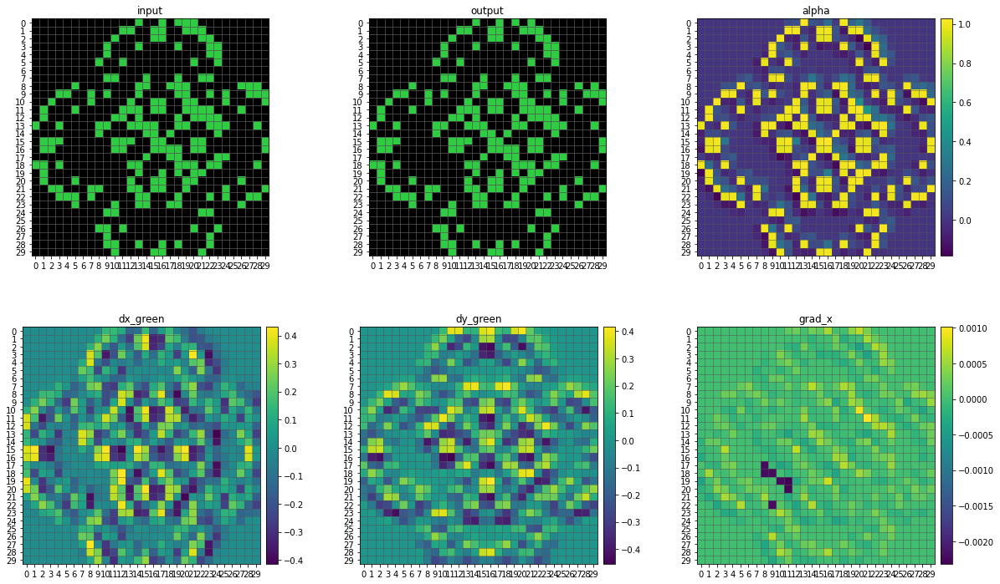

step 34
--------------------------------------------------------------------------------


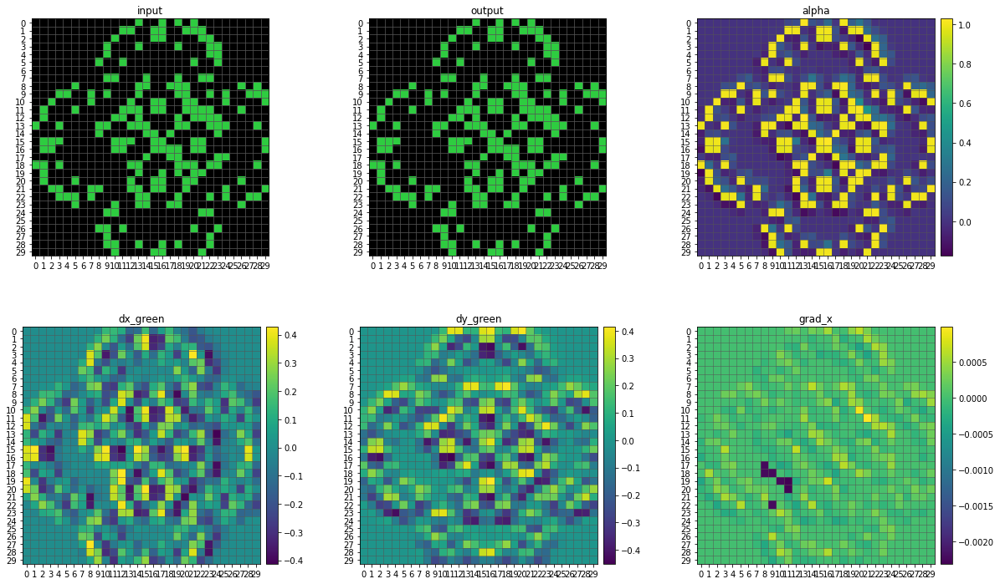

step 35
--------------------------------------------------------------------------------


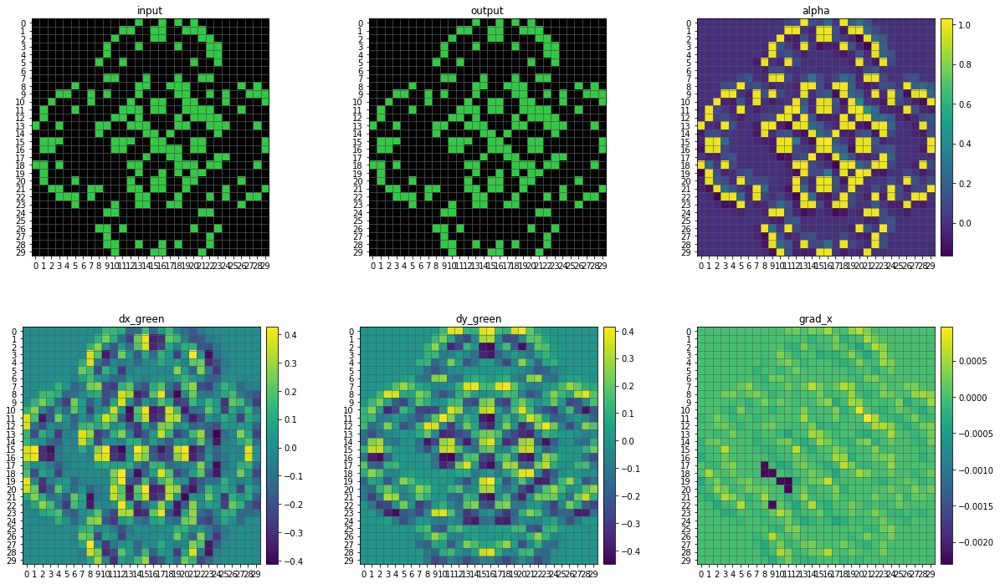

step 36
--------------------------------------------------------------------------------


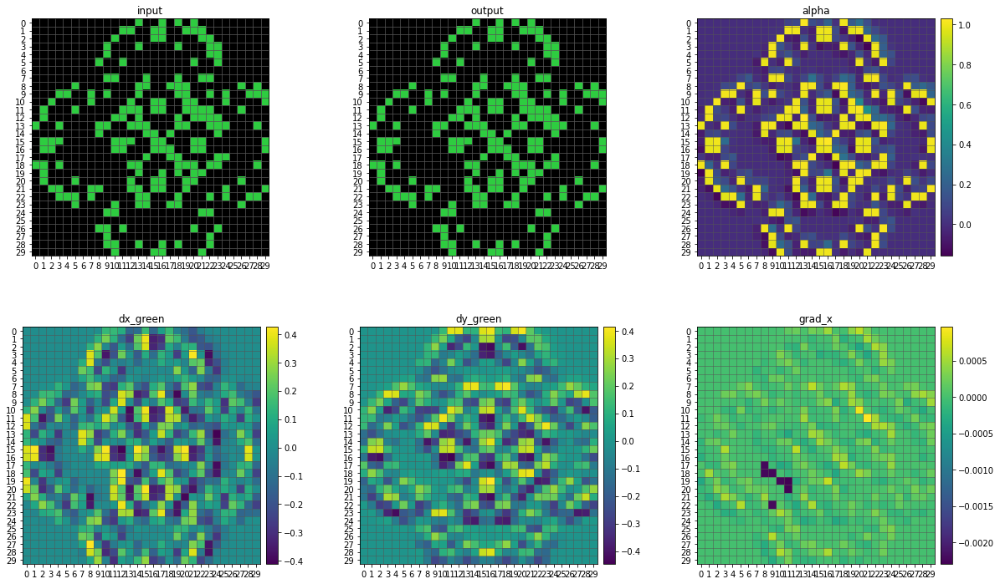

step 37
--------------------------------------------------------------------------------


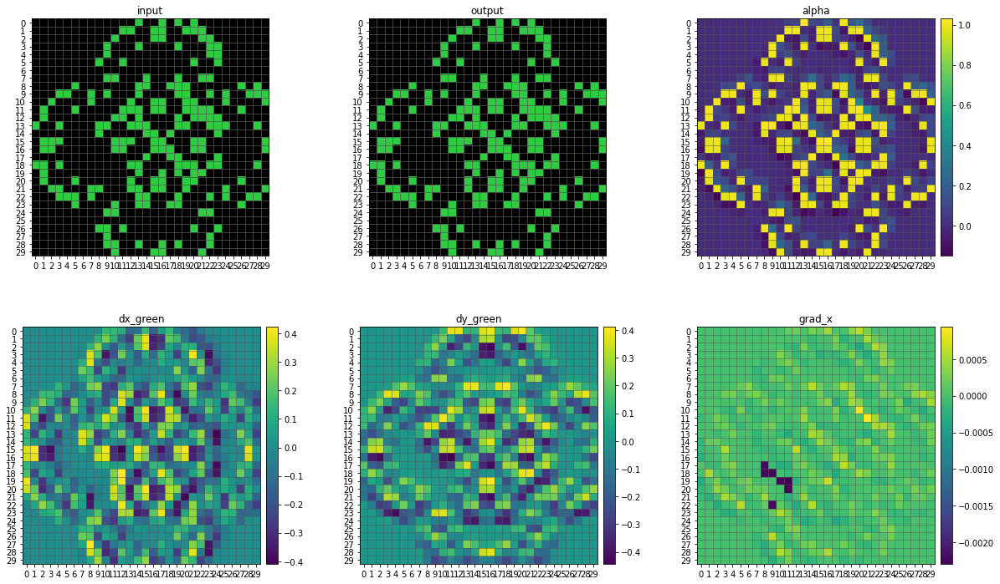

step 38
--------------------------------------------------------------------------------


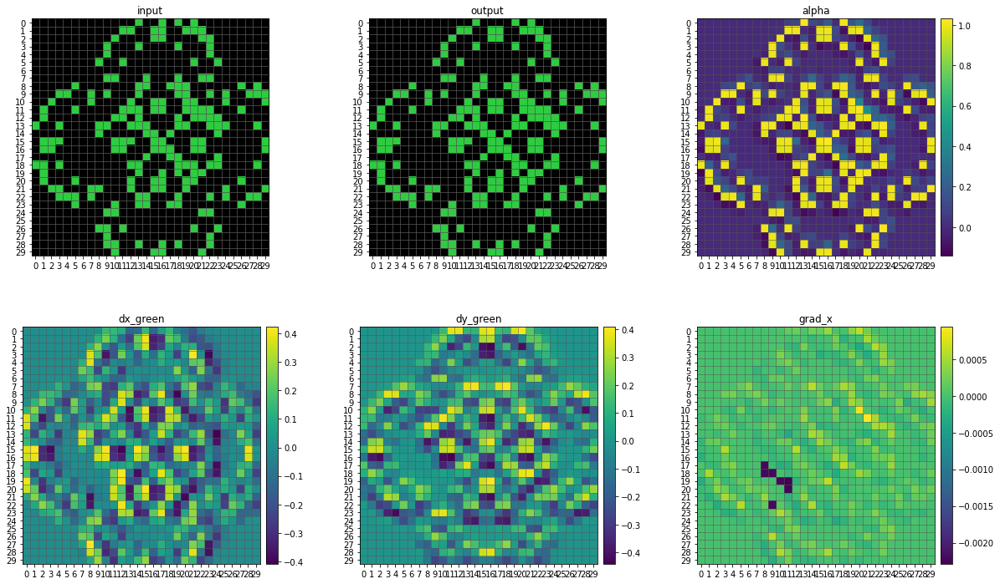

step 39
--------------------------------------------------------------------------------


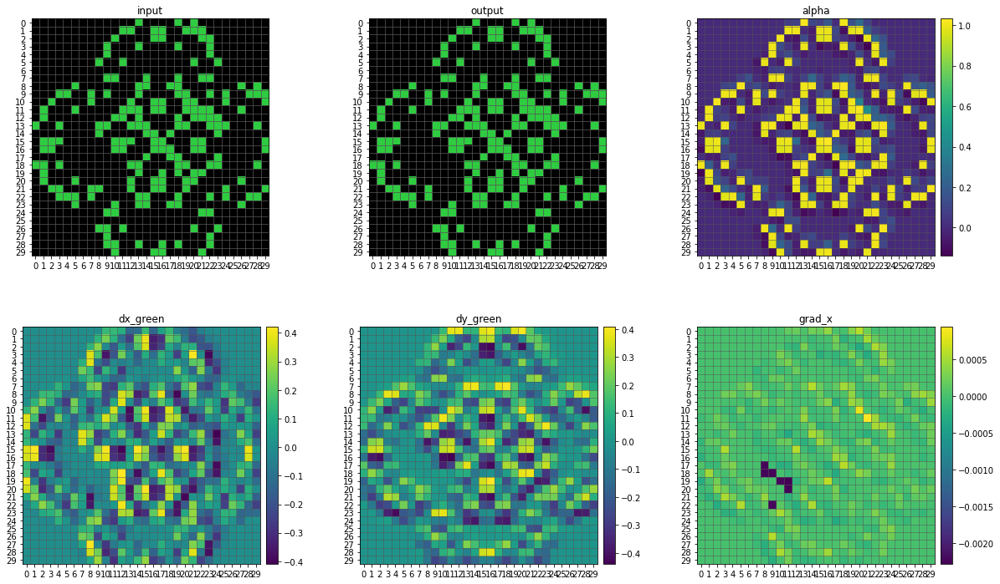

step 40
--------------------------------------------------------------------------------


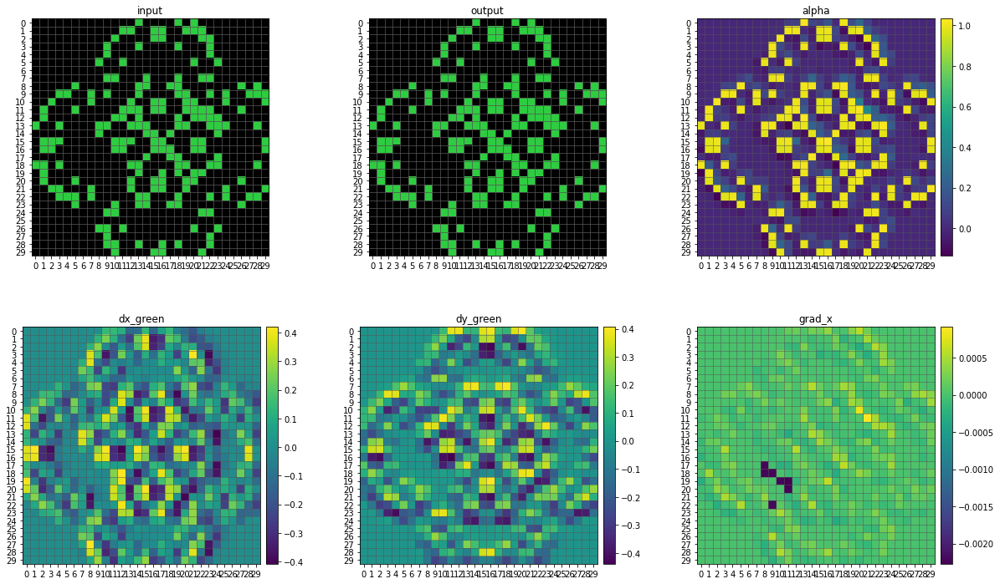

step 41
--------------------------------------------------------------------------------


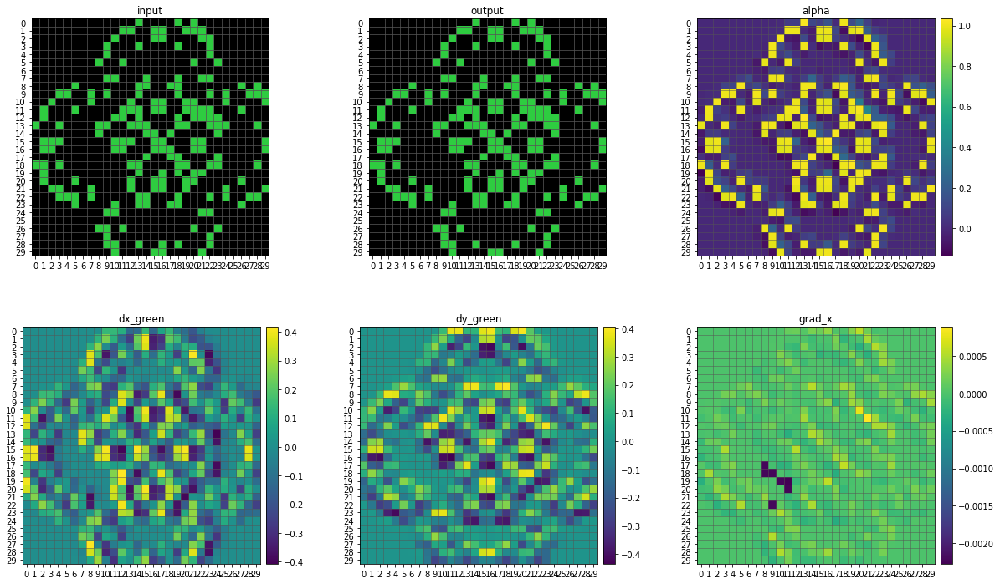

step 42
--------------------------------------------------------------------------------


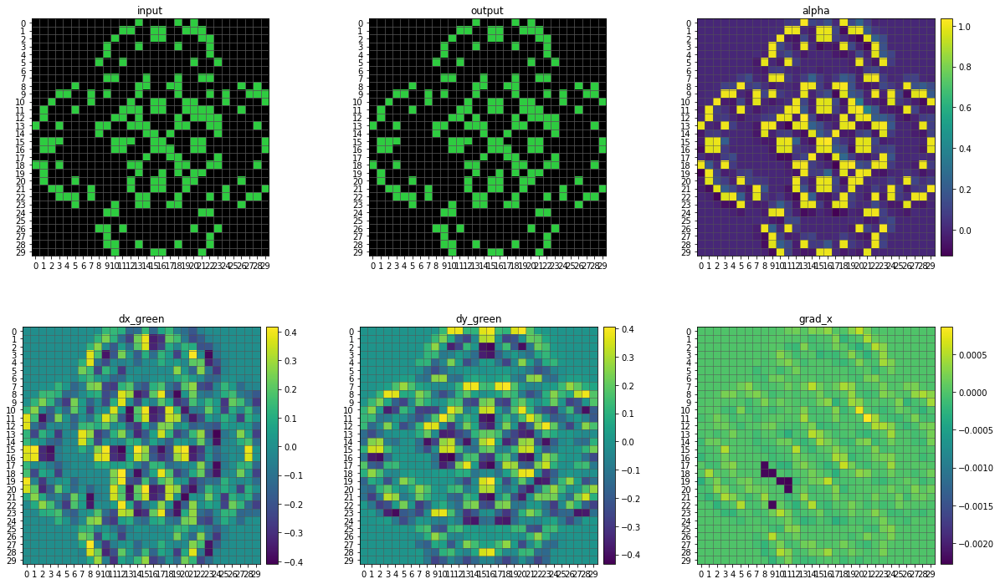

step 43
--------------------------------------------------------------------------------


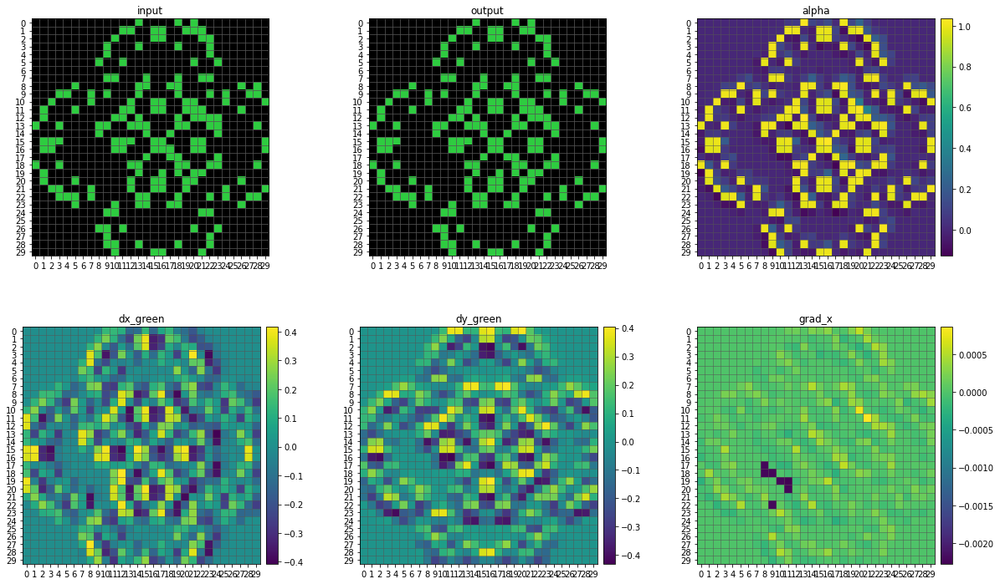

step 44
--------------------------------------------------------------------------------


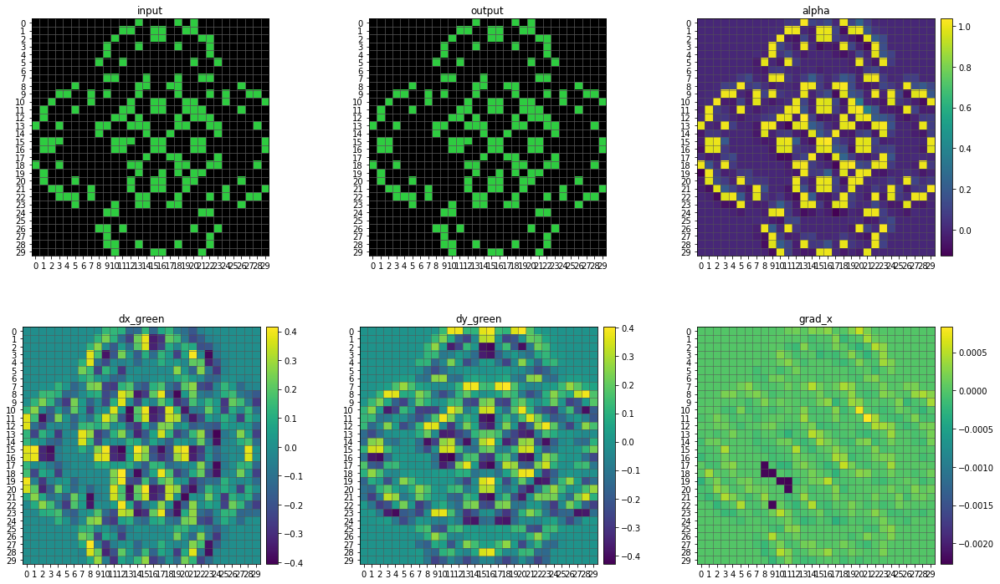

step 45
--------------------------------------------------------------------------------


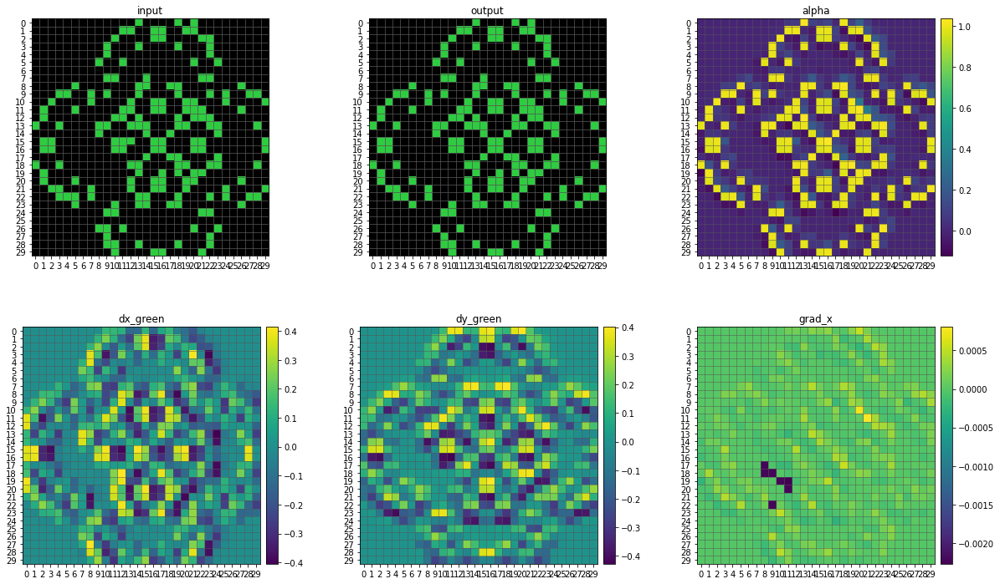

step 46
--------------------------------------------------------------------------------


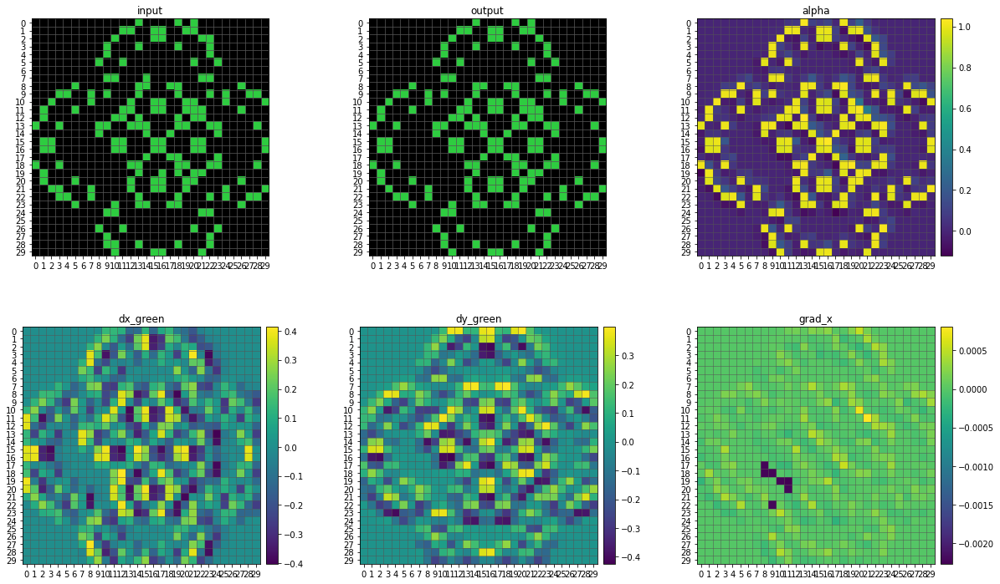

step 47
--------------------------------------------------------------------------------


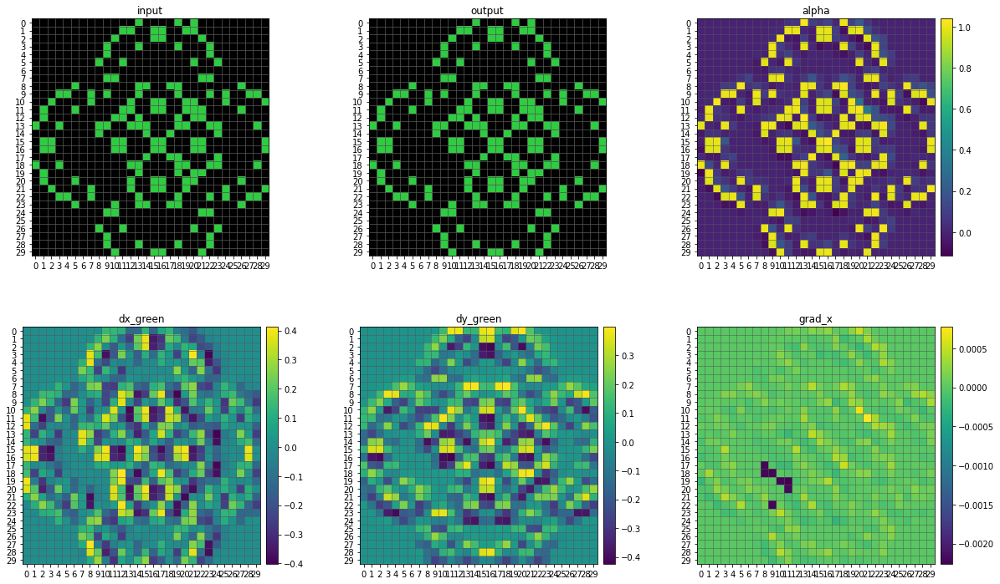

step 48
--------------------------------------------------------------------------------


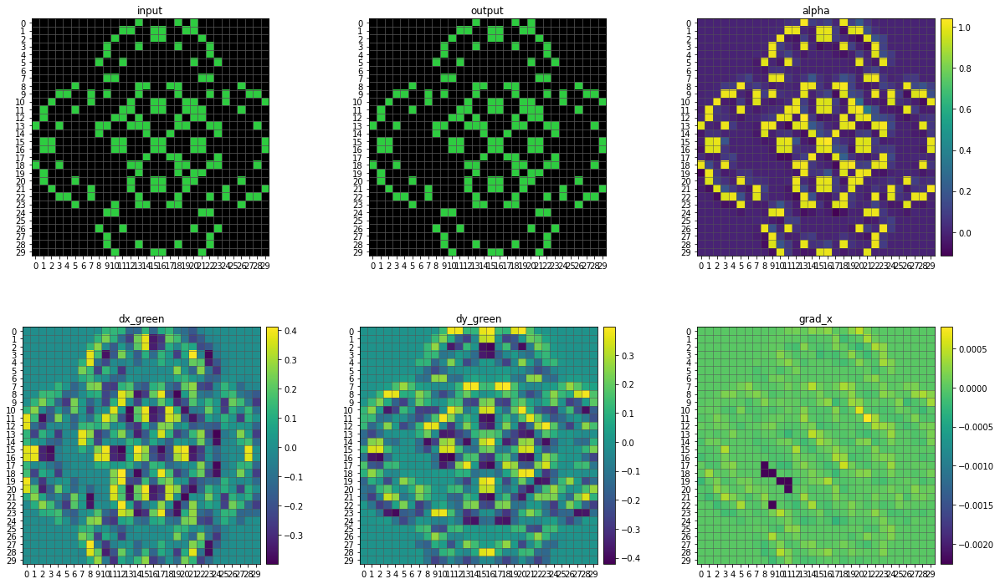

step 49
--------------------------------------------------------------------------------


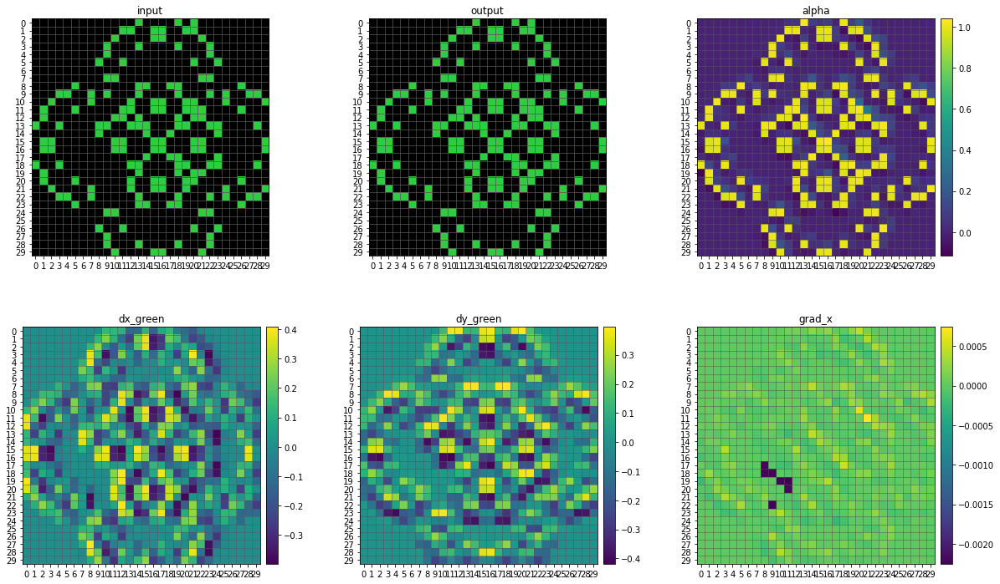

step 50
--------------------------------------------------------------------------------


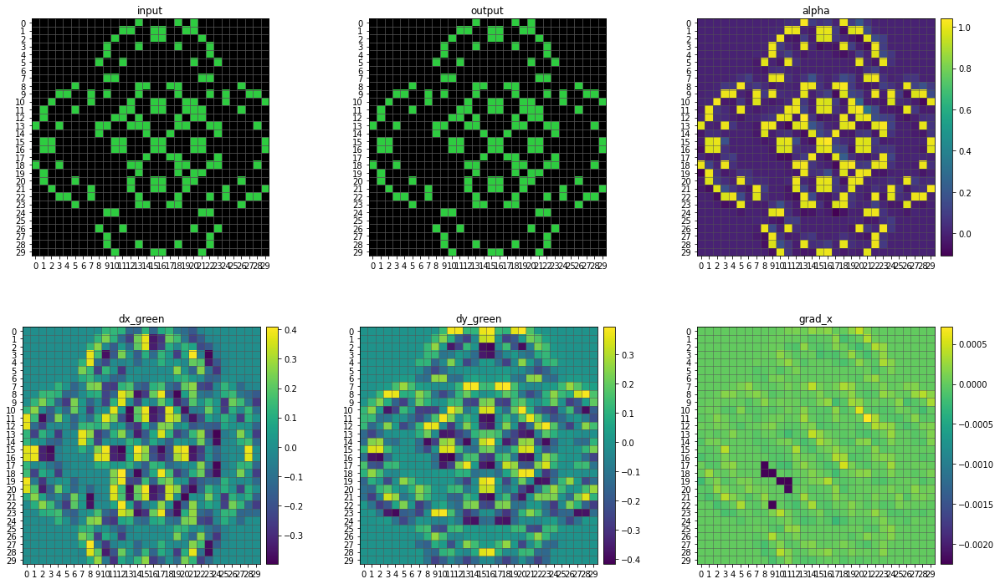

step 51
--------------------------------------------------------------------------------


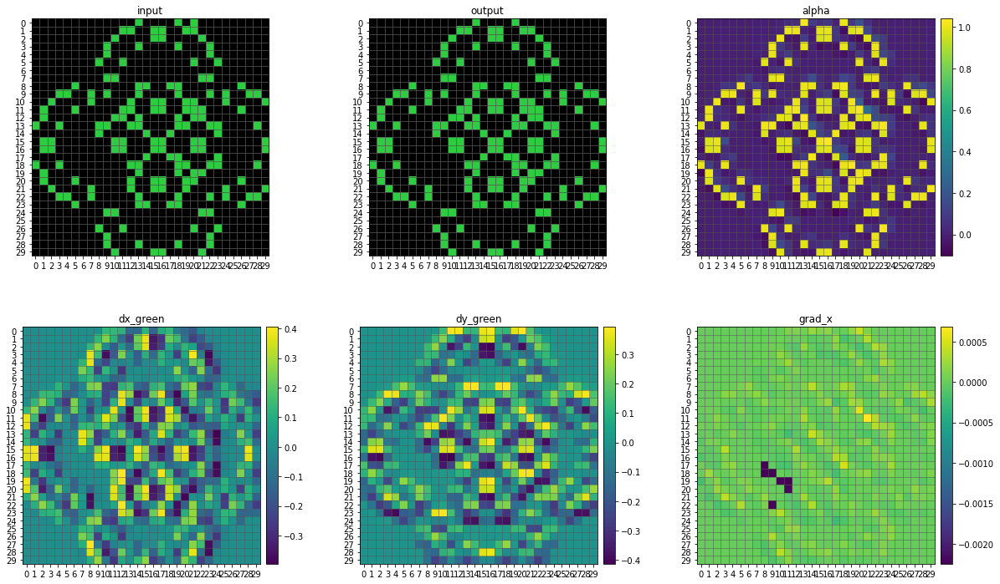

step 52
--------------------------------------------------------------------------------


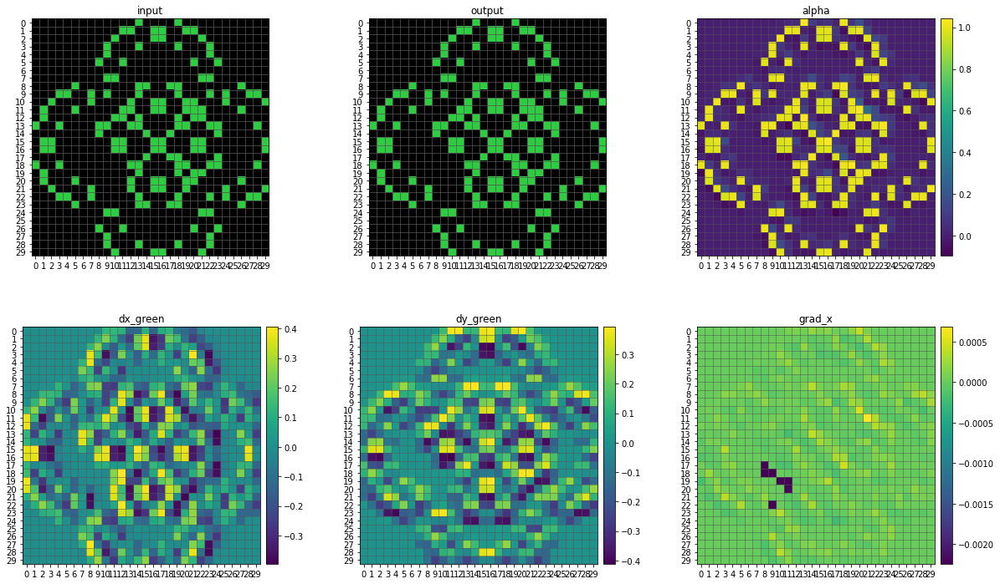

step 53
--------------------------------------------------------------------------------


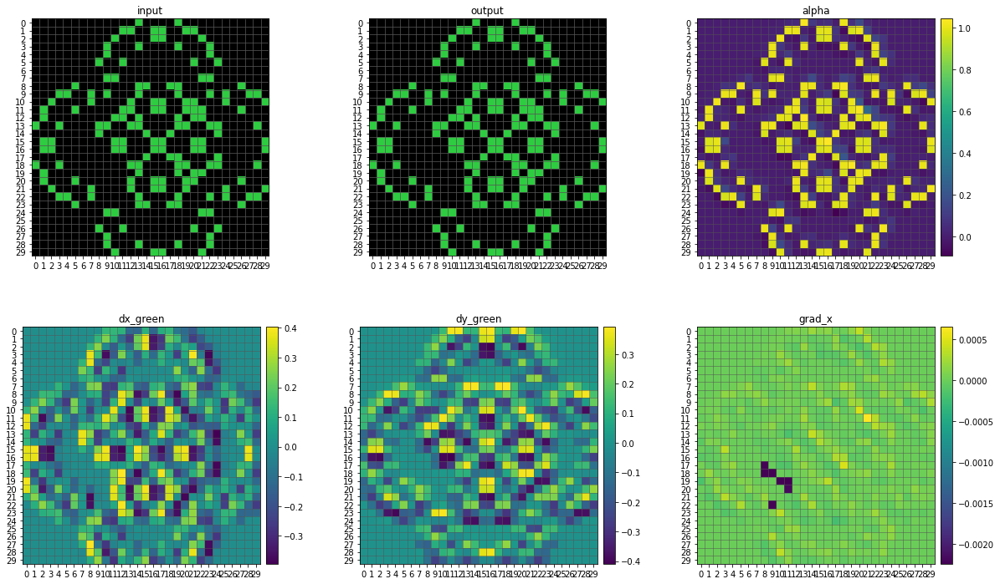

step 54
--------------------------------------------------------------------------------


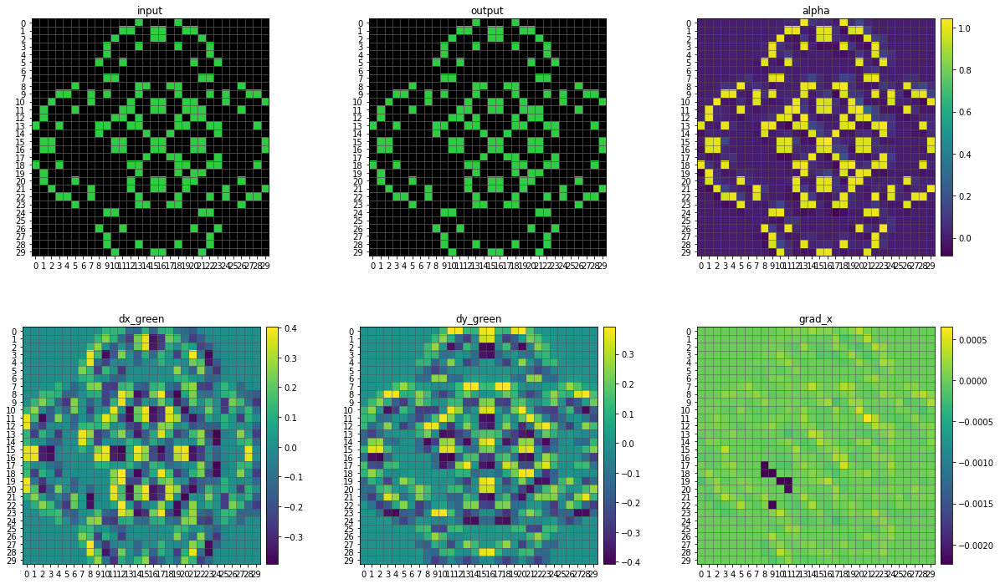

step 55
--------------------------------------------------------------------------------


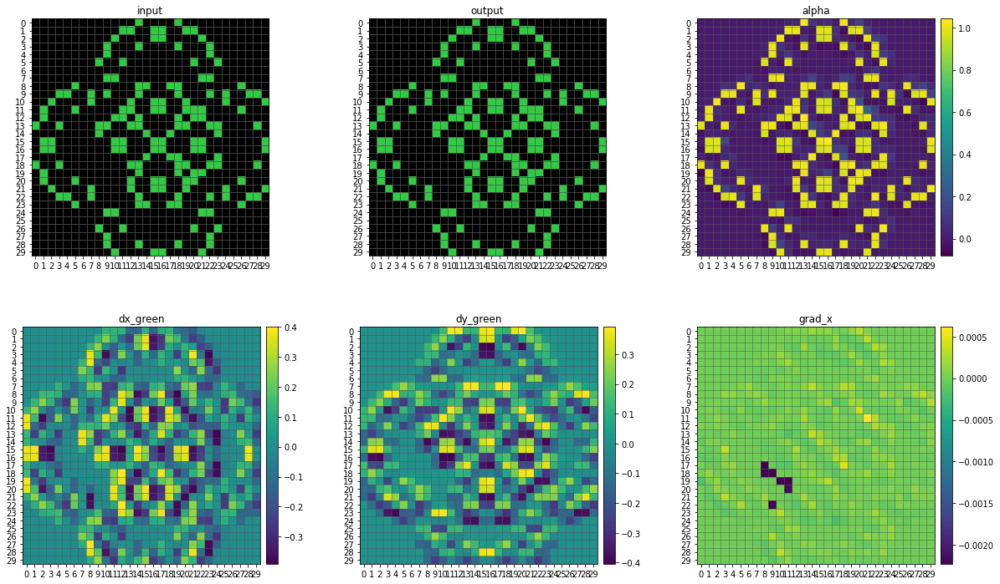

step 56
--------------------------------------------------------------------------------


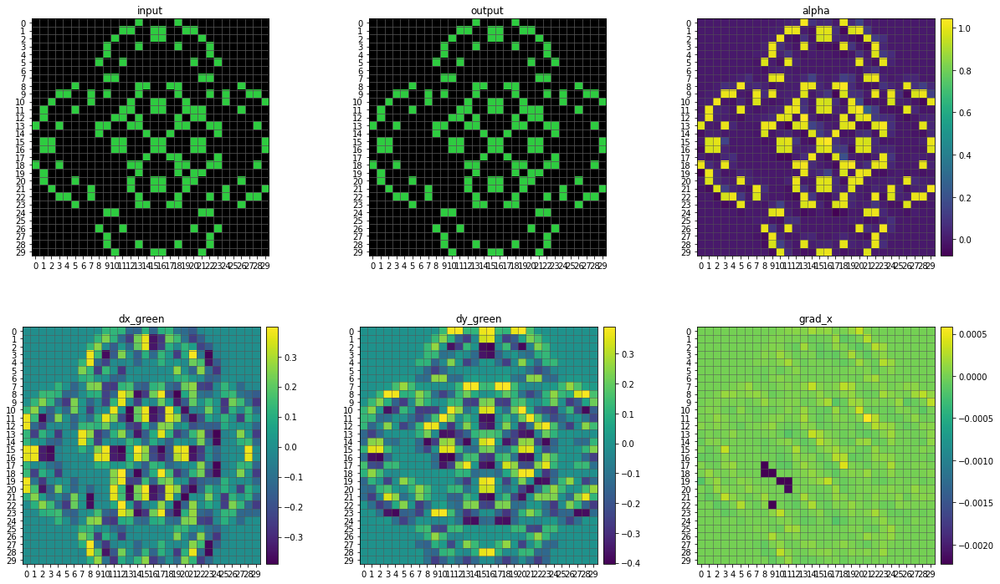

step 57
--------------------------------------------------------------------------------


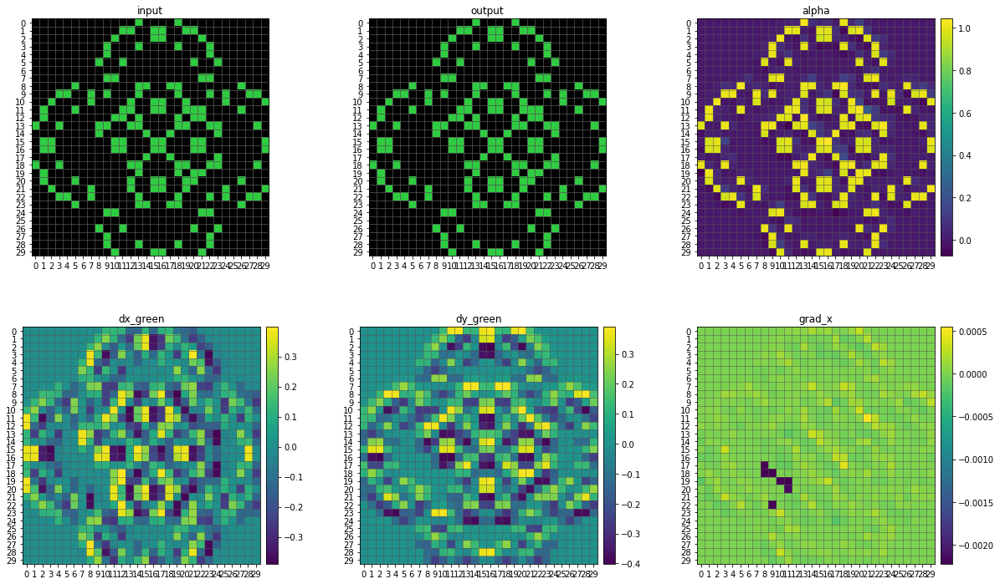

step 58
--------------------------------------------------------------------------------


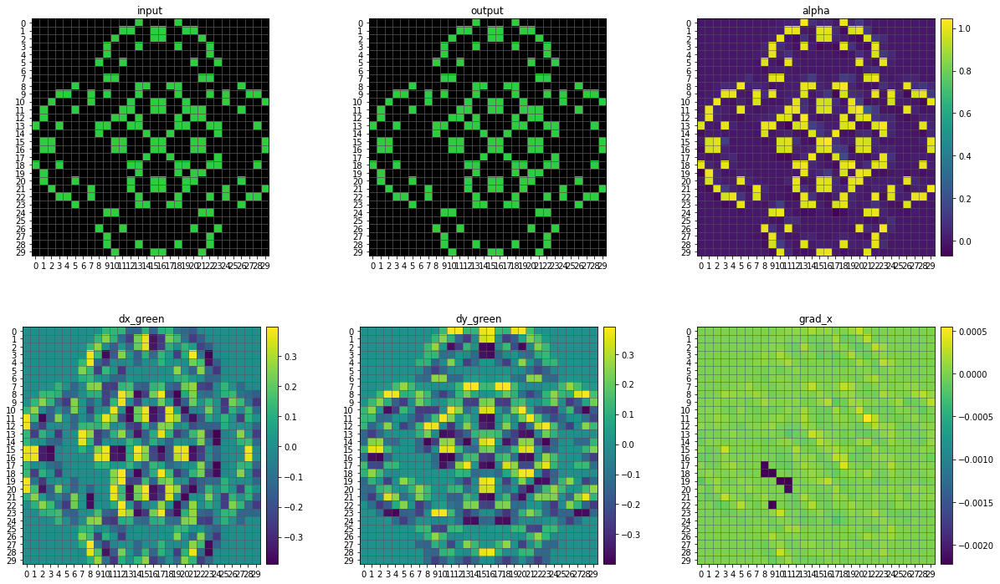

step 59
--------------------------------------------------------------------------------


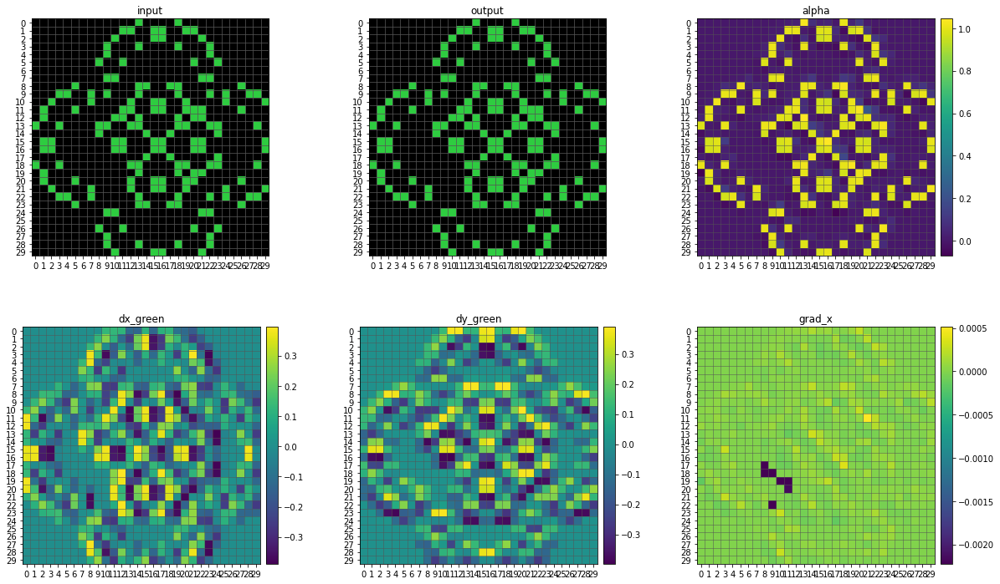

step 60
--------------------------------------------------------------------------------


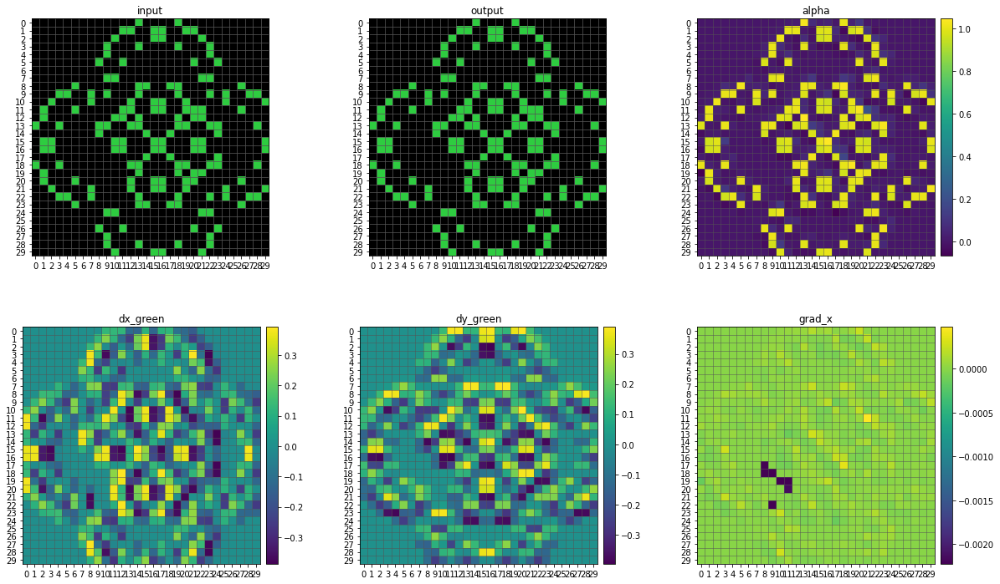

step 61
--------------------------------------------------------------------------------


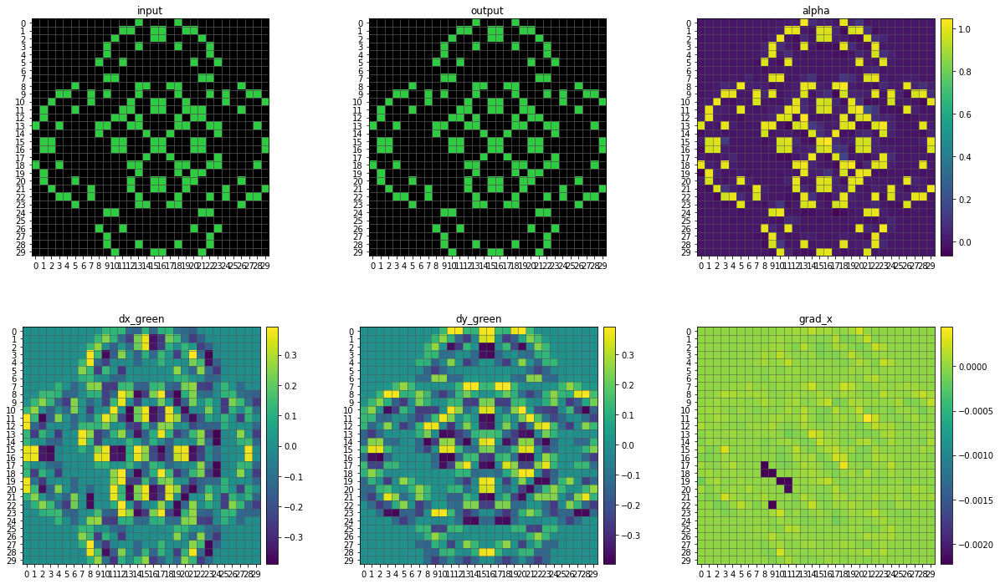

step 62
--------------------------------------------------------------------------------


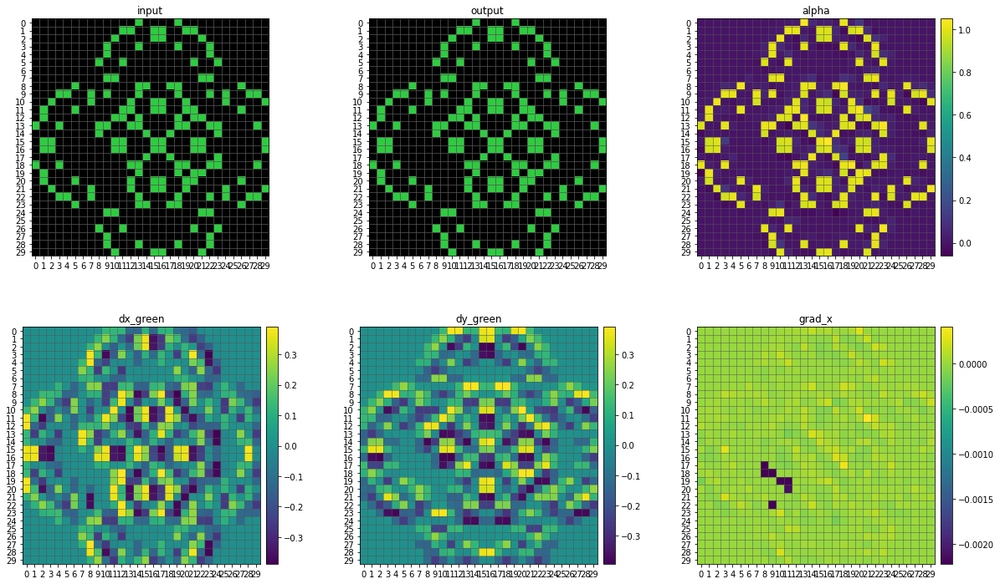

step 63
--------------------------------------------------------------------------------


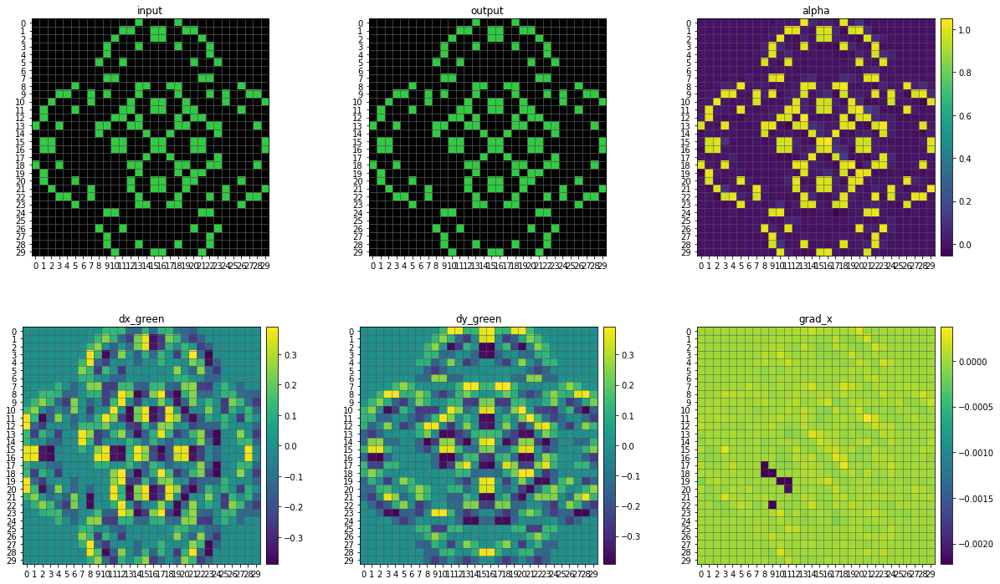

step 64
--------------------------------------------------------------------------------


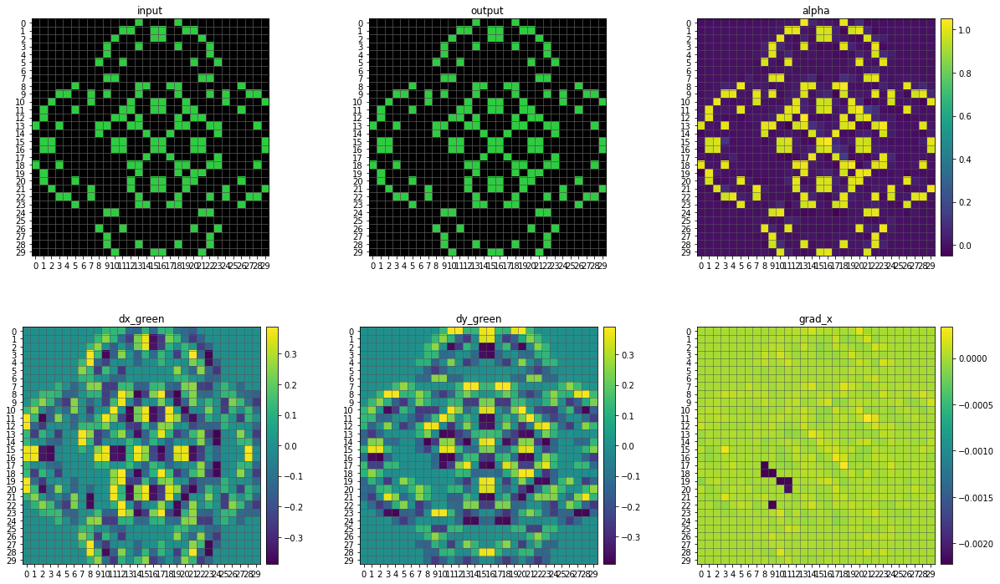

step 65
--------------------------------------------------------------------------------


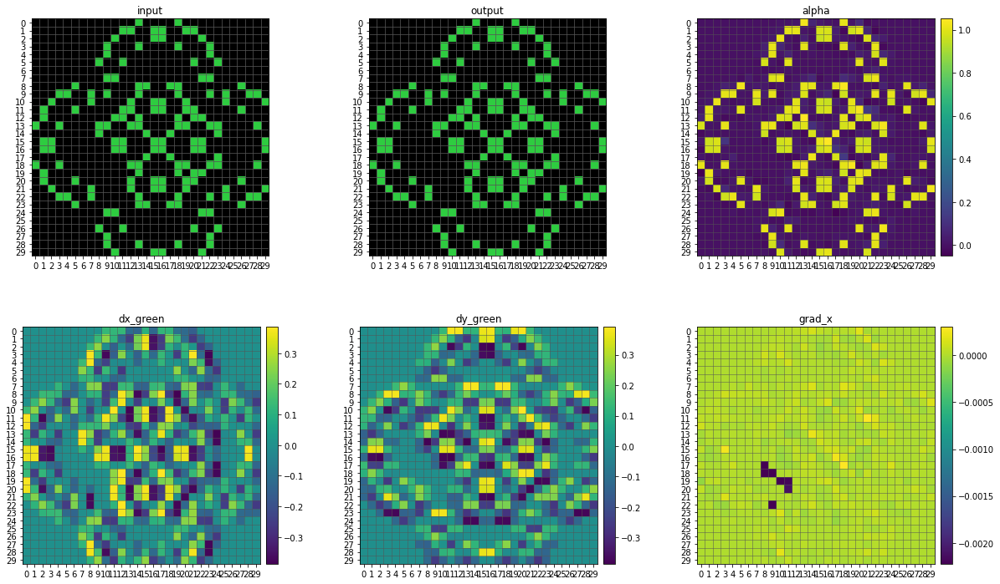

step 66
--------------------------------------------------------------------------------


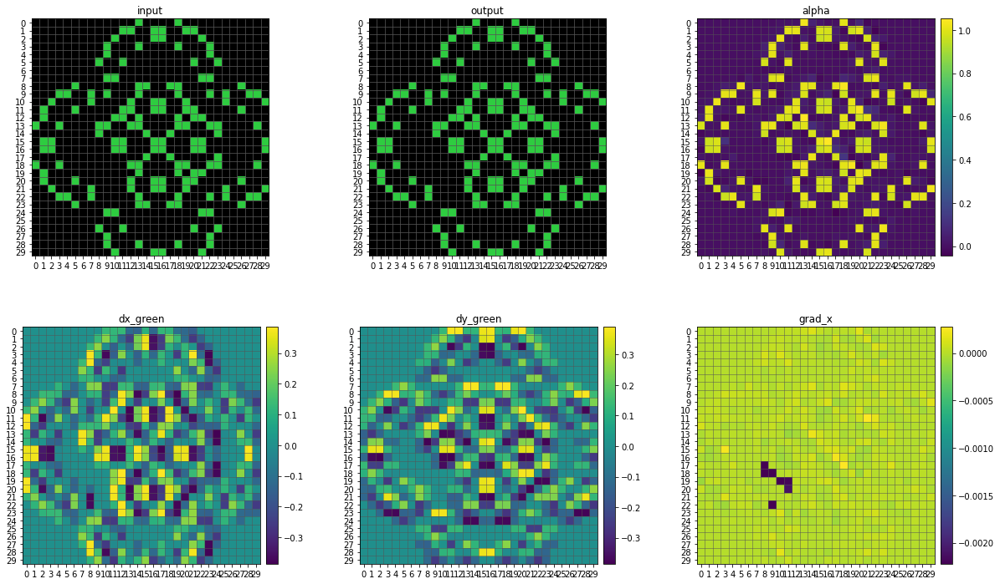

step 67
--------------------------------------------------------------------------------


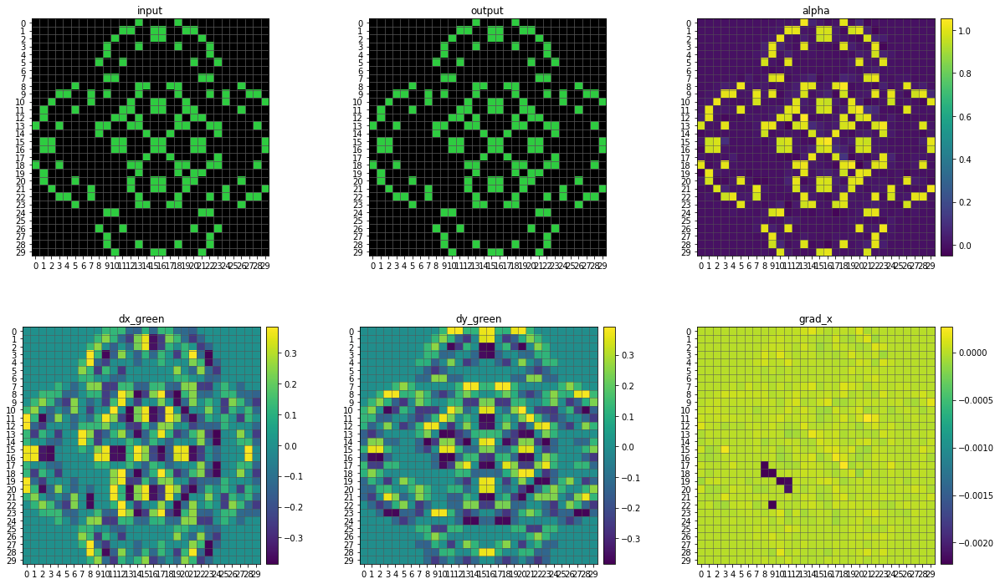

step 68
--------------------------------------------------------------------------------


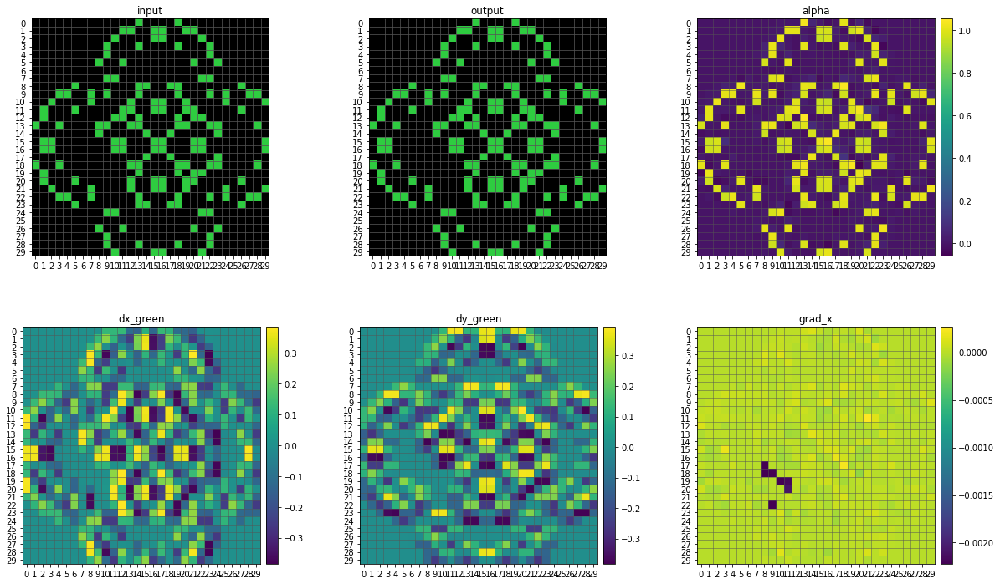

step 69
--------------------------------------------------------------------------------


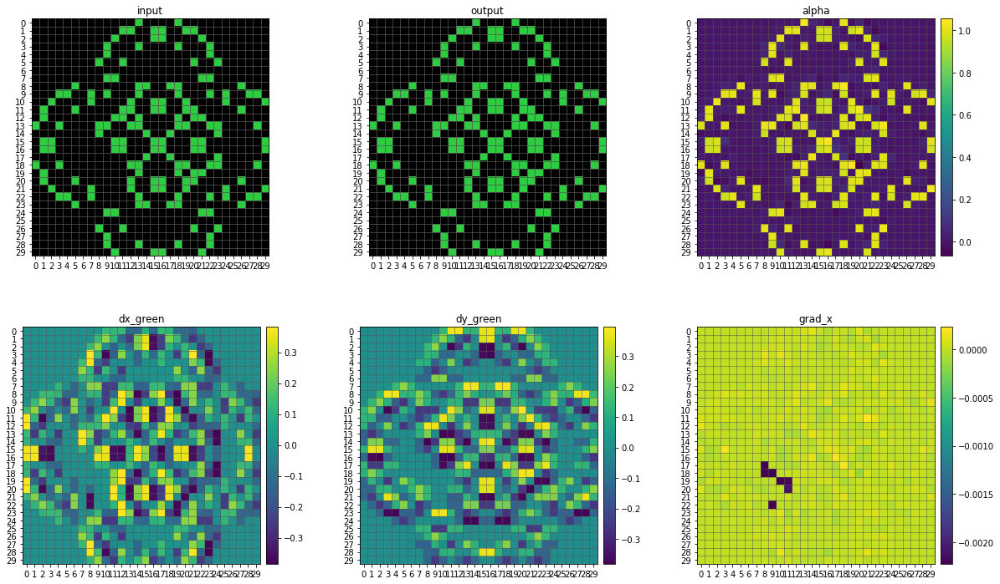

step 70
--------------------------------------------------------------------------------


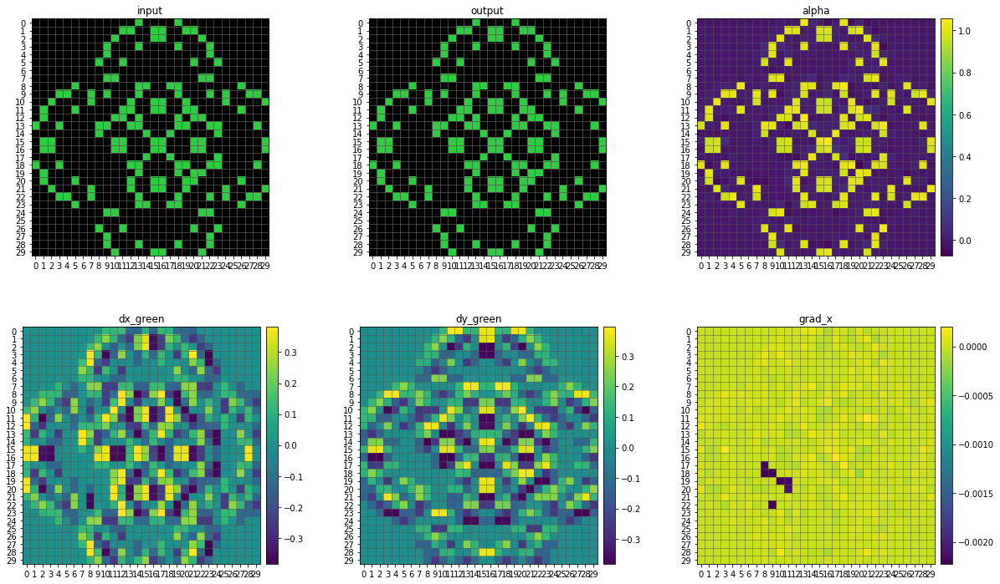

step 71
--------------------------------------------------------------------------------


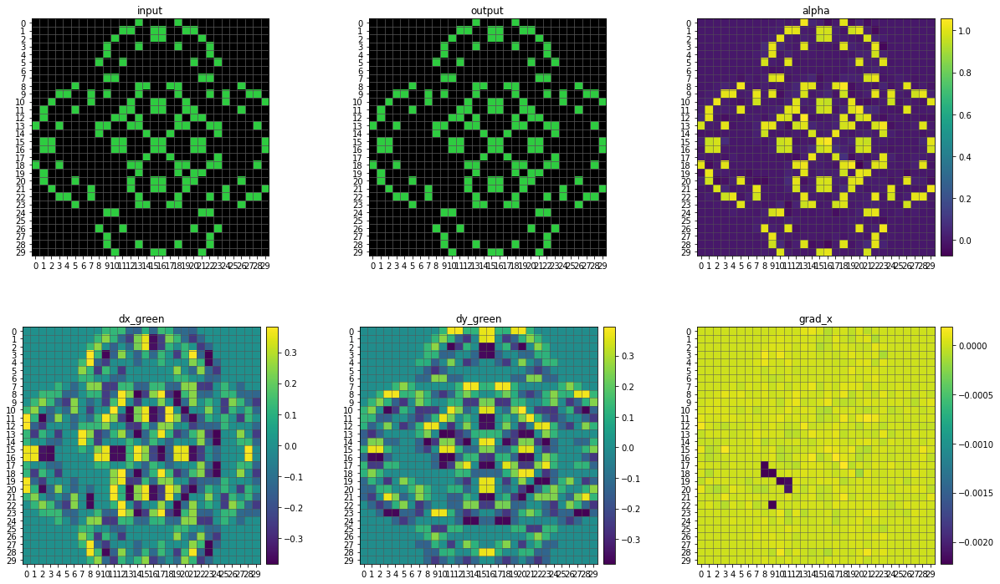

step 72
--------------------------------------------------------------------------------


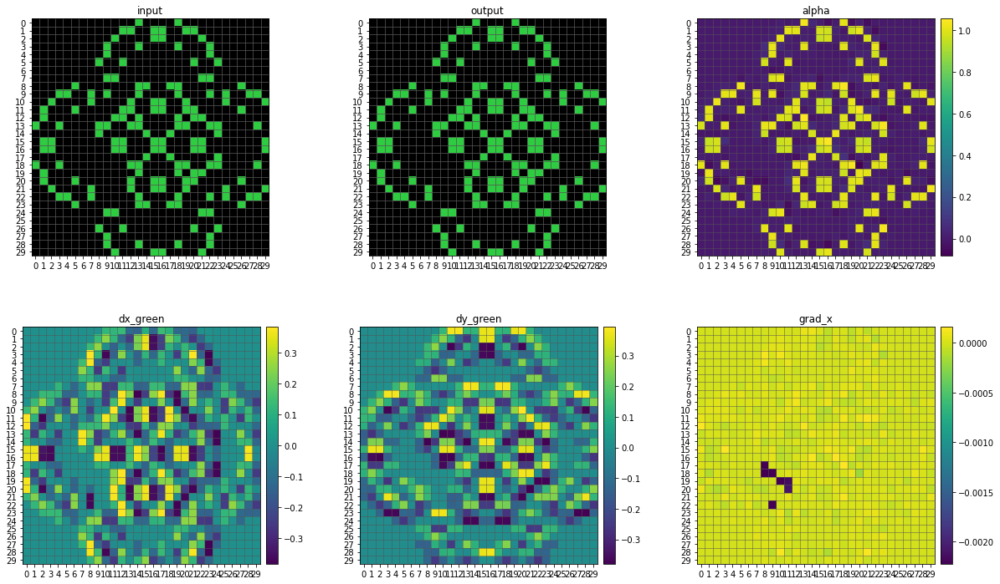

step 73
--------------------------------------------------------------------------------


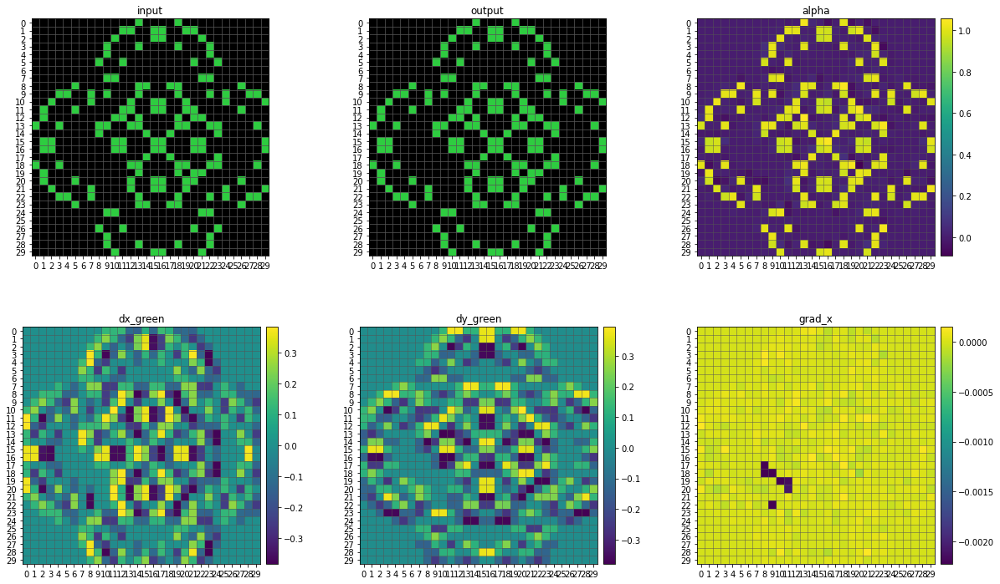

step 74
--------------------------------------------------------------------------------


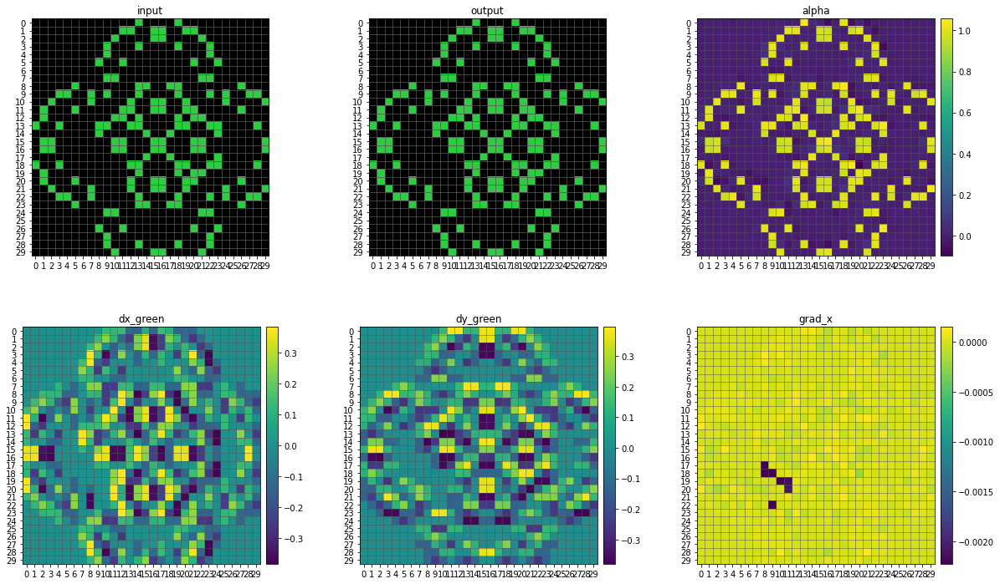

step 75
--------------------------------------------------------------------------------


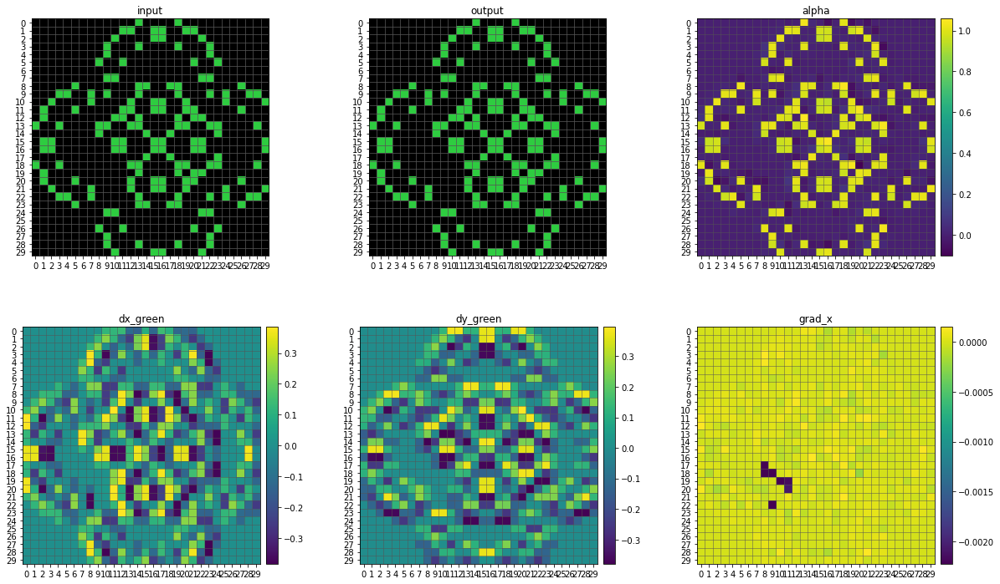

step 76
--------------------------------------------------------------------------------


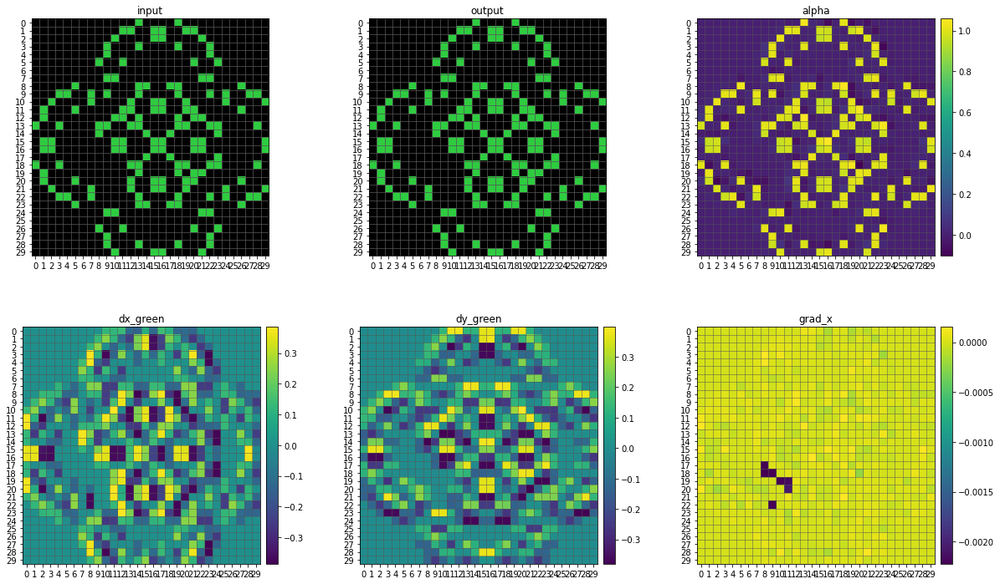

step 77
--------------------------------------------------------------------------------


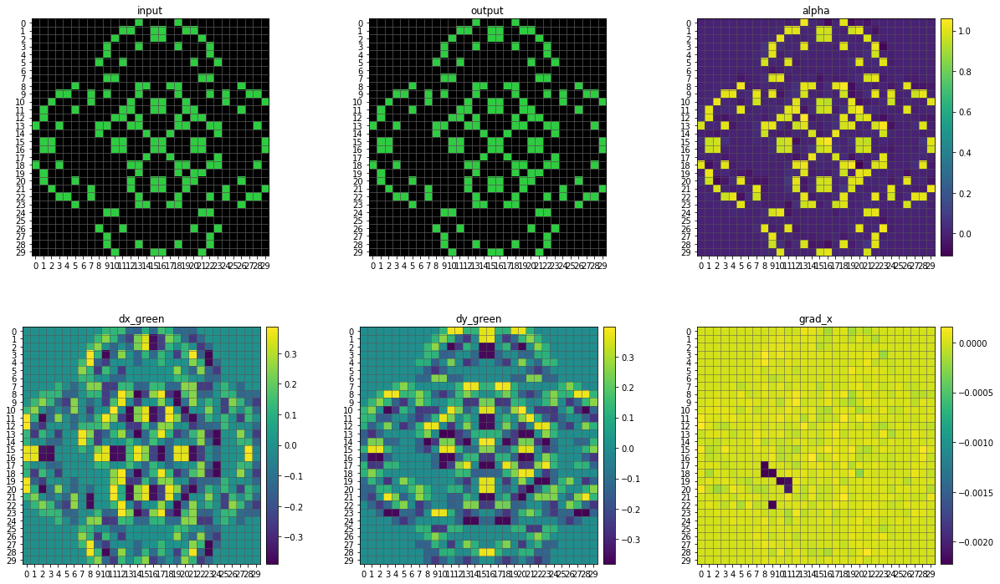

step 78
--------------------------------------------------------------------------------


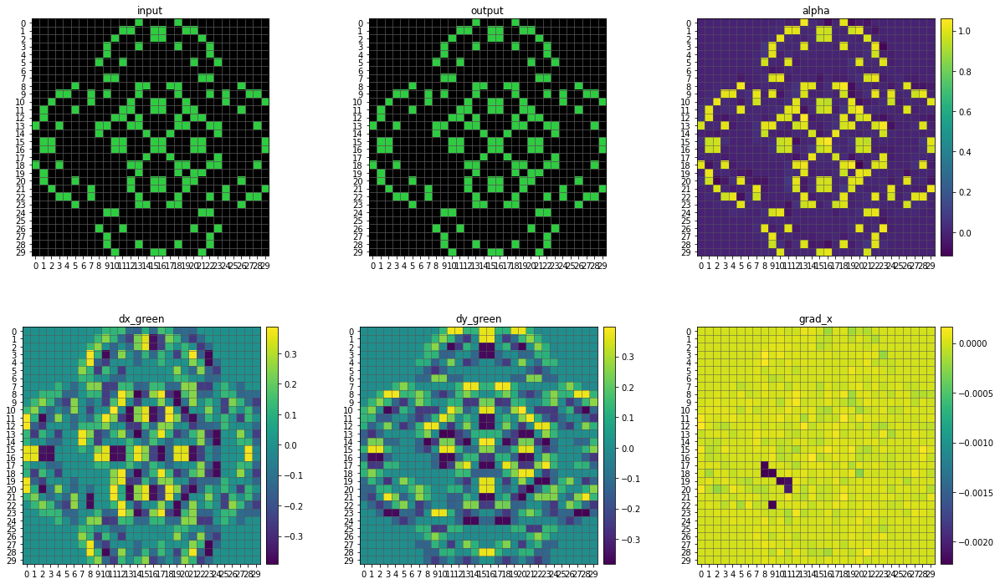

step 79
--------------------------------------------------------------------------------


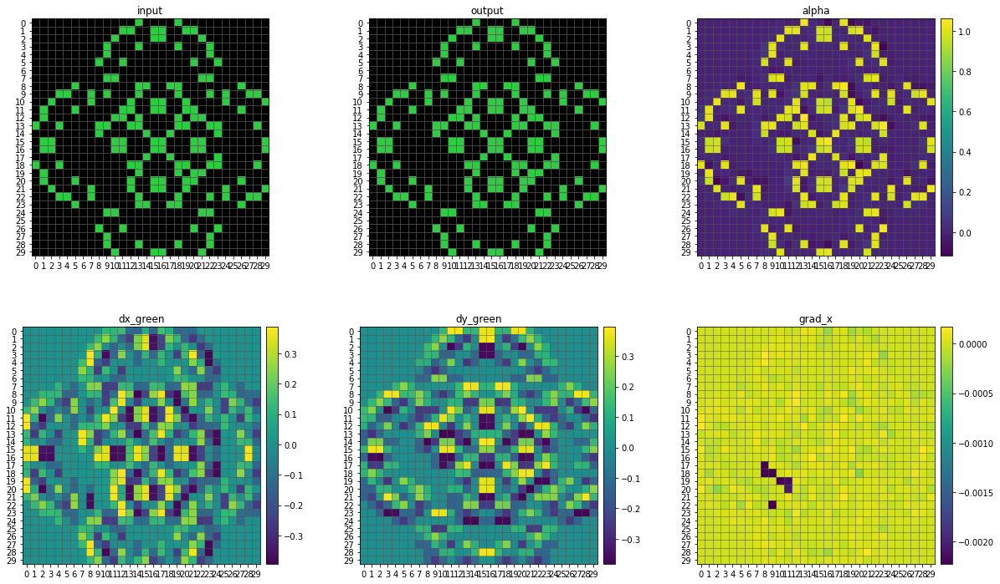

step 80
--------------------------------------------------------------------------------


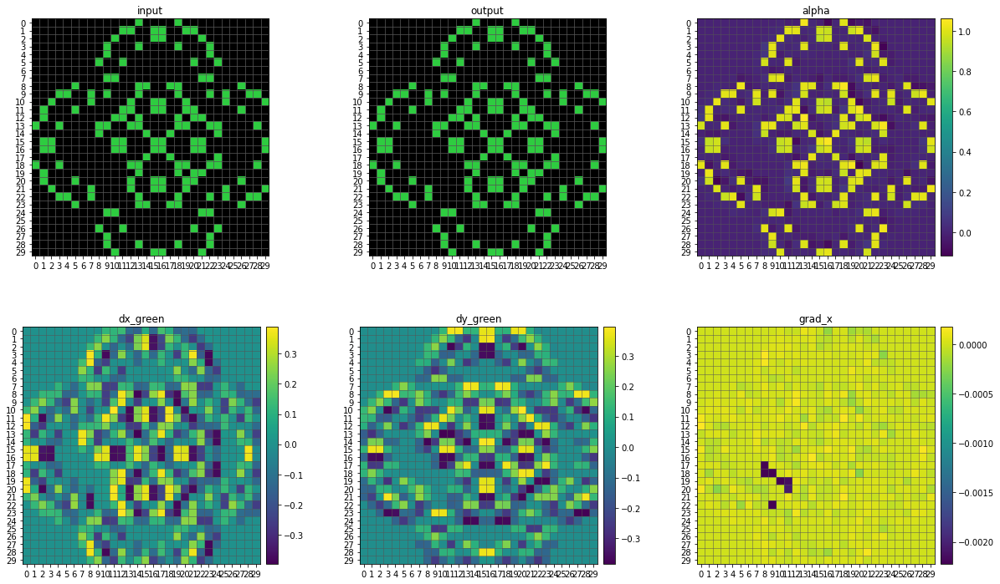

step 81
--------------------------------------------------------------------------------


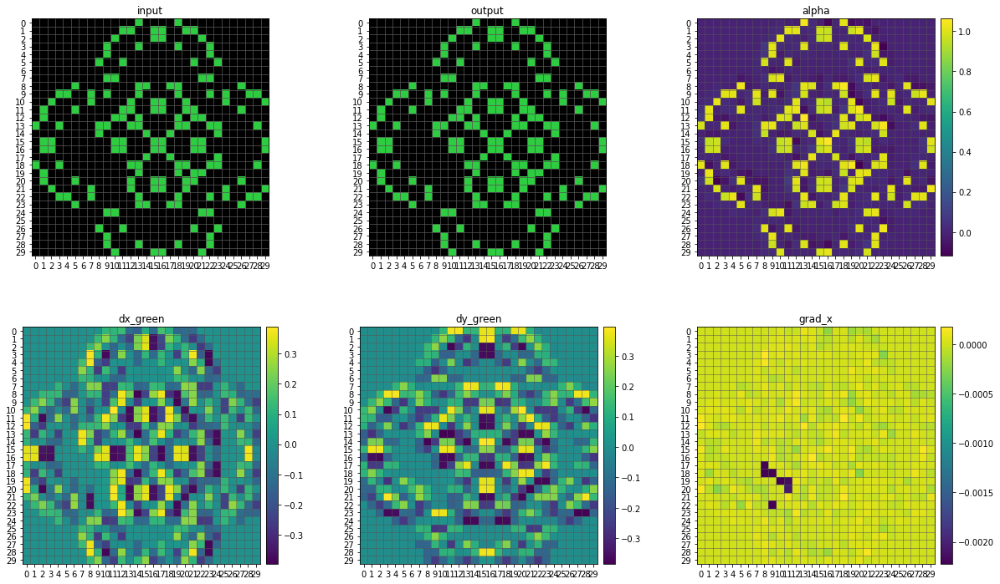

step 82
--------------------------------------------------------------------------------


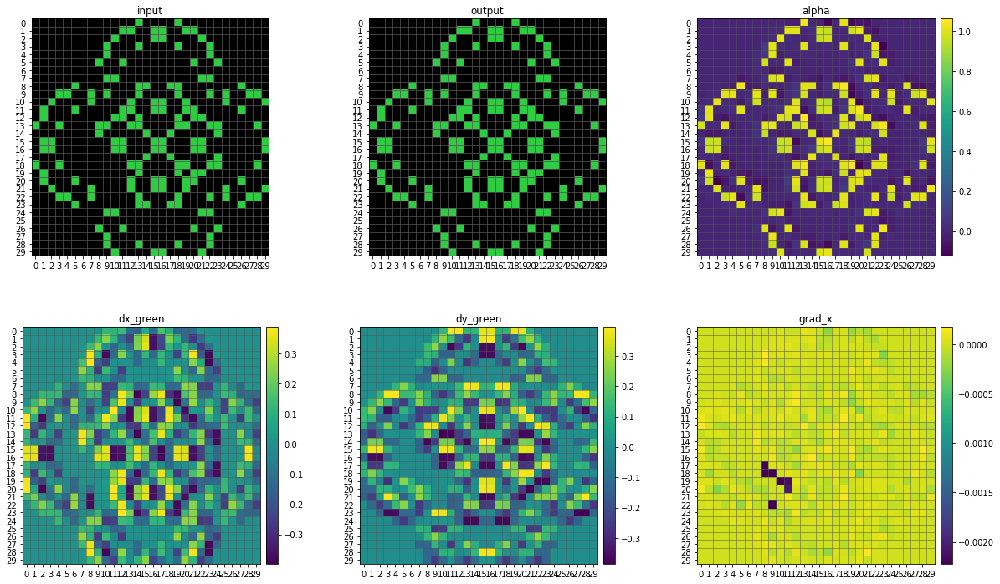

step 83
--------------------------------------------------------------------------------


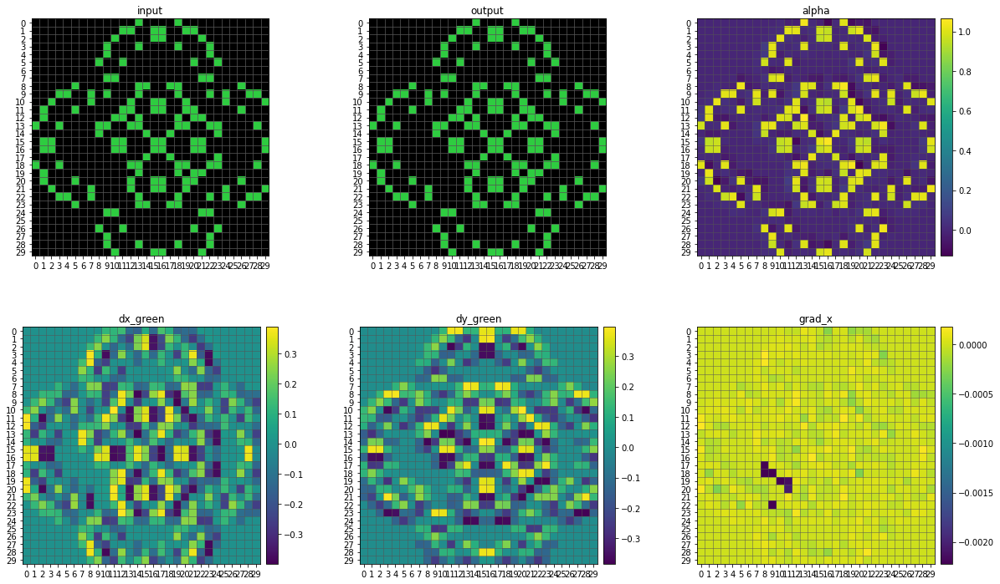

step 84
--------------------------------------------------------------------------------


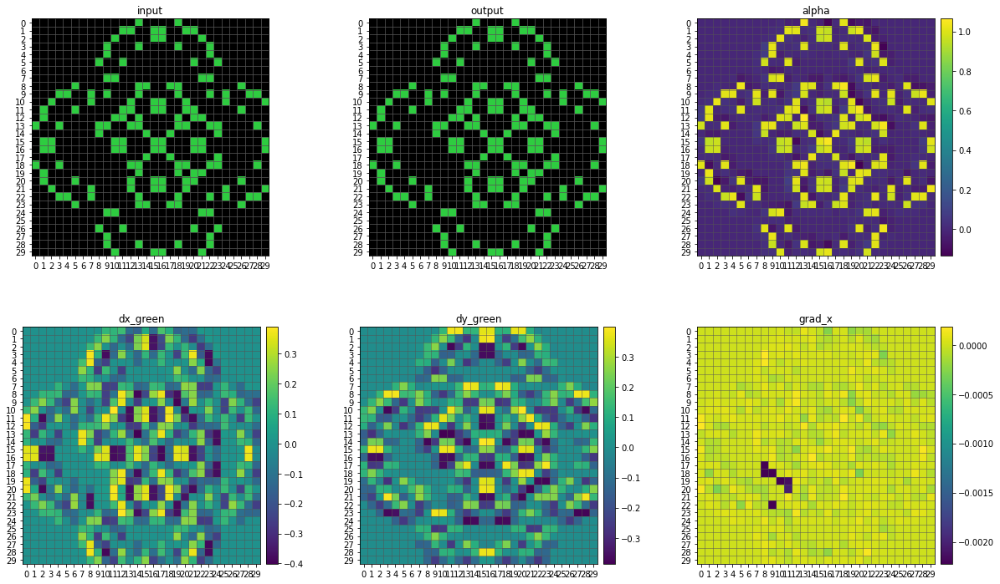

step 85
--------------------------------------------------------------------------------


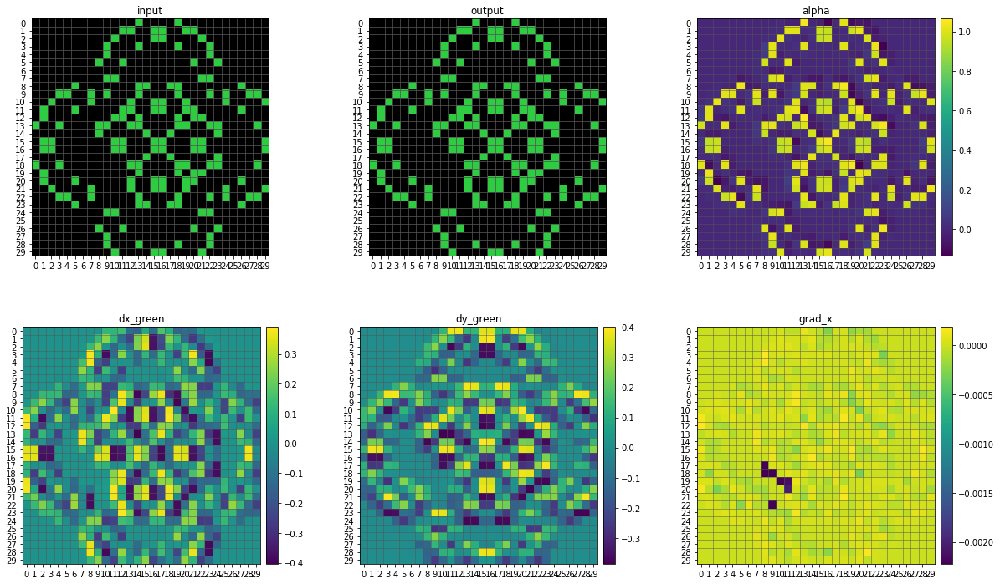

step 86
--------------------------------------------------------------------------------


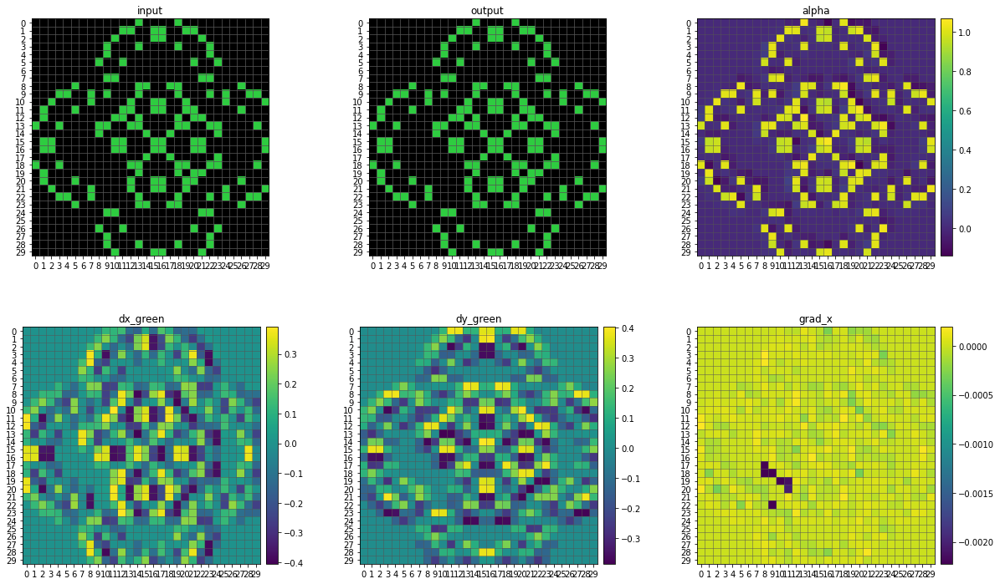

step 87
--------------------------------------------------------------------------------


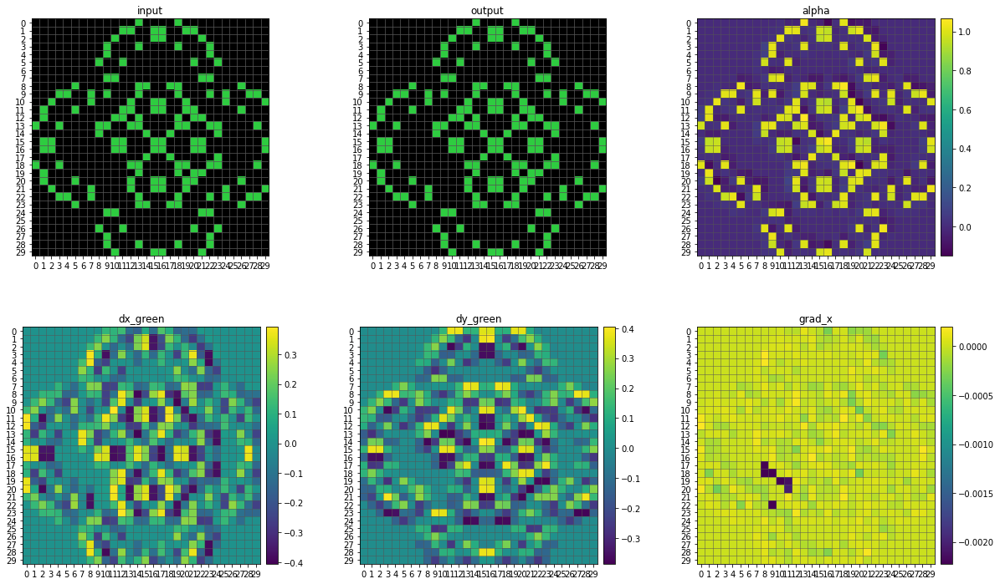

step 88
--------------------------------------------------------------------------------


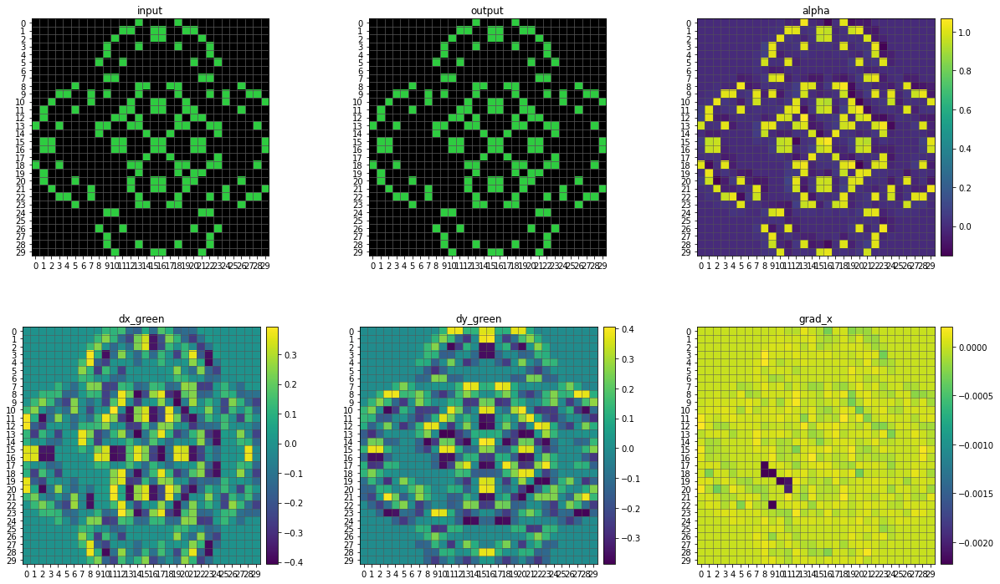

step 89
--------------------------------------------------------------------------------


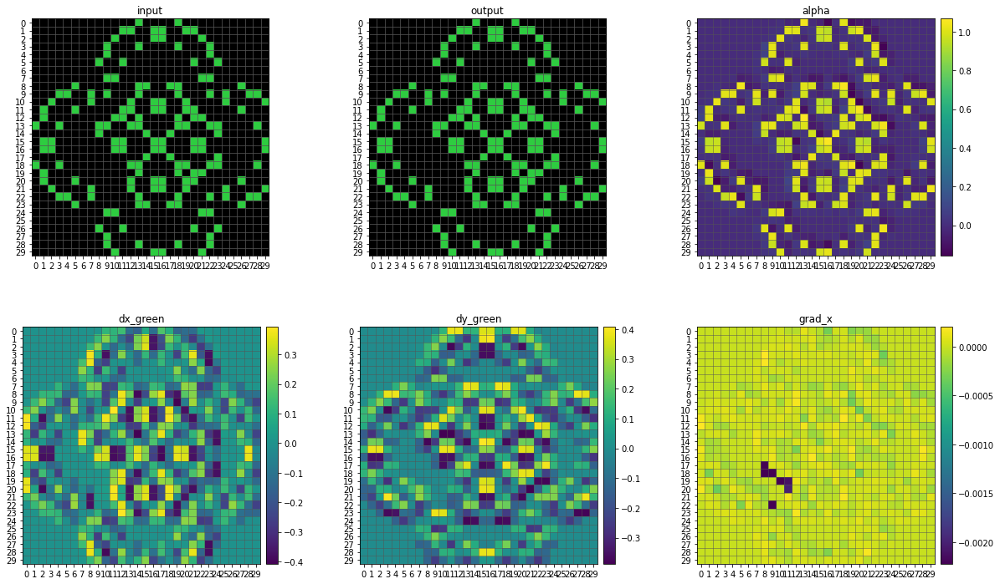

step 90
--------------------------------------------------------------------------------


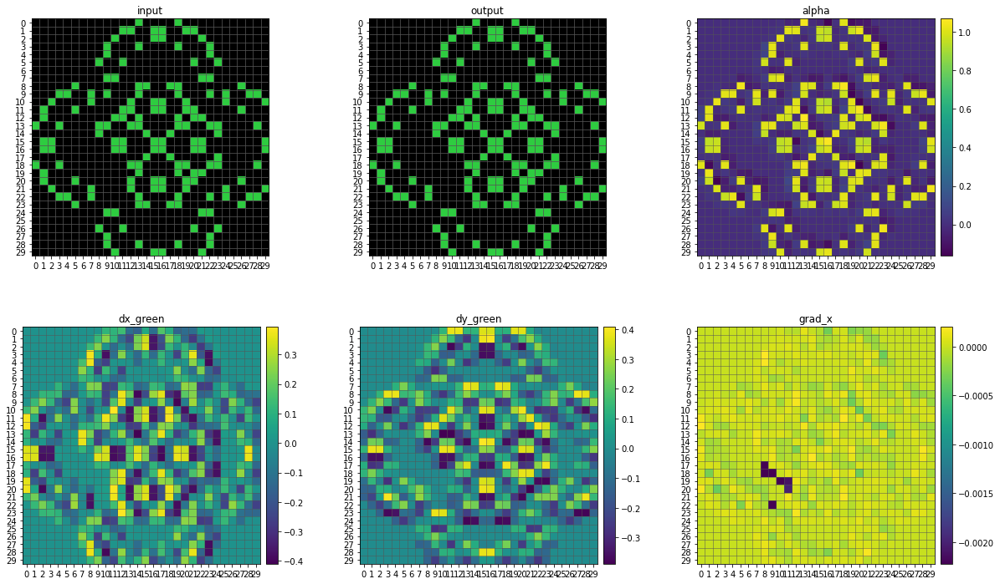

step 91
--------------------------------------------------------------------------------


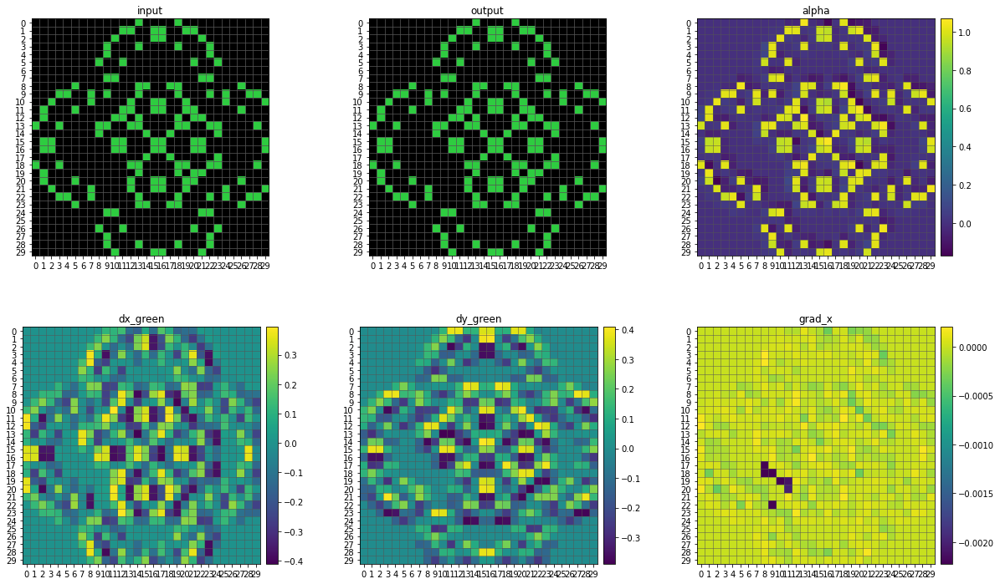

step 92
--------------------------------------------------------------------------------


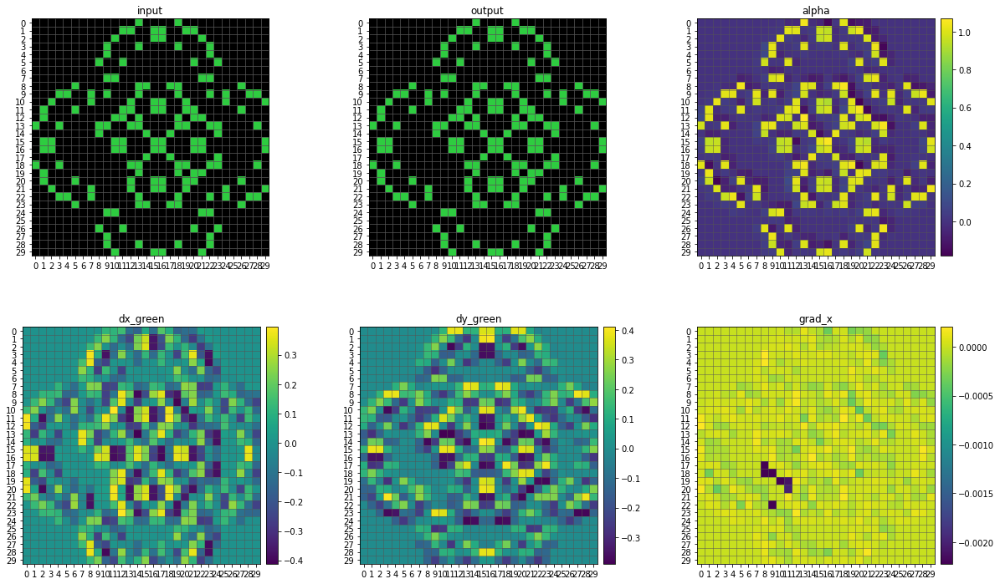

step 93
--------------------------------------------------------------------------------


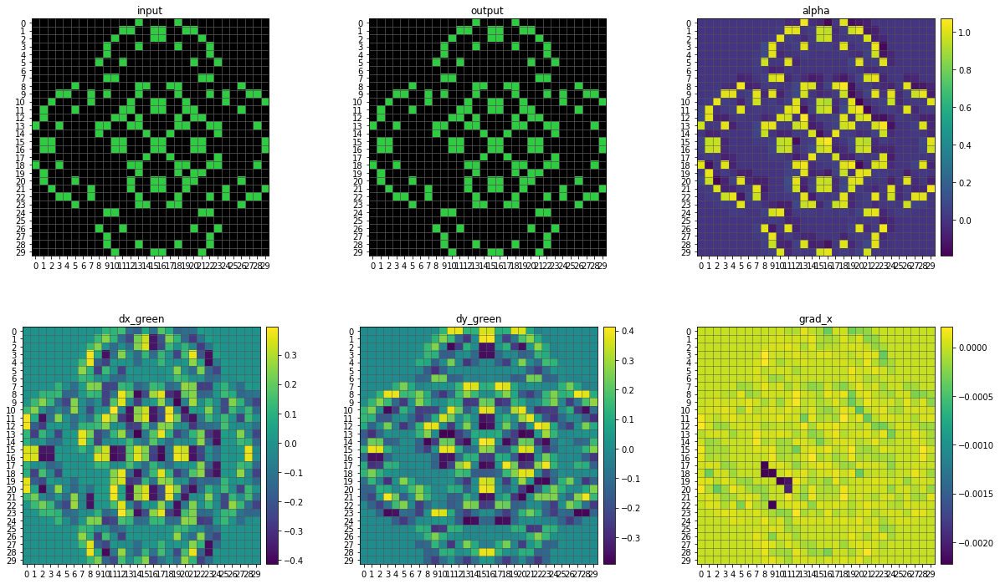

step 94
--------------------------------------------------------------------------------


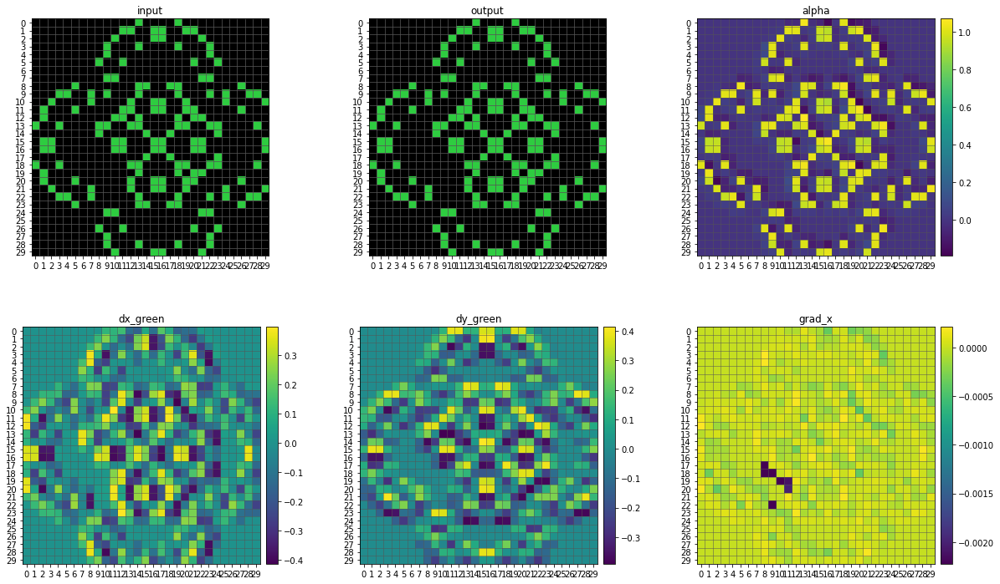

step 95
--------------------------------------------------------------------------------


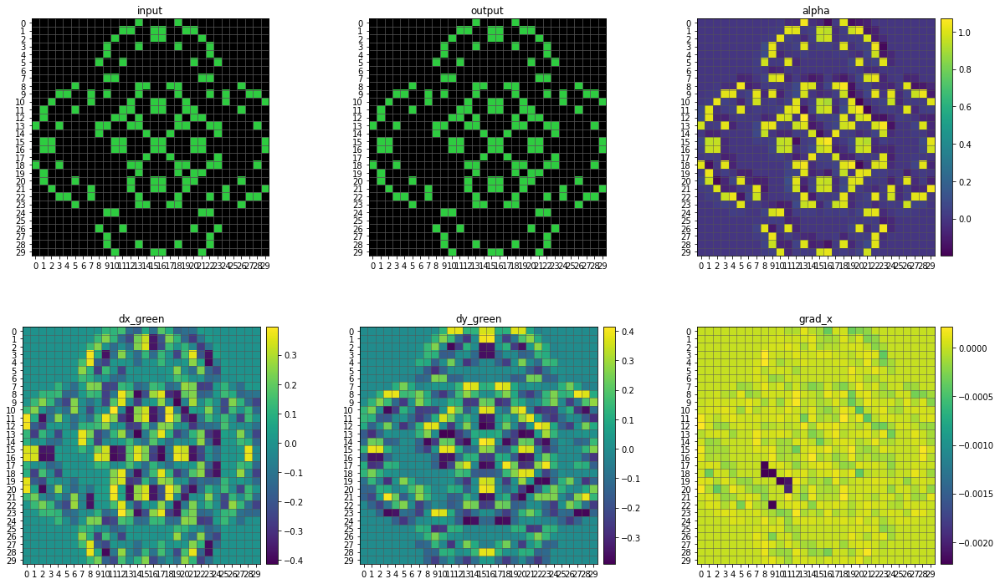

step 96
--------------------------------------------------------------------------------


KeyboardInterrupt: 

In [1228]:
plot_metadata(metadata, cmap, range(100))

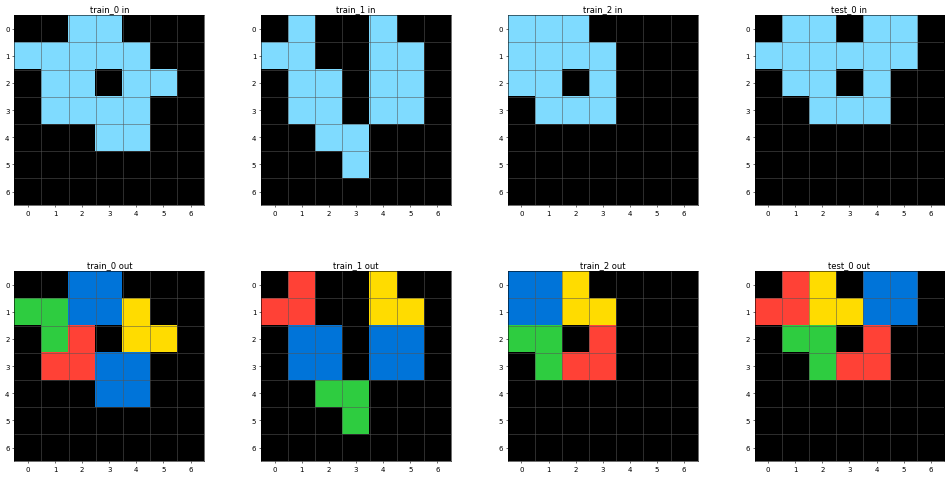

In [778]:
task.plot()

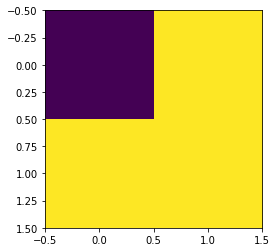

In [825]:
k = obj_filters[1]
plt.imshow(k.sum((-2,-1)))
y = tf.nn.depthwise_conv2d(x, k, [1,1,1,1], 'SAME')[0].numpy()

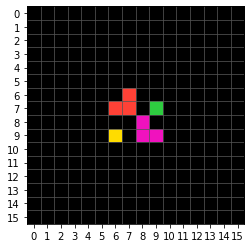

In [1353]:
plot_grid(channel_to_grid(output_train[0], ch_to_symbols[0]))

In [1066]:
idx = 0
x = input_test[idx:idx+1]
y = output_test[idx:idx+1]
cmap = task.ch_to_colors[-1]
shape = task.output_shapes[task.num_train+idx]
params = {
    'step_size': 1,
    'dropout': 1.,
    'mask_th': mask_th.value+.1,
    'steps': 150,
    'output_shape': shape
}
y_preds_test = generate_predictions(m_best, x, target=y, cmap=cmap, verbose=1,**params)

step 0 - loss : 0.0732 - acc : 0.5278
step 1 - loss : 0.0715 - acc : 0.5278
step 2 - loss : 0.0697 - acc : 0.5278
step 3 - loss : 0.0680 - acc : 0.5278
step 4 - loss : 0.0666 - acc : 0.5278
step 5 - loss : 0.0653 - acc : 0.5278
step 6 - loss : 0.0641 - acc : 0.5278
step 7 - loss : 0.0625 - acc : 0.5278
step 8 - loss : 0.0610 - acc : 0.5278
step 9 - loss : 0.0596 - acc : 0.5278
step 10 - loss : 0.0583 - acc : 0.5278
step 11 - loss : 0.0569 - acc : 0.5278
step 12 - loss : 0.0558 - acc : 0.5278
step 13 - loss : 0.0549 - acc : 0.5278
step 14 - loss : 0.0539 - acc : 0.5278
step 15 - loss : 0.0527 - acc : 0.5278
step 16 - loss : 0.0516 - acc : 0.5278
step 17 - loss : 0.0506 - acc : 0.5278
step 18 - loss : 0.0496 - acc : 0.5278
step 19 - loss : 0.0486 - acc : 0.5278
step 20 - loss : 0.0475 - acc : 0.5278
step 21 - loss : 0.0468 - acc : 0.5278
step 22 - loss : 0.0460 - acc : 0.5278
step 23 - loss : 0.0453 - acc : 0.5278
step 24 - loss : 0.0443 - acc : 0.5278
step 25 - loss : 0.0434 - acc : 0.5

In [935]:
# idx = 3
# x = input_train[idx:idx+1]
# y = output_train[idx:idx+1]
# cmap = task.ch_to_colors[idx]
# shape = task.output_shapes[idx]
# params = {
#     'step_size': 1,
#     'dropout': 1.,
#     'mask_th': mask_th.value,
#     'steps': 150,
#     'output_shape': shape
# }
# p = generate_predictions(model, x, cmap, y, **params)

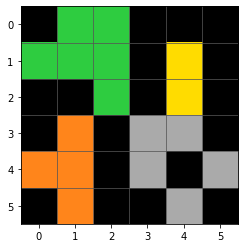

In [937]:
y_padded = unpad(y, shape)
y_test = channel_to_grid(y_padded[0], cmap)
plot_grid(y_test)

0.9166666666666666


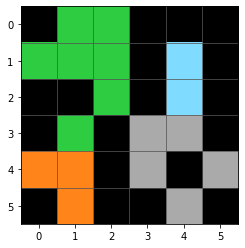

In [1068]:
pred_idx = 110
pred_padded = unpad(y_preds_test[pred_idx], shape)
y_pred = channel_to_grid(pred_padded[0], cmap, mask_th.value+.1)
print(score_ca(y_test, y_pred))
plot_grid(y_pred)

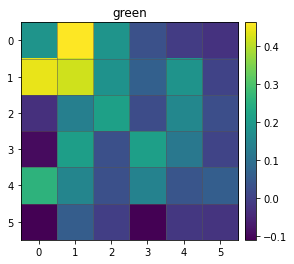

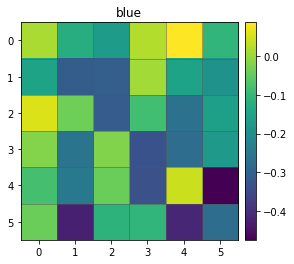

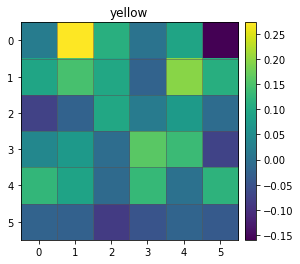

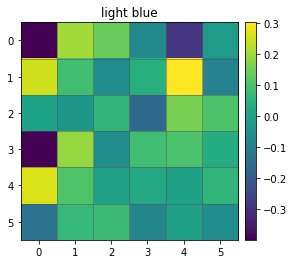

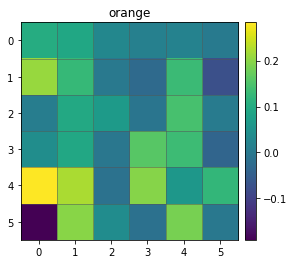

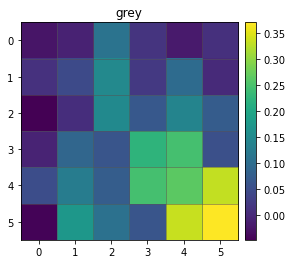

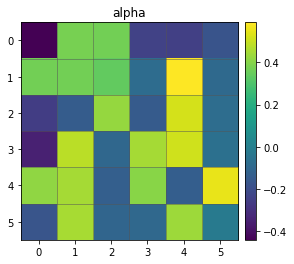

In [1069]:
for i in range(pred_padded.shape[-1]):
    ax = plot_gradient(pred_padded[0,...,i])
    ax.set_title(idx_to_color.get(cmap.get(i), 'alpha'))
    plt.show()

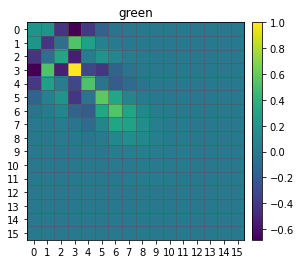

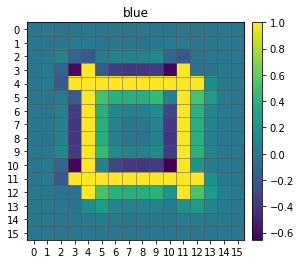

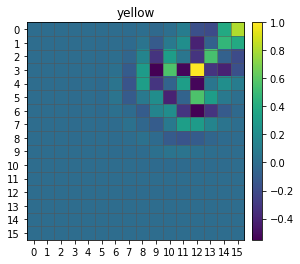

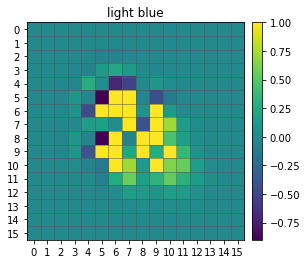

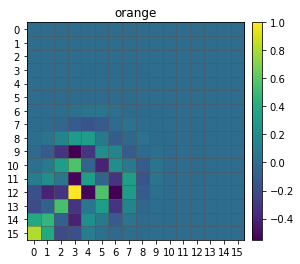

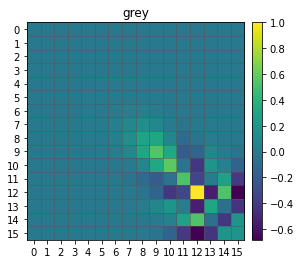

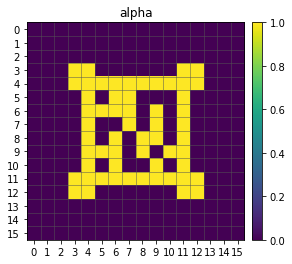

In [1070]:
for i in range(pred_padded.shape[-1]):
    ax = plot_gradient(x[0,...,i])
    ax.set_title(idx_to_color.get(cmap.get(i), 'alpha'))
    plt.show()

In [958]:
from skimage.transform import resize
# out = scipy.misc.imresize(array, 2.0)

In [ ]:
te

In [959]:
obj = task.objects[0][0][0]._obj

In [960]:
obj.shape

(8, 8)

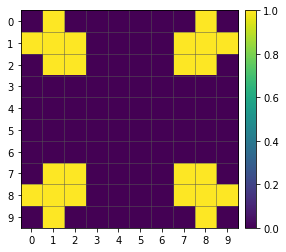

In [985]:
plot_gradient((resize(obj, (10, 10))>=.0028)*1)

In [120]:
for k,v in cmap.items():
    print(f'ch {k} ({idx_to_color[v]}) \t\t: {loss_per_ch[k]:.5f}')

ch 0 (green) 		: 0.09015
ch 1 (blue) 		: 0.00200
ch 2 (yellow) 		: 0.07205
ch 3 (light blue) 		: 0.01533
ch 4 (orange) 		: 0.07544
ch 5 (grey) 		: 0.08609


In [113]:
p = get_pred(pred_padded, num_channels).numpy()

In [117]:
loss_per_ch = tf.reduce_mean((y_padded[0] - p[0])**2, [0,1]).numpy()
loss_per_ch

array([0.09015399, 0.00200187, 0.07204676, 0.01533147, 0.07543894,
       0.08609378, 0.00266664], dtype=float32)

In [93]:
loss_per_ch = tf.reduce_mean((y[0] - p[0])**2, [0,1]).numpy()

In [ ]:
def alpha_checkerboard(x, n_iter=30):
    ndim = x.ndim
    if ndim == 3:
        x = x[None,...]
    num_channels = x.shape[-1]
    sx = np.repeat(sobel_x[...,None,None], num_channels, axis=2)
    sy = np.repeat(sobel_y[...,None,None], num_channels, axis=2)
    
    for _ in range(n_iter):
        dx = tf.nn.depthwise_conv2d(x, sx / 8., [1,1,1,1], 'SAME').numpy()
        dy = tf.nn.depthwise_conv2d(x, sy / 8., [1,1,1,1], 'SAME').numpy()
        x = x + dx * dy
        
    return x[0] if ndim == 3 else x